# 人脸生成

MNIST下载地址http://yann.lecun.com/exdb/mnist/

CelebA下载地址http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html

In [4]:
import tensorflow as tf
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

# 数据集本地目录
data_dir = './data'

### 辨别器

In [5]:
OUTPUT_DIM = 28*28*3

def discriminator():
    model = tf.keras.Sequential([
        tf.keras.layers.Reshape([28, 28, 3], input_shape=([OUTPUT_DIM,])),
        tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'),
        tf.keras.layers.LeakyReLU(),
#         tf.keras.layers.Dropout(0.3),
        
        tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'),
        tf.keras.layers.LeakyReLU(),
#         tf.keras.layers.Dropout(0.3),
        
        tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'),
        tf.keras.layers.LeakyReLU(),
#         tf.keras.layers.Dropout(0.3),
        
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(1)
        ])
    return model

### 生成器

In [6]:
z_dim = 128

def generator():

    model = tf.keras.Sequential([
        tf.keras.layers.Dense(2*2*512, activation="relu", input_shape=([z_dim,])),
        tf.keras.layers.Reshape([2, 2, 512]),
        
        tf.keras.layers.Conv2DTranspose(256, (5, 5), strides=(2, 2), activation="relu", padding='same'),
        
        tf.keras.layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), activation="relu", padding='same'),
        tf.keras.layers.Lambda(lambda x:x[:, :7, :7, :]),
        
        tf.keras.layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), activation="relu", padding='same'),
        
        tf.keras.layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), activation="tanh", padding='same'),
        
        tf.keras.layers.Reshape([OUTPUT_DIM])
        ])
    return model

### 损失函数

In [7]:
def generator_loss(d_logits_fake):
    gen_cost = -tf.reduce_mean(d_logits_fake)
    return gen_cost

In [8]:
batch_size = 64

def discriminator_loss(input_real, g_output, d_logits_real, d_logits_fake):
    LAMBDA=10
    disc_cost = tf.reduce_mean(d_logits_fake) - tf.reduce_mean(d_logits_real)

    alpha = tf.random.uniform(
        shape=[batch_size, 1],
        minval=0.,
        maxval=1.
    )
    differences = g_output - input_real
    interpolates = input_real + (alpha * differences)
    gradients = tf.gradients(discriminator_model(interpolates, training=True), [interpolates])[0]
    slopes = tf.sqrt(tf.reduce_sum(tf.square(gradients), axis=[1]))  # reduction_indices
    gradient_penalty = tf.reduce_mean((slopes - 1.) ** 2)
    disc_cost += LAMBDA * gradient_penalty
    return disc_cost

### 优化器

In [9]:
beta1 = 0  # 0.5
beta2 = 0.9
generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta1, beta2)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta1, beta2)

In [10]:
generator_model = generator()
discriminator_model = discriminator()

## 训练神经网络

In [12]:
import math
def images_square_grid(images, mode):

    # Get maximum size for square grid of images
    save_size = math.floor(np.sqrt(images.shape[0]))

    # Scale to 0-255
    images = (((images - images.min()) * 255) / (images.max() - images.min())).astype(np.uint8)

    # Put images in a square arrangement
    images_in_square = np.reshape(
            images[:save_size*save_size],
            (save_size, save_size, images.shape[1], images.shape[2], images.shape[3]))
    if mode == 'L':
        images_in_square = np.squeeze(images_in_square, 4)

    # Combine images to grid image
    new_im = Image.new(mode, (images.shape[1] * save_size, images.shape[2] * save_size))
    for col_i, col_images in enumerate(images_in_square):
        for image_i, image in enumerate(col_images):
            im = Image.fromarray(image, mode)
            new_im.paste(im, (col_i * images.shape[1], image_i * images.shape[2]))

    return new_im

In [11]:
def show_generator_output(n_images, image_mode):

    cmap = None if image_mode == 'RGB' else 'gray'

    noise = tf.random.normal([n_images, z_dim])
    samples = generator_model(noise, training=False)
    samples=tf.reshape(samples, (n_images, 28, 28, 3))

    images_grid = images_square_grid(samples.numpy(), image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

In [13]:
@tf.function
def d_train_step(input_real):
   # generating noise from a normal distribution
    noise = tf.random.normal([batch_size, z_dim])
    
    with tf.GradientTape() as disc_tape:
        g_output = generator_model(noise, training=True)
    
        d_logits_real = discriminator_model(input_real, training=True)
        d_logits_fake = discriminator_model(g_output, training=True)
        
        disc_loss = discriminator_loss(input_real, g_output, d_logits_real, d_logits_fake)

    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator_model.variables)
    
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator_model.variables))
    return disc_loss

In [14]:
@tf.function
def g_train_step():
   # generating noise from a normal distribution
    noise = tf.random.normal([batch_size, z_dim])
    
    with tf.GradientTape() as gen_tape:
        g_output = generator_model(noise, training=True)

        d_logits_fake = discriminator_model(g_output, training=True)
    
        gen_loss = generator_loss(d_logits_fake)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator_model.variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator_model.variables))

    return gen_loss

### 训练函数

In [18]:
import time
import numpy as np
from tensorflow.python.ops import summary_ops_v2

def train(epochs, batch_size, learning_rate, beta1, beta2, get_batches, Xs, data_image_mode,
          CRITIC_ITERS=5):

    train_times = 0

    gen = get_batches(Xs, batch_size)

    if True:
        timestamp = str(int(time.time()))

        save_dir = "./models"
        if tf.io.gfile.exists(save_dir):
            #             print('Removing existing model dir: {}'.format(MODEL_DIR))
            #             tf.io.gfile.rmtree(MODEL_DIR)
            pass
        else:
            tf.io.gfile.makedirs(save_dir)

        train_dir = os.path.join(save_dir, 'summaries', 'train')

        train_summary_writer = summary_ops_v2.create_file_writer(train_dir, flush_millis=10000)

        checkpoint_dir = os.path.join(save_dir, 'checkpoints')
        checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')

        checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                         discriminator_optimizer=discriminator_optimizer,
                                         generator=generator_model,
                                         discriminator=discriminator_model)
        
        # Restore variables on creation if a checkpoint exists.
        checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
    
        batch_step = 0
        avg_g_loss = tf.keras.metrics.Mean('g_loss', dtype=tf.float32)
        avg_d_loss = tf.keras.metrics.Mean('d_loss', dtype=tf.float32)
#         try:
        if True:
            for epoch_i in range(epochs):
                if True:
                    start_time = time.time()

                    if epoch_i > 0:
                        gen_loss = g_train_step()

                    avg_d_loss.reset_states()

                    for i in range(CRITIC_ITERS):

                        batch_images = next(gen)
                        batch_images *= 2
                        batch_images=batch_images.reshape([-1, OUTPUT_DIM])  

                        disc_loss = d_train_step(batch_images)
                        avg_d_loss(disc_loss)

#                     summary_ops_v2.scalar('disc_loss', disc_loss)

                    batch_step += 1
                    train_times += 1
                    if train_times % 10 == 0:
                        print(
                            "Epochs {}/{} Batch Step {}/{} gen_loss = {}..., disc_loss = {}..., train using time = {:.3f}".format(
                                epoch_i + 1, epochs, batch_step, len(Xs) // batch_size + 1, gen_loss,
                                avg_d_loss.result(), time.time() - start_time))
                    if train_times % 100 == 0:
                        checkpoint.save(checkpoint_prefix)
#                         print("Model saved in file: {}".format(save_path))
                        show_generator_output(16, data_image_mode)
                    if batch_step % (len(Xs) // batch_size) == 0:
                        batch_step = 0
#         except Exception as reason:
#             print("except!!!", type(reason), reason)
#             save_path = saver.save(sess, os.path.join(save_dir, 'best_model.ckpt'), global_step=step)
#             print("Model saved in file: {}".format(save_path))
    print("Done!")      

In [15]:
from PIL import Image

IMAGE_WIDTH = 28
IMAGE_HEIGHT = 28

def get_batches(Xs, batch_size):
    while(True):
        for start in range(0, len(Xs), batch_size):
            end = min(start + batch_size, len(Xs))
            files=[]
            for file in Xs[start:end]:
                image = Image.open(file)
                
                j = (image.size[0] - 110) // 2
                i = (image.size[1] - 110) // 2
                image = image.crop([j, i, j + 110, i + 110])
                image = image.resize([IMAGE_WIDTH, IMAGE_HEIGHT], Image.BILINEAR)
                image = np.array(image)
                files.append(image)
            files=np.array(files).astype(np.float32)
            if len(files.shape) < 4:
                files=np.expand_dims(files, 0)
            yield files / 255 - 0.5

### 开始训练

Epochs 10/60000 Batch Step 10/3166 gen_loss = -4.511767387390137..., disc_loss = -23.165935516357422..., train using time = 11.349
Epochs 20/60000 Batch Step 20/3166 gen_loss = -1.7397105693817139..., disc_loss = -30.29781150817871..., train using time = 11.191
Epochs 30/60000 Batch Step 30/3166 gen_loss = -4.131844520568848..., disc_loss = -28.095529556274414..., train using time = 11.100
Epochs 40/60000 Batch Step 40/3166 gen_loss = -6.115983486175537..., disc_loss = -25.392051696777344..., train using time = 11.162
Epochs 50/60000 Batch Step 50/3166 gen_loss = -8.309231758117676..., disc_loss = -20.37815284729004..., train using time = 11.179
Epochs 60/60000 Batch Step 60/3166 gen_loss = -4.595378875732422..., disc_loss = -20.3394718170166..., train using time = 11.188
Epochs 70/60000 Batch Step 70/3166 gen_loss = -3.934523344039917..., disc_loss = -19.471149444580078..., train using time = 11.087
Epochs 80/60000 Batch Step 80/3166 gen_loss = 0.40211862325668335..., disc_loss = -18.

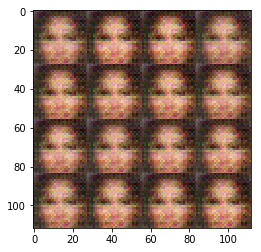

Epochs 110/60000 Batch Step 110/3166 gen_loss = -5.55911922454834..., disc_loss = -19.833065032958984..., train using time = 11.106
Epochs 120/60000 Batch Step 120/3166 gen_loss = 0.9281797409057617..., disc_loss = -20.50374984741211..., train using time = 11.116
Epochs 130/60000 Batch Step 130/3166 gen_loss = -4.90286922454834..., disc_loss = -20.33833885192871..., train using time = 11.153
Epochs 140/60000 Batch Step 140/3166 gen_loss = 1.8065273761749268..., disc_loss = -20.83365821838379..., train using time = 11.204
Epochs 150/60000 Batch Step 150/3166 gen_loss = -5.99810791015625..., disc_loss = -21.70635986328125..., train using time = 11.184
Epochs 160/60000 Batch Step 160/3166 gen_loss = -4.400763511657715..., disc_loss = -23.375383377075195..., train using time = 11.292
Epochs 170/60000 Batch Step 170/3166 gen_loss = -1.8117873668670654..., disc_loss = -22.320571899414062..., train using time = 11.090
Epochs 180/60000 Batch Step 180/3166 gen_loss = -5.911862373352051..., disc

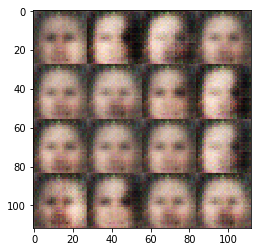

Epochs 210/60000 Batch Step 210/3166 gen_loss = -11.77874755859375..., disc_loss = -12.432438850402832..., train using time = 11.118
Epochs 220/60000 Batch Step 220/3166 gen_loss = -10.895639419555664..., disc_loss = -15.224565505981445..., train using time = 11.086
Epochs 230/60000 Batch Step 230/3166 gen_loss = -5.314822673797607..., disc_loss = -14.8478422164917..., train using time = 11.101
Epochs 240/60000 Batch Step 240/3166 gen_loss = -3.940646171569824..., disc_loss = -15.114176750183105..., train using time = 11.020
Epochs 250/60000 Batch Step 250/3166 gen_loss = -6.32513427734375..., disc_loss = -15.345062255859375..., train using time = 11.097
Epochs 260/60000 Batch Step 260/3166 gen_loss = -5.76689338684082..., disc_loss = -13.2171049118042..., train using time = 11.033
Epochs 270/60000 Batch Step 270/3166 gen_loss = -6.320755481719971..., disc_loss = -13.689748764038086..., train using time = 11.088
Epochs 280/60000 Batch Step 280/3166 gen_loss = -9.95921802520752..., disc

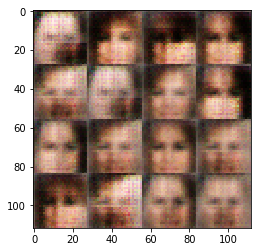

Epochs 310/60000 Batch Step 310/3166 gen_loss = -8.063836097717285..., disc_loss = -13.387306213378906..., train using time = 11.000
Epochs 320/60000 Batch Step 320/3166 gen_loss = -9.804097175598145..., disc_loss = -10.716166496276855..., train using time = 11.103
Epochs 330/60000 Batch Step 330/3166 gen_loss = -12.655145645141602..., disc_loss = -14.142465591430664..., train using time = 11.000
Epochs 340/60000 Batch Step 340/3166 gen_loss = -11.984903335571289..., disc_loss = -12.827731132507324..., train using time = 11.013
Epochs 350/60000 Batch Step 350/3166 gen_loss = -8.910634994506836..., disc_loss = -13.791475296020508..., train using time = 11.209
Epochs 360/60000 Batch Step 360/3166 gen_loss = -7.531701564788818..., disc_loss = -13.804591178894043..., train using time = 10.943
Epochs 370/60000 Batch Step 370/3166 gen_loss = -11.571016311645508..., disc_loss = -12.731816291809082..., train using time = 11.000
Epochs 380/60000 Batch Step 380/3166 gen_loss = -8.817586898803711

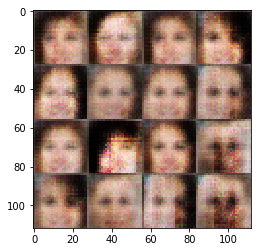

Epochs 410/60000 Batch Step 410/3166 gen_loss = -13.66336441040039..., disc_loss = -10.896031379699707..., train using time = 11.082
Epochs 420/60000 Batch Step 420/3166 gen_loss = -8.610982894897461..., disc_loss = -12.451353073120117..., train using time = 11.026
Epochs 430/60000 Batch Step 430/3166 gen_loss = -2.6265945434570312..., disc_loss = -10.831927299499512..., train using time = 10.997
Epochs 440/60000 Batch Step 440/3166 gen_loss = -2.4440484046936035..., disc_loss = -10.108579635620117..., train using time = 11.036
Epochs 450/60000 Batch Step 450/3166 gen_loss = -10.084415435791016..., disc_loss = -11.132936477661133..., train using time = 10.997
Epochs 460/60000 Batch Step 460/3166 gen_loss = -9.037544250488281..., disc_loss = -11.573126792907715..., train using time = 11.069
Epochs 470/60000 Batch Step 470/3166 gen_loss = -5.804085731506348..., disc_loss = -10.483302116394043..., train using time = 11.186
Epochs 480/60000 Batch Step 480/3166 gen_loss = -11.60618877410888

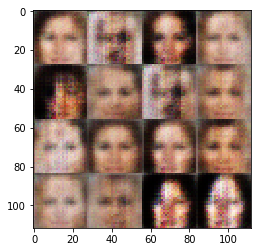

Epochs 510/60000 Batch Step 510/3166 gen_loss = -10.21588134765625..., disc_loss = -11.438986778259277..., train using time = 10.941
Epochs 520/60000 Batch Step 520/3166 gen_loss = -8.175352096557617..., disc_loss = -9.881502151489258..., train using time = 11.018
Epochs 530/60000 Batch Step 530/3166 gen_loss = -15.03201675415039..., disc_loss = -10.061025619506836..., train using time = 11.040
Epochs 540/60000 Batch Step 540/3166 gen_loss = -14.021614074707031..., disc_loss = -10.039579391479492..., train using time = 11.018
Epochs 550/60000 Batch Step 550/3166 gen_loss = -8.668813705444336..., disc_loss = -9.693960189819336..., train using time = 11.081
Epochs 560/60000 Batch Step 560/3166 gen_loss = -4.589875221252441..., disc_loss = -9.682220458984375..., train using time = 10.987
Epochs 570/60000 Batch Step 570/3166 gen_loss = -12.67544937133789..., disc_loss = -10.280900955200195..., train using time = 11.015
Epochs 580/60000 Batch Step 580/3166 gen_loss = -11.984947204589844...,

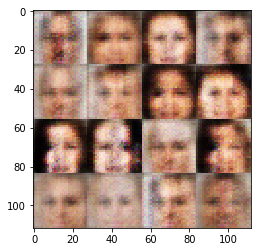

Epochs 610/60000 Batch Step 610/3166 gen_loss = -5.3836822509765625..., disc_loss = -9.874918937683105..., train using time = 11.026
Epochs 620/60000 Batch Step 620/3166 gen_loss = -13.115368843078613..., disc_loss = -9.892496109008789..., train using time = 11.005
Epochs 630/60000 Batch Step 630/3166 gen_loss = -12.21255111694336..., disc_loss = -9.181124687194824..., train using time = 11.033
Epochs 640/60000 Batch Step 640/3166 gen_loss = -3.8535521030426025..., disc_loss = -9.089795112609863..., train using time = 11.049
Epochs 650/60000 Batch Step 650/3166 gen_loss = -8.987428665161133..., disc_loss = -10.247415542602539..., train using time = 11.008
Epochs 660/60000 Batch Step 660/3166 gen_loss = -11.71158504486084..., disc_loss = -8.107156753540039..., train using time = 11.164
Epochs 670/60000 Batch Step 670/3166 gen_loss = -11.469560623168945..., disc_loss = -8.73643684387207..., train using time = 11.124
Epochs 680/60000 Batch Step 680/3166 gen_loss = -13.12686538696289..., d

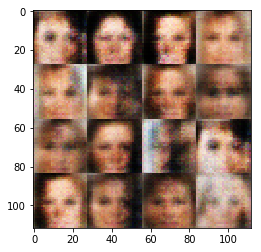

Epochs 710/60000 Batch Step 710/3166 gen_loss = -14.090452194213867..., disc_loss = -9.604823112487793..., train using time = 11.036
Epochs 720/60000 Batch Step 720/3166 gen_loss = -11.923429489135742..., disc_loss = -9.067831993103027..., train using time = 10.998
Epochs 730/60000 Batch Step 730/3166 gen_loss = -2.0137181282043457..., disc_loss = -7.922612190246582..., train using time = 11.242
Epochs 740/60000 Batch Step 740/3166 gen_loss = -10.712818145751953..., disc_loss = -8.101248741149902..., train using time = 10.970
Epochs 750/60000 Batch Step 750/3166 gen_loss = -7.627945899963379..., disc_loss = -8.477849960327148..., train using time = 11.043
Epochs 760/60000 Batch Step 760/3166 gen_loss = -17.599822998046875..., disc_loss = -8.121908187866211..., train using time = 10.892
Epochs 770/60000 Batch Step 770/3166 gen_loss = -5.961857795715332..., disc_loss = -8.379059791564941..., train using time = 11.010
Epochs 780/60000 Batch Step 780/3166 gen_loss = -7.533853054046631..., 

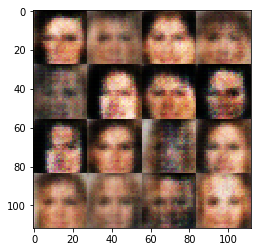

Epochs 810/60000 Batch Step 810/3166 gen_loss = -6.085649013519287..., disc_loss = -8.356732368469238..., train using time = 11.074
Epochs 820/60000 Batch Step 820/3166 gen_loss = -13.596284866333008..., disc_loss = -7.884688377380371..., train using time = 11.082
Epochs 830/60000 Batch Step 830/3166 gen_loss = -15.454404830932617..., disc_loss = -6.069112300872803..., train using time = 11.095
Epochs 840/60000 Batch Step 840/3166 gen_loss = -9.950780868530273..., disc_loss = -7.75643253326416..., train using time = 11.061
Epochs 850/60000 Batch Step 850/3166 gen_loss = -10.189611434936523..., disc_loss = -7.751377105712891..., train using time = 11.118
Epochs 860/60000 Batch Step 860/3166 gen_loss = -9.517082214355469..., disc_loss = -8.167098999023438..., train using time = 11.024
Epochs 870/60000 Batch Step 870/3166 gen_loss = -11.440990447998047..., disc_loss = -7.391043663024902..., train using time = 11.031
Epochs 880/60000 Batch Step 880/3166 gen_loss = -8.243387222290039..., di

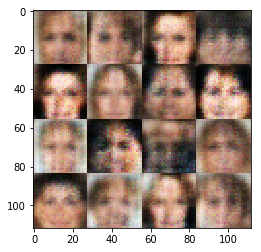

Epochs 910/60000 Batch Step 910/3166 gen_loss = -12.671332359313965..., disc_loss = -6.296584606170654..., train using time = 10.997
Epochs 920/60000 Batch Step 920/3166 gen_loss = -15.678987503051758..., disc_loss = -6.366616725921631..., train using time = 11.777
Epochs 930/60000 Batch Step 930/3166 gen_loss = -7.442543029785156..., disc_loss = -6.18479061126709..., train using time = 10.965
Epochs 940/60000 Batch Step 940/3166 gen_loss = -12.261021614074707..., disc_loss = -7.2530317306518555..., train using time = 10.960
Epochs 950/60000 Batch Step 950/3166 gen_loss = -17.03900146484375..., disc_loss = -6.193306922912598..., train using time = 11.045
Epochs 960/60000 Batch Step 960/3166 gen_loss = -13.07950210571289..., disc_loss = -6.739930152893066..., train using time = 10.959
Epochs 970/60000 Batch Step 970/3166 gen_loss = -8.554801940917969..., disc_loss = -7.313305854797363..., train using time = 11.026
Epochs 980/60000 Batch Step 980/3166 gen_loss = -11.055865287780762..., d

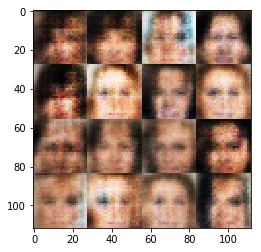

Epochs 1010/60000 Batch Step 1010/3166 gen_loss = -10.841665267944336..., disc_loss = -6.825508117675781..., train using time = 11.080
Epochs 1020/60000 Batch Step 1020/3166 gen_loss = -11.576005935668945..., disc_loss = -7.150943756103516..., train using time = 11.307
Epochs 1030/60000 Batch Step 1030/3166 gen_loss = -10.413745880126953..., disc_loss = -6.989675045013428..., train using time = 11.076
Epochs 1040/60000 Batch Step 1040/3166 gen_loss = -13.902959823608398..., disc_loss = -7.0283613204956055..., train using time = 11.134
Epochs 1050/60000 Batch Step 1050/3166 gen_loss = -17.84347915649414..., disc_loss = -6.4400529861450195..., train using time = 11.002
Epochs 1060/60000 Batch Step 1060/3166 gen_loss = -9.271987915039062..., disc_loss = -6.4542083740234375..., train using time = 11.029
Epochs 1070/60000 Batch Step 1070/3166 gen_loss = -12.368805885314941..., disc_loss = -6.761263847351074..., train using time = 11.034
Epochs 1080/60000 Batch Step 1080/3166 gen_loss = -15.

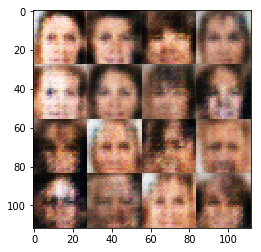

Epochs 1110/60000 Batch Step 1110/3166 gen_loss = -9.41760540008545..., disc_loss = -6.19025993347168..., train using time = 11.179
Epochs 1120/60000 Batch Step 1120/3166 gen_loss = -5.677572250366211..., disc_loss = -6.645471096038818..., train using time = 11.119
Epochs 1130/60000 Batch Step 1130/3166 gen_loss = -12.237764358520508..., disc_loss = -6.232329845428467..., train using time = 11.013
Epochs 1140/60000 Batch Step 1140/3166 gen_loss = -13.29465103149414..., disc_loss = -7.3155670166015625..., train using time = 11.025
Epochs 1150/60000 Batch Step 1150/3166 gen_loss = -6.860086917877197..., disc_loss = -6.291653633117676..., train using time = 11.055
Epochs 1160/60000 Batch Step 1160/3166 gen_loss = -10.249305725097656..., disc_loss = -6.362658977508545..., train using time = 11.041
Epochs 1170/60000 Batch Step 1170/3166 gen_loss = -5.51463508605957..., disc_loss = -6.424779415130615..., train using time = 10.942
Epochs 1180/60000 Batch Step 1180/3166 gen_loss = -11.71872520

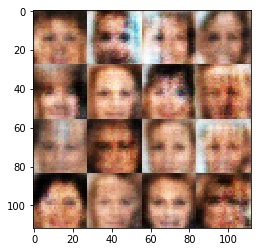

Epochs 1210/60000 Batch Step 1210/3166 gen_loss = -14.172439575195312..., disc_loss = -6.100899696350098..., train using time = 11.062
Epochs 1220/60000 Batch Step 1220/3166 gen_loss = -13.382893562316895..., disc_loss = -5.900263786315918..., train using time = 11.018
Epochs 1230/60000 Batch Step 1230/3166 gen_loss = -8.564592361450195..., disc_loss = -6.045032501220703..., train using time = 11.114
Epochs 1240/60000 Batch Step 1240/3166 gen_loss = -10.91206169128418..., disc_loss = -6.316307067871094..., train using time = 11.129
Epochs 1250/60000 Batch Step 1250/3166 gen_loss = -14.866798400878906..., disc_loss = -6.40850830078125..., train using time = 10.957
Epochs 1260/60000 Batch Step 1260/3166 gen_loss = -13.234598159790039..., disc_loss = -5.8712286949157715..., train using time = 10.992
Epochs 1270/60000 Batch Step 1270/3166 gen_loss = -12.37051773071289..., disc_loss = -6.320732116699219..., train using time = 11.082
Epochs 1280/60000 Batch Step 1280/3166 gen_loss = -10.7583

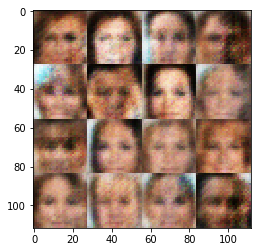

Epochs 1310/60000 Batch Step 1310/3166 gen_loss = -13.307598114013672..., disc_loss = -5.785836219787598..., train using time = 10.986
Epochs 1320/60000 Batch Step 1320/3166 gen_loss = -13.679102897644043..., disc_loss = -5.566678047180176..., train using time = 11.009
Epochs 1330/60000 Batch Step 1330/3166 gen_loss = -11.891806602478027..., disc_loss = -5.580257415771484..., train using time = 10.900
Epochs 1340/60000 Batch Step 1340/3166 gen_loss = -7.772584915161133..., disc_loss = -6.152013778686523..., train using time = 11.014
Epochs 1350/60000 Batch Step 1350/3166 gen_loss = -8.702119827270508..., disc_loss = -5.8561882972717285..., train using time = 11.148
Epochs 1360/60000 Batch Step 1360/3166 gen_loss = -11.722816467285156..., disc_loss = -5.970536231994629..., train using time = 11.150
Epochs 1370/60000 Batch Step 1370/3166 gen_loss = -7.842250823974609..., disc_loss = -5.898022651672363..., train using time = 11.182
Epochs 1380/60000 Batch Step 1380/3166 gen_loss = -13.061

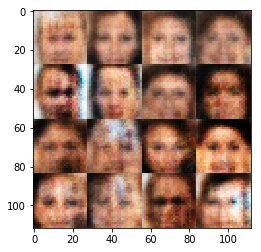

Epochs 1410/60000 Batch Step 1410/3166 gen_loss = -10.66961669921875..., disc_loss = -6.055413246154785..., train using time = 11.002
Epochs 1420/60000 Batch Step 1420/3166 gen_loss = -7.5838165283203125..., disc_loss = -5.597095966339111..., train using time = 11.026
Epochs 1430/60000 Batch Step 1430/3166 gen_loss = -14.294349670410156..., disc_loss = -5.102103233337402..., train using time = 11.358
Epochs 1440/60000 Batch Step 1440/3166 gen_loss = -11.482217788696289..., disc_loss = -5.336563587188721..., train using time = 11.306
Epochs 1450/60000 Batch Step 1450/3166 gen_loss = -9.603922843933105..., disc_loss = -5.306050777435303..., train using time = 11.104
Epochs 1460/60000 Batch Step 1460/3166 gen_loss = -5.230624198913574..., disc_loss = -5.63750696182251..., train using time = 11.040
Epochs 1470/60000 Batch Step 1470/3166 gen_loss = -10.73792839050293..., disc_loss = -5.65750789642334..., train using time = 11.225
Epochs 1480/60000 Batch Step 1480/3166 gen_loss = -10.8505392

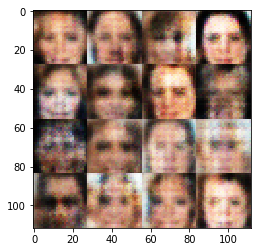

Epochs 1510/60000 Batch Step 1510/3166 gen_loss = -6.34663200378418..., disc_loss = -5.560580730438232..., train using time = 11.197
Epochs 1520/60000 Batch Step 1520/3166 gen_loss = -8.744539260864258..., disc_loss = -5.511425971984863..., train using time = 11.039
Epochs 1530/60000 Batch Step 1530/3166 gen_loss = -9.235435485839844..., disc_loss = -5.445798397064209..., train using time = 11.040
Epochs 1540/60000 Batch Step 1540/3166 gen_loss = -8.529928207397461..., disc_loss = -5.662444114685059..., train using time = 11.561
Epochs 1550/60000 Batch Step 1550/3166 gen_loss = -8.208002090454102..., disc_loss = -5.510891914367676..., train using time = 11.347
Epochs 1560/60000 Batch Step 1560/3166 gen_loss = -7.117770195007324..., disc_loss = -5.590489387512207..., train using time = 11.077
Epochs 1570/60000 Batch Step 1570/3166 gen_loss = -8.001874923706055..., disc_loss = -5.0979323387146..., train using time = 11.185
Epochs 1580/60000 Batch Step 1580/3166 gen_loss = -5.174109458923

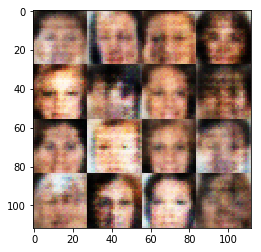

Epochs 1610/60000 Batch Step 1610/3166 gen_loss = -11.957674980163574..., disc_loss = -5.208969593048096..., train using time = 11.110
Epochs 1620/60000 Batch Step 1620/3166 gen_loss = -5.233177185058594..., disc_loss = -5.642762660980225..., train using time = 11.173
Epochs 1630/60000 Batch Step 1630/3166 gen_loss = -8.39588737487793..., disc_loss = -4.973241806030273..., train using time = 11.139
Epochs 1640/60000 Batch Step 1640/3166 gen_loss = -5.850472927093506..., disc_loss = -5.1473894119262695..., train using time = 11.146
Epochs 1650/60000 Batch Step 1650/3166 gen_loss = -4.499415397644043..., disc_loss = -5.072478771209717..., train using time = 12.022
Epochs 1660/60000 Batch Step 1660/3166 gen_loss = -10.817808151245117..., disc_loss = -4.6258087158203125..., train using time = 11.121
Epochs 1670/60000 Batch Step 1670/3166 gen_loss = -10.471638679504395..., disc_loss = -4.870966911315918..., train using time = 11.032
Epochs 1680/60000 Batch Step 1680/3166 gen_loss = -2.49859

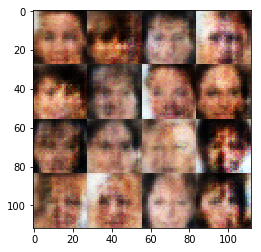

Epochs 1710/60000 Batch Step 1710/3166 gen_loss = -7.573025703430176..., disc_loss = -5.251235008239746..., train using time = 10.982
Epochs 1720/60000 Batch Step 1720/3166 gen_loss = -5.898170471191406..., disc_loss = -5.070698261260986..., train using time = 11.069
Epochs 1730/60000 Batch Step 1730/3166 gen_loss = -10.156150817871094..., disc_loss = -4.962940216064453..., train using time = 10.976
Epochs 1740/60000 Batch Step 1740/3166 gen_loss = -9.34902286529541..., disc_loss = -5.213000297546387..., train using time = 11.018
Epochs 1750/60000 Batch Step 1750/3166 gen_loss = -6.671816825866699..., disc_loss = -5.2647809982299805..., train using time = 11.209
Epochs 1760/60000 Batch Step 1760/3166 gen_loss = -3.719146251678467..., disc_loss = -5.044996738433838..., train using time = 11.098
Epochs 1770/60000 Batch Step 1770/3166 gen_loss = -5.417000770568848..., disc_loss = -4.949569225311279..., train using time = 11.381
Epochs 1780/60000 Batch Step 1780/3166 gen_loss = -5.50571632

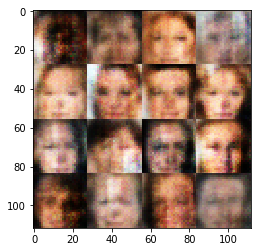

Epochs 1810/60000 Batch Step 1810/3166 gen_loss = -6.079050064086914..., disc_loss = -4.989274501800537..., train using time = 11.034
Epochs 1820/60000 Batch Step 1820/3166 gen_loss = -4.644493579864502..., disc_loss = -5.104128837585449..., train using time = 11.043
Epochs 1830/60000 Batch Step 1830/3166 gen_loss = -6.485724925994873..., disc_loss = -4.78914737701416..., train using time = 11.042
Epochs 1840/60000 Batch Step 1840/3166 gen_loss = -5.048845291137695..., disc_loss = -4.820497989654541..., train using time = 11.020
Epochs 1850/60000 Batch Step 1850/3166 gen_loss = -7.01545524597168..., disc_loss = -4.92431116104126..., train using time = 11.086
Epochs 1860/60000 Batch Step 1860/3166 gen_loss = -6.420952796936035..., disc_loss = -4.635148525238037..., train using time = 11.081
Epochs 1870/60000 Batch Step 1870/3166 gen_loss = -3.815877914428711..., disc_loss = -4.852835178375244..., train using time = 11.111
Epochs 1880/60000 Batch Step 1880/3166 gen_loss = -5.595601081848

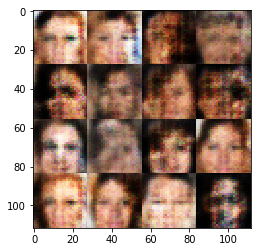

Epochs 1910/60000 Batch Step 1910/3166 gen_loss = -3.432457447052002..., disc_loss = -4.756481170654297..., train using time = 11.044
Epochs 1920/60000 Batch Step 1920/3166 gen_loss = -7.830405235290527..., disc_loss = -4.662037372589111..., train using time = 11.322
Epochs 1930/60000 Batch Step 1930/3166 gen_loss = -1.8085417747497559..., disc_loss = -5.036747932434082..., train using time = 10.946
Epochs 1940/60000 Batch Step 1940/3166 gen_loss = -8.991291046142578..., disc_loss = -3.870938777923584..., train using time = 11.083
Epochs 1950/60000 Batch Step 1950/3166 gen_loss = -5.702950954437256..., disc_loss = -4.608051300048828..., train using time = 11.040
Epochs 1960/60000 Batch Step 1960/3166 gen_loss = -6.907029151916504..., disc_loss = -4.759583950042725..., train using time = 11.049
Epochs 1970/60000 Batch Step 1970/3166 gen_loss = -4.465538501739502..., disc_loss = -4.804437637329102..., train using time = 11.102
Epochs 1980/60000 Batch Step 1980/3166 gen_loss = -3.68637919

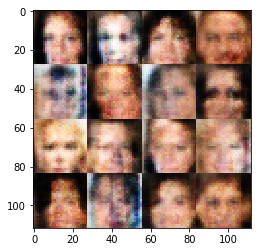

Epochs 2010/60000 Batch Step 2010/3166 gen_loss = -6.368345260620117..., disc_loss = -4.337517738342285..., train using time = 11.055
Epochs 2020/60000 Batch Step 2020/3166 gen_loss = -3.7398266792297363..., disc_loss = -4.867059707641602..., train using time = 11.030
Epochs 2030/60000 Batch Step 2030/3166 gen_loss = -3.304372787475586..., disc_loss = -4.04150915145874..., train using time = 11.128
Epochs 2040/60000 Batch Step 2040/3166 gen_loss = -2.7737298011779785..., disc_loss = -4.514756679534912..., train using time = 11.168
Epochs 2050/60000 Batch Step 2050/3166 gen_loss = -5.844508647918701..., disc_loss = -4.317946434020996..., train using time = 11.064
Epochs 2060/60000 Batch Step 2060/3166 gen_loss = -3.18609619140625..., disc_loss = -5.214740753173828..., train using time = 11.064
Epochs 2070/60000 Batch Step 2070/3166 gen_loss = -1.5103752613067627..., disc_loss = -4.195894718170166..., train using time = 11.188
Epochs 2080/60000 Batch Step 2080/3166 gen_loss = -4.69873476

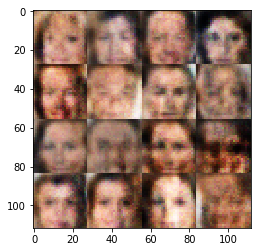

Epochs 2110/60000 Batch Step 2110/3166 gen_loss = -1.8740646839141846..., disc_loss = -4.675252914428711..., train using time = 11.134
Epochs 2120/60000 Batch Step 2120/3166 gen_loss = -4.097653865814209..., disc_loss = -4.347239017486572..., train using time = 10.965
Epochs 2130/60000 Batch Step 2130/3166 gen_loss = -4.2390666007995605..., disc_loss = -4.1449713706970215..., train using time = 11.006
Epochs 2140/60000 Batch Step 2140/3166 gen_loss = -1.2054448127746582..., disc_loss = -4.747605323791504..., train using time = 11.155
Epochs 2150/60000 Batch Step 2150/3166 gen_loss = -3.6698131561279297..., disc_loss = -4.315720558166504..., train using time = 11.001
Epochs 2160/60000 Batch Step 2160/3166 gen_loss = -5.165749549865723..., disc_loss = -4.488276481628418..., train using time = 10.991
Epochs 2170/60000 Batch Step 2170/3166 gen_loss = -1.636268973350525..., disc_loss = -4.449479103088379..., train using time = 11.093
Epochs 2180/60000 Batch Step 2180/3166 gen_loss = -2.0514

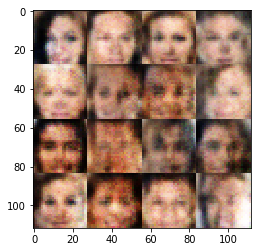

Epochs 2210/60000 Batch Step 2210/3166 gen_loss = -2.1897270679473877..., disc_loss = -4.331822872161865..., train using time = 11.117
Epochs 2220/60000 Batch Step 2220/3166 gen_loss = -2.5180928707122803..., disc_loss = -4.048440933227539..., train using time = 10.989
Epochs 2230/60000 Batch Step 2230/3166 gen_loss = -3.78275728225708..., disc_loss = -4.189173698425293..., train using time = 11.021
Epochs 2240/60000 Batch Step 2240/3166 gen_loss = -4.423596382141113..., disc_loss = -4.274832725524902..., train using time = 11.083
Epochs 2250/60000 Batch Step 2250/3166 gen_loss = -1.8061597347259521..., disc_loss = -4.088005542755127..., train using time = 10.995
Epochs 2260/60000 Batch Step 2260/3166 gen_loss = -0.7305014133453369..., disc_loss = -4.557366847991943..., train using time = 11.008
Epochs 2270/60000 Batch Step 2270/3166 gen_loss = -2.16770339012146..., disc_loss = -3.6690802574157715..., train using time = 11.215
Epochs 2280/60000 Batch Step 2280/3166 gen_loss = 1.2167129

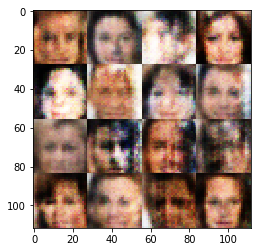

Epochs 2310/60000 Batch Step 2310/3166 gen_loss = 0.7019694447517395..., disc_loss = -4.221155643463135..., train using time = 11.043
Epochs 2320/60000 Batch Step 2320/3166 gen_loss = -0.2678864598274231..., disc_loss = -4.058152198791504..., train using time = 11.039
Epochs 2330/60000 Batch Step 2330/3166 gen_loss = -2.9672179222106934..., disc_loss = -4.246306419372559..., train using time = 11.093
Epochs 2340/60000 Batch Step 2340/3166 gen_loss = -1.5710862874984741..., disc_loss = -4.214238166809082..., train using time = 11.035
Epochs 2350/60000 Batch Step 2350/3166 gen_loss = 1.6461360454559326..., disc_loss = -3.93278431892395..., train using time = 10.944
Epochs 2360/60000 Batch Step 2360/3166 gen_loss = -2.921445846557617..., disc_loss = -3.746131420135498..., train using time = 11.081
Epochs 2370/60000 Batch Step 2370/3166 gen_loss = -0.3445420265197754..., disc_loss = -4.0659565925598145..., train using time = 11.156
Epochs 2380/60000 Batch Step 2380/3166 gen_loss = 1.774901

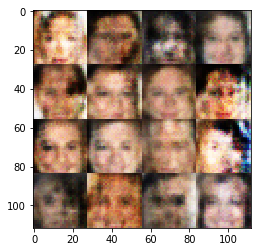

Epochs 2410/60000 Batch Step 2410/3166 gen_loss = -2.3376667499542236..., disc_loss = -4.399052619934082..., train using time = 11.030
Epochs 2420/60000 Batch Step 2420/3166 gen_loss = 0.5417975783348083..., disc_loss = -3.615210771560669..., train using time = 11.009
Epochs 2430/60000 Batch Step 2430/3166 gen_loss = 1.2594398260116577..., disc_loss = -3.595050096511841..., train using time = 11.083
Epochs 2440/60000 Batch Step 2440/3166 gen_loss = 3.244246482849121..., disc_loss = -4.014498233795166..., train using time = 11.151
Epochs 2450/60000 Batch Step 2450/3166 gen_loss = 0.832594633102417..., disc_loss = -3.805821180343628..., train using time = 11.040
Epochs 2460/60000 Batch Step 2460/3166 gen_loss = -1.1810340881347656..., disc_loss = -4.558629035949707..., train using time = 10.992
Epochs 2470/60000 Batch Step 2470/3166 gen_loss = 0.37010473012924194..., disc_loss = -3.9430899620056152..., train using time = 11.047
Epochs 2480/60000 Batch Step 2480/3166 gen_loss = -2.9451937

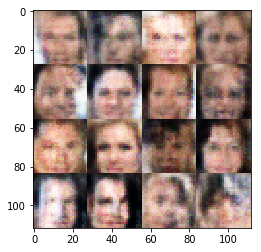

Epochs 2510/60000 Batch Step 2510/3166 gen_loss = 0.16947194933891296..., disc_loss = -3.918067455291748..., train using time = 10.964
Epochs 2520/60000 Batch Step 2520/3166 gen_loss = 1.7932298183441162..., disc_loss = -3.983867645263672..., train using time = 11.075
Epochs 2530/60000 Batch Step 2530/3166 gen_loss = 1.4820175170898438..., disc_loss = -3.818305492401123..., train using time = 11.070
Epochs 2540/60000 Batch Step 2540/3166 gen_loss = 3.5497243404388428..., disc_loss = -4.005760669708252..., train using time = 11.045
Epochs 2550/60000 Batch Step 2550/3166 gen_loss = 1.643628716468811..., disc_loss = -4.0075249671936035..., train using time = 11.012
Epochs 2560/60000 Batch Step 2560/3166 gen_loss = 2.8744354248046875..., disc_loss = -3.76617431640625..., train using time = 11.157
Epochs 2570/60000 Batch Step 2570/3166 gen_loss = -1.8704228401184082..., disc_loss = -3.8423314094543457..., train using time = 11.191
Epochs 2580/60000 Batch Step 2580/3166 gen_loss = 0.03641813

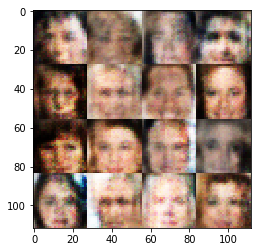

Epochs 2610/60000 Batch Step 2610/3166 gen_loss = 0.41075924038887024..., disc_loss = -3.816145658493042..., train using time = 10.988
Epochs 2620/60000 Batch Step 2620/3166 gen_loss = 0.6060230731964111..., disc_loss = -4.205143928527832..., train using time = 11.040
Epochs 2630/60000 Batch Step 2630/3166 gen_loss = -1.6818516254425049..., disc_loss = -3.703556537628174..., train using time = 11.068
Epochs 2640/60000 Batch Step 2640/3166 gen_loss = 1.6213830709457397..., disc_loss = -3.570510149002075..., train using time = 11.107
Epochs 2650/60000 Batch Step 2650/3166 gen_loss = 5.287806034088135..., disc_loss = -3.490320920944214..., train using time = 11.035
Epochs 2660/60000 Batch Step 2660/3166 gen_loss = -0.37522092461586..., disc_loss = -3.7425074577331543..., train using time = 11.481
Epochs 2670/60000 Batch Step 2670/3166 gen_loss = -0.9568804502487183..., disc_loss = -3.9629063606262207..., train using time = 11.108
Epochs 2680/60000 Batch Step 2680/3166 gen_loss = -0.324267

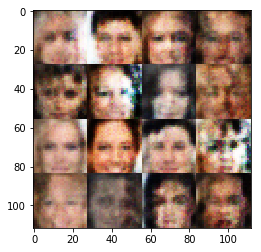

Epochs 2710/60000 Batch Step 2710/3166 gen_loss = 0.03986649215221405..., disc_loss = -3.839280605316162..., train using time = 11.136
Epochs 2720/60000 Batch Step 2720/3166 gen_loss = 3.2813148498535156..., disc_loss = -3.6052799224853516..., train using time = 11.027
Epochs 2730/60000 Batch Step 2730/3166 gen_loss = 3.95851731300354..., disc_loss = -3.6597862243652344..., train using time = 11.388
Epochs 2740/60000 Batch Step 2740/3166 gen_loss = -0.8132230043411255..., disc_loss = -3.7944998741149902..., train using time = 11.262
Epochs 2750/60000 Batch Step 2750/3166 gen_loss = 1.1096951961517334..., disc_loss = -3.8205056190490723..., train using time = 11.063
Epochs 2760/60000 Batch Step 2760/3166 gen_loss = -0.310806006193161..., disc_loss = -3.607553482055664..., train using time = 11.113
Epochs 2770/60000 Batch Step 2770/3166 gen_loss = 1.4039065837860107..., disc_loss = -3.666123151779175..., train using time = 11.121
Epochs 2780/60000 Batch Step 2780/3166 gen_loss = 0.637782

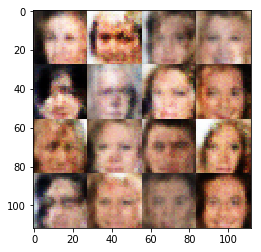

Epochs 2810/60000 Batch Step 2810/3166 gen_loss = 0.6854393482208252..., disc_loss = -3.7594857215881348..., train using time = 11.050
Epochs 2820/60000 Batch Step 2820/3166 gen_loss = 2.5514800548553467..., disc_loss = -3.629880428314209..., train using time = 11.009
Epochs 2830/60000 Batch Step 2830/3166 gen_loss = 2.566535711288452..., disc_loss = -3.536390781402588..., train using time = 11.028
Epochs 2840/60000 Batch Step 2840/3166 gen_loss = -0.8347957134246826..., disc_loss = -3.67150616645813..., train using time = 11.130
Epochs 2850/60000 Batch Step 2850/3166 gen_loss = 2.1981024742126465..., disc_loss = -3.5315825939178467..., train using time = 11.047
Epochs 2860/60000 Batch Step 2860/3166 gen_loss = 1.9506264925003052..., disc_loss = -3.6945433616638184..., train using time = 11.089
Epochs 2870/60000 Batch Step 2870/3166 gen_loss = 3.261531352996826..., disc_loss = -4.272328853607178..., train using time = 11.019
Epochs 2880/60000 Batch Step 2880/3166 gen_loss = -0.27096009

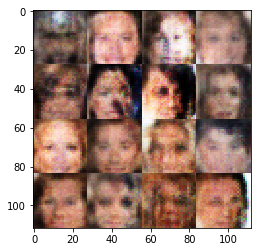

Epochs 2910/60000 Batch Step 2910/3166 gen_loss = -0.716461181640625..., disc_loss = -3.527055263519287..., train using time = 11.007
Epochs 2920/60000 Batch Step 2920/3166 gen_loss = 1.7339296340942383..., disc_loss = -3.89581298828125..., train using time = 10.962
Epochs 2930/60000 Batch Step 2930/3166 gen_loss = 1.5860354900360107..., disc_loss = -3.438868761062622..., train using time = 11.090
Epochs 2940/60000 Batch Step 2940/3166 gen_loss = 2.86818265914917..., disc_loss = -3.7089977264404297..., train using time = 11.048
Epochs 2950/60000 Batch Step 2950/3166 gen_loss = 3.022712469100952..., disc_loss = -3.6586101055145264..., train using time = 11.286
Epochs 2960/60000 Batch Step 2960/3166 gen_loss = 1.5751819610595703..., disc_loss = -3.319446086883545..., train using time = 10.964
Epochs 2970/60000 Batch Step 2970/3166 gen_loss = -0.38393956422805786..., disc_loss = -3.245563507080078..., train using time = 10.971
Epochs 2980/60000 Batch Step 2980/3166 gen_loss = 0.5724530220

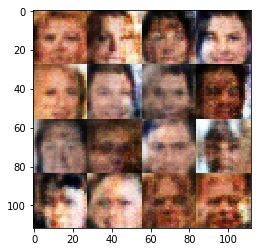

Epochs 3010/60000 Batch Step 3010/3166 gen_loss = 0.01962285488843918..., disc_loss = -3.182971715927124..., train using time = 11.095
Epochs 3020/60000 Batch Step 3020/3166 gen_loss = -0.9374417066574097..., disc_loss = -3.5734851360321045..., train using time = 11.131
Epochs 3030/60000 Batch Step 3030/3166 gen_loss = 0.07055491209030151..., disc_loss = -3.4640088081359863..., train using time = 11.752
Epochs 3040/60000 Batch Step 3040/3166 gen_loss = 2.9286646842956543..., disc_loss = -3.3184821605682373..., train using time = 11.022
Epochs 3050/60000 Batch Step 3050/3166 gen_loss = 1.1486260890960693..., disc_loss = -3.4367451667785645..., train using time = 11.085
Epochs 3060/60000 Batch Step 3060/3166 gen_loss = 2.3114404678344727..., disc_loss = -3.7593326568603516..., train using time = 10.974
Epochs 3070/60000 Batch Step 3070/3166 gen_loss = 3.2629435062408447..., disc_loss = -3.7036075592041016..., train using time = 11.062
Epochs 3080/60000 Batch Step 3080/3166 gen_loss = 1.9

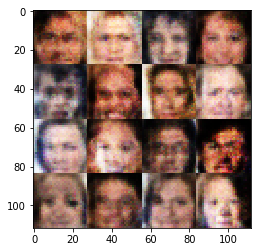

Epochs 3110/60000 Batch Step 3110/3166 gen_loss = 2.230494260787964..., disc_loss = -3.153179168701172..., train using time = 11.009
Epochs 3120/60000 Batch Step 3120/3166 gen_loss = 2.840127468109131..., disc_loss = -3.438616991043091..., train using time = 11.032
Epochs 3130/60000 Batch Step 3130/3166 gen_loss = 1.603766918182373..., disc_loss = -3.375714063644409..., train using time = 11.235
Epochs 3140/60000 Batch Step 3140/3166 gen_loss = 4.849664211273193..., disc_loss = -3.438992977142334..., train using time = 11.091
Epochs 3150/60000 Batch Step 3150/3166 gen_loss = -0.1395324170589447..., disc_loss = -3.19413161277771..., train using time = 11.057
Epochs 3160/60000 Batch Step 3160/3166 gen_loss = 1.252821683883667..., disc_loss = -3.410372495651245..., train using time = 11.074
Epochs 3170/60000 Batch Step 5/3166 gen_loss = 1.1709861755371094..., disc_loss = -3.3679404258728027..., train using time = 11.084
Epochs 3180/60000 Batch Step 15/3166 gen_loss = 1.0497431755065918...

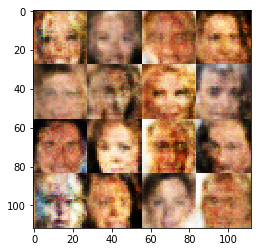

Epochs 3210/60000 Batch Step 45/3166 gen_loss = 1.3521215915679932..., disc_loss = -3.2194771766662598..., train using time = 10.980
Epochs 3220/60000 Batch Step 55/3166 gen_loss = 3.8566629886627197..., disc_loss = -3.3505148887634277..., train using time = 10.917
Epochs 3230/60000 Batch Step 65/3166 gen_loss = 1.5982621908187866..., disc_loss = -3.200803279876709..., train using time = 10.975
Epochs 3240/60000 Batch Step 75/3166 gen_loss = 1.2046769857406616..., disc_loss = -3.5798888206481934..., train using time = 11.001
Epochs 3250/60000 Batch Step 85/3166 gen_loss = 3.4914402961730957..., disc_loss = -3.1770577430725098..., train using time = 10.913
Epochs 3260/60000 Batch Step 95/3166 gen_loss = 1.5609805583953857..., disc_loss = -3.36909818649292..., train using time = 11.101
Epochs 3270/60000 Batch Step 105/3166 gen_loss = 4.421049118041992..., disc_loss = -3.5578980445861816..., train using time = 10.987
Epochs 3280/60000 Batch Step 115/3166 gen_loss = 1.9698295593261719..., 

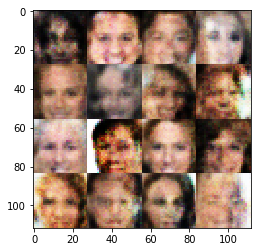

Epochs 3310/60000 Batch Step 145/3166 gen_loss = 6.531100749969482..., disc_loss = -3.1758201122283936..., train using time = 11.151
Epochs 3320/60000 Batch Step 155/3166 gen_loss = 4.751796722412109..., disc_loss = -3.405618667602539..., train using time = 11.067
Epochs 3330/60000 Batch Step 165/3166 gen_loss = 4.112007141113281..., disc_loss = -3.067488193511963..., train using time = 11.331
Epochs 3340/60000 Batch Step 175/3166 gen_loss = 1.441415548324585..., disc_loss = -3.192664384841919..., train using time = 11.134
Epochs 3350/60000 Batch Step 185/3166 gen_loss = 2.151796579360962..., disc_loss = -3.27394437789917..., train using time = 11.009
Epochs 3360/60000 Batch Step 195/3166 gen_loss = 0.581403911113739..., disc_loss = -3.298297882080078..., train using time = 11.105
Epochs 3370/60000 Batch Step 205/3166 gen_loss = 0.011989063583314419..., disc_loss = -3.1225943565368652..., train using time = 11.034
Epochs 3380/60000 Batch Step 215/3166 gen_loss = -3.3275957107543945...,

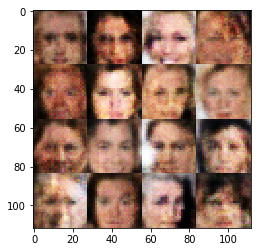

Epochs 3410/60000 Batch Step 245/3166 gen_loss = 0.1536814570426941..., disc_loss = -3.2326366901397705..., train using time = 11.079
Epochs 3420/60000 Batch Step 255/3166 gen_loss = 3.360304355621338..., disc_loss = -3.2685515880584717..., train using time = 12.427
Epochs 3430/60000 Batch Step 265/3166 gen_loss = 3.662527561187744..., disc_loss = -2.7777671813964844..., train using time = 11.513
Epochs 3440/60000 Batch Step 275/3166 gen_loss = 4.780189514160156..., disc_loss = -3.08862566947937..., train using time = 11.892
Epochs 3450/60000 Batch Step 285/3166 gen_loss = 2.8333756923675537..., disc_loss = -3.2298552989959717..., train using time = 11.169
Epochs 3460/60000 Batch Step 295/3166 gen_loss = 3.0971033573150635..., disc_loss = -3.2895781993865967..., train using time = 11.262
Epochs 3470/60000 Batch Step 305/3166 gen_loss = 1.5255615711212158..., disc_loss = -3.3159918785095215..., train using time = 11.425
Epochs 3480/60000 Batch Step 315/3166 gen_loss = 2.609253406524658.

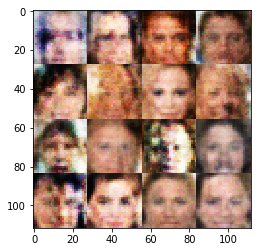

Epochs 3510/60000 Batch Step 345/3166 gen_loss = 2.8636221885681152..., disc_loss = -3.3778629302978516..., train using time = 11.165
Epochs 3520/60000 Batch Step 355/3166 gen_loss = 3.2094626426696777..., disc_loss = -3.2769036293029785..., train using time = 10.861
Epochs 3530/60000 Batch Step 365/3166 gen_loss = 5.138474941253662..., disc_loss = -2.975653648376465..., train using time = 11.016
Epochs 3540/60000 Batch Step 375/3166 gen_loss = 1.7548637390136719..., disc_loss = -3.226012706756592..., train using time = 11.164
Epochs 3550/60000 Batch Step 385/3166 gen_loss = 0.41334986686706543..., disc_loss = -2.9081006050109863..., train using time = 11.015
Epochs 3560/60000 Batch Step 395/3166 gen_loss = 4.505380630493164..., disc_loss = -2.832200288772583..., train using time = 11.173
Epochs 3570/60000 Batch Step 405/3166 gen_loss = 2.4703927040100098..., disc_loss = -2.908531904220581..., train using time = 11.053
Epochs 3580/60000 Batch Step 415/3166 gen_loss = 6.896467208862305.

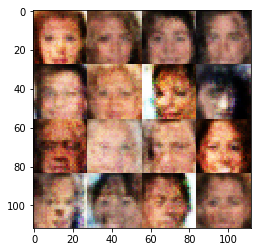

Epochs 3610/60000 Batch Step 445/3166 gen_loss = 0.9370650053024292..., disc_loss = -3.279411792755127..., train using time = 11.128
Epochs 3620/60000 Batch Step 455/3166 gen_loss = 1.5492479801177979..., disc_loss = -3.134718418121338..., train using time = 11.011
Epochs 3630/60000 Batch Step 465/3166 gen_loss = 4.236713409423828..., disc_loss = -3.246044635772705..., train using time = 10.983
Epochs 3640/60000 Batch Step 475/3166 gen_loss = 1.068066954612732..., disc_loss = -2.971886157989502..., train using time = 11.307
Epochs 3650/60000 Batch Step 485/3166 gen_loss = 1.720808982849121..., disc_loss = -3.0618035793304443..., train using time = 11.051
Epochs 3660/60000 Batch Step 495/3166 gen_loss = 0.20749783515930176..., disc_loss = -3.348970413208008..., train using time = 11.026
Epochs 3670/60000 Batch Step 505/3166 gen_loss = 3.0984387397766113..., disc_loss = -2.9914307594299316..., train using time = 11.070
Epochs 3680/60000 Batch Step 515/3166 gen_loss = 2.8650107383728027..

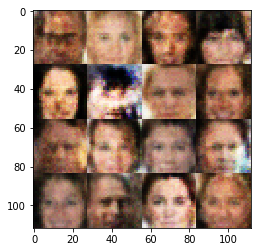

Epochs 3710/60000 Batch Step 545/3166 gen_loss = 3.196709156036377..., disc_loss = -3.204832077026367..., train using time = 11.072
Epochs 3720/60000 Batch Step 555/3166 gen_loss = 2.531141996383667..., disc_loss = -3.5431571006774902..., train using time = 11.227
Epochs 3730/60000 Batch Step 565/3166 gen_loss = 1.802490472793579..., disc_loss = -2.9262442588806152..., train using time = 11.019
Epochs 3740/60000 Batch Step 575/3166 gen_loss = -1.2474615573883057..., disc_loss = -2.860628366470337..., train using time = 10.932
Epochs 3750/60000 Batch Step 585/3166 gen_loss = 1.8119598627090454..., disc_loss = -3.1074471473693848..., train using time = 11.211
Epochs 3760/60000 Batch Step 595/3166 gen_loss = 1.3048038482666016..., disc_loss = -2.9780731201171875..., train using time = 10.948
Epochs 3770/60000 Batch Step 605/3166 gen_loss = 4.0070037841796875..., disc_loss = -3.044548511505127..., train using time = 11.282
Epochs 3780/60000 Batch Step 615/3166 gen_loss = 1.5229544639587402

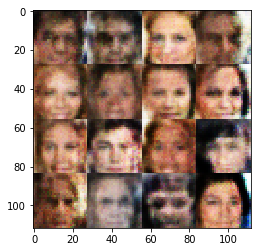

Epochs 3810/60000 Batch Step 645/3166 gen_loss = 5.4253363609313965..., disc_loss = -3.0063488483428955..., train using time = 10.970
Epochs 3820/60000 Batch Step 655/3166 gen_loss = 3.6733033657073975..., disc_loss = -2.9346725940704346..., train using time = 11.146
Epochs 3830/60000 Batch Step 665/3166 gen_loss = 1.3988635540008545..., disc_loss = -3.1331851482391357..., train using time = 11.040
Epochs 3840/60000 Batch Step 675/3166 gen_loss = 1.514843225479126..., disc_loss = -3.0424702167510986..., train using time = 11.015
Epochs 3850/60000 Batch Step 685/3166 gen_loss = 6.113365173339844..., disc_loss = -3.1695759296417236..., train using time = 11.146
Epochs 3860/60000 Batch Step 695/3166 gen_loss = 3.3950023651123047..., disc_loss = -2.9022443294525146..., train using time = 11.018
Epochs 3870/60000 Batch Step 705/3166 gen_loss = 2.2088265419006348..., disc_loss = -2.832873821258545..., train using time = 10.908
Epochs 3880/60000 Batch Step 715/3166 gen_loss = 4.28708410263061

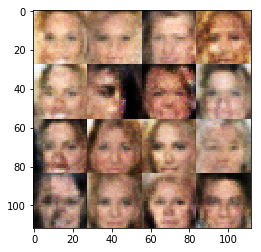

Epochs 3910/60000 Batch Step 745/3166 gen_loss = 2.324435234069824..., disc_loss = -2.942669630050659..., train using time = 11.057
Epochs 3920/60000 Batch Step 755/3166 gen_loss = 3.40671968460083..., disc_loss = -3.0163490772247314..., train using time = 12.326
Epochs 3930/60000 Batch Step 765/3166 gen_loss = 4.345852375030518..., disc_loss = -3.12796688079834..., train using time = 11.043
Epochs 3940/60000 Batch Step 775/3166 gen_loss = 1.4159929752349854..., disc_loss = -3.037036180496216..., train using time = 11.032
Epochs 3950/60000 Batch Step 785/3166 gen_loss = 3.151381254196167..., disc_loss = -2.6653952598571777..., train using time = 11.035
Epochs 3960/60000 Batch Step 795/3166 gen_loss = 1.1841593980789185..., disc_loss = -2.9710302352905273..., train using time = 11.147
Epochs 3970/60000 Batch Step 805/3166 gen_loss = 2.2834553718566895..., disc_loss = -3.0871152877807617..., train using time = 11.113
Epochs 3980/60000 Batch Step 815/3166 gen_loss = 2.8673996925354004...,

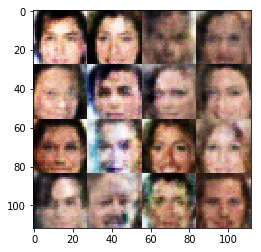

Epochs 4010/60000 Batch Step 845/3166 gen_loss = 2.730402946472168..., disc_loss = -2.5639076232910156..., train using time = 11.187
Epochs 4020/60000 Batch Step 855/3166 gen_loss = 2.5922484397888184..., disc_loss = -2.9125313758850098..., train using time = 11.006
Epochs 4030/60000 Batch Step 865/3166 gen_loss = 5.005281925201416..., disc_loss = -2.5330982208251953..., train using time = 11.139
Epochs 4040/60000 Batch Step 875/3166 gen_loss = 5.8690032958984375..., disc_loss = -2.5520334243774414..., train using time = 11.169
Epochs 4050/60000 Batch Step 885/3166 gen_loss = 1.5019208192825317..., disc_loss = -2.5504775047302246..., train using time = 11.035
Epochs 4060/60000 Batch Step 895/3166 gen_loss = 2.4984192848205566..., disc_loss = -2.8118560314178467..., train using time = 11.204
Epochs 4070/60000 Batch Step 905/3166 gen_loss = 3.711390495300293..., disc_loss = -2.8504984378814697..., train using time = 11.014
Epochs 4080/60000 Batch Step 915/3166 gen_loss = 4.0116868019104.

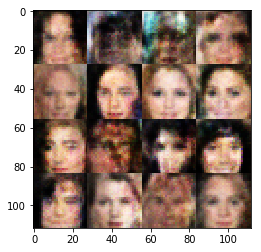

Epochs 4110/60000 Batch Step 945/3166 gen_loss = 7.043120384216309..., disc_loss = -2.6345925331115723..., train using time = 11.000
Epochs 4120/60000 Batch Step 955/3166 gen_loss = 2.9500327110290527..., disc_loss = -2.629242420196533..., train using time = 10.920
Epochs 4130/60000 Batch Step 965/3166 gen_loss = 4.6756696701049805..., disc_loss = -2.8820512294769287..., train using time = 11.057
Epochs 4140/60000 Batch Step 975/3166 gen_loss = 5.497829437255859..., disc_loss = -2.9460089206695557..., train using time = 11.149
Epochs 4150/60000 Batch Step 985/3166 gen_loss = 6.174561500549316..., disc_loss = -2.695819616317749..., train using time = 11.026
Epochs 4160/60000 Batch Step 995/3166 gen_loss = 3.0969529151916504..., disc_loss = -2.6635680198669434..., train using time = 12.106
Epochs 4170/60000 Batch Step 1005/3166 gen_loss = 5.542055130004883..., disc_loss = -2.7089829444885254..., train using time = 11.205
Epochs 4180/60000 Batch Step 1015/3166 gen_loss = 3.759067535400390

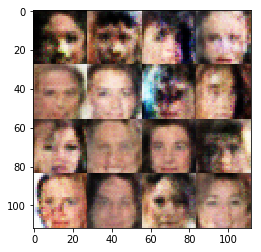

Epochs 4210/60000 Batch Step 1045/3166 gen_loss = 2.990924596786499..., disc_loss = -2.9826650619506836..., train using time = 11.178
Epochs 4220/60000 Batch Step 1055/3166 gen_loss = 2.4503514766693115..., disc_loss = -2.6867337226867676..., train using time = 11.086
Epochs 4230/60000 Batch Step 1065/3166 gen_loss = 3.034470796585083..., disc_loss = -2.70540189743042..., train using time = 11.127
Epochs 4240/60000 Batch Step 1075/3166 gen_loss = 6.4986724853515625..., disc_loss = -2.523632526397705..., train using time = 11.691
Epochs 4250/60000 Batch Step 1085/3166 gen_loss = 6.778168678283691..., disc_loss = -2.494968891143799..., train using time = 10.928
Epochs 4260/60000 Batch Step 1095/3166 gen_loss = 5.145082950592041..., disc_loss = -2.8003461360931396..., train using time = 10.944
Epochs 4270/60000 Batch Step 1105/3166 gen_loss = 2.1160504817962646..., disc_loss = -2.8509459495544434..., train using time = 11.110
Epochs 4280/60000 Batch Step 1115/3166 gen_loss = 4.90347576141

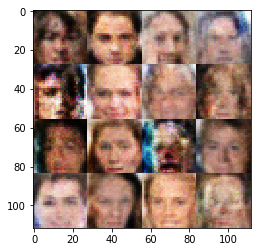

Epochs 4310/60000 Batch Step 1145/3166 gen_loss = 2.289637804031372..., disc_loss = -2.634770393371582..., train using time = 11.150
Epochs 4320/60000 Batch Step 1155/3166 gen_loss = 4.145228385925293..., disc_loss = -2.6093156337738037..., train using time = 11.172
Epochs 4330/60000 Batch Step 1165/3166 gen_loss = 5.656613349914551..., disc_loss = -2.779337167739868..., train using time = 11.291
Epochs 4340/60000 Batch Step 1175/3166 gen_loss = 5.602560997009277..., disc_loss = -2.7365002632141113..., train using time = 11.070
Epochs 4350/60000 Batch Step 1185/3166 gen_loss = 3.951287269592285..., disc_loss = -2.7954516410827637..., train using time = 11.140
Epochs 4360/60000 Batch Step 1195/3166 gen_loss = 4.286283493041992..., disc_loss = -2.8815417289733887..., train using time = 11.057
Epochs 4370/60000 Batch Step 1205/3166 gen_loss = 3.137300968170166..., disc_loss = -2.7934398651123047..., train using time = 11.050
Epochs 4380/60000 Batch Step 1215/3166 gen_loss = 2.958801269531

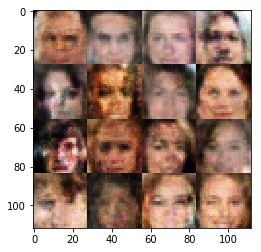

Epochs 4410/60000 Batch Step 1245/3166 gen_loss = 3.3256869316101074..., disc_loss = -2.81876277923584..., train using time = 11.207
Epochs 4420/60000 Batch Step 1255/3166 gen_loss = 6.228307247161865..., disc_loss = -2.3697075843811035..., train using time = 11.165
Epochs 4430/60000 Batch Step 1265/3166 gen_loss = 4.241099834442139..., disc_loss = -2.798262119293213..., train using time = 11.106
Epochs 4440/60000 Batch Step 1275/3166 gen_loss = 1.5719807147979736..., disc_loss = -2.6960110664367676..., train using time = 11.127
Epochs 4450/60000 Batch Step 1285/3166 gen_loss = 2.690847873687744..., disc_loss = -2.737178325653076..., train using time = 11.036
Epochs 4460/60000 Batch Step 1295/3166 gen_loss = 6.337762832641602..., disc_loss = -2.6968090534210205..., train using time = 11.206
Epochs 4470/60000 Batch Step 1305/3166 gen_loss = 7.865809917449951..., disc_loss = -2.775172710418701..., train using time = 11.027
Epochs 4480/60000 Batch Step 1315/3166 gen_loss = 4.6121816635131

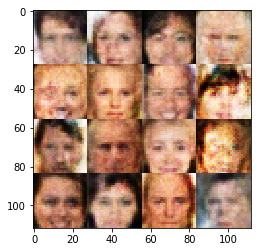

Epochs 4510/60000 Batch Step 1345/3166 gen_loss = 4.2243242263793945..., disc_loss = -2.77673602104187..., train using time = 11.027
Epochs 4520/60000 Batch Step 1355/3166 gen_loss = 2.8534340858459473..., disc_loss = -2.789297103881836..., train using time = 11.071
Epochs 4530/60000 Batch Step 1365/3166 gen_loss = 0.7217986583709717..., disc_loss = -2.3186020851135254..., train using time = 11.528
Epochs 4540/60000 Batch Step 1375/3166 gen_loss = 4.102348804473877..., disc_loss = -2.93971586227417..., train using time = 11.133
Epochs 4550/60000 Batch Step 1385/3166 gen_loss = 5.083722114562988..., disc_loss = -2.9586594104766846..., train using time = 11.021
Epochs 4560/60000 Batch Step 1395/3166 gen_loss = 5.221160888671875..., disc_loss = -2.630659818649292..., train using time = 11.194
Epochs 4570/60000 Batch Step 1405/3166 gen_loss = 6.2538042068481445..., disc_loss = -2.6490120887756348..., train using time = 10.978
Epochs 4580/60000 Batch Step 1415/3166 gen_loss = 5.176536083221

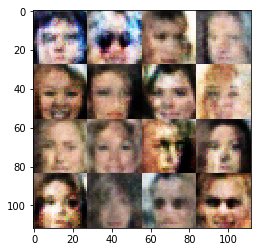

Epochs 4610/60000 Batch Step 1445/3166 gen_loss = 2.3309459686279297..., disc_loss = -2.640709638595581..., train using time = 10.977
Epochs 4620/60000 Batch Step 1455/3166 gen_loss = 3.533653974533081..., disc_loss = -2.375082015991211..., train using time = 11.043
Epochs 4630/60000 Batch Step 1465/3166 gen_loss = 5.097320556640625..., disc_loss = -2.775473117828369..., train using time = 11.102
Epochs 4640/60000 Batch Step 1475/3166 gen_loss = 6.196743965148926..., disc_loss = -2.557415246963501..., train using time = 10.965
Epochs 4650/60000 Batch Step 1485/3166 gen_loss = 5.641660213470459..., disc_loss = -2.705435276031494..., train using time = 10.840
Epochs 4660/60000 Batch Step 1495/3166 gen_loss = 3.737490653991699..., disc_loss = -2.853775978088379..., train using time = 11.022
Epochs 4670/60000 Batch Step 1505/3166 gen_loss = 5.1291351318359375..., disc_loss = -2.786942720413208..., train using time = 11.243
Epochs 4680/60000 Batch Step 1515/3166 gen_loss = 2.84136962890625.

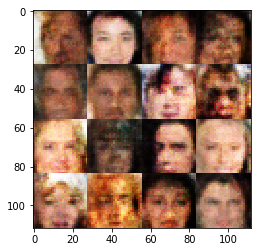

Epochs 4710/60000 Batch Step 1545/3166 gen_loss = 7.204855918884277..., disc_loss = -2.493196964263916..., train using time = 11.338
Epochs 4720/60000 Batch Step 1555/3166 gen_loss = 2.5332438945770264..., disc_loss = -2.59478497505188..., train using time = 11.332
Epochs 4730/60000 Batch Step 1565/3166 gen_loss = 7.348733901977539..., disc_loss = -2.3781633377075195..., train using time = 10.904
Epochs 4740/60000 Batch Step 1575/3166 gen_loss = 3.890415668487549..., disc_loss = -2.4210948944091797..., train using time = 11.005
Epochs 4750/60000 Batch Step 1585/3166 gen_loss = 4.445891380310059..., disc_loss = -2.4285950660705566..., train using time = 10.986
Epochs 4760/60000 Batch Step 1595/3166 gen_loss = 2.808166980743408..., disc_loss = -2.6426377296447754..., train using time = 10.993
Epochs 4770/60000 Batch Step 1605/3166 gen_loss = 5.594443321228027..., disc_loss = -2.8594276905059814..., train using time = 11.181
Epochs 4780/60000 Batch Step 1615/3166 gen_loss = -0.89519083499

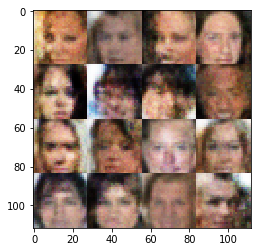

Epochs 4810/60000 Batch Step 1645/3166 gen_loss = 4.354720592498779..., disc_loss = -2.5852293968200684..., train using time = 10.887
Epochs 4820/60000 Batch Step 1655/3166 gen_loss = 4.7046613693237305..., disc_loss = -2.419619083404541..., train using time = 11.108
Epochs 4830/60000 Batch Step 1665/3166 gen_loss = 3.3511524200439453..., disc_loss = -2.485154390335083..., train using time = 11.013
Epochs 4840/60000 Batch Step 1675/3166 gen_loss = 5.1896443367004395..., disc_loss = -2.5931239128112793..., train using time = 11.039
Epochs 4850/60000 Batch Step 1685/3166 gen_loss = 2.8439524173736572..., disc_loss = -2.633941650390625..., train using time = 11.148
Epochs 4860/60000 Batch Step 1695/3166 gen_loss = 6.442980766296387..., disc_loss = -2.3440699577331543..., train using time = 10.956
Epochs 4870/60000 Batch Step 1705/3166 gen_loss = 6.295699119567871..., disc_loss = -2.477703094482422..., train using time = 11.060
Epochs 4880/60000 Batch Step 1715/3166 gen_loss = 5.0891475677

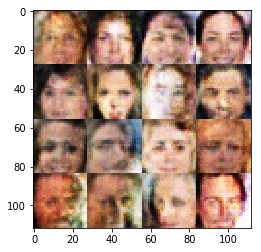

Epochs 4910/60000 Batch Step 1745/3166 gen_loss = 3.1012535095214844..., disc_loss = -2.432784080505371..., train using time = 11.045
Epochs 4920/60000 Batch Step 1755/3166 gen_loss = 3.0155112743377686..., disc_loss = -2.550990581512451..., train using time = 10.997
Epochs 4930/60000 Batch Step 1765/3166 gen_loss = 5.67075777053833..., disc_loss = -2.3867790699005127..., train using time = 10.970
Epochs 4940/60000 Batch Step 1775/3166 gen_loss = 5.8752360343933105..., disc_loss = -2.3842899799346924..., train using time = 11.107
Epochs 4950/60000 Batch Step 1785/3166 gen_loss = 6.044875144958496..., disc_loss = -2.4994826316833496..., train using time = 11.125
Epochs 4960/60000 Batch Step 1795/3166 gen_loss = 3.8443191051483154..., disc_loss = -2.782841205596924..., train using time = 11.062
Epochs 4970/60000 Batch Step 1805/3166 gen_loss = 0.37879160046577454..., disc_loss = -2.516407012939453..., train using time = 11.154
Epochs 4980/60000 Batch Step 1815/3166 gen_loss = 4.860015392

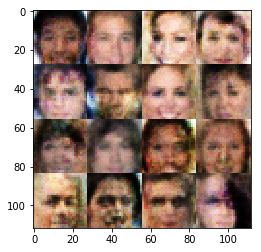

Epochs 5010/60000 Batch Step 1845/3166 gen_loss = 3.9907045364379883..., disc_loss = -2.5212063789367676..., train using time = 11.151
Epochs 5020/60000 Batch Step 1855/3166 gen_loss = 4.12066650390625..., disc_loss = -2.5813517570495605..., train using time = 11.110
Epochs 5030/60000 Batch Step 1865/3166 gen_loss = 6.287986755371094..., disc_loss = -2.45000958442688..., train using time = 11.202
Epochs 5040/60000 Batch Step 1875/3166 gen_loss = 3.9087934494018555..., disc_loss = -2.5464162826538086..., train using time = 11.025
Epochs 5050/60000 Batch Step 1885/3166 gen_loss = 4.081775665283203..., disc_loss = -2.180294990539551..., train using time = 11.714
Epochs 5060/60000 Batch Step 1895/3166 gen_loss = 5.780951976776123..., disc_loss = -1.95675790309906..., train using time = 11.139
Epochs 5070/60000 Batch Step 1905/3166 gen_loss = 5.531523704528809..., disc_loss = -2.6142616271972656..., train using time = 11.043
Epochs 5080/60000 Batch Step 1915/3166 gen_loss = 4.92165946960449

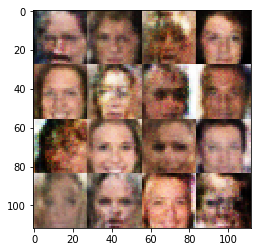

Epochs 5110/60000 Batch Step 1945/3166 gen_loss = 4.1174421310424805..., disc_loss = -2.5909721851348877..., train using time = 11.168
Epochs 5120/60000 Batch Step 1955/3166 gen_loss = 2.594369649887085..., disc_loss = -2.417591094970703..., train using time = 11.149
Epochs 5130/60000 Batch Step 1965/3166 gen_loss = 4.010610580444336..., disc_loss = -2.618710994720459..., train using time = 12.332
Epochs 5140/60000 Batch Step 1975/3166 gen_loss = 2.880530834197998..., disc_loss = -2.178718090057373..., train using time = 11.005
Epochs 5150/60000 Batch Step 1985/3166 gen_loss = 2.1770498752593994..., disc_loss = -2.3581032752990723..., train using time = 11.129
Epochs 5160/60000 Batch Step 1995/3166 gen_loss = 5.132995128631592..., disc_loss = -2.4542911052703857..., train using time = 11.116
Epochs 5170/60000 Batch Step 2005/3166 gen_loss = 5.350901126861572..., disc_loss = -2.3910326957702637..., train using time = 10.974
Epochs 5180/60000 Batch Step 2015/3166 gen_loss = 3.39299559593

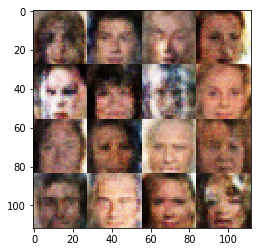

Epochs 5210/60000 Batch Step 2045/3166 gen_loss = 3.1978888511657715..., disc_loss = -2.7466368675231934..., train using time = 12.114
Epochs 5220/60000 Batch Step 2055/3166 gen_loss = 6.073195934295654..., disc_loss = -2.1889028549194336..., train using time = 11.250
Epochs 5230/60000 Batch Step 2065/3166 gen_loss = 5.653768539428711..., disc_loss = -2.423875331878662..., train using time = 11.028
Epochs 5240/60000 Batch Step 2075/3166 gen_loss = 3.7944912910461426..., disc_loss = -2.938509702682495..., train using time = 11.292
Epochs 5250/60000 Batch Step 2085/3166 gen_loss = 5.4787797927856445..., disc_loss = -2.3843889236450195..., train using time = 11.053
Epochs 5260/60000 Batch Step 2095/3166 gen_loss = 4.7077131271362305..., disc_loss = -2.3893673419952393..., train using time = 11.195
Epochs 5270/60000 Batch Step 2105/3166 gen_loss = 5.543341636657715..., disc_loss = -2.5183939933776855..., train using time = 11.118
Epochs 5280/60000 Batch Step 2115/3166 gen_loss = 3.80860662

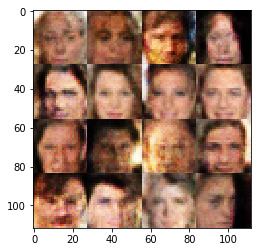

Epochs 5310/60000 Batch Step 2145/3166 gen_loss = 4.6031084060668945..., disc_loss = -2.490912675857544..., train using time = 11.080
Epochs 5320/60000 Batch Step 2155/3166 gen_loss = 1.554010272026062..., disc_loss = -2.2839128971099854..., train using time = 11.112
Epochs 5330/60000 Batch Step 2165/3166 gen_loss = 4.514697074890137..., disc_loss = -2.6086783409118652..., train using time = 11.237
Epochs 5340/60000 Batch Step 2175/3166 gen_loss = 4.563867568969727..., disc_loss = -2.4795143604278564..., train using time = 11.788
Epochs 5350/60000 Batch Step 2185/3166 gen_loss = 6.029644012451172..., disc_loss = -2.296473264694214..., train using time = 11.089
Epochs 5360/60000 Batch Step 2195/3166 gen_loss = 5.694395065307617..., disc_loss = -2.407331705093384..., train using time = 11.112
Epochs 5370/60000 Batch Step 2205/3166 gen_loss = 5.2119550704956055..., disc_loss = -2.587494373321533..., train using time = 12.473
Epochs 5380/60000 Batch Step 2215/3166 gen_loss = 4.301481246948

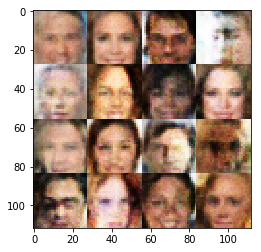

Epochs 5410/60000 Batch Step 2245/3166 gen_loss = 6.6469926834106445..., disc_loss = -2.291611433029175..., train using time = 11.125
Epochs 5420/60000 Batch Step 2255/3166 gen_loss = 4.040596961975098..., disc_loss = -2.670748472213745..., train using time = 11.094
Epochs 5430/60000 Batch Step 2265/3166 gen_loss = 4.069718360900879..., disc_loss = -2.3323159217834473..., train using time = 11.040
Epochs 5440/60000 Batch Step 2275/3166 gen_loss = 1.7617714405059814..., disc_loss = -2.315448760986328..., train using time = 10.949
Epochs 5450/60000 Batch Step 2285/3166 gen_loss = 2.892732620239258..., disc_loss = -2.337085723876953..., train using time = 12.184
Epochs 5460/60000 Batch Step 2295/3166 gen_loss = 4.895347595214844..., disc_loss = -2.25238037109375..., train using time = 11.257
Epochs 5470/60000 Batch Step 2305/3166 gen_loss = 5.939321994781494..., disc_loss = -2.3737282752990723..., train using time = 10.950
Epochs 5480/60000 Batch Step 2315/3166 gen_loss = 4.17310428619384

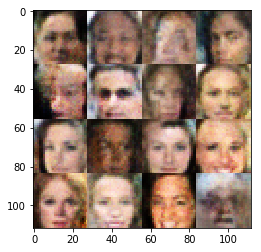

Epochs 5510/60000 Batch Step 2345/3166 gen_loss = 4.001800060272217..., disc_loss = -2.5293221473693848..., train using time = 11.176
Epochs 5520/60000 Batch Step 2355/3166 gen_loss = 6.91826057434082..., disc_loss = -2.343538284301758..., train using time = 11.024
Epochs 5530/60000 Batch Step 2365/3166 gen_loss = 4.624125957489014..., disc_loss = -2.846863269805908..., train using time = 11.054
Epochs 5540/60000 Batch Step 2375/3166 gen_loss = 4.387213706970215..., disc_loss = -2.4178478717803955..., train using time = 11.016
Epochs 5550/60000 Batch Step 2385/3166 gen_loss = 2.6112759113311768..., disc_loss = -2.183931589126587..., train using time = 11.462
Epochs 5560/60000 Batch Step 2395/3166 gen_loss = 3.6252684593200684..., disc_loss = -2.583484411239624..., train using time = 11.100
Epochs 5570/60000 Batch Step 2405/3166 gen_loss = 2.0280675888061523..., disc_loss = -1.963416337966919..., train using time = 11.022
Epochs 5580/60000 Batch Step 2415/3166 gen_loss = 5.1914916038513

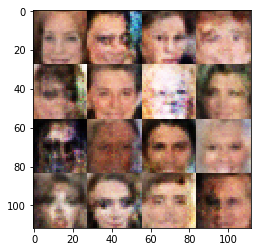

Epochs 5610/60000 Batch Step 2445/3166 gen_loss = 5.146320819854736..., disc_loss = -2.342569351196289..., train using time = 10.986
Epochs 5620/60000 Batch Step 2455/3166 gen_loss = 3.6901392936706543..., disc_loss = -2.3477485179901123..., train using time = 10.888
Epochs 5630/60000 Batch Step 2465/3166 gen_loss = 5.284034729003906..., disc_loss = -2.127094268798828..., train using time = 11.177
Epochs 5640/60000 Batch Step 2475/3166 gen_loss = 3.4738235473632812..., disc_loss = -2.1669020652770996..., train using time = 10.950
Epochs 5650/60000 Batch Step 2485/3166 gen_loss = 4.270755290985107..., disc_loss = -2.414538621902466..., train using time = 11.003
Epochs 5660/60000 Batch Step 2495/3166 gen_loss = 4.5513811111450195..., disc_loss = -2.3495333194732666..., train using time = 11.057
Epochs 5670/60000 Batch Step 2505/3166 gen_loss = 1.7086317539215088..., disc_loss = -1.969617486000061..., train using time = 11.041
Epochs 5680/60000 Batch Step 2515/3166 gen_loss = 6.1402816772

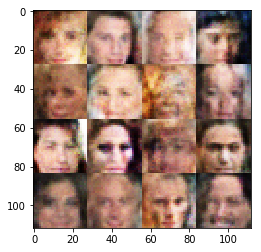

Epochs 5710/60000 Batch Step 2545/3166 gen_loss = 5.190897464752197..., disc_loss = -2.1676523685455322..., train using time = 11.002
Epochs 5720/60000 Batch Step 2555/3166 gen_loss = 1.95687735080719..., disc_loss = -2.0019102096557617..., train using time = 11.289
Epochs 5730/60000 Batch Step 2565/3166 gen_loss = 5.178582191467285..., disc_loss = -2.3437423706054688..., train using time = 11.321
Epochs 5740/60000 Batch Step 2575/3166 gen_loss = 5.369951248168945..., disc_loss = -2.341038227081299..., train using time = 11.154
Epochs 5750/60000 Batch Step 2585/3166 gen_loss = 2.0548815727233887..., disc_loss = -2.2655978202819824..., train using time = 10.998
Epochs 5760/60000 Batch Step 2595/3166 gen_loss = 7.407721519470215..., disc_loss = -2.297335386276245..., train using time = 11.145
Epochs 5770/60000 Batch Step 2605/3166 gen_loss = 4.913643836975098..., disc_loss = -2.1625471115112305..., train using time = 11.005
Epochs 5780/60000 Batch Step 2615/3166 gen_loss = 6.408661842346

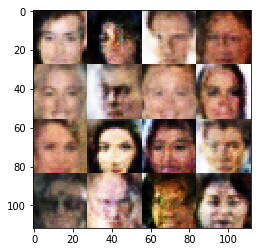

Epochs 5810/60000 Batch Step 2645/3166 gen_loss = 6.740645885467529..., disc_loss = -2.3540258407592773..., train using time = 11.237
Epochs 5820/60000 Batch Step 2655/3166 gen_loss = 4.458032608032227..., disc_loss = -2.2260100841522217..., train using time = 11.075
Epochs 5830/60000 Batch Step 2665/3166 gen_loss = 5.305411338806152..., disc_loss = -2.247886896133423..., train using time = 11.113
Epochs 5840/60000 Batch Step 2675/3166 gen_loss = 3.806837558746338..., disc_loss = -2.2447962760925293..., train using time = 10.991
Epochs 5850/60000 Batch Step 2685/3166 gen_loss = 4.889317512512207..., disc_loss = -2.031242609024048..., train using time = 11.013
Epochs 5860/60000 Batch Step 2695/3166 gen_loss = 3.678053379058838..., disc_loss = -2.0280327796936035..., train using time = 10.898
Epochs 5870/60000 Batch Step 2705/3166 gen_loss = 1.9418299198150635..., disc_loss = -2.154606580734253..., train using time = 11.043
Epochs 5880/60000 Batch Step 2715/3166 gen_loss = 4.486901283264

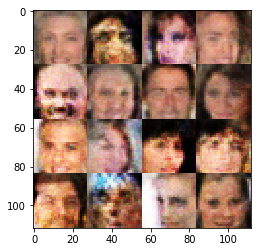

Epochs 5910/60000 Batch Step 2745/3166 gen_loss = 4.097344398498535..., disc_loss = -2.39308762550354..., train using time = 11.077
Epochs 5920/60000 Batch Step 2755/3166 gen_loss = 4.633297920227051..., disc_loss = -2.7180681228637695..., train using time = 11.069
Epochs 5930/60000 Batch Step 2765/3166 gen_loss = 5.317103385925293..., disc_loss = -2.497405529022217..., train using time = 11.151
Epochs 5940/60000 Batch Step 2775/3166 gen_loss = 4.87067174911499..., disc_loss = -2.1729350090026855..., train using time = 11.036
Epochs 5950/60000 Batch Step 2785/3166 gen_loss = 4.2319536209106445..., disc_loss = -2.1631715297698975..., train using time = 11.115
Epochs 5960/60000 Batch Step 2795/3166 gen_loss = 6.08006477355957..., disc_loss = -2.1722476482391357..., train using time = 11.106
Epochs 5970/60000 Batch Step 2805/3166 gen_loss = 4.105391502380371..., disc_loss = -2.5820281505584717..., train using time = 11.469
Epochs 5980/60000 Batch Step 2815/3166 gen_loss = 3.75616168975830

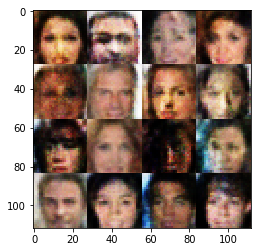

Epochs 6010/60000 Batch Step 2845/3166 gen_loss = 4.387225151062012..., disc_loss = -2.0805461406707764..., train using time = 11.110
Epochs 6020/60000 Batch Step 2855/3166 gen_loss = 5.272763729095459..., disc_loss = -2.4132626056671143..., train using time = 10.915
Epochs 6030/60000 Batch Step 2865/3166 gen_loss = 3.7594687938690186..., disc_loss = -2.166275978088379..., train using time = 11.016
Epochs 6040/60000 Batch Step 2875/3166 gen_loss = 6.5823822021484375..., disc_loss = -2.1495513916015625..., train using time = 11.051
Epochs 6050/60000 Batch Step 2885/3166 gen_loss = 2.496692180633545..., disc_loss = -2.266040086746216..., train using time = 11.026
Epochs 6060/60000 Batch Step 2895/3166 gen_loss = 4.822770118713379..., disc_loss = -2.1758816242218018..., train using time = 10.976
Epochs 6070/60000 Batch Step 2905/3166 gen_loss = 4.663590431213379..., disc_loss = -2.1678645610809326..., train using time = 11.050
Epochs 6080/60000 Batch Step 2915/3166 gen_loss = 4.2988181114

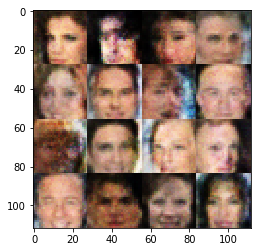

Epochs 6110/60000 Batch Step 2945/3166 gen_loss = 2.7056174278259277..., disc_loss = -2.372769832611084..., train using time = 11.081
Epochs 6120/60000 Batch Step 2955/3166 gen_loss = 3.1685521602630615..., disc_loss = -2.080033779144287..., train using time = 11.015
Epochs 6130/60000 Batch Step 2965/3166 gen_loss = 4.678838729858398..., disc_loss = -2.11611270904541..., train using time = 11.021
Epochs 6140/60000 Batch Step 2975/3166 gen_loss = 3.5686187744140625..., disc_loss = -1.940076470375061..., train using time = 11.079
Epochs 6150/60000 Batch Step 2985/3166 gen_loss = 5.740139961242676..., disc_loss = -2.3781237602233887..., train using time = 11.289
Epochs 6160/60000 Batch Step 2995/3166 gen_loss = 3.1786770820617676..., disc_loss = -2.1434988975524902..., train using time = 11.006
Epochs 6170/60000 Batch Step 3005/3166 gen_loss = 1.754528284072876..., disc_loss = -1.788426399230957..., train using time = 10.938
Epochs 6180/60000 Batch Step 3015/3166 gen_loss = 2.931923627853

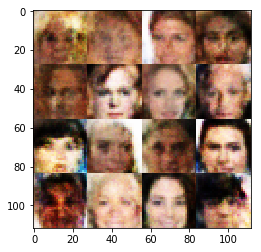

Epochs 6210/60000 Batch Step 3045/3166 gen_loss = 4.535573959350586..., disc_loss = -2.25555682182312..., train using time = 11.043
Epochs 6220/60000 Batch Step 3055/3166 gen_loss = 4.710543632507324..., disc_loss = -2.092855453491211..., train using time = 11.035
Epochs 6230/60000 Batch Step 3065/3166 gen_loss = 3.3752543926239014..., disc_loss = -2.1870293617248535..., train using time = 11.325
Epochs 6240/60000 Batch Step 3075/3166 gen_loss = 3.5964434146881104..., disc_loss = -1.9903907775878906..., train using time = 11.342
Epochs 6250/60000 Batch Step 3085/3166 gen_loss = 4.457470417022705..., disc_loss = -2.2951643466949463..., train using time = 11.295
Epochs 6260/60000 Batch Step 3095/3166 gen_loss = 5.246764183044434..., disc_loss = -2.2017621994018555..., train using time = 12.553
Epochs 6270/60000 Batch Step 3105/3166 gen_loss = 3.4389350414276123..., disc_loss = -2.2135112285614014..., train using time = 11.005
Epochs 6280/60000 Batch Step 3115/3166 gen_loss = 3.8701257705

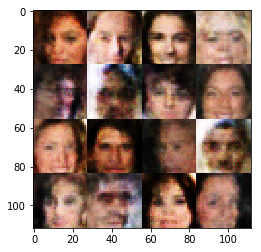

Epochs 6310/60000 Batch Step 3145/3166 gen_loss = 6.103423118591309..., disc_loss = -2.015625..., train using time = 11.079
Epochs 6320/60000 Batch Step 3155/3166 gen_loss = 4.318129062652588..., disc_loss = -2.024932384490967..., train using time = 11.066
Epochs 6330/60000 Batch Step 3165/3166 gen_loss = 6.305211544036865..., disc_loss = -2.1645028591156006..., train using time = 11.189
Epochs 6340/60000 Batch Step 10/3166 gen_loss = 3.7592720985412598..., disc_loss = -2.20935320854187..., train using time = 11.884
Epochs 6350/60000 Batch Step 20/3166 gen_loss = 5.544466495513916..., disc_loss = -2.170522451400757..., train using time = 11.450
Epochs 6360/60000 Batch Step 30/3166 gen_loss = 5.486700534820557..., disc_loss = -1.8347259759902954..., train using time = 11.116
Epochs 6370/60000 Batch Step 40/3166 gen_loss = 4.620616912841797..., disc_loss = -2.0794897079467773..., train using time = 11.114
Epochs 6380/60000 Batch Step 50/3166 gen_loss = 7.419841766357422..., disc_loss = -

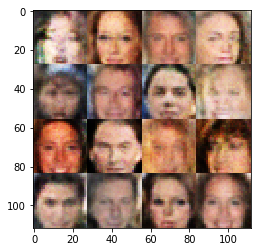

Epochs 6410/60000 Batch Step 80/3166 gen_loss = 4.646219730377197..., disc_loss = -2.2332050800323486..., train using time = 11.178
Epochs 6420/60000 Batch Step 90/3166 gen_loss = 5.527503490447998..., disc_loss = -2.0018813610076904..., train using time = 12.612
Epochs 6430/60000 Batch Step 100/3166 gen_loss = 3.805341958999634..., disc_loss = -2.3460164070129395..., train using time = 11.037
Epochs 6440/60000 Batch Step 110/3166 gen_loss = 3.074676752090454..., disc_loss = -2.1032066345214844..., train using time = 10.951
Epochs 6450/60000 Batch Step 120/3166 gen_loss = 3.3574466705322266..., disc_loss = -2.3435604572296143..., train using time = 10.973
Epochs 6460/60000 Batch Step 130/3166 gen_loss = 6.093175888061523..., disc_loss = -1.9251964092254639..., train using time = 11.214
Epochs 6470/60000 Batch Step 140/3166 gen_loss = 5.609922409057617..., disc_loss = -2.263063907623291..., train using time = 11.087
Epochs 6480/60000 Batch Step 150/3166 gen_loss = 5.027551651000977..., 

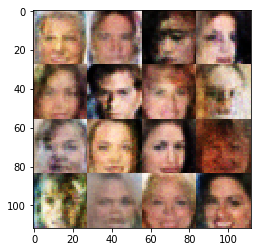

Epochs 6510/60000 Batch Step 180/3166 gen_loss = 3.2345566749572754..., disc_loss = -2.1841342449188232..., train using time = 11.053
Epochs 6520/60000 Batch Step 190/3166 gen_loss = 4.069165229797363..., disc_loss = -1.9813110828399658..., train using time = 11.000
Epochs 6530/60000 Batch Step 200/3166 gen_loss = 6.308145523071289..., disc_loss = -2.0677871704101562..., train using time = 11.013
Epochs 6540/60000 Batch Step 210/3166 gen_loss = 4.16883659362793..., disc_loss = -2.0336146354675293..., train using time = 11.216
Epochs 6550/60000 Batch Step 220/3166 gen_loss = 5.715883731842041..., disc_loss = -2.026562213897705..., train using time = 10.998
Epochs 6560/60000 Batch Step 230/3166 gen_loss = 2.2900452613830566..., disc_loss = -1.989019751548767..., train using time = 10.983
Epochs 6570/60000 Batch Step 240/3166 gen_loss = 3.3377907276153564..., disc_loss = -2.0279898643493652..., train using time = 11.079
Epochs 6580/60000 Batch Step 250/3166 gen_loss = 7.297862529754639...

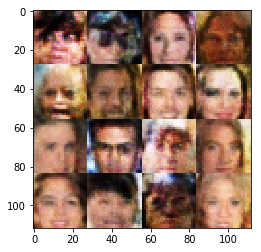

Epochs 6610/60000 Batch Step 280/3166 gen_loss = 4.731450080871582..., disc_loss = -2.0984795093536377..., train using time = 11.054
Epochs 6620/60000 Batch Step 290/3166 gen_loss = 4.678112030029297..., disc_loss = -2.395606279373169..., train using time = 11.128
Epochs 6630/60000 Batch Step 300/3166 gen_loss = 4.483582496643066..., disc_loss = -1.9046523571014404..., train using time = 11.014
Epochs 6640/60000 Batch Step 310/3166 gen_loss = 4.944462776184082..., disc_loss = -2.294938325881958..., train using time = 11.076
Epochs 6650/60000 Batch Step 320/3166 gen_loss = 5.64249324798584..., disc_loss = -2.2439379692077637..., train using time = 10.989
Epochs 6660/60000 Batch Step 330/3166 gen_loss = 3.1723809242248535..., disc_loss = -2.0506107807159424..., train using time = 10.969
Epochs 6670/60000 Batch Step 340/3166 gen_loss = 5.216755390167236..., disc_loss = -1.8310840129852295..., train using time = 11.202
Epochs 6680/60000 Batch Step 350/3166 gen_loss = 6.853297233581543..., 

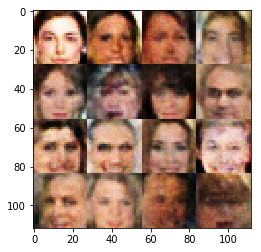

Epochs 6710/60000 Batch Step 380/3166 gen_loss = 3.763423442840576..., disc_loss = -2.1216399669647217..., train using time = 11.061
Epochs 6720/60000 Batch Step 390/3166 gen_loss = 2.944497585296631..., disc_loss = -2.037520170211792..., train using time = 11.111
Epochs 6730/60000 Batch Step 400/3166 gen_loss = 3.219459295272827..., disc_loss = -1.9899898767471313..., train using time = 11.044
Epochs 6740/60000 Batch Step 410/3166 gen_loss = 4.30503511428833..., disc_loss = -2.117764472961426..., train using time = 11.635
Epochs 6750/60000 Batch Step 420/3166 gen_loss = 6.217635154724121..., disc_loss = -1.9972031116485596..., train using time = 11.632
Epochs 6760/60000 Batch Step 430/3166 gen_loss = 4.957696914672852..., disc_loss = -2.2496445178985596..., train using time = 11.348
Epochs 6770/60000 Batch Step 440/3166 gen_loss = 6.422906875610352..., disc_loss = -2.06136417388916..., train using time = 11.130
Epochs 6780/60000 Batch Step 450/3166 gen_loss = 4.331708908081055..., dis

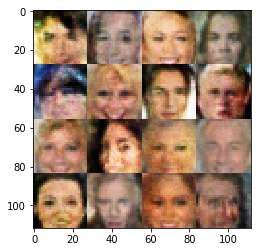

Epochs 6810/60000 Batch Step 480/3166 gen_loss = 4.991681098937988..., disc_loss = -1.8688907623291016..., train using time = 11.202
Epochs 6820/60000 Batch Step 490/3166 gen_loss = 5.111032009124756..., disc_loss = -2.158566951751709..., train using time = 11.193
Epochs 6830/60000 Batch Step 500/3166 gen_loss = 3.012537956237793..., disc_loss = -2.0550055503845215..., train using time = 11.125
Epochs 6840/60000 Batch Step 510/3166 gen_loss = 6.080840587615967..., disc_loss = -2.1791858673095703..., train using time = 11.099
Epochs 6850/60000 Batch Step 520/3166 gen_loss = 2.8966493606567383..., disc_loss = -2.0125088691711426..., train using time = 11.110
Epochs 6860/60000 Batch Step 530/3166 gen_loss = 2.819967746734619..., disc_loss = -2.0481503009796143..., train using time = 10.964
Epochs 6870/60000 Batch Step 540/3166 gen_loss = 5.330052375793457..., disc_loss = -1.8762801885604858..., train using time = 11.032
Epochs 6880/60000 Batch Step 550/3166 gen_loss = 4.148969650268555...

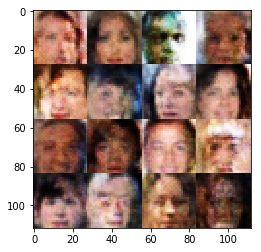

Epochs 6910/60000 Batch Step 580/3166 gen_loss = 3.1659786701202393..., disc_loss = -2.0006165504455566..., train using time = 10.990
Epochs 6920/60000 Batch Step 590/3166 gen_loss = 4.308661460876465..., disc_loss = -1.9705578088760376..., train using time = 11.031
Epochs 6930/60000 Batch Step 600/3166 gen_loss = 4.0773606300354..., disc_loss = -2.051811695098877..., train using time = 11.132
Epochs 6940/60000 Batch Step 610/3166 gen_loss = 3.2293996810913086..., disc_loss = -2.119725227355957..., train using time = 11.344
Epochs 6950/60000 Batch Step 620/3166 gen_loss = 3.8229098320007324..., disc_loss = -1.9453785419464111..., train using time = 11.107
Epochs 6960/60000 Batch Step 630/3166 gen_loss = 4.510540008544922..., disc_loss = -1.9174731969833374..., train using time = 11.196
Epochs 6970/60000 Batch Step 640/3166 gen_loss = 3.5725667476654053..., disc_loss = -2.076448917388916..., train using time = 11.038
Epochs 6980/60000 Batch Step 650/3166 gen_loss = 6.828947067260742...,

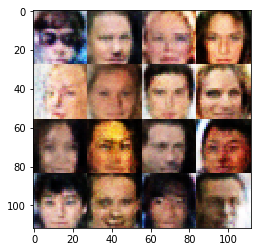

Epochs 7010/60000 Batch Step 680/3166 gen_loss = 4.135105133056641..., disc_loss = -1.9971895217895508..., train using time = 11.152
Epochs 7020/60000 Batch Step 690/3166 gen_loss = 6.266153335571289..., disc_loss = -2.0538077354431152..., train using time = 11.056
Epochs 7030/60000 Batch Step 700/3166 gen_loss = 3.7743473052978516..., disc_loss = -2.0367443561553955..., train using time = 11.049
Epochs 7040/60000 Batch Step 710/3166 gen_loss = 4.336690902709961..., disc_loss = -1.9086660146713257..., train using time = 11.112
Epochs 7050/60000 Batch Step 720/3166 gen_loss = 3.254819393157959..., disc_loss = -2.1363930702209473..., train using time = 11.117
Epochs 7060/60000 Batch Step 730/3166 gen_loss = 6.166617393493652..., disc_loss = -2.088524580001831..., train using time = 10.957
Epochs 7070/60000 Batch Step 740/3166 gen_loss = 7.008047103881836..., disc_loss = -1.986111044883728..., train using time = 11.142
Epochs 7080/60000 Batch Step 750/3166 gen_loss = 1.02729332447052..., 

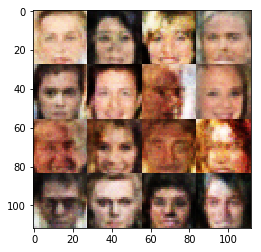

Epochs 7110/60000 Batch Step 780/3166 gen_loss = 3.813964605331421..., disc_loss = -1.9637714624404907..., train using time = 11.054
Epochs 7120/60000 Batch Step 790/3166 gen_loss = 3.961500644683838..., disc_loss = -2.0009918212890625..., train using time = 11.149
Epochs 7130/60000 Batch Step 800/3166 gen_loss = 4.3459577560424805..., disc_loss = -1.7690703868865967..., train using time = 11.055
Epochs 7140/60000 Batch Step 810/3166 gen_loss = 6.274279594421387..., disc_loss = -1.5001204013824463..., train using time = 11.115
Epochs 7150/60000 Batch Step 820/3166 gen_loss = 3.302910327911377..., disc_loss = -2.002291202545166..., train using time = 10.908
Epochs 7160/60000 Batch Step 830/3166 gen_loss = 4.434963226318359..., disc_loss = -2.1389822959899902..., train using time = 11.067
Epochs 7170/60000 Batch Step 840/3166 gen_loss = 3.505094051361084..., disc_loss = -1.9697401523590088..., train using time = 11.193
Epochs 7180/60000 Batch Step 850/3166 gen_loss = 3.99100923538208...,

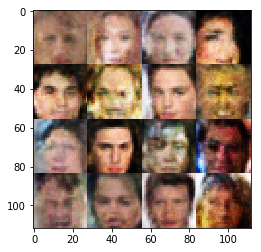

Epochs 7210/60000 Batch Step 880/3166 gen_loss = 4.692571640014648..., disc_loss = -2.0840113162994385..., train using time = 11.055
Epochs 7220/60000 Batch Step 890/3166 gen_loss = 3.436739206314087..., disc_loss = -1.9142214059829712..., train using time = 11.308
Epochs 7230/60000 Batch Step 900/3166 gen_loss = 6.294674873352051..., disc_loss = -1.900766134262085..., train using time = 10.989
Epochs 7240/60000 Batch Step 910/3166 gen_loss = 3.0509958267211914..., disc_loss = -1.661564588546753..., train using time = 11.017
Epochs 7250/60000 Batch Step 920/3166 gen_loss = 3.9735541343688965..., disc_loss = -1.9720779657363892..., train using time = 10.978
Epochs 7260/60000 Batch Step 930/3166 gen_loss = 2.2178878784179688..., disc_loss = -1.841104507446289..., train using time = 11.220
Epochs 7270/60000 Batch Step 940/3166 gen_loss = 6.54493522644043..., disc_loss = -1.7048447132110596..., train using time = 11.553
Epochs 7280/60000 Batch Step 950/3166 gen_loss = 2.5951154232025146...

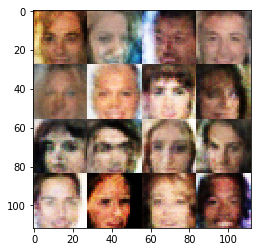

Epochs 7310/60000 Batch Step 980/3166 gen_loss = 4.994470596313477..., disc_loss = -1.7999141216278076..., train using time = 10.918
Epochs 7320/60000 Batch Step 990/3166 gen_loss = 3.433462619781494..., disc_loss = -1.9586139917373657..., train using time = 11.043
Epochs 7330/60000 Batch Step 1000/3166 gen_loss = 3.348325729370117..., disc_loss = -1.8754396438598633..., train using time = 11.106
Epochs 7340/60000 Batch Step 1010/3166 gen_loss = 5.981936454772949..., disc_loss = -2.029006004333496..., train using time = 11.086
Epochs 7350/60000 Batch Step 1020/3166 gen_loss = 5.98604679107666..., disc_loss = -1.8501695394515991..., train using time = 11.144
Epochs 7360/60000 Batch Step 1030/3166 gen_loss = 5.167417526245117..., disc_loss = -1.862067461013794..., train using time = 11.124
Epochs 7370/60000 Batch Step 1040/3166 gen_loss = 4.9095940589904785..., disc_loss = -2.00222110748291..., train using time = 11.147
Epochs 7380/60000 Batch Step 1050/3166 gen_loss = 1.920701265335083.

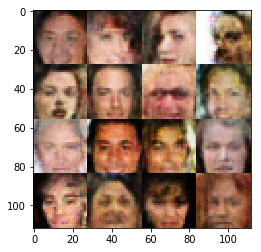

Epochs 7410/60000 Batch Step 1080/3166 gen_loss = 3.194683313369751..., disc_loss = -1.831311821937561..., train using time = 11.047
Epochs 7420/60000 Batch Step 1090/3166 gen_loss = 4.515290260314941..., disc_loss = -1.8946377038955688..., train using time = 10.944
Epochs 7430/60000 Batch Step 1100/3166 gen_loss = 4.1599626541137695..., disc_loss = -2.016781806945801..., train using time = 11.170
Epochs 7440/60000 Batch Step 1110/3166 gen_loss = 5.621573448181152..., disc_loss = -1.8836132287979126..., train using time = 11.126
Epochs 7450/60000 Batch Step 1120/3166 gen_loss = 4.334704399108887..., disc_loss = -1.8850473165512085..., train using time = 11.167
Epochs 7460/60000 Batch Step 1130/3166 gen_loss = 3.8528594970703125..., disc_loss = -1.9750455617904663..., train using time = 11.146
Epochs 7470/60000 Batch Step 1140/3166 gen_loss = 3.2843565940856934..., disc_loss = -1.8073005676269531..., train using time = 11.210
Epochs 7480/60000 Batch Step 1150/3166 gen_loss = 3.730028390

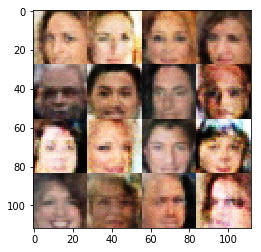

Epochs 7510/60000 Batch Step 1180/3166 gen_loss = 4.379212379455566..., disc_loss = -1.9279829263687134..., train using time = 11.260
Epochs 7520/60000 Batch Step 1190/3166 gen_loss = 3.676219940185547..., disc_loss = -2.034440040588379..., train using time = 11.077
Epochs 7530/60000 Batch Step 1200/3166 gen_loss = 2.5776896476745605..., disc_loss = -1.8434737920761108..., train using time = 10.982
Epochs 7540/60000 Batch Step 1210/3166 gen_loss = 6.108443260192871..., disc_loss = -1.8775303363800049..., train using time = 11.105
Epochs 7550/60000 Batch Step 1220/3166 gen_loss = 4.9507527351379395..., disc_loss = -1.9149906635284424..., train using time = 11.110
Epochs 7560/60000 Batch Step 1230/3166 gen_loss = 4.4583740234375..., disc_loss = -1.7584598064422607..., train using time = 11.033
Epochs 7570/60000 Batch Step 1240/3166 gen_loss = 3.576711654663086..., disc_loss = -1.966957688331604..., train using time = 10.990
Epochs 7580/60000 Batch Step 1250/3166 gen_loss = 5.024811744689

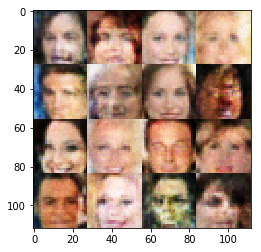

Epochs 7610/60000 Batch Step 1280/3166 gen_loss = 4.404666423797607..., disc_loss = -2.0642333030700684..., train using time = 10.919
Epochs 7620/60000 Batch Step 1290/3166 gen_loss = 3.673124074935913..., disc_loss = -1.7171332836151123..., train using time = 11.116
Epochs 7630/60000 Batch Step 1300/3166 gen_loss = 4.831760883331299..., disc_loss = -1.8009954690933228..., train using time = 12.249
Epochs 7640/60000 Batch Step 1310/3166 gen_loss = 4.477452278137207..., disc_loss = -1.6334072351455688..., train using time = 11.139
Epochs 7650/60000 Batch Step 1320/3166 gen_loss = 3.488706588745117..., disc_loss = -1.8546642065048218..., train using time = 11.100
Epochs 7660/60000 Batch Step 1330/3166 gen_loss = 4.917879104614258..., disc_loss = -1.8694705963134766..., train using time = 11.147
Epochs 7670/60000 Batch Step 1340/3166 gen_loss = 4.356839179992676..., disc_loss = -1.884971261024475..., train using time = 11.121
Epochs 7680/60000 Batch Step 1350/3166 gen_loss = 5.73019552230

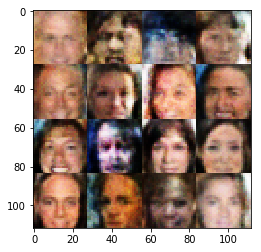

Epochs 7710/60000 Batch Step 1380/3166 gen_loss = 3.8545384407043457..., disc_loss = -1.6326534748077393..., train using time = 12.162
Epochs 7720/60000 Batch Step 1390/3166 gen_loss = 5.677605628967285..., disc_loss = -1.9192450046539307..., train using time = 10.902
Epochs 7730/60000 Batch Step 1400/3166 gen_loss = 1.9742765426635742..., disc_loss = -1.8466583490371704..., train using time = 11.353
Epochs 7740/60000 Batch Step 1410/3166 gen_loss = 4.723573684692383..., disc_loss = -1.6564964056015015..., train using time = 11.144
Epochs 7750/60000 Batch Step 1420/3166 gen_loss = 4.088432312011719..., disc_loss = -1.8840421438217163..., train using time = 11.041
Epochs 7760/60000 Batch Step 1430/3166 gen_loss = 3.470244884490967..., disc_loss = -1.656898856163025..., train using time = 11.112
Epochs 7770/60000 Batch Step 1440/3166 gen_loss = 5.916390419006348..., disc_loss = -1.8811012506484985..., train using time = 11.153
Epochs 7780/60000 Batch Step 1450/3166 gen_loss = 3.573759317

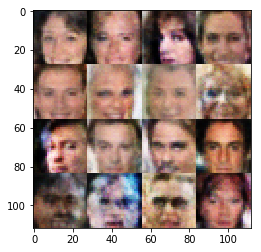

Epochs 7810/60000 Batch Step 1480/3166 gen_loss = 2.8055100440979004..., disc_loss = -1.8386577367782593..., train using time = 11.373
Epochs 7820/60000 Batch Step 1490/3166 gen_loss = 2.0796265602111816..., disc_loss = -1.9066247940063477..., train using time = 11.497
Epochs 7830/60000 Batch Step 1500/3166 gen_loss = 2.022296667098999..., disc_loss = -1.6531413793563843..., train using time = 11.348
Epochs 7840/60000 Batch Step 1510/3166 gen_loss = 5.003237724304199..., disc_loss = -1.913468599319458..., train using time = 11.213
Epochs 7850/60000 Batch Step 1520/3166 gen_loss = 5.6160888671875..., disc_loss = -1.8289158344268799..., train using time = 11.126
Epochs 7860/60000 Batch Step 1530/3166 gen_loss = 3.829371452331543..., disc_loss = -1.76287841796875..., train using time = 11.142
Epochs 7870/60000 Batch Step 1540/3166 gen_loss = 1.7826868295669556..., disc_loss = -1.907090425491333..., train using time = 11.273
Epochs 7880/60000 Batch Step 1550/3166 gen_loss = 4.3064270019531

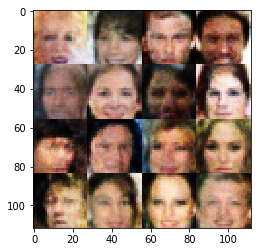

Epochs 7910/60000 Batch Step 1580/3166 gen_loss = 4.280908107757568..., disc_loss = -1.7665313482284546..., train using time = 11.177
Epochs 7920/60000 Batch Step 1590/3166 gen_loss = 2.851783514022827..., disc_loss = -1.8732120990753174..., train using time = 11.117
Epochs 7930/60000 Batch Step 1600/3166 gen_loss = 5.334203720092773..., disc_loss = -1.677018165588379..., train using time = 11.073
Epochs 7940/60000 Batch Step 1610/3166 gen_loss = 3.2104597091674805..., disc_loss = -1.777590036392212..., train using time = 11.134
Epochs 7950/60000 Batch Step 1620/3166 gen_loss = 4.100966453552246..., disc_loss = -1.8878352642059326..., train using time = 11.177
Epochs 7960/60000 Batch Step 1630/3166 gen_loss = 3.4359114170074463..., disc_loss = -1.5301355123519897..., train using time = 11.041
Epochs 7970/60000 Batch Step 1640/3166 gen_loss = 5.954890727996826..., disc_loss = -1.6644588708877563..., train using time = 11.121
Epochs 7980/60000 Batch Step 1650/3166 gen_loss = 5.0156574249

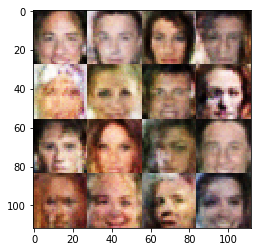

Epochs 8010/60000 Batch Step 1680/3166 gen_loss = 3.4341013431549072..., disc_loss = -1.6991920471191406..., train using time = 11.168
Epochs 8020/60000 Batch Step 1690/3166 gen_loss = 4.243427276611328..., disc_loss = -1.8404079675674438..., train using time = 11.091
Epochs 8030/60000 Batch Step 1700/3166 gen_loss = 3.6166303157806396..., disc_loss = -1.6691116094589233..., train using time = 11.099
Epochs 8040/60000 Batch Step 1710/3166 gen_loss = 5.028280735015869..., disc_loss = -1.886574387550354..., train using time = 11.133
Epochs 8050/60000 Batch Step 1720/3166 gen_loss = 4.300403594970703..., disc_loss = -1.726499319076538..., train using time = 11.092
Epochs 8060/60000 Batch Step 1730/3166 gen_loss = 4.278554916381836..., disc_loss = -1.9990352392196655..., train using time = 11.123
Epochs 8070/60000 Batch Step 1740/3166 gen_loss = 3.9375863075256348..., disc_loss = -1.6778627634048462..., train using time = 11.051
Epochs 8080/60000 Batch Step 1750/3166 gen_loss = 3.546546459

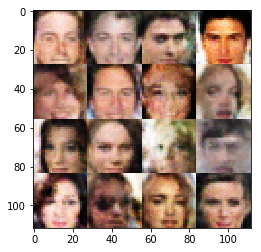

Epochs 8110/60000 Batch Step 1780/3166 gen_loss = 4.954643249511719..., disc_loss = -1.6227920055389404..., train using time = 11.056
Epochs 8120/60000 Batch Step 1790/3166 gen_loss = 3.1284427642822266..., disc_loss = -1.8624770641326904..., train using time = 11.132
Epochs 8130/60000 Batch Step 1800/3166 gen_loss = 3.0960869789123535..., disc_loss = -1.7691606283187866..., train using time = 11.146
Epochs 8140/60000 Batch Step 1810/3166 gen_loss = 2.8908541202545166..., disc_loss = -1.854609489440918..., train using time = 11.177
Epochs 8150/60000 Batch Step 1820/3166 gen_loss = 5.27677059173584..., disc_loss = -1.7346947193145752..., train using time = 11.073
Epochs 8160/60000 Batch Step 1830/3166 gen_loss = 3.7713358402252197..., disc_loss = -1.8214308023452759..., train using time = 11.276
Epochs 8170/60000 Batch Step 1840/3166 gen_loss = 2.395958423614502..., disc_loss = -1.7864954471588135..., train using time = 11.096
Epochs 8180/60000 Batch Step 1850/3166 gen_loss = 2.33853983

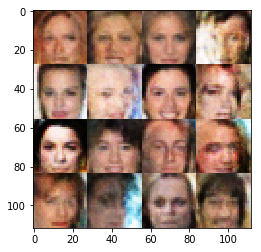

Epochs 8210/60000 Batch Step 1880/3166 gen_loss = 5.713185787200928..., disc_loss = -1.8412498235702515..., train using time = 10.966
Epochs 8220/60000 Batch Step 1890/3166 gen_loss = 3.270623207092285..., disc_loss = -1.7379926443099976..., train using time = 11.056
Epochs 8230/60000 Batch Step 1900/3166 gen_loss = 3.783663272857666..., disc_loss = -1.9261448383331299..., train using time = 11.147
Epochs 8240/60000 Batch Step 1910/3166 gen_loss = 3.8242313861846924..., disc_loss = -1.8336693048477173..., train using time = 11.075
Epochs 8250/60000 Batch Step 1920/3166 gen_loss = 3.179112434387207..., disc_loss = -2.010451078414917..., train using time = 11.103
Epochs 8260/60000 Batch Step 1930/3166 gen_loss = 4.243743419647217..., disc_loss = -1.6917335987091064..., train using time = 11.167
Epochs 8270/60000 Batch Step 1940/3166 gen_loss = 2.6163876056671143..., disc_loss = -1.806173324584961..., train using time = 11.037
Epochs 8280/60000 Batch Step 1950/3166 gen_loss = 2.3156681060

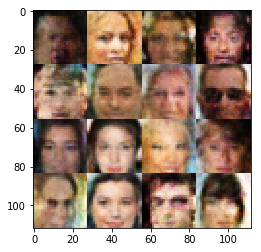

Epochs 8310/60000 Batch Step 1980/3166 gen_loss = 3.3235225677490234..., disc_loss = -1.9321119785308838..., train using time = 11.105
Epochs 8320/60000 Batch Step 1990/3166 gen_loss = 4.894534111022949..., disc_loss = -1.5189872980117798..., train using time = 11.057
Epochs 8330/60000 Batch Step 2000/3166 gen_loss = 4.732771873474121..., disc_loss = -1.9125347137451172..., train using time = 11.093
Epochs 8340/60000 Batch Step 2010/3166 gen_loss = 4.51041316986084..., disc_loss = -1.744255781173706..., train using time = 11.144
Epochs 8350/60000 Batch Step 2020/3166 gen_loss = 1.7320741415023804..., disc_loss = -1.7124780416488647..., train using time = 11.222
Epochs 8360/60000 Batch Step 2030/3166 gen_loss = 4.258393287658691..., disc_loss = -1.7676732540130615..., train using time = 11.170
Epochs 8370/60000 Batch Step 2040/3166 gen_loss = 2.6586990356445312..., disc_loss = -1.7260452508926392..., train using time = 11.114
Epochs 8380/60000 Batch Step 2050/3166 gen_loss = 2.721408128

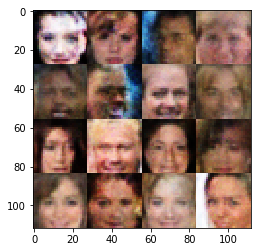

Epochs 8410/60000 Batch Step 2080/3166 gen_loss = 3.9090514183044434..., disc_loss = -1.663002610206604..., train using time = 12.780
Epochs 8420/60000 Batch Step 2090/3166 gen_loss = 3.0149130821228027..., disc_loss = -1.7025703191757202..., train using time = 12.231
Epochs 8430/60000 Batch Step 2100/3166 gen_loss = 4.516871452331543..., disc_loss = -1.6805191040039062..., train using time = 11.862
Epochs 8440/60000 Batch Step 2110/3166 gen_loss = 4.438896179199219..., disc_loss = -1.819598913192749..., train using time = 11.339
Epochs 8450/60000 Batch Step 2120/3166 gen_loss = 4.1485276222229..., disc_loss = -1.7834827899932861..., train using time = 11.035
Epochs 8460/60000 Batch Step 2130/3166 gen_loss = 3.6008810997009277..., disc_loss = -1.8452333211898804..., train using time = 11.028
Epochs 8470/60000 Batch Step 2140/3166 gen_loss = 3.814624309539795..., disc_loss = -1.816074013710022..., train using time = 11.034
Epochs 8480/60000 Batch Step 2150/3166 gen_loss = 4.104685306549

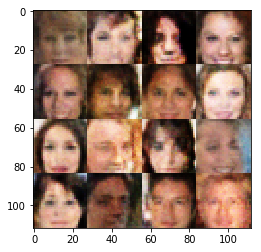

Epochs 8510/60000 Batch Step 2180/3166 gen_loss = 3.272461175918579..., disc_loss = -1.5514394044876099..., train using time = 11.144
Epochs 8520/60000 Batch Step 2190/3166 gen_loss = 5.324950218200684..., disc_loss = -1.8222124576568604..., train using time = 11.138
Epochs 8530/60000 Batch Step 2200/3166 gen_loss = 4.627857208251953..., disc_loss = -1.8111960887908936..., train using time = 11.179
Epochs 8540/60000 Batch Step 2210/3166 gen_loss = 3.183488130569458..., disc_loss = -1.8058717250823975..., train using time = 11.160
Epochs 8550/60000 Batch Step 2220/3166 gen_loss = 2.5878348350524902..., disc_loss = -1.6836971044540405..., train using time = 11.191
Epochs 8560/60000 Batch Step 2230/3166 gen_loss = 4.763454437255859..., disc_loss = -1.7642133235931396..., train using time = 11.221
Epochs 8570/60000 Batch Step 2240/3166 gen_loss = 1.5951039791107178..., disc_loss = -1.8240740299224854..., train using time = 11.100
Epochs 8580/60000 Batch Step 2250/3166 gen_loss = 3.76201772

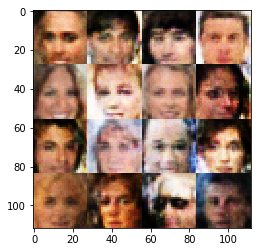

Epochs 8610/60000 Batch Step 2280/3166 gen_loss = 3.118170976638794..., disc_loss = -1.6853115558624268..., train using time = 11.159
Epochs 8620/60000 Batch Step 2290/3166 gen_loss = 3.476684093475342..., disc_loss = -1.7277225255966187..., train using time = 11.234
Epochs 8630/60000 Batch Step 2300/3166 gen_loss = 4.079911231994629..., disc_loss = -1.6819241046905518..., train using time = 11.148
Epochs 8640/60000 Batch Step 2310/3166 gen_loss = 2.829399585723877..., disc_loss = -1.8729196786880493..., train using time = 11.029
Epochs 8650/60000 Batch Step 2320/3166 gen_loss = 1.9739426374435425..., disc_loss = -1.6082435846328735..., train using time = 11.120
Epochs 8660/60000 Batch Step 2330/3166 gen_loss = 3.787982702255249..., disc_loss = -1.743546485900879..., train using time = 11.025
Epochs 8670/60000 Batch Step 2340/3166 gen_loss = 2.8149309158325195..., disc_loss = -1.7587394714355469..., train using time = 11.133
Epochs 8680/60000 Batch Step 2350/3166 gen_loss = 5.115785121

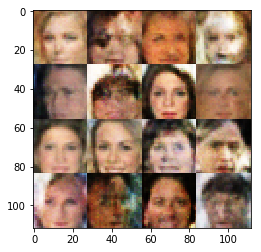

Epochs 8710/60000 Batch Step 2380/3166 gen_loss = 4.146683216094971..., disc_loss = -1.8026368618011475..., train using time = 11.206
Epochs 8720/60000 Batch Step 2390/3166 gen_loss = 3.542001724243164..., disc_loss = -1.8564420938491821..., train using time = 11.222
Epochs 8730/60000 Batch Step 2400/3166 gen_loss = 3.019317150115967..., disc_loss = -1.5085259675979614..., train using time = 11.095
Epochs 8740/60000 Batch Step 2410/3166 gen_loss = 3.5253713130950928..., disc_loss = -1.8904225826263428..., train using time = 11.104
Epochs 8750/60000 Batch Step 2420/3166 gen_loss = 3.4342284202575684..., disc_loss = -1.7180054187774658..., train using time = 11.881
Epochs 8760/60000 Batch Step 2430/3166 gen_loss = 4.967455863952637..., disc_loss = -1.6973421573638916..., train using time = 11.303
Epochs 8770/60000 Batch Step 2440/3166 gen_loss = 3.054391860961914..., disc_loss = -1.7515594959259033..., train using time = 11.033
Epochs 8780/60000 Batch Step 2450/3166 gen_loss = 4.10852241

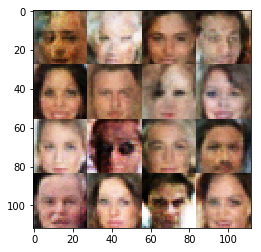

Epochs 8810/60000 Batch Step 2480/3166 gen_loss = 1.5726678371429443..., disc_loss = -1.71541428565979..., train using time = 11.083
Epochs 8820/60000 Batch Step 2490/3166 gen_loss = 3.2592263221740723..., disc_loss = -1.708225965499878..., train using time = 11.064
Epochs 8830/60000 Batch Step 2500/3166 gen_loss = 3.8170619010925293..., disc_loss = -1.6737244129180908..., train using time = 11.574
Epochs 8840/60000 Batch Step 2510/3166 gen_loss = 3.7610983848571777..., disc_loss = -1.618309736251831..., train using time = 11.148
Epochs 8850/60000 Batch Step 2520/3166 gen_loss = 3.749324321746826..., disc_loss = -1.8444181680679321..., train using time = 11.157
Epochs 8860/60000 Batch Step 2530/3166 gen_loss = 4.0346221923828125..., disc_loss = -1.60146164894104..., train using time = 11.091
Epochs 8870/60000 Batch Step 2540/3166 gen_loss = 3.9582366943359375..., disc_loss = -1.7453784942626953..., train using time = 11.049
Epochs 8880/60000 Batch Step 2550/3166 gen_loss = 2.7046573162

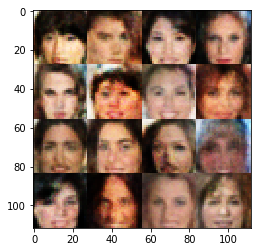

Epochs 8910/60000 Batch Step 2580/3166 gen_loss = 4.046572208404541..., disc_loss = -1.7854034900665283..., train using time = 10.971
Epochs 8920/60000 Batch Step 2590/3166 gen_loss = 3.82444429397583..., disc_loss = -1.9251508712768555..., train using time = 11.089
Epochs 8930/60000 Batch Step 2600/3166 gen_loss = 2.361624240875244..., disc_loss = -1.4903370141983032..., train using time = 11.152
Epochs 8940/60000 Batch Step 2610/3166 gen_loss = 5.702816009521484..., disc_loss = -1.6129531860351562..., train using time = 11.025
Epochs 8950/60000 Batch Step 2620/3166 gen_loss = 3.3537204265594482..., disc_loss = -1.6933557987213135..., train using time = 10.995
Epochs 8960/60000 Batch Step 2630/3166 gen_loss = 2.8942837715148926..., disc_loss = -1.6260483264923096..., train using time = 11.083
Epochs 8970/60000 Batch Step 2640/3166 gen_loss = 5.8574981689453125..., disc_loss = -1.4252246618270874..., train using time = 11.036
Epochs 8980/60000 Batch Step 2650/3166 gen_loss = 3.34236502

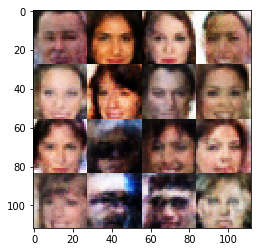

Epochs 9010/60000 Batch Step 2680/3166 gen_loss = 3.684676170349121..., disc_loss = -1.7513443231582642..., train using time = 10.995
Epochs 9020/60000 Batch Step 2690/3166 gen_loss = 1.9025421142578125..., disc_loss = -1.509088397026062..., train using time = 11.074
Epochs 9030/60000 Batch Step 2700/3166 gen_loss = 3.7006077766418457..., disc_loss = -1.4841058254241943..., train using time = 11.120
Epochs 9040/60000 Batch Step 2710/3166 gen_loss = 3.4683985710144043..., disc_loss = -1.6524686813354492..., train using time = 11.153
Epochs 9050/60000 Batch Step 2720/3166 gen_loss = 3.9547080993652344..., disc_loss = -1.5865378379821777..., train using time = 11.003
Epochs 9060/60000 Batch Step 2730/3166 gen_loss = 3.1391334533691406..., disc_loss = -1.5910230875015259..., train using time = 11.164
Epochs 9070/60000 Batch Step 2740/3166 gen_loss = 4.464724540710449..., disc_loss = -1.7242485284805298..., train using time = 11.078
Epochs 9080/60000 Batch Step 2750/3166 gen_loss = 4.376717

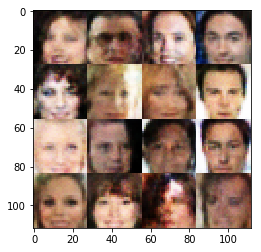

Epochs 9110/60000 Batch Step 2780/3166 gen_loss = 3.8347487449645996..., disc_loss = -1.8268121480941772..., train using time = 11.143
Epochs 9120/60000 Batch Step 2790/3166 gen_loss = 3.6391050815582275..., disc_loss = -1.696607232093811..., train using time = 11.009
Epochs 9130/60000 Batch Step 2800/3166 gen_loss = 4.048547744750977..., disc_loss = -1.9603850841522217..., train using time = 11.528
Epochs 9140/60000 Batch Step 2810/3166 gen_loss = 3.921440839767456..., disc_loss = -1.6431941986083984..., train using time = 11.123
Epochs 9150/60000 Batch Step 2820/3166 gen_loss = 4.390442371368408..., disc_loss = -1.7166244983673096..., train using time = 11.095
Epochs 9160/60000 Batch Step 2830/3166 gen_loss = 4.137838363647461..., disc_loss = -1.638755440711975..., train using time = 11.050
Epochs 9170/60000 Batch Step 2840/3166 gen_loss = 2.5923399925231934..., disc_loss = -1.6212791204452515..., train using time = 11.210
Epochs 9180/60000 Batch Step 2850/3166 gen_loss = 4.993533134

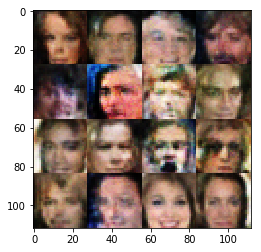

Epochs 9210/60000 Batch Step 2880/3166 gen_loss = 2.7564752101898193..., disc_loss = -1.6166343688964844..., train using time = 10.975
Epochs 9220/60000 Batch Step 2890/3166 gen_loss = 2.0767102241516113..., disc_loss = -1.6617701053619385..., train using time = 10.967
Epochs 9230/60000 Batch Step 2900/3166 gen_loss = 4.1037092208862305..., disc_loss = -1.6679298877716064..., train using time = 11.100
Epochs 9240/60000 Batch Step 2910/3166 gen_loss = 3.3043620586395264..., disc_loss = -1.5084179639816284..., train using time = 11.062
Epochs 9250/60000 Batch Step 2920/3166 gen_loss = 4.037521839141846..., disc_loss = -1.6161876916885376..., train using time = 11.050
Epochs 9260/60000 Batch Step 2930/3166 gen_loss = 2.9386796951293945..., disc_loss = -1.46505868434906..., train using time = 10.969
Epochs 9270/60000 Batch Step 2940/3166 gen_loss = 4.75029182434082..., disc_loss = -1.6044714450836182..., train using time = 11.083
Epochs 9280/60000 Batch Step 2950/3166 gen_loss = 2.42762398

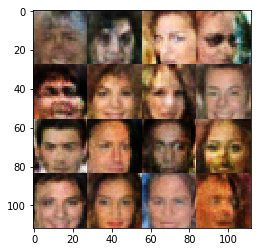

Epochs 9310/60000 Batch Step 2980/3166 gen_loss = 3.4582715034484863..., disc_loss = -1.577244758605957..., train using time = 11.213
Epochs 9320/60000 Batch Step 2990/3166 gen_loss = 4.474468231201172..., disc_loss = -1.610634207725525..., train using time = 11.128
Epochs 9330/60000 Batch Step 3000/3166 gen_loss = 3.0417745113372803..., disc_loss = -1.4365352392196655..., train using time = 11.062
Epochs 9340/60000 Batch Step 3010/3166 gen_loss = 3.0839574337005615..., disc_loss = -1.5345349311828613..., train using time = 11.227
Epochs 9350/60000 Batch Step 3020/3166 gen_loss = 0.8777649402618408..., disc_loss = -1.519931435585022..., train using time = 11.169
Epochs 9360/60000 Batch Step 3030/3166 gen_loss = 3.552313804626465..., disc_loss = -1.6543928384780884..., train using time = 11.091
Epochs 9370/60000 Batch Step 3040/3166 gen_loss = 2.779672622680664..., disc_loss = -1.635946273803711..., train using time = 11.029
Epochs 9380/60000 Batch Step 3050/3166 gen_loss = 4.0545363426

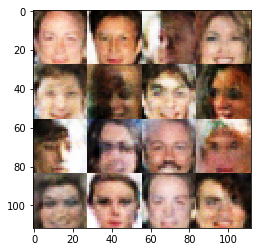

Epochs 9410/60000 Batch Step 3080/3166 gen_loss = 3.7454493045806885..., disc_loss = -1.5183004140853882..., train using time = 11.194
Epochs 9420/60000 Batch Step 3090/3166 gen_loss = 2.430300712585449..., disc_loss = -1.6532284021377563..., train using time = 11.085
Epochs 9430/60000 Batch Step 3100/3166 gen_loss = 3.220212936401367..., disc_loss = -1.5333974361419678..., train using time = 11.016
Epochs 9440/60000 Batch Step 3110/3166 gen_loss = 3.861686944961548..., disc_loss = -1.3549611568450928..., train using time = 11.173
Epochs 9450/60000 Batch Step 3120/3166 gen_loss = 3.830434560775757..., disc_loss = -1.6078376770019531..., train using time = 11.126
Epochs 9460/60000 Batch Step 3130/3166 gen_loss = 3.2059011459350586..., disc_loss = -1.4664132595062256..., train using time = 11.094
Epochs 9470/60000 Batch Step 3140/3166 gen_loss = 4.261646270751953..., disc_loss = -1.5145224332809448..., train using time = 11.135
Epochs 9480/60000 Batch Step 3150/3166 gen_loss = 3.95645713

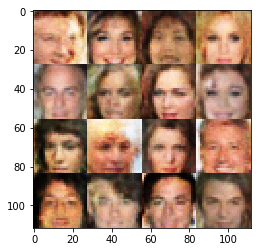

Epochs 9510/60000 Batch Step 15/3166 gen_loss = 3.5935258865356445..., disc_loss = -1.688055396080017..., train using time = 11.098
Epochs 9520/60000 Batch Step 25/3166 gen_loss = 3.45084285736084..., disc_loss = -1.6018701791763306..., train using time = 11.126
Epochs 9530/60000 Batch Step 35/3166 gen_loss = 4.006284713745117..., disc_loss = -1.6186847686767578..., train using time = 11.134
Epochs 9540/60000 Batch Step 45/3166 gen_loss = 2.5986435413360596..., disc_loss = -1.5978082418441772..., train using time = 11.251
Epochs 9550/60000 Batch Step 55/3166 gen_loss = 2.1790809631347656..., disc_loss = -1.5862305164337158..., train using time = 11.055
Epochs 9560/60000 Batch Step 65/3166 gen_loss = 1.908819317817688..., disc_loss = -1.4946062564849854..., train using time = 11.068
Epochs 9570/60000 Batch Step 75/3166 gen_loss = 3.9997823238372803..., disc_loss = -1.7139980792999268..., train using time = 11.083
Epochs 9580/60000 Batch Step 85/3166 gen_loss = 3.154263496398926..., disc

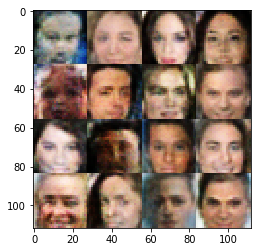

Epochs 9610/60000 Batch Step 115/3166 gen_loss = 4.892790794372559..., disc_loss = -1.5502222776412964..., train using time = 11.077
Epochs 9620/60000 Batch Step 125/3166 gen_loss = 3.980571746826172..., disc_loss = -1.5310148000717163..., train using time = 11.075
Epochs 9630/60000 Batch Step 135/3166 gen_loss = 3.1538848876953125..., disc_loss = -1.4288976192474365..., train using time = 11.098
Epochs 9640/60000 Batch Step 145/3166 gen_loss = 4.85099983215332..., disc_loss = -1.5220820903778076..., train using time = 11.144
Epochs 9650/60000 Batch Step 155/3166 gen_loss = 4.491363525390625..., disc_loss = -1.5471649169921875..., train using time = 11.110
Epochs 9660/60000 Batch Step 165/3166 gen_loss = 1.5663213729858398..., disc_loss = -1.5560119152069092..., train using time = 11.127
Epochs 9670/60000 Batch Step 175/3166 gen_loss = 1.9618861675262451..., disc_loss = -1.5244258642196655..., train using time = 11.140
Epochs 9680/60000 Batch Step 185/3166 gen_loss = 2.6535534858703613

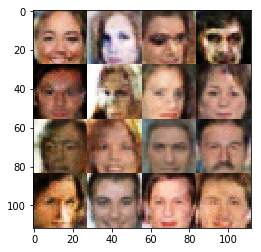

Epochs 9710/60000 Batch Step 215/3166 gen_loss = 2.992957592010498..., disc_loss = -1.6008793115615845..., train using time = 11.156
Epochs 9720/60000 Batch Step 225/3166 gen_loss = 1.500726342201233..., disc_loss = -1.5446336269378662..., train using time = 12.108
Epochs 9730/60000 Batch Step 235/3166 gen_loss = 4.381704807281494..., disc_loss = -1.6694624423980713..., train using time = 11.130
Epochs 9740/60000 Batch Step 245/3166 gen_loss = 2.1878468990325928..., disc_loss = -1.502476692199707..., train using time = 11.080
Epochs 9750/60000 Batch Step 255/3166 gen_loss = 3.4508755207061768..., disc_loss = -1.5942305326461792..., train using time = 11.093
Epochs 9760/60000 Batch Step 265/3166 gen_loss = 3.0347323417663574..., disc_loss = -1.498539924621582..., train using time = 11.082
Epochs 9770/60000 Batch Step 275/3166 gen_loss = 3.6590473651885986..., disc_loss = -1.5134918689727783..., train using time = 11.146
Epochs 9780/60000 Batch Step 285/3166 gen_loss = 2.7141683101654053

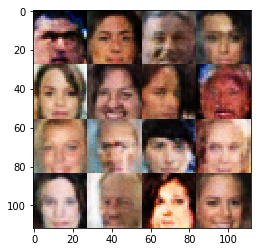

Epochs 9810/60000 Batch Step 315/3166 gen_loss = 1.5628790855407715..., disc_loss = -1.3664324283599854..., train using time = 10.996
Epochs 9820/60000 Batch Step 325/3166 gen_loss = 2.1996054649353027..., disc_loss = -1.4379591941833496..., train using time = 11.065
Epochs 9830/60000 Batch Step 335/3166 gen_loss = 4.250064849853516..., disc_loss = -1.434683918952942..., train using time = 11.078
Epochs 9840/60000 Batch Step 345/3166 gen_loss = 2.46246337890625..., disc_loss = -1.6220996379852295..., train using time = 11.065
Epochs 9850/60000 Batch Step 355/3166 gen_loss = 4.282972812652588..., disc_loss = -1.3496973514556885..., train using time = 11.053
Epochs 9860/60000 Batch Step 365/3166 gen_loss = 4.457144737243652..., disc_loss = -1.5509814023971558..., train using time = 11.080
Epochs 9870/60000 Batch Step 375/3166 gen_loss = 3.1582560539245605..., disc_loss = -1.831500768661499..., train using time = 11.098
Epochs 9880/60000 Batch Step 385/3166 gen_loss = 3.2007737159729004..

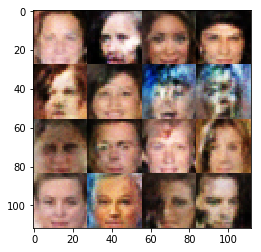

Epochs 9910/60000 Batch Step 415/3166 gen_loss = 7.447749137878418..., disc_loss = -1.363922119140625..., train using time = 11.040
Epochs 9920/60000 Batch Step 425/3166 gen_loss = 3.265857696533203..., disc_loss = -1.5204217433929443..., train using time = 11.018
Epochs 9930/60000 Batch Step 435/3166 gen_loss = 3.2401866912841797..., disc_loss = -1.6197707653045654..., train using time = 11.354
Epochs 9940/60000 Batch Step 445/3166 gen_loss = 3.0362229347229004..., disc_loss = -1.6917636394500732..., train using time = 11.121
Epochs 9950/60000 Batch Step 455/3166 gen_loss = 1.1937854290008545..., disc_loss = -1.507030963897705..., train using time = 10.997
Epochs 9960/60000 Batch Step 465/3166 gen_loss = 2.4600844383239746..., disc_loss = -1.5190681219100952..., train using time = 11.035
Epochs 9970/60000 Batch Step 475/3166 gen_loss = 1.6353318691253662..., disc_loss = -1.4691851139068604..., train using time = 11.083
Epochs 9980/60000 Batch Step 485/3166 gen_loss = 3.353765964508056

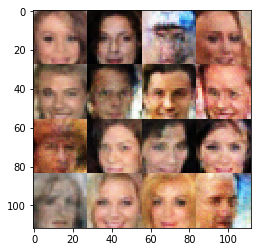

Epochs 10010/60000 Batch Step 515/3166 gen_loss = 2.102670669555664..., disc_loss = -1.6349232196807861..., train using time = 11.040
Epochs 10020/60000 Batch Step 525/3166 gen_loss = 3.809450626373291..., disc_loss = -1.46161949634552..., train using time = 10.971
Epochs 10030/60000 Batch Step 535/3166 gen_loss = 1.4853289127349854..., disc_loss = -1.5341850519180298..., train using time = 11.100
Epochs 10040/60000 Batch Step 545/3166 gen_loss = 2.8480417728424072..., disc_loss = -1.3712494373321533..., train using time = 11.018
Epochs 10050/60000 Batch Step 555/3166 gen_loss = 2.8375868797302246..., disc_loss = -1.5534998178482056..., train using time = 11.048
Epochs 10060/60000 Batch Step 565/3166 gen_loss = 2.7385122776031494..., disc_loss = -1.485417127609253..., train using time = 11.072
Epochs 10070/60000 Batch Step 575/3166 gen_loss = 3.686342716217041..., disc_loss = -1.4147456884384155..., train using time = 11.162
Epochs 10080/60000 Batch Step 585/3166 gen_loss = 3.167564868

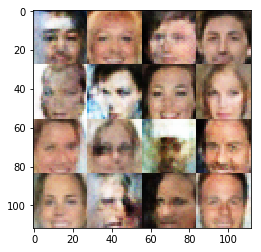

Epochs 10110/60000 Batch Step 615/3166 gen_loss = 3.448352336883545..., disc_loss = -1.4332702159881592..., train using time = 11.091
Epochs 10120/60000 Batch Step 625/3166 gen_loss = 2.146827459335327..., disc_loss = -1.5619196891784668..., train using time = 11.054
Epochs 10130/60000 Batch Step 635/3166 gen_loss = 1.0210158824920654..., disc_loss = -1.5328588485717773..., train using time = 10.992
Epochs 10140/60000 Batch Step 645/3166 gen_loss = 2.8981056213378906..., disc_loss = -1.4772425889968872..., train using time = 11.083
Epochs 10150/60000 Batch Step 655/3166 gen_loss = 1.7846333980560303..., disc_loss = -1.614201545715332..., train using time = 11.434
Epochs 10160/60000 Batch Step 665/3166 gen_loss = 3.1468091011047363..., disc_loss = -1.4367949962615967..., train using time = 11.145
Epochs 10170/60000 Batch Step 675/3166 gen_loss = 3.822497844696045..., disc_loss = -1.4561576843261719..., train using time = 11.040
Epochs 10180/60000 Batch Step 685/3166 gen_loss = 0.7977986

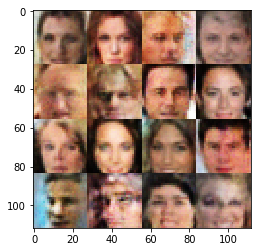

Epochs 10210/60000 Batch Step 715/3166 gen_loss = 2.593961477279663..., disc_loss = -1.4156266450881958..., train using time = 11.055
Epochs 10220/60000 Batch Step 725/3166 gen_loss = 0.7096972465515137..., disc_loss = -1.6652917861938477..., train using time = 11.083
Epochs 10230/60000 Batch Step 735/3166 gen_loss = 2.6529951095581055..., disc_loss = -1.6257095336914062..., train using time = 10.958
Epochs 10240/60000 Batch Step 745/3166 gen_loss = 4.764686584472656..., disc_loss = -1.5084943771362305..., train using time = 11.202
Epochs 10250/60000 Batch Step 755/3166 gen_loss = 2.3331596851348877..., disc_loss = -1.39322829246521..., train using time = 11.369
Epochs 10260/60000 Batch Step 765/3166 gen_loss = 2.2579824924468994..., disc_loss = -1.47795832157135..., train using time = 11.088
Epochs 10270/60000 Batch Step 775/3166 gen_loss = 3.813143253326416..., disc_loss = -1.5473591089248657..., train using time = 11.041
Epochs 10280/60000 Batch Step 785/3166 gen_loss = 2.8274188041

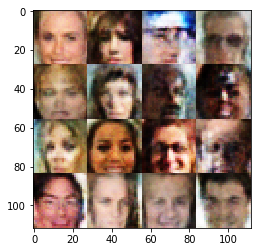

Epochs 10310/60000 Batch Step 815/3166 gen_loss = 3.193267822265625..., disc_loss = -1.5509746074676514..., train using time = 11.060
Epochs 10320/60000 Batch Step 825/3166 gen_loss = 3.1103899478912354..., disc_loss = -1.4260311126708984..., train using time = 11.072
Epochs 10330/60000 Batch Step 835/3166 gen_loss = 3.6368417739868164..., disc_loss = -1.5058330297470093..., train using time = 11.069
Epochs 10340/60000 Batch Step 845/3166 gen_loss = 2.9908571243286133..., disc_loss = -1.575323224067688..., train using time = 11.059
Epochs 10350/60000 Batch Step 855/3166 gen_loss = 4.853273868560791..., disc_loss = -1.4231764078140259..., train using time = 11.105
Epochs 10360/60000 Batch Step 865/3166 gen_loss = 0.5234513282775879..., disc_loss = -1.3729217052459717..., train using time = 11.361
Epochs 10370/60000 Batch Step 875/3166 gen_loss = 3.871138334274292..., disc_loss = -1.3847215175628662..., train using time = 11.038
Epochs 10380/60000 Batch Step 885/3166 gen_loss = 1.8334643

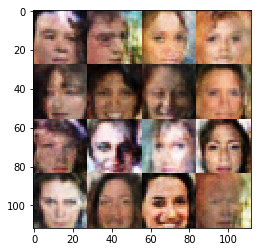

Epochs 10410/60000 Batch Step 915/3166 gen_loss = 2.1415061950683594..., disc_loss = -1.484397292137146..., train using time = 11.022
Epochs 10420/60000 Batch Step 925/3166 gen_loss = 3.6389718055725098..., disc_loss = -1.265748381614685..., train using time = 11.016
Epochs 10430/60000 Batch Step 935/3166 gen_loss = 2.5016682147979736..., disc_loss = -1.5026423931121826..., train using time = 11.125
Epochs 10440/60000 Batch Step 945/3166 gen_loss = 3.357499599456787..., disc_loss = -1.412404179573059..., train using time = 10.987
Epochs 10450/60000 Batch Step 955/3166 gen_loss = 4.341779708862305..., disc_loss = -1.3860836029052734..., train using time = 11.066
Epochs 10460/60000 Batch Step 965/3166 gen_loss = 2.23356294631958..., disc_loss = -1.7544386386871338..., train using time = 11.082
Epochs 10470/60000 Batch Step 975/3166 gen_loss = 2.7136971950531006..., disc_loss = -1.268175482749939..., train using time = 10.979
Epochs 10480/60000 Batch Step 985/3166 gen_loss = 2.76227998733

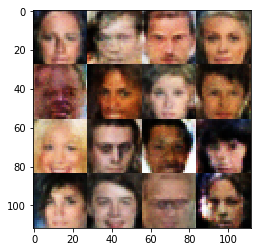

Epochs 10510/60000 Batch Step 1015/3166 gen_loss = 5.135505676269531..., disc_loss = -1.4945018291473389..., train using time = 11.047
Epochs 10520/60000 Batch Step 1025/3166 gen_loss = 4.128042221069336..., disc_loss = -1.2945843935012817..., train using time = 11.047
Epochs 10530/60000 Batch Step 1035/3166 gen_loss = 2.9810941219329834..., disc_loss = -1.3741604089736938..., train using time = 11.007
Epochs 10540/60000 Batch Step 1045/3166 gen_loss = 2.73861026763916..., disc_loss = -1.471816897392273..., train using time = 11.121
Epochs 10550/60000 Batch Step 1055/3166 gen_loss = 3.027560234069824..., disc_loss = -1.3852592706680298..., train using time = 11.023
Epochs 10560/60000 Batch Step 1065/3166 gen_loss = 2.2968430519104004..., disc_loss = -1.3446264266967773..., train using time = 11.023
Epochs 10570/60000 Batch Step 1075/3166 gen_loss = 4.164655685424805..., disc_loss = -1.3909004926681519..., train using time = 11.058
Epochs 10580/60000 Batch Step 1085/3166 gen_loss = 4.56

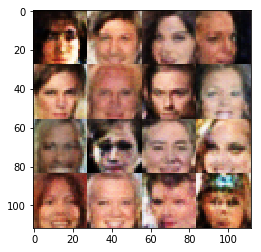

Epochs 10610/60000 Batch Step 1115/3166 gen_loss = 3.2446680068969727..., disc_loss = -1.3053112030029297..., train using time = 11.069
Epochs 10620/60000 Batch Step 1125/3166 gen_loss = 4.7212748527526855..., disc_loss = -1.427512764930725..., train using time = 11.102
Epochs 10630/60000 Batch Step 1135/3166 gen_loss = 3.261638879776001..., disc_loss = -1.5160220861434937..., train using time = 11.088
Epochs 10640/60000 Batch Step 1145/3166 gen_loss = 1.6634080410003662..., disc_loss = -1.29440176486969..., train using time = 11.070
Epochs 10650/60000 Batch Step 1155/3166 gen_loss = 2.5211448669433594..., disc_loss = -1.3950815200805664..., train using time = 11.039
Epochs 10660/60000 Batch Step 1165/3166 gen_loss = 2.5443100929260254..., disc_loss = -1.508484125137329..., train using time = 11.029
Epochs 10670/60000 Batch Step 1175/3166 gen_loss = 3.718186378479004..., disc_loss = -1.5372467041015625..., train using time = 11.161
Epochs 10680/60000 Batch Step 1185/3166 gen_loss = 2.9

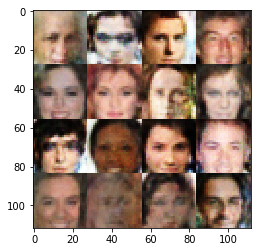

Epochs 10710/60000 Batch Step 1215/3166 gen_loss = 3.8342342376708984..., disc_loss = -1.3925530910491943..., train using time = 11.044
Epochs 10720/60000 Batch Step 1225/3166 gen_loss = 3.189037799835205..., disc_loss = -1.5835802555084229..., train using time = 11.055
Epochs 10730/60000 Batch Step 1235/3166 gen_loss = 3.751875162124634..., disc_loss = -1.5292370319366455..., train using time = 11.106
Epochs 10740/60000 Batch Step 1245/3166 gen_loss = 4.121494293212891..., disc_loss = -1.4567654132843018..., train using time = 11.020
Epochs 10750/60000 Batch Step 1255/3166 gen_loss = 2.7242865562438965..., disc_loss = -1.429111361503601..., train using time = 11.140
Epochs 10760/60000 Batch Step 1265/3166 gen_loss = 3.2944867610931396..., disc_loss = -1.41923987865448..., train using time = 11.087
Epochs 10770/60000 Batch Step 1275/3166 gen_loss = 3.418853759765625..., disc_loss = -1.432161569595337..., train using time = 12.159
Epochs 10780/60000 Batch Step 1285/3166 gen_loss = 1.198

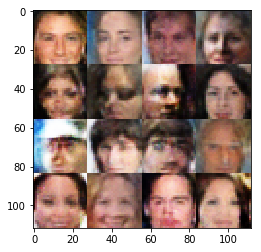

Epochs 10810/60000 Batch Step 1315/3166 gen_loss = 3.664379596710205..., disc_loss = -1.4149423837661743..., train using time = 11.198
Epochs 10820/60000 Batch Step 1325/3166 gen_loss = 3.3984060287475586..., disc_loss = -1.5220582485198975..., train using time = 11.224
Epochs 10830/60000 Batch Step 1335/3166 gen_loss = 1.9189727306365967..., disc_loss = -1.4455970525741577..., train using time = 11.102
Epochs 10840/60000 Batch Step 1345/3166 gen_loss = 5.700492858886719..., disc_loss = -1.348217248916626..., train using time = 11.141
Epochs 10850/60000 Batch Step 1355/3166 gen_loss = 2.0227742195129395..., disc_loss = -1.460013747215271..., train using time = 11.949
Epochs 10860/60000 Batch Step 1365/3166 gen_loss = 2.0314443111419678..., disc_loss = -1.5298776626586914..., train using time = 11.054
Epochs 10870/60000 Batch Step 1375/3166 gen_loss = 3.708951234817505..., disc_loss = -1.4286136627197266..., train using time = 11.079
Epochs 10880/60000 Batch Step 1385/3166 gen_loss = 3.

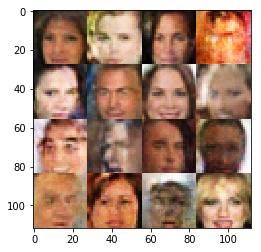

Epochs 10910/60000 Batch Step 1415/3166 gen_loss = 4.054182529449463..., disc_loss = -1.3678666353225708..., train using time = 11.187
Epochs 10920/60000 Batch Step 1425/3166 gen_loss = 3.1640021800994873..., disc_loss = -1.4442955255508423..., train using time = 11.118
Epochs 10930/60000 Batch Step 1435/3166 gen_loss = 3.588806629180908..., disc_loss = -1.495546579360962..., train using time = 11.160
Epochs 10940/60000 Batch Step 1445/3166 gen_loss = 3.338836669921875..., disc_loss = -1.435112714767456..., train using time = 11.027
Epochs 10950/60000 Batch Step 1455/3166 gen_loss = 2.920057773590088..., disc_loss = -1.3297882080078125..., train using time = 11.049
Epochs 10960/60000 Batch Step 1465/3166 gen_loss = 2.251621723175049..., disc_loss = -1.4512614011764526..., train using time = 11.327
Epochs 10970/60000 Batch Step 1475/3166 gen_loss = 2.5406088829040527..., disc_loss = -1.6266276836395264..., train using time = 11.290
Epochs 10980/60000 Batch Step 1485/3166 gen_loss = 3.92

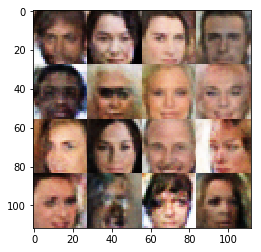

Epochs 11010/60000 Batch Step 1515/3166 gen_loss = 1.9291177988052368..., disc_loss = -1.1790659427642822..., train using time = 11.580
Epochs 11020/60000 Batch Step 1525/3166 gen_loss = 4.567542552947998..., disc_loss = -1.2926095724105835..., train using time = 11.085
Epochs 11030/60000 Batch Step 1535/3166 gen_loss = 3.208918571472168..., disc_loss = -1.4021483659744263..., train using time = 11.123
Epochs 11040/60000 Batch Step 1545/3166 gen_loss = 3.915738821029663..., disc_loss = -1.4232110977172852..., train using time = 11.119
Epochs 11050/60000 Batch Step 1555/3166 gen_loss = 2.5190346240997314..., disc_loss = -1.3169965744018555..., train using time = 11.207
Epochs 11060/60000 Batch Step 1565/3166 gen_loss = 5.105132102966309..., disc_loss = -1.2698427438735962..., train using time = 11.128
Epochs 11070/60000 Batch Step 1575/3166 gen_loss = 2.8456239700317383..., disc_loss = -1.3345599174499512..., train using time = 11.157
Epochs 11080/60000 Batch Step 1585/3166 gen_loss = 3

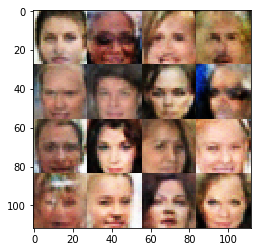

Epochs 11110/60000 Batch Step 1615/3166 gen_loss = 0.8197054266929626..., disc_loss = -1.290221929550171..., train using time = 11.060
Epochs 11120/60000 Batch Step 1625/3166 gen_loss = 5.199306488037109..., disc_loss = -1.1379246711730957..., train using time = 11.020
Epochs 11130/60000 Batch Step 1635/3166 gen_loss = 3.157197952270508..., disc_loss = -1.473600149154663..., train using time = 11.017
Epochs 11140/60000 Batch Step 1645/3166 gen_loss = 2.970712900161743..., disc_loss = -1.1970105171203613..., train using time = 14.175
Epochs 11150/60000 Batch Step 1655/3166 gen_loss = 4.927428722381592..., disc_loss = -1.5272846221923828..., train using time = 11.392
Epochs 11160/60000 Batch Step 1665/3166 gen_loss = 2.0051093101501465..., disc_loss = -1.3884060382843018..., train using time = 11.233
Epochs 11170/60000 Batch Step 1675/3166 gen_loss = 2.491020917892456..., disc_loss = -1.383867621421814..., train using time = 12.180
Epochs 11180/60000 Batch Step 1685/3166 gen_loss = 3.679

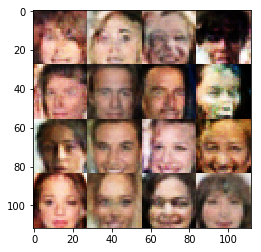

Epochs 11210/60000 Batch Step 1715/3166 gen_loss = 2.0837631225585938..., disc_loss = -1.5441361665725708..., train using time = 11.164
Epochs 11220/60000 Batch Step 1725/3166 gen_loss = 2.23945951461792..., disc_loss = -1.4265130758285522..., train using time = 10.951
Epochs 11230/60000 Batch Step 1735/3166 gen_loss = 2.222891092300415..., disc_loss = -1.3788156509399414..., train using time = 11.023
Epochs 11240/60000 Batch Step 1745/3166 gen_loss = 2.1204285621643066..., disc_loss = -1.3111093044281006..., train using time = 11.582
Epochs 11250/60000 Batch Step 1755/3166 gen_loss = 2.240910768508911..., disc_loss = -1.3054146766662598..., train using time = 12.073
Epochs 11260/60000 Batch Step 1765/3166 gen_loss = 3.3527092933654785..., disc_loss = -1.3592917919158936..., train using time = 10.978
Epochs 11270/60000 Batch Step 1775/3166 gen_loss = 1.988874912261963..., disc_loss = -1.456189513206482..., train using time = 11.140
Epochs 11280/60000 Batch Step 1785/3166 gen_loss = 1.7

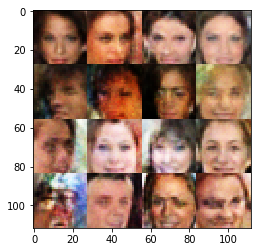

Epochs 11310/60000 Batch Step 1815/3166 gen_loss = 2.5647873878479004..., disc_loss = -1.344265103340149..., train using time = 11.590
Epochs 11320/60000 Batch Step 1825/3166 gen_loss = 1.1655068397521973..., disc_loss = -1.250748872756958..., train using time = 11.173
Epochs 11330/60000 Batch Step 1835/3166 gen_loss = 3.1832098960876465..., disc_loss = -1.4305799007415771..., train using time = 12.285
Epochs 11340/60000 Batch Step 1845/3166 gen_loss = 1.5187418460845947..., disc_loss = -1.2770068645477295..., train using time = 11.067
Epochs 11350/60000 Batch Step 1855/3166 gen_loss = 2.9324326515197754..., disc_loss = -1.2921571731567383..., train using time = 11.153
Epochs 11360/60000 Batch Step 1865/3166 gen_loss = 4.475191116333008..., disc_loss = -1.3459932804107666..., train using time = 11.001
Epochs 11370/60000 Batch Step 1875/3166 gen_loss = 3.1983642578125..., disc_loss = -1.5176022052764893..., train using time = 10.969
Epochs 11380/60000 Batch Step 1885/3166 gen_loss = 2.3

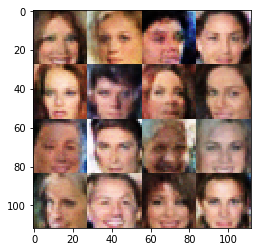

Epochs 11410/60000 Batch Step 1915/3166 gen_loss = 4.459618091583252..., disc_loss = -1.350447654724121..., train using time = 12.389
Epochs 11420/60000 Batch Step 1925/3166 gen_loss = 3.514270544052124..., disc_loss = -1.4261596202850342..., train using time = 11.037
Epochs 11430/60000 Batch Step 1935/3166 gen_loss = 1.9556876420974731..., disc_loss = -1.2809860706329346..., train using time = 11.128
Epochs 11440/60000 Batch Step 1945/3166 gen_loss = 2.3215012550354004..., disc_loss = -1.50935959815979..., train using time = 11.087
Epochs 11450/60000 Batch Step 1955/3166 gen_loss = 3.2094993591308594..., disc_loss = -1.2919315099716187..., train using time = 10.973
Epochs 11460/60000 Batch Step 1965/3166 gen_loss = 3.235673189163208..., disc_loss = -1.5032804012298584..., train using time = 11.002
Epochs 11470/60000 Batch Step 1975/3166 gen_loss = 1.3512811660766602..., disc_loss = -1.2609672546386719..., train using time = 10.976
Epochs 11480/60000 Batch Step 1985/3166 gen_loss = 2.7

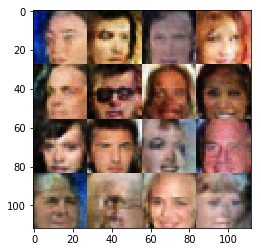

Epochs 11510/60000 Batch Step 2015/3166 gen_loss = 1.256288766860962..., disc_loss = -1.2346055507659912..., train using time = 11.032
Epochs 11520/60000 Batch Step 2025/3166 gen_loss = 2.688983917236328..., disc_loss = -1.3458629846572876..., train using time = 11.149
Epochs 11530/60000 Batch Step 2035/3166 gen_loss = 0.8343799114227295..., disc_loss = -1.4835989475250244..., train using time = 11.055
Epochs 11540/60000 Batch Step 2045/3166 gen_loss = 3.140746593475342..., disc_loss = -1.5452922582626343..., train using time = 10.962
Epochs 11550/60000 Batch Step 2055/3166 gen_loss = 3.821749687194824..., disc_loss = -1.086259126663208..., train using time = 11.016
Epochs 11560/60000 Batch Step 2065/3166 gen_loss = 4.375624656677246..., disc_loss = -1.3228673934936523..., train using time = 11.317
Epochs 11570/60000 Batch Step 2075/3166 gen_loss = 3.0370516777038574..., disc_loss = -1.4907543659210205..., train using time = 11.101
Epochs 11580/60000 Batch Step 2085/3166 gen_loss = 3.2

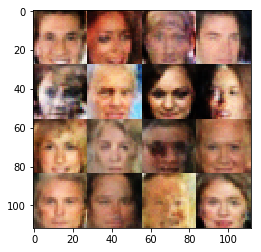

Epochs 11610/60000 Batch Step 2115/3166 gen_loss = 1.97719144821167..., disc_loss = -1.2946926355361938..., train using time = 11.059
Epochs 11620/60000 Batch Step 2125/3166 gen_loss = 5.297904968261719..., disc_loss = -1.1998474597930908..., train using time = 11.028
Epochs 11630/60000 Batch Step 2135/3166 gen_loss = 3.3278019428253174..., disc_loss = -1.2321624755859375..., train using time = 11.092
Epochs 11640/60000 Batch Step 2145/3166 gen_loss = 2.789808988571167..., disc_loss = -1.2666445970535278..., train using time = 11.180
Epochs 11650/60000 Batch Step 2155/3166 gen_loss = 2.4167656898498535..., disc_loss = -1.349913239479065..., train using time = 11.068
Epochs 11660/60000 Batch Step 2165/3166 gen_loss = 2.9705605506896973..., disc_loss = -1.3568131923675537..., train using time = 11.101
Epochs 11670/60000 Batch Step 2175/3166 gen_loss = 3.601933002471924..., disc_loss = -1.268493413925171..., train using time = 11.150
Epochs 11680/60000 Batch Step 2185/3166 gen_loss = 1.99

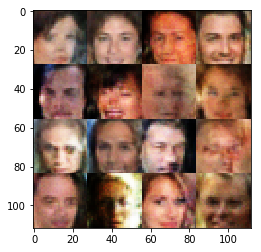

Epochs 11710/60000 Batch Step 2215/3166 gen_loss = 3.512655735015869..., disc_loss = -1.4098877906799316..., train using time = 10.955
Epochs 11720/60000 Batch Step 2225/3166 gen_loss = 3.375654697418213..., disc_loss = -1.353486180305481..., train using time = 11.211
Epochs 11730/60000 Batch Step 2235/3166 gen_loss = 2.8625454902648926..., disc_loss = -1.4550697803497314..., train using time = 11.491
Epochs 11740/60000 Batch Step 2245/3166 gen_loss = 2.9252617359161377..., disc_loss = -1.291089653968811..., train using time = 11.041
Epochs 11750/60000 Batch Step 2255/3166 gen_loss = 2.9184176921844482..., disc_loss = -1.4000935554504395..., train using time = 11.133
Epochs 11760/60000 Batch Step 2265/3166 gen_loss = 2.4021334648132324..., disc_loss = -1.3950445652008057..., train using time = 10.981
Epochs 11770/60000 Batch Step 2275/3166 gen_loss = 1.5237555503845215..., disc_loss = -1.2021788358688354..., train using time = 11.044
Epochs 11780/60000 Batch Step 2285/3166 gen_loss = 2

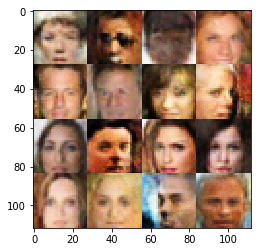

Epochs 11810/60000 Batch Step 2315/3166 gen_loss = 2.997687578201294..., disc_loss = -1.264102816581726..., train using time = 11.058
Epochs 11820/60000 Batch Step 2325/3166 gen_loss = 2.6451730728149414..., disc_loss = -1.2406986951828003..., train using time = 10.868
Epochs 11830/60000 Batch Step 2335/3166 gen_loss = 2.1513779163360596..., disc_loss = -1.4988772869110107..., train using time = 11.091
Epochs 11840/60000 Batch Step 2345/3166 gen_loss = 2.6690361499786377..., disc_loss = -1.3714373111724854..., train using time = 11.047
Epochs 11850/60000 Batch Step 2355/3166 gen_loss = 3.478724479675293..., disc_loss = -1.2742263078689575..., train using time = 10.975
Epochs 11860/60000 Batch Step 2365/3166 gen_loss = 2.760951519012451..., disc_loss = -1.341614007949829..., train using time = 11.040
Epochs 11870/60000 Batch Step 2375/3166 gen_loss = 2.640566349029541..., disc_loss = -1.246701955795288..., train using time = 11.205
Epochs 11880/60000 Batch Step 2385/3166 gen_loss = 3.02

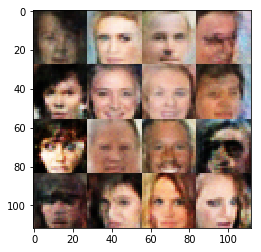

Epochs 11910/60000 Batch Step 2415/3166 gen_loss = 1.6339939832687378..., disc_loss = -1.3023990392684937..., train using time = 11.205
Epochs 11920/60000 Batch Step 2425/3166 gen_loss = 2.125731945037842..., disc_loss = -1.3462913036346436..., train using time = 11.065
Epochs 11930/60000 Batch Step 2435/3166 gen_loss = 2.7120089530944824..., disc_loss = -1.3280709981918335..., train using time = 11.122
Epochs 11940/60000 Batch Step 2445/3166 gen_loss = 3.3024654388427734..., disc_loss = -1.4578505754470825..., train using time = 11.108
Epochs 11950/60000 Batch Step 2455/3166 gen_loss = 2.7340469360351562..., disc_loss = -1.131206750869751..., train using time = 11.032
Epochs 11960/60000 Batch Step 2465/3166 gen_loss = 2.848011016845703..., disc_loss = -1.2428948879241943..., train using time = 11.265
Epochs 11970/60000 Batch Step 2475/3166 gen_loss = 2.9091286659240723..., disc_loss = -1.2898591756820679..., train using time = 11.128
Epochs 11980/60000 Batch Step 2485/3166 gen_loss = 

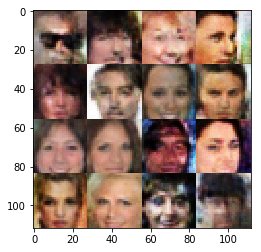

Epochs 12010/60000 Batch Step 2515/3166 gen_loss = 3.2242722511291504..., disc_loss = -1.3273446559906006..., train using time = 11.018
Epochs 12020/60000 Batch Step 2525/3166 gen_loss = 1.2557103633880615..., disc_loss = -1.144780158996582..., train using time = 10.961
Epochs 12030/60000 Batch Step 2535/3166 gen_loss = 2.202965021133423..., disc_loss = -1.3296449184417725..., train using time = 11.031
Epochs 12040/60000 Batch Step 2545/3166 gen_loss = 2.069182872772217..., disc_loss = -1.2676703929901123..., train using time = 11.227
Epochs 12050/60000 Batch Step 2555/3166 gen_loss = 2.3238813877105713..., disc_loss = -1.1045305728912354..., train using time = 10.988
Epochs 12060/60000 Batch Step 2565/3166 gen_loss = 2.5018134117126465..., disc_loss = -1.1027292013168335..., train using time = 10.946
Epochs 12070/60000 Batch Step 2575/3166 gen_loss = 1.9537098407745361..., disc_loss = -1.1935216188430786..., train using time = 11.034
Epochs 12080/60000 Batch Step 2585/3166 gen_loss = 

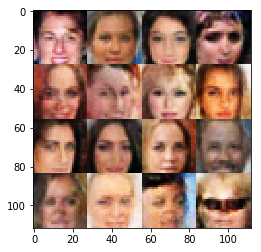

Epochs 12110/60000 Batch Step 2615/3166 gen_loss = 2.7102150917053223..., disc_loss = -1.3300697803497314..., train using time = 11.081
Epochs 12120/60000 Batch Step 2625/3166 gen_loss = 2.3235669136047363..., disc_loss = -1.340504765510559..., train using time = 11.248
Epochs 12130/60000 Batch Step 2635/3166 gen_loss = 1.2435166835784912..., disc_loss = -1.3927936553955078..., train using time = 11.173
Epochs 12140/60000 Batch Step 2645/3166 gen_loss = 5.273038864135742..., disc_loss = -1.1705340147018433..., train using time = 11.144
Epochs 12150/60000 Batch Step 2655/3166 gen_loss = 2.312654495239258..., disc_loss = -1.292806625366211..., train using time = 11.024
Epochs 12160/60000 Batch Step 2665/3166 gen_loss = 2.795198917388916..., disc_loss = -1.2213560342788696..., train using time = 11.049
Epochs 12170/60000 Batch Step 2675/3166 gen_loss = 1.4634073972702026..., disc_loss = -1.4010505676269531..., train using time = 11.076
Epochs 12180/60000 Batch Step 2685/3166 gen_loss = 3.

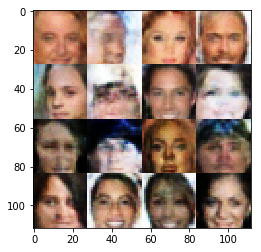

Epochs 12210/60000 Batch Step 2715/3166 gen_loss = 0.8403934240341187..., disc_loss = -1.1287622451782227..., train using time = 11.007
Epochs 12220/60000 Batch Step 2725/3166 gen_loss = 2.6340932846069336..., disc_loss = -1.2671778202056885..., train using time = 12.104
Epochs 12230/60000 Batch Step 2735/3166 gen_loss = 3.2521812915802..., disc_loss = -1.3957524299621582..., train using time = 10.999
Epochs 12240/60000 Batch Step 2745/3166 gen_loss = 1.6672999858856201..., disc_loss = -1.2971322536468506..., train using time = 11.314
Epochs 12250/60000 Batch Step 2755/3166 gen_loss = 2.8337695598602295..., disc_loss = -1.5047870874404907..., train using time = 11.176
Epochs 12260/60000 Batch Step 2765/3166 gen_loss = 0.7957079410552979..., disc_loss = -1.3058658838272095..., train using time = 11.221
Epochs 12270/60000 Batch Step 2775/3166 gen_loss = 1.4757814407348633..., disc_loss = -1.3297808170318604..., train using time = 10.990
Epochs 12280/60000 Batch Step 2785/3166 gen_loss = 

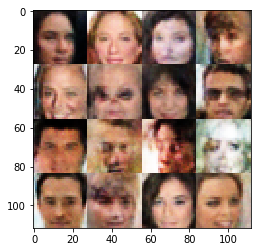

Epochs 12310/60000 Batch Step 2815/3166 gen_loss = 1.2364659309387207..., disc_loss = -1.1582063436508179..., train using time = 11.007
Epochs 12320/60000 Batch Step 2825/3166 gen_loss = 0.8130878210067749..., disc_loss = -1.322605013847351..., train using time = 10.970
Epochs 12330/60000 Batch Step 2835/3166 gen_loss = 3.3316140174865723..., disc_loss = -1.1856056451797485..., train using time = 11.170
Epochs 12340/60000 Batch Step 2845/3166 gen_loss = 1.711869716644287..., disc_loss = -1.275774598121643..., train using time = 11.060
Epochs 12350/60000 Batch Step 2855/3166 gen_loss = 3.7471046447753906..., disc_loss = -1.2556321620941162..., train using time = 11.011
Epochs 12360/60000 Batch Step 2865/3166 gen_loss = 1.6444945335388184..., disc_loss = -1.2589399814605713..., train using time = 11.074
Epochs 12370/60000 Batch Step 2875/3166 gen_loss = 1.803443193435669..., disc_loss = -1.3480453491210938..., train using time = 10.951
Epochs 12380/60000 Batch Step 2885/3166 gen_loss = 2

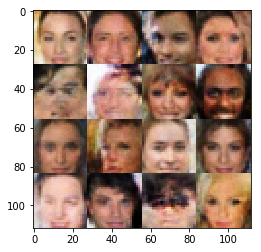

Epochs 12410/60000 Batch Step 2915/3166 gen_loss = 3.5046486854553223..., disc_loss = -1.3243067264556885..., train using time = 11.145
Epochs 12420/60000 Batch Step 2925/3166 gen_loss = 3.054213047027588..., disc_loss = -1.2637461423873901..., train using time = 11.130
Epochs 12430/60000 Batch Step 2935/3166 gen_loss = 1.7872591018676758..., disc_loss = -1.267277479171753..., train using time = 11.067
Epochs 12440/60000 Batch Step 2945/3166 gen_loss = -0.5160964727401733..., disc_loss = -1.327020525932312..., train using time = 11.051
Epochs 12450/60000 Batch Step 2955/3166 gen_loss = 1.5505015850067139..., disc_loss = -1.172684669494629..., train using time = 11.027
Epochs 12460/60000 Batch Step 2965/3166 gen_loss = 1.9945480823516846..., disc_loss = -1.2442671060562134..., train using time = 12.618
Epochs 12470/60000 Batch Step 2975/3166 gen_loss = 0.9208476543426514..., disc_loss = -1.1272932291030884..., train using time = 10.986
Epochs 12480/60000 Batch Step 2985/3166 gen_loss = 

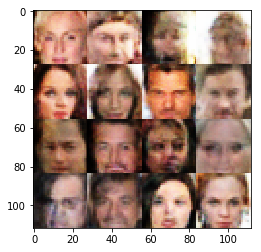

Epochs 12510/60000 Batch Step 3015/3166 gen_loss = 3.2386474609375..., disc_loss = -1.2437986135482788..., train using time = 11.147
Epochs 12520/60000 Batch Step 3025/3166 gen_loss = 2.6401638984680176..., disc_loss = -1.184234380722046..., train using time = 11.034
Epochs 12530/60000 Batch Step 3035/3166 gen_loss = 3.3805065155029297..., disc_loss = -1.3287044763565063..., train using time = 11.059
Epochs 12540/60000 Batch Step 3045/3166 gen_loss = 1.7330210208892822..., disc_loss = -1.4568537473678589..., train using time = 11.366
Epochs 12550/60000 Batch Step 3055/3166 gen_loss = 2.0729904174804688..., disc_loss = -1.2397527694702148..., train using time = 11.040
Epochs 12560/60000 Batch Step 3065/3166 gen_loss = 1.4179120063781738..., disc_loss = -1.1655356884002686..., train using time = 11.164
Epochs 12570/60000 Batch Step 3075/3166 gen_loss = 1.4298884868621826..., disc_loss = -1.3023529052734375..., train using time = 11.159
Epochs 12580/60000 Batch Step 3085/3166 gen_loss = 2

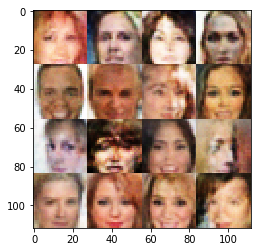

Epochs 12610/60000 Batch Step 3115/3166 gen_loss = 2.5281572341918945..., disc_loss = -1.2505719661712646..., train using time = 11.164
Epochs 12620/60000 Batch Step 3125/3166 gen_loss = 1.8436481952667236..., disc_loss = -1.3316861391067505..., train using time = 11.277
Epochs 12630/60000 Batch Step 3135/3166 gen_loss = 1.3464888334274292..., disc_loss = -1.3342790603637695..., train using time = 11.280
Epochs 12640/60000 Batch Step 3145/3166 gen_loss = 2.5058727264404297..., disc_loss = -1.0962178707122803..., train using time = 11.199
Epochs 12650/60000 Batch Step 3155/3166 gen_loss = 1.3541415929794312..., disc_loss = -1.0691795349121094..., train using time = 11.272
Epochs 12660/60000 Batch Step 3165/3166 gen_loss = 2.013307571411133..., disc_loss = -1.2566568851470947..., train using time = 11.123
Epochs 12670/60000 Batch Step 10/3166 gen_loss = 1.4851570129394531..., disc_loss = -1.1997817754745483..., train using time = 11.121
Epochs 12680/60000 Batch Step 20/3166 gen_loss = 3.

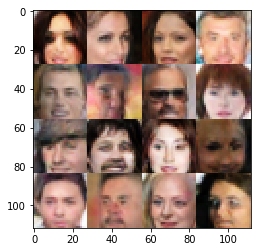

Epochs 38710/60000 Batch Step 730/3166 gen_loss = 0.3920641541481018..., disc_loss = -0.4283716678619385..., train using time = 11.642
Epochs 38720/60000 Batch Step 740/3166 gen_loss = -0.0020335689187049866..., disc_loss = -0.4396694302558899..., train using time = 11.580
Epochs 38730/60000 Batch Step 750/3166 gen_loss = -0.6279090642929077..., disc_loss = -0.4203852713108063..., train using time = 11.572
Epochs 38740/60000 Batch Step 760/3166 gen_loss = 0.5603774785995483..., disc_loss = -0.38955092430114746..., train using time = 11.566
Epochs 38750/60000 Batch Step 770/3166 gen_loss = -1.975934386253357..., disc_loss = -0.3949030339717865..., train using time = 11.755
Epochs 38760/60000 Batch Step 780/3166 gen_loss = -2.1430447101593018..., disc_loss = -0.25449222326278687..., train using time = 11.619
Epochs 38770/60000 Batch Step 790/3166 gen_loss = 1.0496217012405396..., disc_loss = -0.47942742705345154..., train using time = 11.669
Epochs 38780/60000 Batch Step 800/3166 gen_los

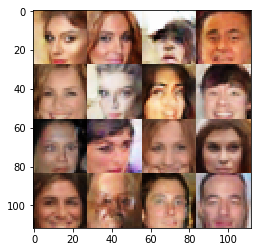

Epochs 38810/60000 Batch Step 830/3166 gen_loss = 0.3035493791103363..., disc_loss = -0.5625408291816711..., train using time = 11.613
Epochs 38820/60000 Batch Step 840/3166 gen_loss = 1.1057143211364746..., disc_loss = -0.3710542321205139..., train using time = 11.545
Epochs 38830/60000 Batch Step 850/3166 gen_loss = -0.9150241613388062..., disc_loss = -0.6040109395980835..., train using time = 11.696
Epochs 38840/60000 Batch Step 860/3166 gen_loss = 2.8302667140960693..., disc_loss = -0.4758839011192322..., train using time = 11.598
Epochs 38850/60000 Batch Step 870/3166 gen_loss = 0.9348753690719604..., disc_loss = -0.5181627869606018..., train using time = 11.691
Epochs 38860/60000 Batch Step 880/3166 gen_loss = -0.7775779962539673..., disc_loss = -0.4809824824333191..., train using time = 12.030
Epochs 38870/60000 Batch Step 890/3166 gen_loss = -0.45452451705932617..., disc_loss = -0.42689523100852966..., train using time = 11.802
Epochs 38880/60000 Batch Step 900/3166 gen_loss = 

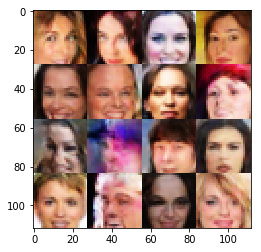

Epochs 38910/60000 Batch Step 930/3166 gen_loss = -0.5161891579627991..., disc_loss = -0.4235960841178894..., train using time = 11.522
Epochs 38920/60000 Batch Step 940/3166 gen_loss = 0.9860509037971497..., disc_loss = -0.4675944745540619..., train using time = 12.094
Epochs 38930/60000 Batch Step 950/3166 gen_loss = -1.588320016860962..., disc_loss = -0.48447877168655396..., train using time = 11.573
Epochs 38940/60000 Batch Step 960/3166 gen_loss = 0.7140529751777649..., disc_loss = -0.5144888162612915..., train using time = 11.613
Epochs 38950/60000 Batch Step 970/3166 gen_loss = -0.5931528806686401..., disc_loss = -0.33823269605636597..., train using time = 11.633
Epochs 38960/60000 Batch Step 980/3166 gen_loss = -1.2818512916564941..., disc_loss = -0.3226086497306824..., train using time = 11.705
Epochs 38970/60000 Batch Step 990/3166 gen_loss = -1.7289068698883057..., disc_loss = -0.5333164930343628..., train using time = 11.599
Epochs 38980/60000 Batch Step 1000/3166 gen_loss 

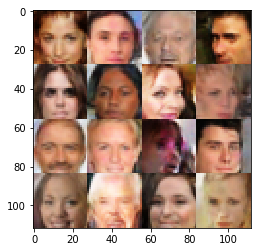

Epochs 39010/60000 Batch Step 1030/3166 gen_loss = -0.8284049034118652..., disc_loss = -0.4985777735710144..., train using time = 11.580
Epochs 39020/60000 Batch Step 1040/3166 gen_loss = -0.15440334379673004..., disc_loss = -0.48540791869163513..., train using time = 11.574
Epochs 39030/60000 Batch Step 1050/3166 gen_loss = -0.8852554559707642..., disc_loss = -0.29220083355903625..., train using time = 11.616
Epochs 39040/60000 Batch Step 1060/3166 gen_loss = -0.564395010471344..., disc_loss = -0.46182698011398315..., train using time = 11.677
Epochs 39050/60000 Batch Step 1070/3166 gen_loss = 1.0336157083511353..., disc_loss = -0.3400774896144867..., train using time = 11.647
Epochs 39060/60000 Batch Step 1080/3166 gen_loss = -2.1047983169555664..., disc_loss = -0.4374910891056061..., train using time = 11.813
Epochs 39070/60000 Batch Step 1090/3166 gen_loss = -0.1209619790315628..., disc_loss = -0.5156386494636536..., train using time = 11.596
Epochs 39080/60000 Batch Step 1100/3166

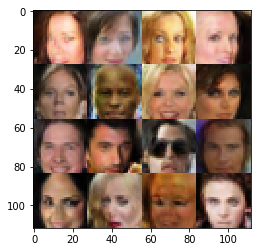

Epochs 39110/60000 Batch Step 1130/3166 gen_loss = -0.6440748572349548..., disc_loss = -0.35467255115509033..., train using time = 11.576
Epochs 39120/60000 Batch Step 1140/3166 gen_loss = -0.24001279473304749..., disc_loss = -0.3932637572288513..., train using time = 11.711
Epochs 39130/60000 Batch Step 1150/3166 gen_loss = -0.14435018599033356..., disc_loss = -0.444294273853302..., train using time = 11.808
Epochs 39140/60000 Batch Step 1160/3166 gen_loss = 1.0891671180725098..., disc_loss = -0.49616485834121704..., train using time = 11.614
Epochs 39150/60000 Batch Step 1170/3166 gen_loss = -0.42873716354370117..., disc_loss = -0.47658824920654297..., train using time = 11.639
Epochs 39160/60000 Batch Step 1180/3166 gen_loss = -0.6012723445892334..., disc_loss = -0.5072546601295471..., train using time = 11.580
Epochs 39170/60000 Batch Step 1190/3166 gen_loss = -1.6982240676879883..., disc_loss = -0.48440322279930115..., train using time = 11.518
Epochs 39180/60000 Batch Step 1200/3

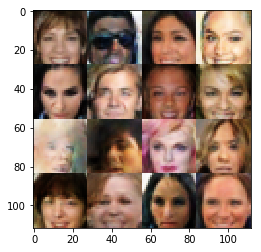

Epochs 39210/60000 Batch Step 1230/3166 gen_loss = -1.278153657913208..., disc_loss = -0.3560981750488281..., train using time = 11.500
Epochs 39220/60000 Batch Step 1240/3166 gen_loss = -0.16018003225326538..., disc_loss = -0.46446090936660767..., train using time = 11.649
Epochs 39230/60000 Batch Step 1250/3166 gen_loss = 0.6053467988967896..., disc_loss = -0.4000980854034424..., train using time = 11.572
Epochs 39240/60000 Batch Step 1260/3166 gen_loss = 0.014721311628818512..., disc_loss = -0.41925111413002014..., train using time = 11.634
Epochs 39250/60000 Batch Step 1270/3166 gen_loss = 0.8933292031288147..., disc_loss = -0.5238022208213806..., train using time = 11.518
Epochs 39260/60000 Batch Step 1280/3166 gen_loss = 1.4404257535934448..., disc_loss = -0.478545606136322..., train using time = 11.536
Epochs 39270/60000 Batch Step 1290/3166 gen_loss = 0.32280564308166504..., disc_loss = -0.46582967042922974..., train using time = 11.642
Epochs 39280/60000 Batch Step 1300/3166 g

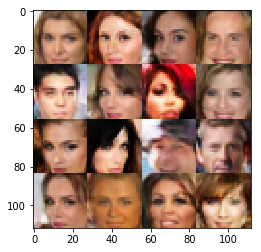

Epochs 39310/60000 Batch Step 1330/3166 gen_loss = 0.10459468513727188..., disc_loss = -0.5249336361885071..., train using time = 11.637
Epochs 39320/60000 Batch Step 1340/3166 gen_loss = 2.304349184036255..., disc_loss = -0.44398102164268494..., train using time = 11.764
Epochs 39330/60000 Batch Step 1350/3166 gen_loss = 0.7227786779403687..., disc_loss = -0.48574548959732056..., train using time = 11.554
Epochs 39340/60000 Batch Step 1360/3166 gen_loss = -0.18647900223731995..., disc_loss = -0.5068429708480835..., train using time = 11.537
Epochs 39350/60000 Batch Step 1370/3166 gen_loss = 1.0010679960250854..., disc_loss = -0.4691973626613617..., train using time = 11.490
Epochs 39360/60000 Batch Step 1380/3166 gen_loss = 0.7787624597549438..., disc_loss = -0.41977638006210327..., train using time = 11.614
Epochs 39370/60000 Batch Step 1390/3166 gen_loss = -2.2394731044769287..., disc_loss = -0.2963375449180603..., train using time = 11.873
Epochs 39380/60000 Batch Step 1400/3166 ge

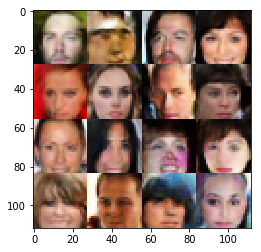

Epochs 39410/60000 Batch Step 1430/3166 gen_loss = -2.6415536403656006..., disc_loss = -0.19185668230056763..., train using time = 11.648
Epochs 39420/60000 Batch Step 1440/3166 gen_loss = -0.19079892337322235..., disc_loss = -0.4056013226509094..., train using time = 11.575
Epochs 39430/60000 Batch Step 1450/3166 gen_loss = -0.08871755748987198..., disc_loss = -0.6099805235862732..., train using time = 11.520
Epochs 39440/60000 Batch Step 1460/3166 gen_loss = 0.9317382574081421..., disc_loss = -0.362898588180542..., train using time = 11.514
Epochs 39450/60000 Batch Step 1470/3166 gen_loss = -2.5039544105529785..., disc_loss = -0.2795020043849945..., train using time = 11.593
Epochs 39460/60000 Batch Step 1480/3166 gen_loss = -0.3825128674507141..., disc_loss = -0.4326300621032715..., train using time = 11.618
Epochs 39470/60000 Batch Step 1490/3166 gen_loss = -1.2410473823547363..., disc_loss = -0.5122365951538086..., train using time = 11.645
Epochs 39480/60000 Batch Step 1500/3166 

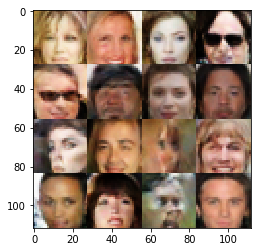

Epochs 39510/60000 Batch Step 1530/3166 gen_loss = 0.3586023449897766..., disc_loss = -0.4279462695121765..., train using time = 11.597
Epochs 39520/60000 Batch Step 1540/3166 gen_loss = -0.8770990371704102..., disc_loss = -0.4261091649532318..., train using time = 11.651
Epochs 39530/60000 Batch Step 1550/3166 gen_loss = -0.2382378727197647..., disc_loss = -0.48527151346206665..., train using time = 11.601
Epochs 39540/60000 Batch Step 1560/3166 gen_loss = -0.6505216956138611..., disc_loss = -0.4883419871330261..., train using time = 11.824
Epochs 39550/60000 Batch Step 1570/3166 gen_loss = 0.8276381492614746..., disc_loss = -0.4134542942047119..., train using time = 11.573
Epochs 39560/60000 Batch Step 1580/3166 gen_loss = -0.5910854339599609..., disc_loss = -0.46968507766723633..., train using time = 11.569
Epochs 39570/60000 Batch Step 1590/3166 gen_loss = 0.6835492849349976..., disc_loss = -0.40650486946105957..., train using time = 11.563
Epochs 39580/60000 Batch Step 1600/3166 g

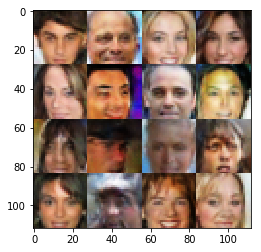

Epochs 39610/60000 Batch Step 1630/3166 gen_loss = 0.6117833256721497..., disc_loss = -0.5771822929382324..., train using time = 11.598
Epochs 39620/60000 Batch Step 1640/3166 gen_loss = -0.17042890191078186..., disc_loss = -0.6024815440177917..., train using time = 11.578
Epochs 39630/60000 Batch Step 1650/3166 gen_loss = 0.8768424391746521..., disc_loss = -0.40494853258132935..., train using time = 11.725
Epochs 39640/60000 Batch Step 1660/3166 gen_loss = 0.459713339805603..., disc_loss = -0.4548111855983734..., train using time = 11.711
Epochs 39650/60000 Batch Step 1670/3166 gen_loss = -1.480309009552002..., disc_loss = -0.39730602502822876..., train using time = 11.737
Epochs 39660/60000 Batch Step 1680/3166 gen_loss = -1.5632356405258179..., disc_loss = -0.37256374955177307..., train using time = 11.977
Epochs 39670/60000 Batch Step 1690/3166 gen_loss = 1.3452520370483398..., disc_loss = -0.43475404381752014..., train using time = 11.494
Epochs 39680/60000 Batch Step 1700/3166 ge

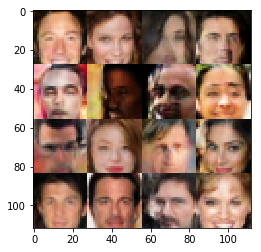

Epochs 39710/60000 Batch Step 1730/3166 gen_loss = -0.8482487201690674..., disc_loss = -0.5521503686904907..., train using time = 11.584
Epochs 39720/60000 Batch Step 1740/3166 gen_loss = 1.9641969203948975..., disc_loss = -0.24860277771949768..., train using time = 11.577
Epochs 39730/60000 Batch Step 1750/3166 gen_loss = -1.267608642578125..., disc_loss = -0.4975603222846985..., train using time = 11.631
Epochs 39740/60000 Batch Step 1760/3166 gen_loss = 1.3360975980758667..., disc_loss = -0.45453161001205444..., train using time = 11.639
Epochs 39750/60000 Batch Step 1770/3166 gen_loss = 1.1066724061965942..., disc_loss = -0.44784656167030334..., train using time = 11.734
Epochs 39760/60000 Batch Step 1780/3166 gen_loss = 0.8056361675262451..., disc_loss = -0.5228739380836487..., train using time = 11.563
Epochs 39770/60000 Batch Step 1790/3166 gen_loss = 0.3454056978225708..., disc_loss = -0.37648260593414307..., train using time = 11.536
Epochs 39780/60000 Batch Step 1800/3166 gen

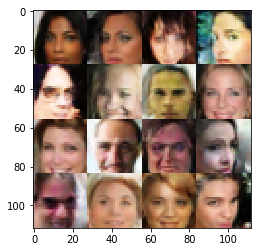

Epochs 39810/60000 Batch Step 1830/3166 gen_loss = -0.44212985038757324..., disc_loss = -0.623650074005127..., train using time = 11.661
Epochs 39820/60000 Batch Step 1840/3166 gen_loss = 0.428072988986969..., disc_loss = -0.5442200899124146..., train using time = 11.522
Epochs 39830/60000 Batch Step 1850/3166 gen_loss = 0.09238070249557495..., disc_loss = -0.49676409363746643..., train using time = 11.576
Epochs 39840/60000 Batch Step 1860/3166 gen_loss = -0.3156728744506836..., disc_loss = -0.22889550030231476..., train using time = 11.718
Epochs 39850/60000 Batch Step 1870/3166 gen_loss = -0.7306993007659912..., disc_loss = -0.413910448551178..., train using time = 11.626
Epochs 39860/60000 Batch Step 1880/3166 gen_loss = 1.8279856443405151..., disc_loss = -0.39385658502578735..., train using time = 11.522
Epochs 39870/60000 Batch Step 1890/3166 gen_loss = 0.8776001930236816..., disc_loss = -0.45680442452430725..., train using time = 11.561
Epochs 39880/60000 Batch Step 1900/3166 ge

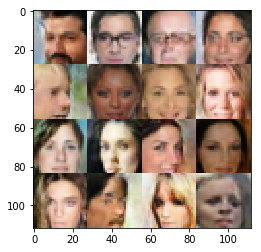

Epochs 39910/60000 Batch Step 1930/3166 gen_loss = 0.9524826407432556..., disc_loss = -0.5039616227149963..., train using time = 12.648
Epochs 39920/60000 Batch Step 1940/3166 gen_loss = 1.1125831604003906..., disc_loss = -0.43323564529418945..., train using time = 11.730
Epochs 39930/60000 Batch Step 1950/3166 gen_loss = 0.6341410875320435..., disc_loss = -0.5514265894889832..., train using time = 11.601
Epochs 39940/60000 Batch Step 1960/3166 gen_loss = -0.15664874017238617..., disc_loss = -0.2735329270362854..., train using time = 11.570
Epochs 39950/60000 Batch Step 1970/3166 gen_loss = 0.4475700259208679..., disc_loss = -0.5459194183349609..., train using time = 11.660
Epochs 39960/60000 Batch Step 1980/3166 gen_loss = -0.2411942183971405..., disc_loss = -0.5330902338027954..., train using time = 11.578
Epochs 39970/60000 Batch Step 1990/3166 gen_loss = 1.9407973289489746..., disc_loss = -0.3885006308555603..., train using time = 11.598
Epochs 39980/60000 Batch Step 2000/3166 gen_

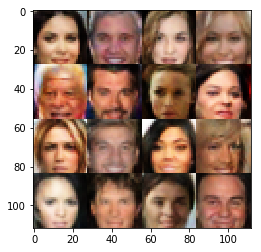

Epochs 40010/60000 Batch Step 2030/3166 gen_loss = -0.21571272611618042..., disc_loss = -0.37528079748153687..., train using time = 11.567
Epochs 40020/60000 Batch Step 2040/3166 gen_loss = -0.023724103346467018..., disc_loss = -0.5128633975982666..., train using time = 11.644
Epochs 40030/60000 Batch Step 2050/3166 gen_loss = -0.45098358392715454..., disc_loss = -0.4872068464756012..., train using time = 11.615
Epochs 40040/60000 Batch Step 2060/3166 gen_loss = 1.6015809774398804..., disc_loss = -0.41526302695274353..., train using time = 11.739
Epochs 40050/60000 Batch Step 2070/3166 gen_loss = 1.4740880727767944..., disc_loss = -0.5491755604743958..., train using time = 11.664
Epochs 40060/60000 Batch Step 2080/3166 gen_loss = 0.677939772605896..., disc_loss = -0.36191636323928833..., train using time = 11.564
Epochs 40070/60000 Batch Step 2090/3166 gen_loss = 0.36839380860328674..., disc_loss = -0.4621542990207672..., train using time = 11.667
Epochs 40080/60000 Batch Step 2100/316

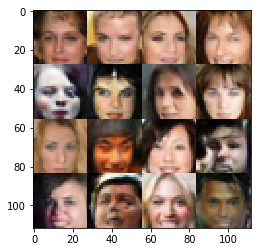

Epochs 40110/60000 Batch Step 2130/3166 gen_loss = -0.6682220101356506..., disc_loss = -0.4938392639160156..., train using time = 11.607
Epochs 40120/60000 Batch Step 2140/3166 gen_loss = -0.023446664214134216..., disc_loss = -0.41652387380599976..., train using time = 11.596
Epochs 40130/60000 Batch Step 2150/3166 gen_loss = -0.18227159976959229..., disc_loss = -0.4030795097351074..., train using time = 11.696
Epochs 40140/60000 Batch Step 2160/3166 gen_loss = 0.3078923225402832..., disc_loss = -0.4158468246459961..., train using time = 11.557
Epochs 40150/60000 Batch Step 2170/3166 gen_loss = 1.215904712677002..., disc_loss = -0.45861977338790894..., train using time = 11.633
Epochs 40160/60000 Batch Step 2180/3166 gen_loss = 1.0225242376327515..., disc_loss = -0.4267732501029968..., train using time = 11.563
Epochs 40170/60000 Batch Step 2190/3166 gen_loss = 0.6325538754463196..., disc_loss = -0.588047444820404..., train using time = 11.627
Epochs 40180/60000 Batch Step 2200/3166 ge

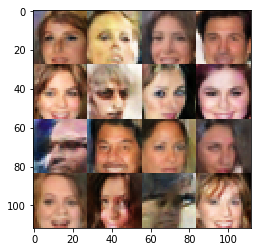

Epochs 40210/60000 Batch Step 2230/3166 gen_loss = -0.48449546098709106..., disc_loss = -0.43008512258529663..., train using time = 11.529
Epochs 40220/60000 Batch Step 2240/3166 gen_loss = 0.12357445806264877..., disc_loss = -0.5903518795967102..., train using time = 12.062
Epochs 40230/60000 Batch Step 2250/3166 gen_loss = 1.4638792276382446..., disc_loss = -0.5342891216278076..., train using time = 11.576
Epochs 40240/60000 Batch Step 2260/3166 gen_loss = 0.5313560962677002..., disc_loss = -0.32704097032546997..., train using time = 11.543
Epochs 40250/60000 Batch Step 2270/3166 gen_loss = -2.0655269622802734..., disc_loss = -0.3400110900402069..., train using time = 11.577
Epochs 40260/60000 Batch Step 2280/3166 gen_loss = -0.7068501710891724..., disc_loss = -0.43625950813293457..., train using time = 11.554
Epochs 40270/60000 Batch Step 2290/3166 gen_loss = 0.48258960247039795..., disc_loss = -0.441704660654068..., train using time = 11.535
Epochs 40280/60000 Batch Step 2300/3166 

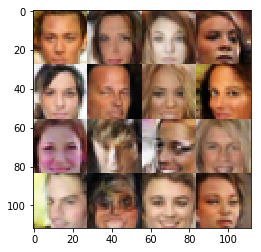

Epochs 40310/60000 Batch Step 2330/3166 gen_loss = -2.38321852684021..., disc_loss = -0.382535845041275..., train using time = 11.608
Epochs 40320/60000 Batch Step 2340/3166 gen_loss = -0.15645170211791992..., disc_loss = -0.625755250453949..., train using time = 11.641
Epochs 40330/60000 Batch Step 2350/3166 gen_loss = -0.9735674262046814..., disc_loss = -0.3839009702205658..., train using time = 11.613
Epochs 40340/60000 Batch Step 2360/3166 gen_loss = -0.903200626373291..., disc_loss = -0.5066708922386169..., train using time = 11.604
Epochs 40350/60000 Batch Step 2370/3166 gen_loss = 0.0556567907333374..., disc_loss = -0.36351436376571655..., train using time = 11.620
Epochs 40360/60000 Batch Step 2380/3166 gen_loss = -0.020528405904769897..., disc_loss = -0.4201758801937103..., train using time = 11.627
Epochs 40370/60000 Batch Step 2390/3166 gen_loss = -0.5790978670120239..., disc_loss = -0.3421071171760559..., train using time = 11.773
Epochs 40380/60000 Batch Step 2400/3166 gen

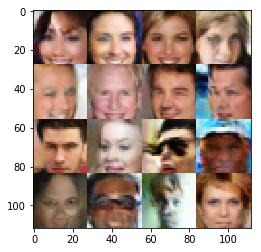

Epochs 40410/60000 Batch Step 2430/3166 gen_loss = -0.0015846118330955505..., disc_loss = -0.4409516751766205..., train using time = 11.677
Epochs 40420/60000 Batch Step 2440/3166 gen_loss = -0.08819733560085297..., disc_loss = -0.41759243607521057..., train using time = 11.584
Epochs 40430/60000 Batch Step 2450/3166 gen_loss = -0.22346802055835724..., disc_loss = -0.49603986740112305..., train using time = 11.503
Epochs 40440/60000 Batch Step 2460/3166 gen_loss = 0.42689958214759827..., disc_loss = -0.4406936764717102..., train using time = 11.609
Epochs 40450/60000 Batch Step 2470/3166 gen_loss = -2.6288814544677734..., disc_loss = -0.33654898405075073..., train using time = 11.578
Epochs 40460/60000 Batch Step 2480/3166 gen_loss = -2.6256003379821777..., disc_loss = -0.43203645944595337..., train using time = 11.440
Epochs 40470/60000 Batch Step 2490/3166 gen_loss = 1.5251646041870117..., disc_loss = -0.39475196599960327..., train using time = 11.571
Epochs 40480/60000 Batch Step 25

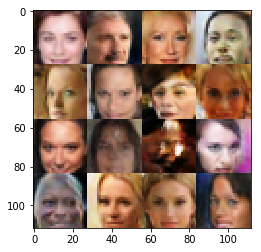

Epochs 40510/60000 Batch Step 2530/3166 gen_loss = 1.4149291515350342..., disc_loss = -0.3836347460746765..., train using time = 11.513
Epochs 40520/60000 Batch Step 2540/3166 gen_loss = 0.33246171474456787..., disc_loss = -0.3986280560493469..., train using time = 11.535
Epochs 40530/60000 Batch Step 2550/3166 gen_loss = -0.5151311159133911..., disc_loss = -0.42826923727989197..., train using time = 11.616
Epochs 40540/60000 Batch Step 2560/3166 gen_loss = 0.7079691290855408..., disc_loss = -0.5585032105445862..., train using time = 11.513
Epochs 40550/60000 Batch Step 2570/3166 gen_loss = -0.7216732501983643..., disc_loss = -0.0949588343501091..., train using time = 11.557
Epochs 40560/60000 Batch Step 2580/3166 gen_loss = -3.458101749420166..., disc_loss = -0.3701477646827698..., train using time = 11.803
Epochs 40570/60000 Batch Step 2590/3166 gen_loss = -0.19500984251499176..., disc_loss = -0.35402074456214905..., train using time = 11.643
Epochs 40580/60000 Batch Step 2600/3166 g

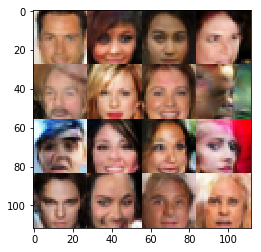

Epochs 40610/60000 Batch Step 2630/3166 gen_loss = 0.6257388591766357..., disc_loss = -0.37319859862327576..., train using time = 11.491
Epochs 40620/60000 Batch Step 2640/3166 gen_loss = 1.4473984241485596..., disc_loss = -0.4912596344947815..., train using time = 11.542
Epochs 40630/60000 Batch Step 2650/3166 gen_loss = -0.3647090792655945..., disc_loss = -0.5061277151107788..., train using time = 11.581
Epochs 40640/60000 Batch Step 2660/3166 gen_loss = -0.09838899970054626..., disc_loss = -0.46510639786720276..., train using time = 11.546
Epochs 40650/60000 Batch Step 2670/3166 gen_loss = 1.9043312072753906..., disc_loss = -0.310377299785614..., train using time = 11.531
Epochs 40660/60000 Batch Step 2680/3166 gen_loss = 0.5877149105072021..., disc_loss = -0.44968992471694946..., train using time = 11.565
Epochs 40670/60000 Batch Step 2690/3166 gen_loss = -1.2871332168579102..., disc_loss = -0.27175989747047424..., train using time = 11.705
Epochs 40680/60000 Batch Step 2700/3166 g

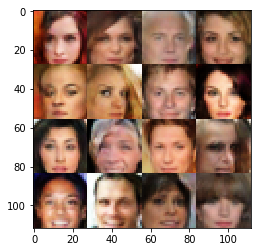

Epochs 40710/60000 Batch Step 2730/3166 gen_loss = -0.47353893518447876..., disc_loss = -0.5565713047981262..., train using time = 11.797
Epochs 40720/60000 Batch Step 2740/3166 gen_loss = 0.20830123126506805..., disc_loss = -0.4799466133117676..., train using time = 11.928
Epochs 40730/60000 Batch Step 2750/3166 gen_loss = 0.8022333383560181..., disc_loss = -0.4280082583427429..., train using time = 11.567
Epochs 40740/60000 Batch Step 2760/3166 gen_loss = 0.7415022253990173..., disc_loss = -0.47157788276672363..., train using time = 11.509
Epochs 40750/60000 Batch Step 2770/3166 gen_loss = -0.5936279892921448..., disc_loss = -0.21986858546733856..., train using time = 11.594
Epochs 40760/60000 Batch Step 2780/3166 gen_loss = 1.2201752662658691..., disc_loss = -0.5016904473304749..., train using time = 12.033
Epochs 40770/60000 Batch Step 2790/3166 gen_loss = 0.518947958946228..., disc_loss = -0.33848267793655396..., train using time = 11.670
Epochs 40780/60000 Batch Step 2800/3166 ge

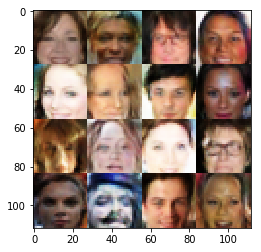

Epochs 40810/60000 Batch Step 2830/3166 gen_loss = -1.0969552993774414..., disc_loss = -0.5779305696487427..., train using time = 11.627
Epochs 40820/60000 Batch Step 2840/3166 gen_loss = -0.6738653182983398..., disc_loss = -0.5768924951553345..., train using time = 11.635
Epochs 40830/60000 Batch Step 2850/3166 gen_loss = 0.5782864093780518..., disc_loss = -0.4031442701816559..., train using time = 11.611
Epochs 40840/60000 Batch Step 2860/3166 gen_loss = 0.5783063173294067..., disc_loss = -0.6463325619697571..., train using time = 11.621
Epochs 40850/60000 Batch Step 2870/3166 gen_loss = -0.6020568609237671..., disc_loss = -0.4369281828403473..., train using time = 11.809
Epochs 40860/60000 Batch Step 2880/3166 gen_loss = -0.4227217733860016..., disc_loss = -0.531171977519989..., train using time = 12.005
Epochs 40870/60000 Batch Step 2890/3166 gen_loss = 0.21094925701618195..., disc_loss = -0.5630384683609009..., train using time = 11.718
Epochs 40880/60000 Batch Step 2900/3166 gen_

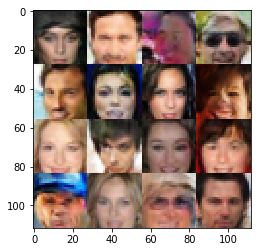

Epochs 40910/60000 Batch Step 2930/3166 gen_loss = -0.5272979736328125..., disc_loss = -0.6972731947898865..., train using time = 11.586
Epochs 40920/60000 Batch Step 2940/3166 gen_loss = 1.0505479574203491..., disc_loss = -0.437142938375473..., train using time = 11.633
Epochs 40930/60000 Batch Step 2950/3166 gen_loss = -0.027809295803308487..., disc_loss = -0.3965384066104889..., train using time = 11.544
Epochs 40940/60000 Batch Step 2960/3166 gen_loss = 0.25751280784606934..., disc_loss = -0.613227367401123..., train using time = 11.704
Epochs 40950/60000 Batch Step 2970/3166 gen_loss = -0.28400951623916626..., disc_loss = -0.4230225086212158..., train using time = 11.649
Epochs 40960/60000 Batch Step 2980/3166 gen_loss = 0.6571989059448242..., disc_loss = -0.39555561542510986..., train using time = 11.638
Epochs 40970/60000 Batch Step 2990/3166 gen_loss = 1.0481953620910645..., disc_loss = -0.4681514799594879..., train using time = 15.055
Epochs 40980/60000 Batch Step 3000/3166 ge

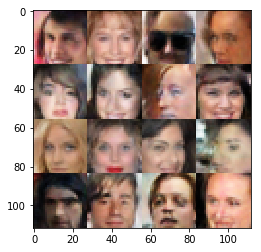

Epochs 41010/60000 Batch Step 3030/3166 gen_loss = 0.8847285509109497..., disc_loss = -0.4573497176170349..., train using time = 11.829
Epochs 41020/60000 Batch Step 3040/3166 gen_loss = -0.9381797313690186..., disc_loss = 0.1774531751871109..., train using time = 11.655
Epochs 41030/60000 Batch Step 3050/3166 gen_loss = -0.025199858471751213..., disc_loss = -0.4277418255805969..., train using time = 11.612
Epochs 41040/60000 Batch Step 3060/3166 gen_loss = 0.5802428722381592..., disc_loss = -0.5442773103713989..., train using time = 11.769
Epochs 41050/60000 Batch Step 3070/3166 gen_loss = 2.1876044273376465..., disc_loss = -0.428710401058197..., train using time = 11.578
Epochs 41060/60000 Batch Step 3080/3166 gen_loss = 1.4324523210525513..., disc_loss = -0.42227548360824585..., train using time = 11.632
Epochs 41070/60000 Batch Step 3090/3166 gen_loss = 1.2790703773498535..., disc_loss = -0.38839417695999146..., train using time = 12.180
Epochs 41080/60000 Batch Step 3100/3166 gen_

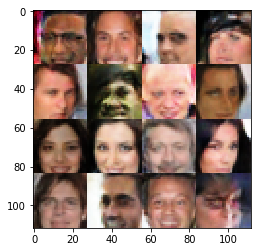

Epochs 41110/60000 Batch Step 3130/3166 gen_loss = 0.19131001830101013..., disc_loss = -0.473724365234375..., train using time = 11.562
Epochs 41120/60000 Batch Step 3140/3166 gen_loss = -0.09513619542121887..., disc_loss = -0.45001038908958435..., train using time = 11.549
Epochs 41130/60000 Batch Step 3150/3166 gen_loss = -1.0418293476104736..., disc_loss = -0.4295457899570465..., train using time = 11.978
Epochs 41140/60000 Batch Step 3160/3166 gen_loss = 0.8490126729011536..., disc_loss = -0.4153617322444916..., train using time = 12.208
Epochs 41150/60000 Batch Step 5/3166 gen_loss = 3.193108081817627..., disc_loss = -0.4294446110725403..., train using time = 11.551
Epochs 41160/60000 Batch Step 15/3166 gen_loss = 1.99397873878479..., disc_loss = -0.47720783948898315..., train using time = 11.458
Epochs 41170/60000 Batch Step 25/3166 gen_loss = 0.6504004001617432..., disc_loss = -0.5710861086845398..., train using time = 11.598
Epochs 41180/60000 Batch Step 35/3166 gen_loss = 0.94

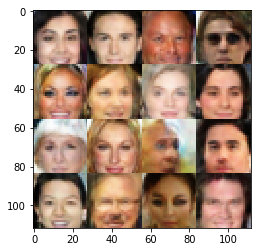

Epochs 41210/60000 Batch Step 65/3166 gen_loss = 0.03596694767475128..., disc_loss = -0.37929585576057434..., train using time = 11.614
Epochs 41220/60000 Batch Step 75/3166 gen_loss = 2.0201656818389893..., disc_loss = -0.3577254116535187..., train using time = 12.866
Epochs 41230/60000 Batch Step 85/3166 gen_loss = 0.2180698812007904..., disc_loss = -0.5300742387771606..., train using time = 11.492
Epochs 41240/60000 Batch Step 95/3166 gen_loss = 0.5029441118240356..., disc_loss = -0.325397789478302..., train using time = 11.799
Epochs 41250/60000 Batch Step 105/3166 gen_loss = 1.353960394859314..., disc_loss = -0.3323376774787903..., train using time = 11.526
Epochs 41260/60000 Batch Step 115/3166 gen_loss = 0.14460766315460205..., disc_loss = -0.5784159302711487..., train using time = 11.601
Epochs 41270/60000 Batch Step 125/3166 gen_loss = -0.0007764101028442383..., disc_loss = -0.4245087206363678..., train using time = 11.643
Epochs 41280/60000 Batch Step 135/3166 gen_loss = -0.4

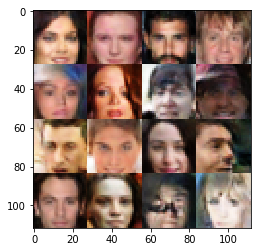

Epochs 41310/60000 Batch Step 165/3166 gen_loss = -0.44642096757888794..., disc_loss = -0.4506700932979584..., train using time = 11.815
Epochs 41320/60000 Batch Step 175/3166 gen_loss = 1.5163440704345703..., disc_loss = -0.361672580242157..., train using time = 11.628
Epochs 41330/60000 Batch Step 185/3166 gen_loss = 0.4658809304237366..., disc_loss = -0.28710466623306274..., train using time = 11.650
Epochs 41340/60000 Batch Step 195/3166 gen_loss = -0.045128561556339264..., disc_loss = -0.6004272699356079..., train using time = 11.736
Epochs 41350/60000 Batch Step 205/3166 gen_loss = 1.7185769081115723..., disc_loss = -0.39930596947669983..., train using time = 11.541
Epochs 41360/60000 Batch Step 215/3166 gen_loss = -0.15004482865333557..., disc_loss = -0.507597804069519..., train using time = 11.795
Epochs 41370/60000 Batch Step 225/3166 gen_loss = -0.8601582050323486..., disc_loss = -0.4345227777957916..., train using time = 11.680
Epochs 41380/60000 Batch Step 235/3166 gen_loss

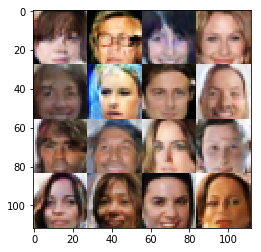

Epochs 41410/60000 Batch Step 265/3166 gen_loss = 0.824371337890625..., disc_loss = -0.4676592946052551..., train using time = 11.655
Epochs 41420/60000 Batch Step 275/3166 gen_loss = -1.3860113620758057..., disc_loss = -0.3712273836135864..., train using time = 11.722
Epochs 41430/60000 Batch Step 285/3166 gen_loss = 0.4362550377845764..., disc_loss = -0.4128544330596924..., train using time = 11.672
Epochs 41440/60000 Batch Step 295/3166 gen_loss = 0.6425129175186157..., disc_loss = -0.5230001211166382..., train using time = 11.635
Epochs 41450/60000 Batch Step 305/3166 gen_loss = -0.23987196385860443..., disc_loss = -0.49116650223731995..., train using time = 13.063
Epochs 41460/60000 Batch Step 315/3166 gen_loss = 0.023217283189296722..., disc_loss = -0.3406223654747009..., train using time = 11.524
Epochs 41470/60000 Batch Step 325/3166 gen_loss = -1.2123990058898926..., disc_loss = -0.35653337836265564..., train using time = 11.668
Epochs 41480/60000 Batch Step 335/3166 gen_loss 

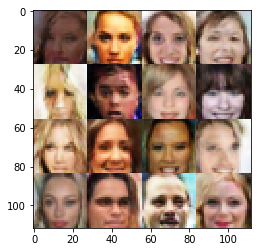

Epochs 41510/60000 Batch Step 365/3166 gen_loss = 0.3612922132015228..., disc_loss = -0.36837953329086304..., train using time = 12.161
Epochs 41520/60000 Batch Step 375/3166 gen_loss = -1.109503149986267..., disc_loss = -0.3306037485599518..., train using time = 11.575
Epochs 41530/60000 Batch Step 385/3166 gen_loss = -0.11730731278657913..., disc_loss = -0.2536245286464691..., train using time = 11.407
Epochs 41540/60000 Batch Step 395/3166 gen_loss = -0.771767258644104..., disc_loss = -0.4279983937740326..., train using time = 11.702
Epochs 41550/60000 Batch Step 405/3166 gen_loss = 1.0272458791732788..., disc_loss = -0.5036665201187134..., train using time = 11.530
Epochs 41560/60000 Batch Step 415/3166 gen_loss = 0.008558154106140137..., disc_loss = -0.490774005651474..., train using time = 11.501
Epochs 41570/60000 Batch Step 425/3166 gen_loss = 1.1412405967712402..., disc_loss = -0.47780418395996094..., train using time = 11.547
Epochs 41580/60000 Batch Step 435/3166 gen_loss = 

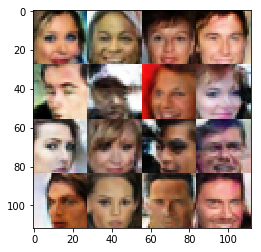

Epochs 41610/60000 Batch Step 465/3166 gen_loss = 0.07990994304418564..., disc_loss = -0.2925149202346802..., train using time = 11.725
Epochs 41620/60000 Batch Step 475/3166 gen_loss = 1.3511048555374146..., disc_loss = -0.39631718397140503..., train using time = 11.656
Epochs 41630/60000 Batch Step 485/3166 gen_loss = -0.4162440896034241..., disc_loss = -0.6629406213760376..., train using time = 11.640
Epochs 41640/60000 Batch Step 495/3166 gen_loss = -0.2759701907634735..., disc_loss = -0.4432368278503418..., train using time = 11.578
Epochs 41650/60000 Batch Step 505/3166 gen_loss = 1.6057734489440918..., disc_loss = -0.44745421409606934..., train using time = 11.608
Epochs 41660/60000 Batch Step 515/3166 gen_loss = -0.4789780378341675..., disc_loss = -0.522453784942627..., train using time = 11.557
Epochs 41670/60000 Batch Step 525/3166 gen_loss = 0.6712636947631836..., disc_loss = -0.40934237837791443..., train using time = 11.556
Epochs 41680/60000 Batch Step 535/3166 gen_loss =

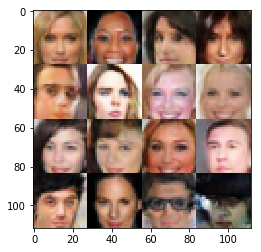

Epochs 41710/60000 Batch Step 565/3166 gen_loss = -0.2319975346326828..., disc_loss = -0.3959781229496002..., train using time = 11.777
Epochs 41720/60000 Batch Step 575/3166 gen_loss = -0.9803206920623779..., disc_loss = -0.35504966974258423..., train using time = 11.555
Epochs 41730/60000 Batch Step 585/3166 gen_loss = 0.8465425372123718..., disc_loss = -0.5243461728096008..., train using time = 11.630
Epochs 41740/60000 Batch Step 595/3166 gen_loss = -1.249647617340088..., disc_loss = -0.48690685629844666..., train using time = 11.500
Epochs 41750/60000 Batch Step 605/3166 gen_loss = 2.4484786987304688..., disc_loss = -0.31857404112815857..., train using time = 11.573
Epochs 41760/60000 Batch Step 615/3166 gen_loss = 0.07001608610153198..., disc_loss = -0.46528464555740356..., train using time = 11.648
Epochs 41770/60000 Batch Step 625/3166 gen_loss = -0.5241029262542725..., disc_loss = -0.4611060619354248..., train using time = 11.642
Epochs 41780/60000 Batch Step 635/3166 gen_loss

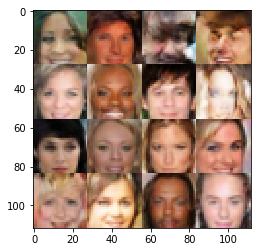

Epochs 41810/60000 Batch Step 665/3166 gen_loss = -1.6516532897949219..., disc_loss = -0.5240920782089233..., train using time = 11.761
Epochs 41820/60000 Batch Step 675/3166 gen_loss = 0.5290287137031555..., disc_loss = -0.5418795347213745..., train using time = 11.559
Epochs 41830/60000 Batch Step 685/3166 gen_loss = 1.0496230125427246..., disc_loss = -0.4471270442008972..., train using time = 11.499
Epochs 41840/60000 Batch Step 695/3166 gen_loss = -0.06512986123561859..., disc_loss = -0.4108120799064636..., train using time = 11.481
Epochs 41850/60000 Batch Step 705/3166 gen_loss = 0.240586519241333..., disc_loss = -0.4159170091152191..., train using time = 11.633
Epochs 41860/60000 Batch Step 715/3166 gen_loss = -1.0425537824630737..., disc_loss = -0.283562570810318..., train using time = 11.558
Epochs 41870/60000 Batch Step 725/3166 gen_loss = 1.448394536972046..., disc_loss = -0.47228068113327026..., train using time = 11.649
Epochs 41880/60000 Batch Step 735/3166 gen_loss = -0.

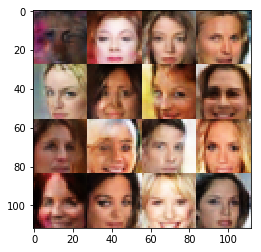

Epochs 41910/60000 Batch Step 765/3166 gen_loss = 0.3965303599834442..., disc_loss = -0.2940250039100647..., train using time = 12.934
Epochs 41920/60000 Batch Step 775/3166 gen_loss = -0.6245646476745605..., disc_loss = -0.5011362433433533..., train using time = 11.544
Epochs 41930/60000 Batch Step 785/3166 gen_loss = -1.083211898803711..., disc_loss = -0.3858141303062439..., train using time = 11.668
Epochs 41940/60000 Batch Step 795/3166 gen_loss = -0.5116739869117737..., disc_loss = -0.48280373215675354..., train using time = 11.692
Epochs 41950/60000 Batch Step 805/3166 gen_loss = 0.30841001868247986..., disc_loss = -0.4523908197879791..., train using time = 11.845
Epochs 41960/60000 Batch Step 815/3166 gen_loss = -0.6136869788169861..., disc_loss = -0.6414874196052551..., train using time = 11.678
Epochs 41970/60000 Batch Step 825/3166 gen_loss = 1.1099660396575928..., disc_loss = -0.49736666679382324..., train using time = 11.619
Epochs 41980/60000 Batch Step 835/3166 gen_loss =

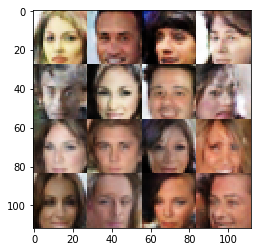

Epochs 42010/60000 Batch Step 865/3166 gen_loss = -0.6352009773254395..., disc_loss = -0.4951746463775635..., train using time = 11.542
Epochs 42020/60000 Batch Step 875/3166 gen_loss = 0.5427227020263672..., disc_loss = -0.4233662486076355..., train using time = 11.744
Epochs 42030/60000 Batch Step 885/3166 gen_loss = -0.2957691252231598..., disc_loss = -0.33720749616622925..., train using time = 11.619
Epochs 42040/60000 Batch Step 895/3166 gen_loss = -0.5681455135345459..., disc_loss = -0.5325692296028137..., train using time = 11.532
Epochs 42050/60000 Batch Step 905/3166 gen_loss = -0.30324476957321167..., disc_loss = -0.32774510979652405..., train using time = 11.561
Epochs 42060/60000 Batch Step 915/3166 gen_loss = 1.0240181684494019..., disc_loss = -0.4868871569633484..., train using time = 11.572
Epochs 42070/60000 Batch Step 925/3166 gen_loss = -0.28349539637565613..., disc_loss = -0.3152262568473816..., train using time = 11.475
Epochs 42080/60000 Batch Step 935/3166 gen_los

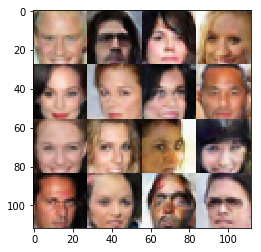

Epochs 42110/60000 Batch Step 965/3166 gen_loss = 0.8890351057052612..., disc_loss = -0.4749792218208313..., train using time = 11.592
Epochs 42120/60000 Batch Step 975/3166 gen_loss = 0.34702861309051514..., disc_loss = -0.30825313925743103..., train using time = 11.816
Epochs 42130/60000 Batch Step 985/3166 gen_loss = -0.6541577577590942..., disc_loss = -0.13773521780967712..., train using time = 11.841
Epochs 42140/60000 Batch Step 995/3166 gen_loss = 0.5198901891708374..., disc_loss = -0.5529419183731079..., train using time = 11.674
Epochs 42150/60000 Batch Step 1005/3166 gen_loss = 0.2426660656929016..., disc_loss = -0.36739322543144226..., train using time = 11.573
Epochs 42160/60000 Batch Step 1015/3166 gen_loss = 1.5300074815750122..., disc_loss = -0.4890972971916199..., train using time = 11.514
Epochs 42170/60000 Batch Step 1025/3166 gen_loss = 0.8708522319793701..., disc_loss = -0.4955308437347412..., train using time = 11.511
Epochs 42180/60000 Batch Step 1035/3166 gen_los

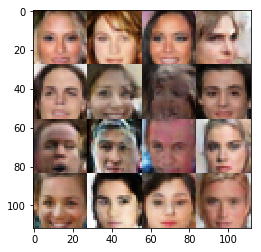

Epochs 42210/60000 Batch Step 1065/3166 gen_loss = -0.5309973359107971..., disc_loss = -0.31505468487739563..., train using time = 11.759
Epochs 42220/60000 Batch Step 1075/3166 gen_loss = 1.0641299486160278..., disc_loss = -0.43201565742492676..., train using time = 12.738
Epochs 42230/60000 Batch Step 1085/3166 gen_loss = 0.2970489263534546..., disc_loss = -0.4620184898376465..., train using time = 11.483
Epochs 42240/60000 Batch Step 1095/3166 gen_loss = 1.936205506324768..., disc_loss = -0.3794223964214325..., train using time = 11.540
Epochs 42250/60000 Batch Step 1105/3166 gen_loss = -0.32823416590690613..., disc_loss = -0.4574131965637207..., train using time = 11.782
Epochs 42260/60000 Batch Step 1115/3166 gen_loss = -0.10079669952392578..., disc_loss = -0.45229920744895935..., train using time = 11.555
Epochs 42270/60000 Batch Step 1125/3166 gen_loss = 1.1073675155639648..., disc_loss = -0.5321916937828064..., train using time = 11.615
Epochs 42280/60000 Batch Step 1135/3166 g

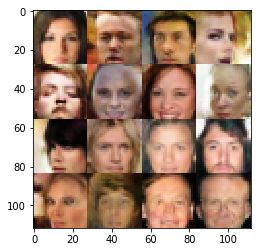

Epochs 42310/60000 Batch Step 1165/3166 gen_loss = 0.024759210646152496..., disc_loss = -0.3656948208808899..., train using time = 11.679
Epochs 42320/60000 Batch Step 1175/3166 gen_loss = 1.8849093914031982..., disc_loss = -0.5171282291412354..., train using time = 11.562
Epochs 42330/60000 Batch Step 1185/3166 gen_loss = 0.8545709252357483..., disc_loss = -0.4728313386440277..., train using time = 11.461
Epochs 42340/60000 Batch Step 1195/3166 gen_loss = 0.13741661608219147..., disc_loss = -0.5196632146835327..., train using time = 11.534
Epochs 42350/60000 Batch Step 1205/3166 gen_loss = 1.4444773197174072..., disc_loss = -0.517951488494873..., train using time = 11.570
Epochs 42360/60000 Batch Step 1215/3166 gen_loss = -0.2886248826980591..., disc_loss = -0.4010162353515625..., train using time = 12.023
Epochs 42370/60000 Batch Step 1225/3166 gen_loss = -0.7344957590103149..., disc_loss = -0.45640629529953003..., train using time = 11.783
Epochs 42380/60000 Batch Step 1235/3166 gen

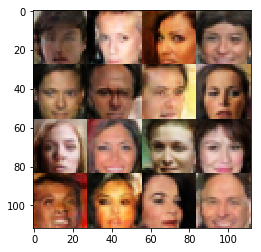

Epochs 42410/60000 Batch Step 1265/3166 gen_loss = 0.6460684537887573..., disc_loss = -0.4140620231628418..., train using time = 11.643
Epochs 42420/60000 Batch Step 1275/3166 gen_loss = -2.135532855987549..., disc_loss = -0.3480502665042877..., train using time = 11.476
Epochs 42430/60000 Batch Step 1285/3166 gen_loss = 0.018867986276745796..., disc_loss = -0.5019069314002991..., train using time = 11.553
Epochs 42440/60000 Batch Step 1295/3166 gen_loss = 1.732685923576355..., disc_loss = -0.6111552715301514..., train using time = 11.509
Epochs 42450/60000 Batch Step 1305/3166 gen_loss = -0.08065377920866013..., disc_loss = -0.4655727744102478..., train using time = 13.415
Epochs 42460/60000 Batch Step 1315/3166 gen_loss = 1.9585483074188232..., disc_loss = 0.008799716830253601..., train using time = 11.492
Epochs 42470/60000 Batch Step 1325/3166 gen_loss = 0.0183245912194252..., disc_loss = -0.43051186203956604..., train using time = 11.639
Epochs 42480/60000 Batch Step 1335/3166 gen

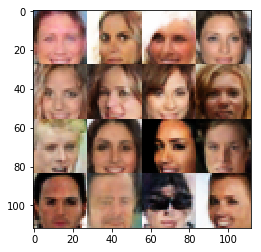

Epochs 42510/60000 Batch Step 1365/3166 gen_loss = 0.3306328356266022..., disc_loss = -0.49788522720336914..., train using time = 11.705
Epochs 42520/60000 Batch Step 1375/3166 gen_loss = 0.37864959239959717..., disc_loss = -0.42030924558639526..., train using time = 11.492
Epochs 42530/60000 Batch Step 1385/3166 gen_loss = 1.2478008270263672..., disc_loss = -0.44997280836105347..., train using time = 11.537
Epochs 42540/60000 Batch Step 1395/3166 gen_loss = 0.06554198265075684..., disc_loss = -0.27590644359588623..., train using time = 11.690
Epochs 42550/60000 Batch Step 1405/3166 gen_loss = 2.550626754760742..., disc_loss = -0.48077282309532166..., train using time = 11.509
Epochs 42560/60000 Batch Step 1415/3166 gen_loss = -0.34740787744522095..., disc_loss = -0.40736809372901917..., train using time = 11.608
Epochs 42570/60000 Batch Step 1425/3166 gen_loss = 0.8059762120246887..., disc_loss = -0.3844209909439087..., train using time = 11.828
Epochs 42580/60000 Batch Step 1435/3166

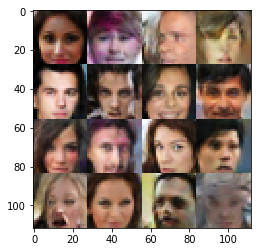

Epochs 42610/60000 Batch Step 1465/3166 gen_loss = 1.5175834894180298..., disc_loss = -0.41345471143722534..., train using time = 11.673
Epochs 42620/60000 Batch Step 1475/3166 gen_loss = -2.113908290863037..., disc_loss = -0.3009835183620453..., train using time = 11.559
Epochs 42630/60000 Batch Step 1485/3166 gen_loss = -0.3999325931072235..., disc_loss = -0.5755776166915894..., train using time = 11.647
Epochs 42640/60000 Batch Step 1495/3166 gen_loss = -0.11307298392057419..., disc_loss = -0.41105347871780396..., train using time = 11.570
Epochs 42650/60000 Batch Step 1505/3166 gen_loss = 0.2505301237106323..., disc_loss = -0.4314784109592438..., train using time = 11.614
Epochs 42660/60000 Batch Step 1515/3166 gen_loss = -0.4711505174636841..., disc_loss = -0.4308180809020996..., train using time = 11.616
Epochs 42670/60000 Batch Step 1525/3166 gen_loss = 2.4464006423950195..., disc_loss = -0.34030652046203613..., train using time = 11.774
Epochs 42680/60000 Batch Step 1535/3166 g

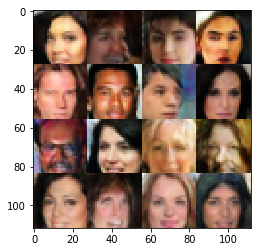

Epochs 42710/60000 Batch Step 1565/3166 gen_loss = -2.4209086894989014..., disc_loss = -0.3475009799003601..., train using time = 11.655
Epochs 42720/60000 Batch Step 1575/3166 gen_loss = -2.1362643241882324..., disc_loss = -0.4460185170173645..., train using time = 11.635
Epochs 42730/60000 Batch Step 1585/3166 gen_loss = 1.5088744163513184..., disc_loss = -0.21274390816688538..., train using time = 11.532
Epochs 42740/60000 Batch Step 1595/3166 gen_loss = -2.154752254486084..., disc_loss = -0.3758895993232727..., train using time = 11.552
Epochs 42750/60000 Batch Step 1605/3166 gen_loss = -1.3131831884384155..., disc_loss = -0.5616298317909241..., train using time = 11.569
Epochs 42760/60000 Batch Step 1615/3166 gen_loss = -1.2542396783828735..., disc_loss = -0.5819946527481079..., train using time = 11.867
Epochs 42770/60000 Batch Step 1625/3166 gen_loss = -0.25532904267311096..., disc_loss = -0.42449894547462463..., train using time = 11.518
Epochs 42780/60000 Batch Step 1635/3166 

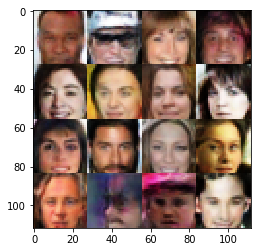

Epochs 42810/60000 Batch Step 1665/3166 gen_loss = -1.7601282596588135..., disc_loss = -0.34547942876815796..., train using time = 11.685
Epochs 42820/60000 Batch Step 1675/3166 gen_loss = 0.08428438007831573..., disc_loss = -0.42907294631004333..., train using time = 11.559
Epochs 42830/60000 Batch Step 1685/3166 gen_loss = -0.5954211950302124..., disc_loss = -0.46420860290527344..., train using time = 11.553
Epochs 42840/60000 Batch Step 1695/3166 gen_loss = 0.6407906413078308..., disc_loss = -0.5521424412727356..., train using time = 11.691
Epochs 42850/60000 Batch Step 1705/3166 gen_loss = -1.8180148601531982..., disc_loss = -0.3552370071411133..., train using time = 11.635
Epochs 42860/60000 Batch Step 1715/3166 gen_loss = -1.43851637840271..., disc_loss = -0.43493565917015076..., train using time = 11.834
Epochs 42870/60000 Batch Step 1725/3166 gen_loss = -1.0669629573822021..., disc_loss = -0.418170303106308..., train using time = 11.741
Epochs 42880/60000 Batch Step 1735/3166 g

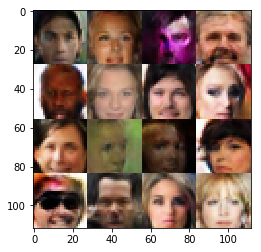

Epochs 42910/60000 Batch Step 1765/3166 gen_loss = 0.4499264061450958..., disc_loss = -0.3994276523590088..., train using time = 12.024
Epochs 42920/60000 Batch Step 1775/3166 gen_loss = -0.398165225982666..., disc_loss = -0.4144528806209564..., train using time = 11.637
Epochs 42930/60000 Batch Step 1785/3166 gen_loss = 0.6123958230018616..., disc_loss = -0.446748822927475..., train using time = 11.574
Epochs 42940/60000 Batch Step 1795/3166 gen_loss = 0.6795541048049927..., disc_loss = -0.3302221894264221..., train using time = 11.653
Epochs 42950/60000 Batch Step 1805/3166 gen_loss = -1.551801323890686..., disc_loss = -0.5003120303153992..., train using time = 11.530
Epochs 42960/60000 Batch Step 1815/3166 gen_loss = 0.7527374625205994..., disc_loss = -0.3359955847263336..., train using time = 11.546
Epochs 42970/60000 Batch Step 1825/3166 gen_loss = -0.8617675304412842..., disc_loss = -0.1988728940486908..., train using time = 11.556
Epochs 42980/60000 Batch Step 1835/3166 gen_loss

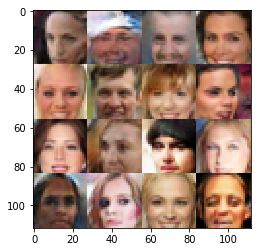

Epochs 43010/60000 Batch Step 1865/3166 gen_loss = -0.49465256929397583..., disc_loss = -0.6032809019088745..., train using time = 11.640
Epochs 43020/60000 Batch Step 1875/3166 gen_loss = 0.8338736891746521..., disc_loss = -0.5628651976585388..., train using time = 11.589
Epochs 43030/60000 Batch Step 1885/3166 gen_loss = 0.10460907965898514..., disc_loss = -0.49391207098960876..., train using time = 11.666
Epochs 43040/60000 Batch Step 1895/3166 gen_loss = 0.31003832817077637..., disc_loss = -0.4060821533203125..., train using time = 11.662
Epochs 43050/60000 Batch Step 1905/3166 gen_loss = 1.1034815311431885..., disc_loss = -0.5125953555107117..., train using time = 11.634
Epochs 43060/60000 Batch Step 1915/3166 gen_loss = -0.5887531042098999..., disc_loss = -0.3707882761955261..., train using time = 11.588
Epochs 43070/60000 Batch Step 1925/3166 gen_loss = 0.3679330348968506..., disc_loss = -0.4302632808685303..., train using time = 11.628
Epochs 43080/60000 Batch Step 1935/3166 ge

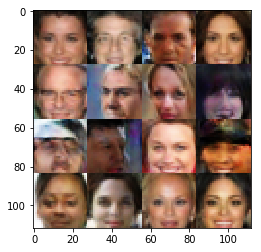

Epochs 43110/60000 Batch Step 1965/3166 gen_loss = 0.5980538129806519..., disc_loss = -0.536663830280304..., train using time = 11.920
Epochs 43120/60000 Batch Step 1975/3166 gen_loss = -0.5566400289535522..., disc_loss = -0.5150934457778931..., train using time = 11.566
Epochs 43130/60000 Batch Step 1985/3166 gen_loss = 0.13684548437595367..., disc_loss = -0.42829766869544983..., train using time = 11.598
Epochs 43140/60000 Batch Step 1995/3166 gen_loss = 0.04727618023753166..., disc_loss = -0.5067945718765259..., train using time = 11.639
Epochs 43150/60000 Batch Step 2005/3166 gen_loss = 0.9384321570396423..., disc_loss = -0.46740540862083435..., train using time = 11.489
Epochs 43160/60000 Batch Step 2015/3166 gen_loss = -0.2002113163471222..., disc_loss = -0.5556706190109253..., train using time = 11.572
Epochs 43170/60000 Batch Step 2025/3166 gen_loss = 1.3918999433517456..., disc_loss = -0.4676712155342102..., train using time = 11.582
Epochs 43180/60000 Batch Step 2035/3166 gen

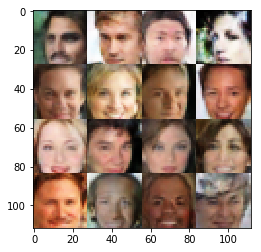

Epochs 43210/60000 Batch Step 2065/3166 gen_loss = 1.1466119289398193..., disc_loss = -0.3362472653388977..., train using time = 11.718
Epochs 43220/60000 Batch Step 2075/3166 gen_loss = 0.3482271134853363..., disc_loss = -0.5222281217575073..., train using time = 13.032
Epochs 43230/60000 Batch Step 2085/3166 gen_loss = 2.0015902519226074..., disc_loss = -0.40761223435401917..., train using time = 11.758
Epochs 43240/60000 Batch Step 2095/3166 gen_loss = 0.35225459933280945..., disc_loss = -0.43657827377319336..., train using time = 11.508
Epochs 43250/60000 Batch Step 2105/3166 gen_loss = 1.29347562789917..., disc_loss = -0.3418782353401184..., train using time = 11.608
Epochs 43260/60000 Batch Step 2115/3166 gen_loss = -1.6728724241256714..., disc_loss = -0.4568498730659485..., train using time = 11.645
Epochs 43270/60000 Batch Step 2125/3166 gen_loss = 1.859102487564087..., disc_loss = -0.37814468145370483..., train using time = 11.628
Epochs 43280/60000 Batch Step 2135/3166 gen_lo

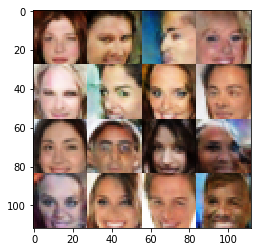

Epochs 43310/60000 Batch Step 2165/3166 gen_loss = 1.7563502788543701..., disc_loss = -0.3851429522037506..., train using time = 11.679
Epochs 43320/60000 Batch Step 2175/3166 gen_loss = 2.36354660987854..., disc_loss = -0.19365735352039337..., train using time = 11.900
Epochs 43330/60000 Batch Step 2185/3166 gen_loss = -0.2872076630592346..., disc_loss = -0.5946775674819946..., train using time = 11.612
Epochs 43340/60000 Batch Step 2195/3166 gen_loss = 0.7351529002189636..., disc_loss = -0.26528531312942505..., train using time = 11.615
Epochs 43350/60000 Batch Step 2205/3166 gen_loss = -1.187341332435608..., disc_loss = -0.40480342507362366..., train using time = 11.655
Epochs 43360/60000 Batch Step 2215/3166 gen_loss = -0.2632344961166382..., disc_loss = -0.45412522554397583..., train using time = 11.835
Epochs 43370/60000 Batch Step 2225/3166 gen_loss = -0.4047561287879944..., disc_loss = -0.4613439440727234..., train using time = 11.609
Epochs 43380/60000 Batch Step 2235/3166 gen

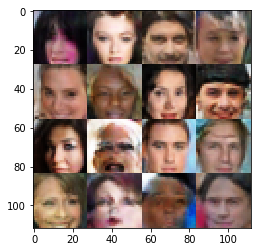

Epochs 43410/60000 Batch Step 2265/3166 gen_loss = -0.3752342462539673..., disc_loss = -0.39624351263046265..., train using time = 11.680
Epochs 43420/60000 Batch Step 2275/3166 gen_loss = -3.157407522201538..., disc_loss = -0.2868419289588928..., train using time = 11.768
Epochs 43430/60000 Batch Step 2285/3166 gen_loss = 0.07646355777978897..., disc_loss = -0.48322591185569763..., train using time = 11.621
Epochs 43440/60000 Batch Step 2295/3166 gen_loss = -1.1385605335235596..., disc_loss = -0.487282931804657..., train using time = 11.706
Epochs 43450/60000 Batch Step 2305/3166 gen_loss = 0.3805135488510132..., disc_loss = -0.41408252716064453..., train using time = 13.013
Epochs 43460/60000 Batch Step 2315/3166 gen_loss = 0.41411513090133667..., disc_loss = -0.3931660056114197..., train using time = 11.638
Epochs 43470/60000 Batch Step 2325/3166 gen_loss = -0.8454309701919556..., disc_loss = -0.41459450125694275..., train using time = 11.660
Epochs 43480/60000 Batch Step 2335/3166 

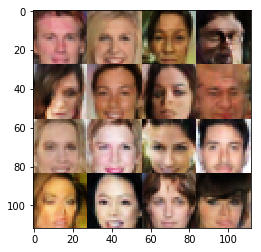

Epochs 43510/60000 Batch Step 2365/3166 gen_loss = -0.8272371888160706..., disc_loss = -0.4004860818386078..., train using time = 11.661
Epochs 43520/60000 Batch Step 2375/3166 gen_loss = 1.277449131011963..., disc_loss = -0.3872453272342682..., train using time = 11.687
Epochs 43530/60000 Batch Step 2385/3166 gen_loss = 0.31234651803970337..., disc_loss = -0.5466086268424988..., train using time = 11.588
Epochs 43540/60000 Batch Step 2395/3166 gen_loss = -1.6737130880355835..., disc_loss = -0.3414488732814789..., train using time = 11.754
Epochs 43550/60000 Batch Step 2405/3166 gen_loss = 1.2393779754638672..., disc_loss = -0.5007034540176392..., train using time = 11.688
Epochs 43560/60000 Batch Step 2415/3166 gen_loss = -0.5045753717422485..., disc_loss = -0.4190458357334137..., train using time = 11.560
Epochs 43570/60000 Batch Step 2425/3166 gen_loss = 0.6360317468643188..., disc_loss = -0.38765519857406616..., train using time = 11.643
Epochs 43580/60000 Batch Step 2435/3166 gen_

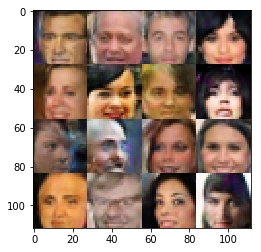

Epochs 43610/60000 Batch Step 2465/3166 gen_loss = 0.33420976996421814..., disc_loss = -0.4029780328273773..., train using time = 11.684
Epochs 43620/60000 Batch Step 2475/3166 gen_loss = -1.0384933948516846..., disc_loss = -0.48557227849960327..., train using time = 11.573
Epochs 43630/60000 Batch Step 2485/3166 gen_loss = 0.9185377359390259..., disc_loss = -0.436149537563324..., train using time = 11.620
Epochs 43640/60000 Batch Step 2495/3166 gen_loss = -0.23404009640216827..., disc_loss = -0.49885720014572144..., train using time = 11.596
Epochs 43650/60000 Batch Step 2505/3166 gen_loss = -0.2622220814228058..., disc_loss = -0.3815293312072754..., train using time = 11.645
Epochs 43660/60000 Batch Step 2515/3166 gen_loss = 0.025876712054014206..., disc_loss = -0.4738301634788513..., train using time = 12.012
Epochs 43670/60000 Batch Step 2525/3166 gen_loss = -1.2482359409332275..., disc_loss = -0.48902425169944763..., train using time = 11.706
Epochs 43680/60000 Batch Step 2535/316

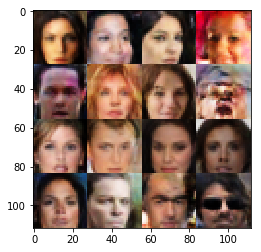

Epochs 43710/60000 Batch Step 2565/3166 gen_loss = -0.0975026786327362..., disc_loss = -0.4111252427101135..., train using time = 11.903
Epochs 43720/60000 Batch Step 2575/3166 gen_loss = -0.14695994555950165..., disc_loss = -0.46184754371643066..., train using time = 11.868
Epochs 43730/60000 Batch Step 2585/3166 gen_loss = -1.6132533550262451..., disc_loss = -0.4084571897983551..., train using time = 11.751
Epochs 43740/60000 Batch Step 2595/3166 gen_loss = 0.6487274169921875..., disc_loss = -0.3572566509246826..., train using time = 11.637
Epochs 43750/60000 Batch Step 2605/3166 gen_loss = 0.07495932281017303..., disc_loss = -0.4395674765110016..., train using time = 11.747
Epochs 43760/60000 Batch Step 2615/3166 gen_loss = 1.1140117645263672..., disc_loss = -0.34336328506469727..., train using time = 11.582
Epochs 43770/60000 Batch Step 2625/3166 gen_loss = -0.07400111109018326..., disc_loss = -0.46323901414871216..., train using time = 11.635
Epochs 43780/60000 Batch Step 2635/316

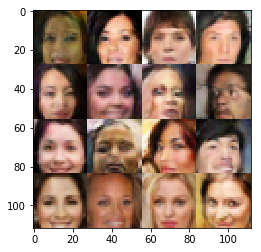

Epochs 43810/60000 Batch Step 2665/3166 gen_loss = 1.1726783514022827..., disc_loss = -0.37758684158325195..., train using time = 11.718
Epochs 43820/60000 Batch Step 2675/3166 gen_loss = -0.7943493723869324..., disc_loss = -0.4475296437740326..., train using time = 11.801
Epochs 43830/60000 Batch Step 2685/3166 gen_loss = -1.726563572883606..., disc_loss = -0.3661269545555115..., train using time = 12.989
Epochs 43840/60000 Batch Step 2695/3166 gen_loss = -1.4315299987792969..., disc_loss = -0.387401282787323..., train using time = 11.717
Epochs 43850/60000 Batch Step 2705/3166 gen_loss = 0.39629924297332764..., disc_loss = -0.464297354221344..., train using time = 11.928
Epochs 43860/60000 Batch Step 2715/3166 gen_loss = -1.3316510915756226..., disc_loss = -0.3941883146762848..., train using time = 11.678
Epochs 43870/60000 Batch Step 2725/3166 gen_loss = 1.8857325315475464..., disc_loss = -0.46908441185951233..., train using time = 11.678
Epochs 43880/60000 Batch Step 2735/3166 gen_

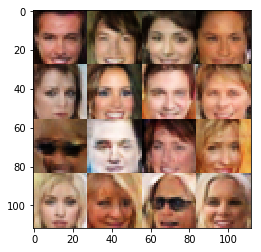

Epochs 43910/60000 Batch Step 2765/3166 gen_loss = -1.5134588479995728..., disc_loss = -0.4358375668525696..., train using time = 11.723
Epochs 43920/60000 Batch Step 2775/3166 gen_loss = 1.2145912647247314..., disc_loss = -0.43860453367233276..., train using time = 11.789
Epochs 43930/60000 Batch Step 2785/3166 gen_loss = -0.810530424118042..., disc_loss = -0.41682276129722595..., train using time = 12.128
Epochs 43940/60000 Batch Step 2795/3166 gen_loss = 1.3734500408172607..., disc_loss = -0.41563326120376587..., train using time = 11.669
Epochs 43950/60000 Batch Step 2805/3166 gen_loss = 0.8785649538040161..., disc_loss = -0.5166101455688477..., train using time = 11.797
Epochs 43960/60000 Batch Step 2815/3166 gen_loss = 0.9013286232948303..., disc_loss = -0.4429646134376526..., train using time = 11.667
Epochs 43970/60000 Batch Step 2825/3166 gen_loss = 0.20267021656036377..., disc_loss = -0.39592522382736206..., train using time = 11.710
Epochs 43980/60000 Batch Step 2835/3166 ge

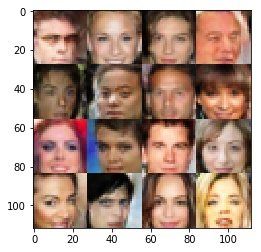

Epochs 44010/60000 Batch Step 2865/3166 gen_loss = -0.2569136917591095..., disc_loss = -0.39448460936546326..., train using time = 11.507
Epochs 44020/60000 Batch Step 2875/3166 gen_loss = 1.3744423389434814..., disc_loss = -0.3302568793296814..., train using time = 11.752
Epochs 44030/60000 Batch Step 2885/3166 gen_loss = -0.40406090021133423..., disc_loss = -0.39725589752197266..., train using time = 11.616
Epochs 44040/60000 Batch Step 2895/3166 gen_loss = -0.7214697599411011..., disc_loss = -0.47466516494750977..., train using time = 11.633
Epochs 44050/60000 Batch Step 2905/3166 gen_loss = -1.5829203128814697..., disc_loss = 0.037132393568754196..., train using time = 11.606
Epochs 44060/60000 Batch Step 2915/3166 gen_loss = -1.0945422649383545..., disc_loss = -0.3328310251235962..., train using time = 13.032
Epochs 44070/60000 Batch Step 2925/3166 gen_loss = 0.9468313455581665..., disc_loss = -0.4314751625061035..., train using time = 11.623
Epochs 44080/60000 Batch Step 2935/316

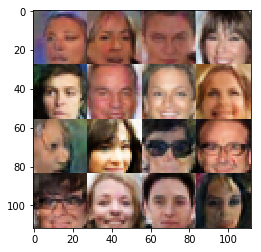

Epochs 44110/60000 Batch Step 2965/3166 gen_loss = -0.39660584926605225..., disc_loss = -0.488223135471344..., train using time = 11.596
Epochs 44120/60000 Batch Step 2975/3166 gen_loss = 1.1116430759429932..., disc_loss = -0.5070413947105408..., train using time = 11.635
Epochs 44130/60000 Batch Step 2985/3166 gen_loss = -0.2076205164194107..., disc_loss = -0.3699166476726532..., train using time = 11.668
Epochs 44140/60000 Batch Step 2995/3166 gen_loss = -1.1090726852416992..., disc_loss = -0.41254550218582153..., train using time = 11.495
Epochs 44150/60000 Batch Step 3005/3166 gen_loss = -0.25217390060424805..., disc_loss = -0.36120447516441345..., train using time = 12.105
Epochs 44160/60000 Batch Step 3015/3166 gen_loss = 0.6380118131637573..., disc_loss = -0.418877512216568..., train using time = 11.635
Epochs 44170/60000 Batch Step 3025/3166 gen_loss = 0.4218023121356964..., disc_loss = -0.4713432788848877..., train using time = 11.659
Epochs 44180/60000 Batch Step 3035/3166 ge

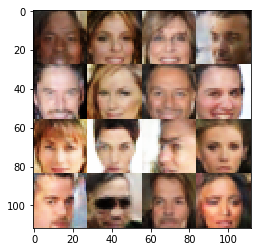

Epochs 44210/60000 Batch Step 3065/3166 gen_loss = -0.6455135345458984..., disc_loss = -0.5160557627677917..., train using time = 11.654
Epochs 44220/60000 Batch Step 3075/3166 gen_loss = 0.9069701433181763..., disc_loss = -0.2912071645259857..., train using time = 11.716
Epochs 44230/60000 Batch Step 3085/3166 gen_loss = -0.7364006638526917..., disc_loss = -0.36235103011131287..., train using time = 11.629
Epochs 44240/60000 Batch Step 3095/3166 gen_loss = -0.04745441675186157..., disc_loss = -0.3973289132118225..., train using time = 12.373
Epochs 44250/60000 Batch Step 3105/3166 gen_loss = 1.373581886291504..., disc_loss = -0.40519556403160095..., train using time = 11.743
Epochs 44260/60000 Batch Step 3115/3166 gen_loss = -2.1810669898986816..., disc_loss = -0.3710434138774872..., train using time = 11.582
Epochs 44270/60000 Batch Step 3125/3166 gen_loss = 0.40132713317871094..., disc_loss = -0.4331527650356293..., train using time = 11.568
Epochs 44280/60000 Batch Step 3135/3166 g

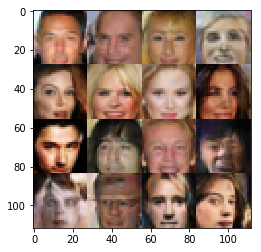

Epochs 44310/60000 Batch Step 3165/3166 gen_loss = -0.5053186416625977..., disc_loss = -0.701801061630249..., train using time = 11.600
Epochs 44320/60000 Batch Step 10/3166 gen_loss = -1.8825310468673706..., disc_loss = -0.3781611919403076..., train using time = 11.577
Epochs 44330/60000 Batch Step 20/3166 gen_loss = 0.06937699019908905..., disc_loss = -0.3691886365413666..., train using time = 11.697
Epochs 44340/60000 Batch Step 30/3166 gen_loss = 0.4498826861381531..., disc_loss = -0.4400846064090729..., train using time = 11.749
Epochs 44350/60000 Batch Step 40/3166 gen_loss = 1.4507105350494385..., disc_loss = -0.49310722947120667..., train using time = 11.860
Epochs 44360/60000 Batch Step 50/3166 gen_loss = 1.6102042198181152..., disc_loss = -0.4156414568424225..., train using time = 11.559
Epochs 44370/60000 Batch Step 60/3166 gen_loss = 0.7148176431655884..., disc_loss = -0.35672932863235474..., train using time = 11.545
Epochs 44380/60000 Batch Step 70/3166 gen_loss = 0.09204

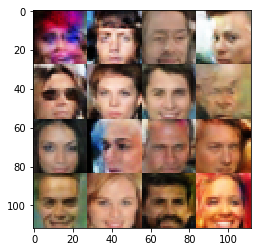

Epochs 44410/60000 Batch Step 100/3166 gen_loss = 1.2415481805801392..., disc_loss = -0.4372948706150055..., train using time = 11.583
Epochs 44420/60000 Batch Step 110/3166 gen_loss = 0.6356910467147827..., disc_loss = -0.39577093720436096..., train using time = 11.774
Epochs 44430/60000 Batch Step 120/3166 gen_loss = 0.6109870076179504..., disc_loss = -0.5305482149124146..., train using time = 11.665
Epochs 44440/60000 Batch Step 130/3166 gen_loss = -0.09643501788377762..., disc_loss = -0.5072153806686401..., train using time = 11.545
Epochs 44450/60000 Batch Step 140/3166 gen_loss = 1.945021390914917..., disc_loss = -0.3953344225883484..., train using time = 11.672
Epochs 44460/60000 Batch Step 150/3166 gen_loss = 0.6684714555740356..., disc_loss = -0.4940059781074524..., train using time = 11.490
Epochs 44470/60000 Batch Step 160/3166 gen_loss = 1.2362208366394043..., disc_loss = -0.5372844934463501..., train using time = 11.695
Epochs 44480/60000 Batch Step 170/3166 gen_loss = 2.4

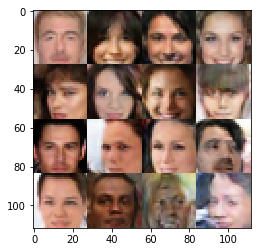

Epochs 44510/60000 Batch Step 200/3166 gen_loss = -1.231741189956665..., disc_loss = -0.357533723115921..., train using time = 11.694
Epochs 44520/60000 Batch Step 210/3166 gen_loss = -1.2864174842834473..., disc_loss = -0.2777795195579529..., train using time = 13.121
Epochs 44530/60000 Batch Step 220/3166 gen_loss = 0.4538300037384033..., disc_loss = -0.4862619936466217..., train using time = 11.547
Epochs 44540/60000 Batch Step 230/3166 gen_loss = 2.0599334239959717..., disc_loss = -0.3066532015800476..., train using time = 11.709
Epochs 44550/60000 Batch Step 240/3166 gen_loss = -1.0749235153198242..., disc_loss = -0.3970509171485901..., train using time = 11.585
Epochs 44560/60000 Batch Step 250/3166 gen_loss = 3.290433883666992..., disc_loss = -0.3427925705909729..., train using time = 11.566
Epochs 44570/60000 Batch Step 260/3166 gen_loss = -2.231401205062866..., disc_loss = -0.368965208530426..., train using time = 11.582
Epochs 44580/60000 Batch Step 270/3166 gen_loss = 1.3784

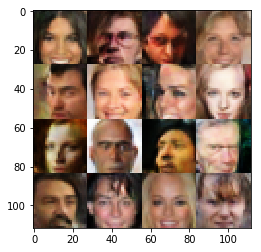

Epochs 44610/60000 Batch Step 300/3166 gen_loss = 1.4125292301177979..., disc_loss = -0.24342887103557587..., train using time = 11.671
Epochs 44620/60000 Batch Step 310/3166 gen_loss = 0.03450987488031387..., disc_loss = -0.5256764888763428..., train using time = 11.877
Epochs 44630/60000 Batch Step 320/3166 gen_loss = -0.11759332567453384..., disc_loss = -0.4515339732170105..., train using time = 11.586
Epochs 44640/60000 Batch Step 330/3166 gen_loss = 0.1719687283039093..., disc_loss = -0.42469722032546997..., train using time = 11.863
Epochs 44650/60000 Batch Step 340/3166 gen_loss = 0.7018970847129822..., disc_loss = -0.3133670687675476..., train using time = 11.665
Epochs 44660/60000 Batch Step 350/3166 gen_loss = -0.4582709074020386..., disc_loss = -0.42900633811950684..., train using time = 11.635
Epochs 44670/60000 Batch Step 360/3166 gen_loss = 1.2073698043823242..., disc_loss = -0.351590633392334..., train using time = 11.585
Epochs 44680/60000 Batch Step 370/3166 gen_loss =

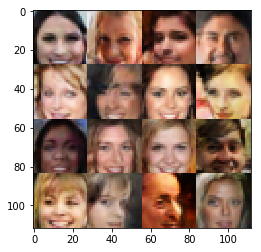

Epochs 44710/60000 Batch Step 400/3166 gen_loss = -0.8570027351379395..., disc_loss = -0.4449930787086487..., train using time = 11.571
Epochs 44720/60000 Batch Step 410/3166 gen_loss = -0.6797126531600952..., disc_loss = -0.5683484077453613..., train using time = 11.775
Epochs 44730/60000 Batch Step 420/3166 gen_loss = 0.7707353234291077..., disc_loss = -0.4832057058811188..., train using time = 11.572
Epochs 44740/60000 Batch Step 430/3166 gen_loss = 1.404355525970459..., disc_loss = -0.42548736929893494..., train using time = 11.570
Epochs 44750/60000 Batch Step 440/3166 gen_loss = -0.11975029110908508..., disc_loss = -0.47615328431129456..., train using time = 12.415
Epochs 44760/60000 Batch Step 450/3166 gen_loss = 1.03047513961792..., disc_loss = -0.2359929084777832..., train using time = 11.554
Epochs 44770/60000 Batch Step 460/3166 gen_loss = -0.7486745119094849..., disc_loss = -0.41525140404701233..., train using time = 11.528
Epochs 44780/60000 Batch Step 470/3166 gen_loss = 

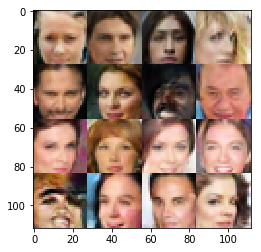

Epochs 44810/60000 Batch Step 500/3166 gen_loss = -0.42269256711006165..., disc_loss = -0.3381024897098541..., train using time = 11.795
Epochs 44820/60000 Batch Step 510/3166 gen_loss = 0.710137128829956..., disc_loss = -0.525213360786438..., train using time = 12.109
Epochs 44830/60000 Batch Step 520/3166 gen_loss = -0.9258387684822083..., disc_loss = -0.32332056760787964..., train using time = 11.639
Epochs 44840/60000 Batch Step 530/3166 gen_loss = -0.5573410987854004..., disc_loss = -0.41824617981910706..., train using time = 11.675
Epochs 44850/60000 Batch Step 540/3166 gen_loss = 0.4236217737197876..., disc_loss = -0.26044607162475586..., train using time = 11.614
Epochs 44860/60000 Batch Step 550/3166 gen_loss = 0.49688583612442017..., disc_loss = -0.3493063449859619..., train using time = 11.752
Epochs 44870/60000 Batch Step 560/3166 gen_loss = 1.512356162071228..., disc_loss = -0.32788747549057007..., train using time = 11.595
Epochs 44880/60000 Batch Step 570/3166 gen_loss =

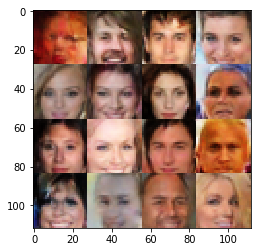

Epochs 44910/60000 Batch Step 600/3166 gen_loss = 0.252544641494751..., disc_loss = -0.37249645590782166..., train using time = 11.556
Epochs 44920/60000 Batch Step 610/3166 gen_loss = -1.4972083568572998..., disc_loss = -0.4860113263130188..., train using time = 11.614
Epochs 44930/60000 Batch Step 620/3166 gen_loss = 0.6183043718338013..., disc_loss = -0.48384684324264526..., train using time = 11.566
Epochs 44940/60000 Batch Step 630/3166 gen_loss = 0.9863629341125488..., disc_loss = -0.5318764448165894..., train using time = 11.564
Epochs 44950/60000 Batch Step 640/3166 gen_loss = -0.17344501614570618..., disc_loss = -0.4519596993923187..., train using time = 11.808
Epochs 44960/60000 Batch Step 650/3166 gen_loss = 1.3368228673934937..., disc_loss = -0.46576204895973206..., train using time = 11.610
Epochs 44970/60000 Batch Step 660/3166 gen_loss = 1.1571972370147705..., disc_loss = -0.42905861139297485..., train using time = 11.600
Epochs 44980/60000 Batch Step 670/3166 gen_loss =

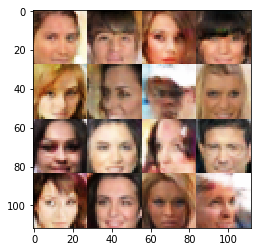

Epochs 45010/60000 Batch Step 700/3166 gen_loss = 0.4413347840309143..., disc_loss = -0.4379695951938629..., train using time = 11.563
Epochs 45020/60000 Batch Step 710/3166 gen_loss = 0.6288222074508667..., disc_loss = -0.46284371614456177..., train using time = 11.622
Epochs 45030/60000 Batch Step 720/3166 gen_loss = 0.541635274887085..., disc_loss = -0.49436241388320923..., train using time = 11.513
Epochs 45040/60000 Batch Step 730/3166 gen_loss = 1.163588285446167..., disc_loss = -0.5225874781608582..., train using time = 11.498
Epochs 45050/60000 Batch Step 740/3166 gen_loss = -0.6541849374771118..., disc_loss = -0.360260009765625..., train using time = 11.494
Epochs 45060/60000 Batch Step 750/3166 gen_loss = 0.5408475399017334..., disc_loss = -0.4664347767829895..., train using time = 11.739
Epochs 45070/60000 Batch Step 760/3166 gen_loss = 1.6146724224090576..., disc_loss = -0.2575168013572693..., train using time = 11.839
Epochs 45080/60000 Batch Step 770/3166 gen_loss = -1.23

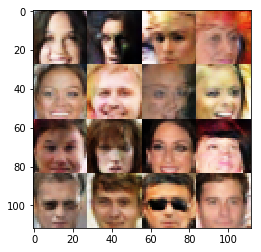

Epochs 45110/60000 Batch Step 800/3166 gen_loss = -0.5045416355133057..., disc_loss = -0.22854062914848328..., train using time = 11.707
Epochs 45120/60000 Batch Step 810/3166 gen_loss = 2.043487071990967..., disc_loss = -0.4694114327430725..., train using time = 11.788
Epochs 45130/60000 Batch Step 820/3166 gen_loss = 2.018876314163208..., disc_loss = -0.41306981444358826..., train using time = 12.086
Epochs 45140/60000 Batch Step 830/3166 gen_loss = -0.7331556081771851..., disc_loss = -0.42304301261901855..., train using time = 11.612
Epochs 45150/60000 Batch Step 840/3166 gen_loss = 1.753333568572998..., disc_loss = -0.4131413996219635..., train using time = 11.557
Epochs 45160/60000 Batch Step 850/3166 gen_loss = -0.4119642376899719..., disc_loss = -0.5238616466522217..., train using time = 11.688
Epochs 45170/60000 Batch Step 860/3166 gen_loss = 2.537224292755127..., disc_loss = -0.26348671317100525..., train using time = 11.566
Epochs 45180/60000 Batch Step 870/3166 gen_loss = 1.

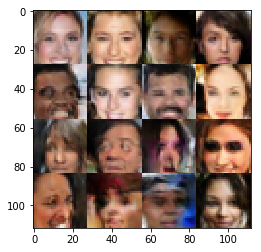

Epochs 45210/60000 Batch Step 900/3166 gen_loss = 0.5326685905456543..., disc_loss = -0.3246540427207947..., train using time = 12.276
Epochs 45220/60000 Batch Step 910/3166 gen_loss = -0.34862324595451355..., disc_loss = 0.32972121238708496..., train using time = 11.600
Epochs 45230/60000 Batch Step 920/3166 gen_loss = -1.1490638256072998..., disc_loss = -0.27597472071647644..., train using time = 11.660
Epochs 45240/60000 Batch Step 930/3166 gen_loss = 0.3827627897262573..., disc_loss = -0.43026360869407654..., train using time = 11.602
Epochs 45250/60000 Batch Step 940/3166 gen_loss = -0.2919536232948303..., disc_loss = -0.3343311548233032..., train using time = 11.565
Epochs 45260/60000 Batch Step 950/3166 gen_loss = -1.816469669342041..., disc_loss = -0.35099294781684875..., train using time = 11.621
Epochs 45270/60000 Batch Step 960/3166 gen_loss = 0.4972193241119385..., disc_loss = -0.31625014543533325..., train using time = 11.641
Epochs 45280/60000 Batch Step 970/3166 gen_loss

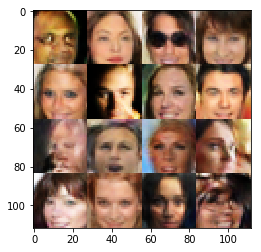

Epochs 45310/60000 Batch Step 1000/3166 gen_loss = 0.8780907392501831..., disc_loss = -0.36372530460357666..., train using time = 12.755
Epochs 45320/60000 Batch Step 1010/3166 gen_loss = -1.9336252212524414..., disc_loss = -0.4540749490261078..., train using time = 11.795
Epochs 45330/60000 Batch Step 1020/3166 gen_loss = 0.31769195199012756..., disc_loss = -0.4825289249420166..., train using time = 11.862
Epochs 45340/60000 Batch Step 1030/3166 gen_loss = -0.1483340859413147..., disc_loss = -0.4833199083805084..., train using time = 11.705
Epochs 45350/60000 Batch Step 1040/3166 gen_loss = -0.0699959471821785..., disc_loss = -0.45299720764160156..., train using time = 11.740
Epochs 45360/60000 Batch Step 1050/3166 gen_loss = 0.04786338284611702..., disc_loss = -0.4709075093269348..., train using time = 11.791
Epochs 45370/60000 Batch Step 1060/3166 gen_loss = 0.47651851177215576..., disc_loss = -0.3633430004119873..., train using time = 11.658
Epochs 45380/60000 Batch Step 1070/3166 

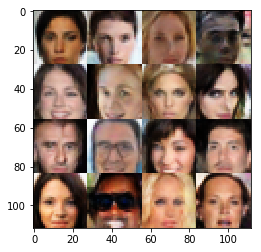

Epochs 45410/60000 Batch Step 1100/3166 gen_loss = -0.33870556950569153..., disc_loss = -0.39573249220848083..., train using time = 11.640
Epochs 45420/60000 Batch Step 1110/3166 gen_loss = 0.20171648263931274..., disc_loss = -0.3860093951225281..., train using time = 11.553
Epochs 45430/60000 Batch Step 1120/3166 gen_loss = 1.8500425815582275..., disc_loss = -0.444644033908844..., train using time = 11.601
Epochs 45440/60000 Batch Step 1130/3166 gen_loss = -0.17795023322105408..., disc_loss = -0.24060483276844025..., train using time = 11.546
Epochs 45450/60000 Batch Step 1140/3166 gen_loss = -1.396237850189209..., disc_loss = -0.2562960982322693..., train using time = 11.612
Epochs 45460/60000 Batch Step 1150/3166 gen_loss = -0.21921567618846893..., disc_loss = -0.36200064420700073..., train using time = 11.635
Epochs 45470/60000 Batch Step 1160/3166 gen_loss = 0.4368096590042114..., disc_loss = -0.3610551953315735..., train using time = 11.522
Epochs 45480/60000 Batch Step 1170/3166

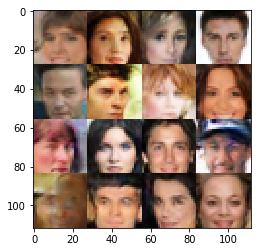

Epochs 45510/60000 Batch Step 1200/3166 gen_loss = 2.183838367462158..., disc_loss = -0.36072421073913574..., train using time = 11.649
Epochs 45520/60000 Batch Step 1210/3166 gen_loss = 1.953108549118042..., disc_loss = -0.3345964848995209..., train using time = 12.292
Epochs 45530/60000 Batch Step 1220/3166 gen_loss = -0.12386156618595123..., disc_loss = -0.5314580798149109..., train using time = 11.625
Epochs 45540/60000 Batch Step 1230/3166 gen_loss = 0.9839693307876587..., disc_loss = -0.3892357349395752..., train using time = 11.599
Epochs 45550/60000 Batch Step 1240/3166 gen_loss = 1.2626339197158813..., disc_loss = -0.4205130934715271..., train using time = 11.513
Epochs 45560/60000 Batch Step 1250/3166 gen_loss = 2.107194185256958..., disc_loss = -0.550076425075531..., train using time = 11.647
Epochs 45570/60000 Batch Step 1260/3166 gen_loss = -1.290966272354126..., disc_loss = -0.34842631220817566..., train using time = 11.564
Epochs 45580/60000 Batch Step 1270/3166 gen_loss

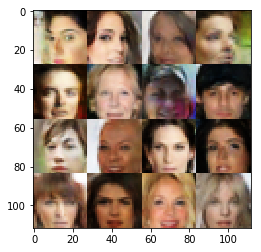

Epochs 45610/60000 Batch Step 1300/3166 gen_loss = -2.1074647903442383..., disc_loss = -0.26026612520217896..., train using time = 11.594
Epochs 45620/60000 Batch Step 1310/3166 gen_loss = 2.2737908363342285..., disc_loss = -0.37852534651756287..., train using time = 12.034
Epochs 45630/60000 Batch Step 1320/3166 gen_loss = -0.44581976532936096..., disc_loss = -0.42662930488586426..., train using time = 11.684
Epochs 45640/60000 Batch Step 1330/3166 gen_loss = -0.7185771465301514..., disc_loss = -0.3159635066986084..., train using time = 11.572
Epochs 45650/60000 Batch Step 1340/3166 gen_loss = 1.0674610137939453..., disc_loss = -0.2944510281085968..., train using time = 11.607
Epochs 45660/60000 Batch Step 1350/3166 gen_loss = 0.048040375113487244..., disc_loss = -0.3112984299659729..., train using time = 11.627
Epochs 45670/60000 Batch Step 1360/3166 gen_loss = 0.02486974187195301..., disc_loss = -0.4377613067626953..., train using time = 11.646
Epochs 45680/60000 Batch Step 1370/316

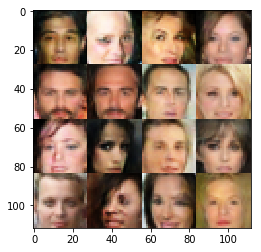

Epochs 45710/60000 Batch Step 1400/3166 gen_loss = 0.07882862538099289..., disc_loss = -0.3603043556213379..., train using time = 11.677
Epochs 45720/60000 Batch Step 1410/3166 gen_loss = -0.7383182644844055..., disc_loss = -0.4008989930152893..., train using time = 11.553
Epochs 45730/60000 Batch Step 1420/3166 gen_loss = 0.20597703754901886..., disc_loss = -0.5199092626571655..., train using time = 11.556
Epochs 45740/60000 Batch Step 1430/3166 gen_loss = -2.5396971702575684..., disc_loss = -0.24290041625499725..., train using time = 11.653
Epochs 45750/60000 Batch Step 1440/3166 gen_loss = 0.6820608377456665..., disc_loss = -0.3337364196777344..., train using time = 11.718
Epochs 45760/60000 Batch Step 1450/3166 gen_loss = -0.41165170073509216..., disc_loss = -0.46102604269981384..., train using time = 11.691
Epochs 45770/60000 Batch Step 1460/3166 gen_loss = 1.3638229370117188..., disc_loss = -0.5008912086486816..., train using time = 11.407
Epochs 45780/60000 Batch Step 1470/3166 

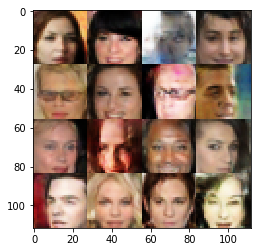

Epochs 45810/60000 Batch Step 1500/3166 gen_loss = 0.8860646486282349..., disc_loss = -0.36266523599624634..., train using time = 11.551
Epochs 45820/60000 Batch Step 1510/3166 gen_loss = 0.869331419467926..., disc_loss = -0.5447329878807068..., train using time = 11.515
Epochs 45830/60000 Batch Step 1520/3166 gen_loss = -1.7392255067825317..., disc_loss = -0.385466068983078..., train using time = 11.644
Epochs 45840/60000 Batch Step 1530/3166 gen_loss = -0.20690235495567322..., disc_loss = -0.4066562056541443..., train using time = 11.547
Epochs 45850/60000 Batch Step 1540/3166 gen_loss = 0.22443565726280212..., disc_loss = -0.44958406686782837..., train using time = 11.541
Epochs 45860/60000 Batch Step 1550/3166 gen_loss = 1.0644640922546387..., disc_loss = -0.39121243357658386..., train using time = 11.537
Epochs 45870/60000 Batch Step 1560/3166 gen_loss = -0.29587283730506897..., disc_loss = -0.44502735137939453..., train using time = 11.428
Epochs 45880/60000 Batch Step 1570/3166 

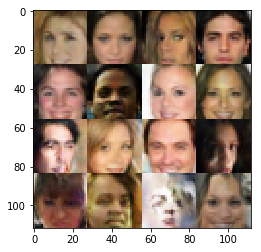

Epochs 45910/60000 Batch Step 1600/3166 gen_loss = -0.4553186893463135..., disc_loss = -0.40054360032081604..., train using time = 11.501
Epochs 45920/60000 Batch Step 1610/3166 gen_loss = 0.7832101583480835..., disc_loss = -0.3478277325630188..., train using time = 11.496
Epochs 45930/60000 Batch Step 1620/3166 gen_loss = -1.4024169445037842..., disc_loss = -0.5308911204338074..., train using time = 12.081
Epochs 45940/60000 Batch Step 1630/3166 gen_loss = 0.6056490540504456..., disc_loss = -0.4586685299873352..., train using time = 11.561
Epochs 45950/60000 Batch Step 1640/3166 gen_loss = 0.2510209083557129..., disc_loss = -0.35372939705848694..., train using time = 11.612
Epochs 45960/60000 Batch Step 1650/3166 gen_loss = 1.1411046981811523..., disc_loss = -0.43609514832496643..., train using time = 11.594
Epochs 45970/60000 Batch Step 1660/3166 gen_loss = 1.2328702211380005..., disc_loss = -0.2886132597923279..., train using time = 11.572
Epochs 45980/60000 Batch Step 1670/3166 gen

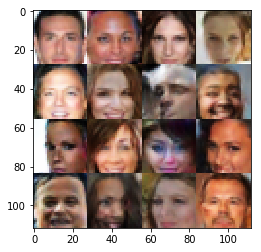

Epochs 46010/60000 Batch Step 1700/3166 gen_loss = -1.6127864122390747..., disc_loss = -0.3235931396484375..., train using time = 11.416
Epochs 46020/60000 Batch Step 1710/3166 gen_loss = 0.1467324197292328..., disc_loss = -0.3477410674095154..., train using time = 11.557
Epochs 46030/60000 Batch Step 1720/3166 gen_loss = -0.5327189564704895..., disc_loss = -0.3720865845680237..., train using time = 11.492
Epochs 46040/60000 Batch Step 1730/3166 gen_loss = -0.9160655736923218..., disc_loss = -0.672178328037262..., train using time = 11.476
Epochs 46050/60000 Batch Step 1740/3166 gen_loss = 0.48131459951400757..., disc_loss = -0.2934805750846863..., train using time = 11.558
Epochs 46060/60000 Batch Step 1750/3166 gen_loss = -1.567051887512207..., disc_loss = -0.391143262386322..., train using time = 11.684
Epochs 46070/60000 Batch Step 1760/3166 gen_loss = 0.9748771786689758..., disc_loss = -0.49389395117759705..., train using time = 11.686
Epochs 46080/60000 Batch Step 1770/3166 gen_l

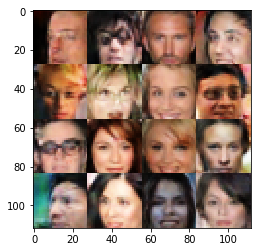

Epochs 46110/60000 Batch Step 1800/3166 gen_loss = -1.916942834854126..., disc_loss = -0.29634878039360046..., train using time = 11.551
Epochs 46120/60000 Batch Step 1810/3166 gen_loss = -1.0921295881271362..., disc_loss = -0.3690277636051178..., train using time = 11.449
Epochs 46130/60000 Batch Step 1820/3166 gen_loss = 1.6235541105270386..., disc_loss = -0.3811529278755188..., train using time = 11.603
Epochs 46140/60000 Batch Step 1830/3166 gen_loss = -0.8798204064369202..., disc_loss = -0.28531625866889954..., train using time = 11.577
Epochs 46150/60000 Batch Step 1840/3166 gen_loss = 0.7783232927322388..., disc_loss = -0.6318323016166687..., train using time = 11.672
Epochs 46160/60000 Batch Step 1850/3166 gen_loss = 0.9394839406013489..., disc_loss = -0.3851735293865204..., train using time = 11.607
Epochs 46170/60000 Batch Step 1860/3166 gen_loss = -1.7226636409759521..., disc_loss = -0.21670694649219513..., train using time = 11.540
Epochs 46180/60000 Batch Step 1870/3166 ge

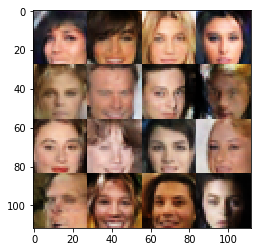

Epochs 46210/60000 Batch Step 1900/3166 gen_loss = -0.8001515865325928..., disc_loss = -0.4686354696750641..., train using time = 12.186
Epochs 46220/60000 Batch Step 1910/3166 gen_loss = 0.327316552400589..., disc_loss = -0.3560856580734253..., train using time = 11.624
Epochs 46230/60000 Batch Step 1920/3166 gen_loss = 1.35843825340271..., disc_loss = -0.39515361189842224..., train using time = 11.607
Epochs 46240/60000 Batch Step 1930/3166 gen_loss = -0.07584656029939651..., disc_loss = -0.4930647015571594..., train using time = 12.200
Epochs 46250/60000 Batch Step 1940/3166 gen_loss = 1.0916986465454102..., disc_loss = -0.2163335382938385..., train using time = 11.624
Epochs 46260/60000 Batch Step 1950/3166 gen_loss = -0.8705177307128906..., disc_loss = -0.36260268092155457..., train using time = 11.573
Epochs 46270/60000 Batch Step 1960/3166 gen_loss = -2.4159960746765137..., disc_loss = -0.19430413842201233..., train using time = 11.531
Epochs 46280/60000 Batch Step 1970/3166 gen

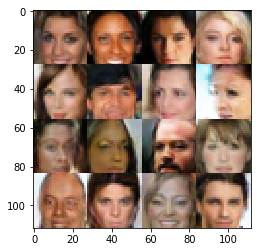

Epochs 46310/60000 Batch Step 2000/3166 gen_loss = 1.5717847347259521..., disc_loss = -0.33851543068885803..., train using time = 11.616
Epochs 46320/60000 Batch Step 2010/3166 gen_loss = 0.2548283040523529..., disc_loss = -0.4706032872200012..., train using time = 11.604
Epochs 46330/60000 Batch Step 2020/3166 gen_loss = 0.3270948529243469..., disc_loss = -0.6343428492546082..., train using time = 11.537
Epochs 46340/60000 Batch Step 2030/3166 gen_loss = -0.81752610206604..., disc_loss = -0.41266536712646484..., train using time = 11.561
Epochs 46350/60000 Batch Step 2040/3166 gen_loss = -0.42572110891342163..., disc_loss = -0.5358672738075256..., train using time = 11.566
Epochs 46360/60000 Batch Step 2050/3166 gen_loss = -0.952664852142334..., disc_loss = -0.3889615535736084..., train using time = 11.575
Epochs 46370/60000 Batch Step 2060/3166 gen_loss = 1.0792062282562256..., disc_loss = -0.6103655099868774..., train using time = 11.550
Epochs 46380/60000 Batch Step 2070/3166 gen_l

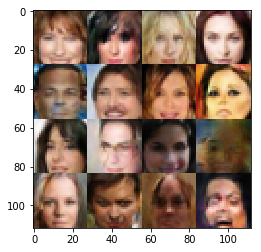

Epochs 46410/60000 Batch Step 2100/3166 gen_loss = -1.4626994132995605..., disc_loss = -0.348804235458374..., train using time = 11.579
Epochs 46420/60000 Batch Step 2110/3166 gen_loss = 1.7501790523529053..., disc_loss = -0.542713463306427..., train using time = 11.575
Epochs 46430/60000 Batch Step 2120/3166 gen_loss = 0.49054354429244995..., disc_loss = -0.40437808632850647..., train using time = 11.630
Epochs 46440/60000 Batch Step 2130/3166 gen_loss = -0.2082153707742691..., disc_loss = -0.41821956634521484..., train using time = 11.522
Epochs 46450/60000 Batch Step 2140/3166 gen_loss = -0.030476856976747513..., disc_loss = -0.32284122705459595..., train using time = 11.634
Epochs 46460/60000 Batch Step 2150/3166 gen_loss = 0.231629878282547..., disc_loss = -0.38158828020095825..., train using time = 11.544
Epochs 46470/60000 Batch Step 2160/3166 gen_loss = -0.6069293022155762..., disc_loss = -0.39539387822151184..., train using time = 11.566
Epochs 46480/60000 Batch Step 2170/3166

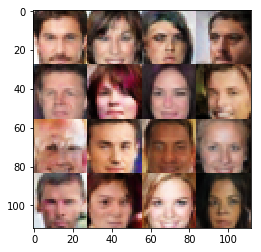

Epochs 46510/60000 Batch Step 2200/3166 gen_loss = 2.064126968383789..., disc_loss = -0.2956236004829407..., train using time = 11.611
Epochs 46520/60000 Batch Step 2210/3166 gen_loss = 0.3112321197986603..., disc_loss = -0.3314839005470276..., train using time = 11.663
Epochs 46530/60000 Batch Step 2220/3166 gen_loss = 0.4350045323371887..., disc_loss = -0.4008370339870453..., train using time = 11.613
Epochs 46540/60000 Batch Step 2230/3166 gen_loss = -0.7668453454971313..., disc_loss = -0.5146134495735168..., train using time = 11.620
Epochs 46550/60000 Batch Step 2240/3166 gen_loss = 0.7264842987060547..., disc_loss = -0.3867762088775635..., train using time = 12.222
Epochs 46560/60000 Batch Step 2250/3166 gen_loss = -0.9543777108192444..., disc_loss = -0.672248125076294..., train using time = 11.756
Epochs 46570/60000 Batch Step 2260/3166 gen_loss = 0.044877517968416214..., disc_loss = -0.4541946351528168..., train using time = 12.044
Epochs 46580/60000 Batch Step 2270/3166 gen_lo

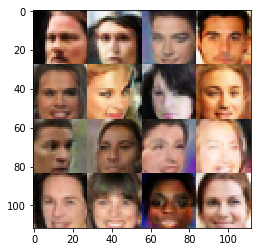

Epochs 46610/60000 Batch Step 2300/3166 gen_loss = 0.4546012282371521..., disc_loss = -0.3871084153652191..., train using time = 11.714
Epochs 46620/60000 Batch Step 2310/3166 gen_loss = 1.6875557899475098..., disc_loss = -0.4711809754371643..., train using time = 11.562
Epochs 46630/60000 Batch Step 2320/3166 gen_loss = 1.2874445915222168..., disc_loss = -0.4247973561286926..., train using time = 11.569
Epochs 46640/60000 Batch Step 2330/3166 gen_loss = 0.10604110360145569..., disc_loss = -0.39668455719947815..., train using time = 11.553
Epochs 46650/60000 Batch Step 2340/3166 gen_loss = -0.22999456524848938..., disc_loss = -0.4180794358253479..., train using time = 11.631
Epochs 46660/60000 Batch Step 2350/3166 gen_loss = -0.3030436038970947..., disc_loss = -0.409320592880249..., train using time = 11.710
Epochs 46670/60000 Batch Step 2360/3166 gen_loss = 0.6058686375617981..., disc_loss = -0.44927436113357544..., train using time = 11.571
Epochs 46680/60000 Batch Step 2370/3166 gen

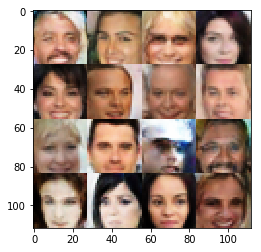

Epochs 46710/60000 Batch Step 2400/3166 gen_loss = -0.539933443069458..., disc_loss = -0.41352516412734985..., train using time = 11.592
Epochs 46720/60000 Batch Step 2410/3166 gen_loss = 0.7209948301315308..., disc_loss = -0.3607582747936249..., train using time = 11.708
Epochs 46730/60000 Batch Step 2420/3166 gen_loss = 0.860710859298706..., disc_loss = -0.440523236989975..., train using time = 11.588
Epochs 46740/60000 Batch Step 2430/3166 gen_loss = 0.5805485844612122..., disc_loss = -0.4714457094669342..., train using time = 11.667
Epochs 46750/60000 Batch Step 2440/3166 gen_loss = -0.6248161792755127..., disc_loss = -0.4193870425224304..., train using time = 11.969
Epochs 46760/60000 Batch Step 2450/3166 gen_loss = -0.022900503128767014..., disc_loss = -0.3846096396446228..., train using time = 11.605
Epochs 46770/60000 Batch Step 2460/3166 gen_loss = -0.6584210991859436..., disc_loss = -0.5294405221939087..., train using time = 11.562
Epochs 46780/60000 Batch Step 2470/3166 gen_

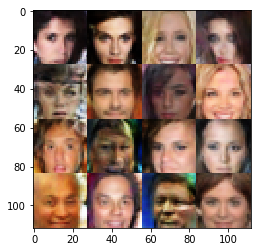

Epochs 46810/60000 Batch Step 2500/3166 gen_loss = -1.288675308227539..., disc_loss = -0.4176272451877594..., train using time = 11.612
Epochs 46820/60000 Batch Step 2510/3166 gen_loss = -1.7850533723831177..., disc_loss = -0.2584579586982727..., train using time = 11.678
Epochs 46830/60000 Batch Step 2520/3166 gen_loss = 0.1405813992023468..., disc_loss = -0.38374513387680054..., train using time = 11.637
Epochs 46840/60000 Batch Step 2530/3166 gen_loss = 0.9544165730476379..., disc_loss = -0.22653904557228088..., train using time = 11.601
Epochs 46850/60000 Batch Step 2540/3166 gen_loss = 0.11051610112190247..., disc_loss = -0.3286147117614746..., train using time = 11.616
Epochs 46860/60000 Batch Step 2550/3166 gen_loss = 1.5328842401504517..., disc_loss = -0.32926779985427856..., train using time = 11.713
Epochs 46870/60000 Batch Step 2560/3166 gen_loss = -0.3471473455429077..., disc_loss = -0.452301025390625..., train using time = 11.585
Epochs 46880/60000 Batch Step 2570/3166 gen

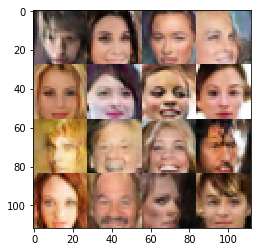

Epochs 46910/60000 Batch Step 2600/3166 gen_loss = -0.05948633328080177..., disc_loss = -0.3682399094104767..., train using time = 11.630
Epochs 46920/60000 Batch Step 2610/3166 gen_loss = 0.15107369422912598..., disc_loss = -0.41908207535743713..., train using time = 12.251
Epochs 46930/60000 Batch Step 2620/3166 gen_loss = -0.4621577858924866..., disc_loss = -0.430414617061615..., train using time = 11.635
Epochs 46940/60000 Batch Step 2630/3166 gen_loss = -0.014706119894981384..., disc_loss = -0.3874141275882721..., train using time = 11.765
Epochs 46950/60000 Batch Step 2640/3166 gen_loss = 0.6168340444564819..., disc_loss = -0.42760857939720154..., train using time = 11.602
Epochs 46960/60000 Batch Step 2650/3166 gen_loss = -0.3233944773674011..., disc_loss = -0.3841661810874939..., train using time = 11.631
Epochs 46970/60000 Batch Step 2660/3166 gen_loss = -0.9315398931503296..., disc_loss = -0.4885745644569397..., train using time = 11.689
Epochs 46980/60000 Batch Step 2670/316

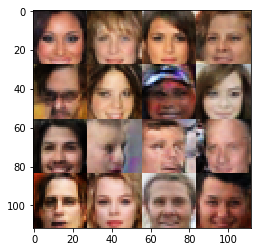

Epochs 47010/60000 Batch Step 2700/3166 gen_loss = 1.3878697156906128..., disc_loss = -0.3390325605869293..., train using time = 11.689
Epochs 47020/60000 Batch Step 2710/3166 gen_loss = 0.7327277064323425..., disc_loss = -0.4148542284965515..., train using time = 11.987
Epochs 47030/60000 Batch Step 2720/3166 gen_loss = 0.970787525177002..., disc_loss = -0.3646284341812134..., train using time = 12.062
Epochs 47040/60000 Batch Step 2730/3166 gen_loss = 0.9365105032920837..., disc_loss = -0.3632909655570984..., train using time = 11.695
Epochs 47050/60000 Batch Step 2740/3166 gen_loss = 1.3066068887710571..., disc_loss = -0.3537946343421936..., train using time = 11.759
Epochs 47060/60000 Batch Step 2750/3166 gen_loss = -0.8914932012557983..., disc_loss = -0.3241210877895355..., train using time = 11.771
Epochs 47070/60000 Batch Step 2760/3166 gen_loss = -0.07666035741567612..., disc_loss = -0.49514514207839966..., train using time = 11.654
Epochs 47080/60000 Batch Step 2770/3166 gen_l

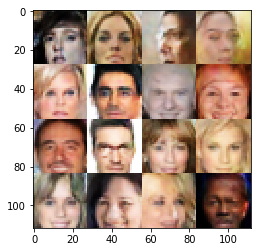

Epochs 47110/60000 Batch Step 2800/3166 gen_loss = 1.8063849210739136..., disc_loss = -0.47083109617233276..., train using time = 11.694
Epochs 47120/60000 Batch Step 2810/3166 gen_loss = 0.6678164005279541..., disc_loss = -0.38169097900390625..., train using time = 11.713
Epochs 47130/60000 Batch Step 2820/3166 gen_loss = 1.291070580482483..., disc_loss = -0.36644190549850464..., train using time = 11.473
Epochs 47140/60000 Batch Step 2830/3166 gen_loss = -0.35442566871643066..., disc_loss = -0.38615983724594116..., train using time = 11.561
Epochs 47150/60000 Batch Step 2840/3166 gen_loss = -0.2447528839111328..., disc_loss = -0.5051018595695496..., train using time = 11.597
Epochs 47160/60000 Batch Step 2850/3166 gen_loss = 0.4834834635257721..., disc_loss = -0.5588237047195435..., train using time = 11.609
Epochs 47170/60000 Batch Step 2860/3166 gen_loss = -0.8140843510627747..., disc_loss = -0.3997815251350403..., train using time = 11.579
Epochs 47180/60000 Batch Step 2870/3166 g

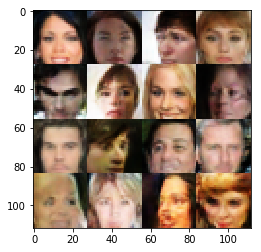

Epochs 47210/60000 Batch Step 2900/3166 gen_loss = -0.8726288080215454..., disc_loss = -0.3572416305541992..., train using time = 11.665
Epochs 47220/60000 Batch Step 2910/3166 gen_loss = 0.6875463724136353..., disc_loss = -0.37758561968803406..., train using time = 11.670
Epochs 47230/60000 Batch Step 2920/3166 gen_loss = -0.1409703493118286..., disc_loss = -0.4126816391944885..., train using time = 11.552
Epochs 47240/60000 Batch Step 2930/3166 gen_loss = 0.14766773581504822..., disc_loss = -0.4459110200405121..., train using time = 11.504
Epochs 47250/60000 Batch Step 2940/3166 gen_loss = -0.66973876953125..., disc_loss = -0.4039592146873474..., train using time = 11.767
Epochs 47260/60000 Batch Step 2950/3166 gen_loss = 1.0355132818222046..., disc_loss = -0.4558047652244568..., train using time = 11.586
Epochs 47270/60000 Batch Step 2960/3166 gen_loss = -0.5632666349411011..., disc_loss = -0.44650015234947205..., train using time = 11.715
Epochs 47280/60000 Batch Step 2970/3166 gen

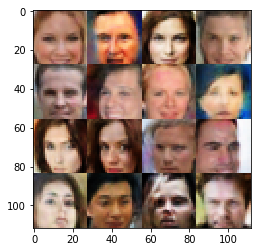

Epochs 47310/60000 Batch Step 3000/3166 gen_loss = 0.3511606454849243..., disc_loss = -0.4163600504398346..., train using time = 11.652
Epochs 47320/60000 Batch Step 3010/3166 gen_loss = -0.40049394965171814..., disc_loss = -0.42599910497665405..., train using time = 11.636
Epochs 47330/60000 Batch Step 3020/3166 gen_loss = -1.013962745666504..., disc_loss = -0.44279056787490845..., train using time = 11.695
Epochs 47340/60000 Batch Step 3030/3166 gen_loss = 0.41164201498031616..., disc_loss = -0.43189746141433716..., train using time = 11.616
Epochs 47350/60000 Batch Step 3040/3166 gen_loss = 0.49259305000305176..., disc_loss = -0.4230462908744812..., train using time = 11.560
Epochs 47360/60000 Batch Step 3050/3166 gen_loss = -0.6179627180099487..., disc_loss = -0.4464375376701355..., train using time = 11.531
Epochs 47370/60000 Batch Step 3060/3166 gen_loss = 1.9597415924072266..., disc_loss = -0.33396419882774353..., train using time = 11.492
Epochs 47380/60000 Batch Step 3070/3166

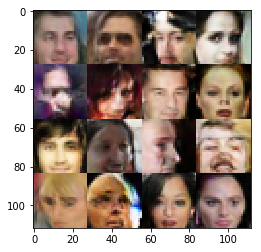

Epochs 47410/60000 Batch Step 3100/3166 gen_loss = 0.45756202936172485..., disc_loss = -0.395172655582428..., train using time = 11.613
Epochs 47420/60000 Batch Step 3110/3166 gen_loss = -0.5636985301971436..., disc_loss = -0.41255050897598267..., train using time = 11.548
Epochs 47430/60000 Batch Step 3120/3166 gen_loss = -1.6410086154937744..., disc_loss = -0.31448978185653687..., train using time = 11.523
Epochs 47440/60000 Batch Step 3130/3166 gen_loss = 0.4737558364868164..., disc_loss = -0.43272700905799866..., train using time = 11.559
Epochs 47450/60000 Batch Step 3140/3166 gen_loss = -1.510145664215088..., disc_loss = -0.4464896321296692..., train using time = 11.634
Epochs 47460/60000 Batch Step 3150/3166 gen_loss = -0.25634342432022095..., disc_loss = -0.4161188006401062..., train using time = 11.608
Epochs 47470/60000 Batch Step 3160/3166 gen_loss = -0.7048337459564209..., disc_loss = -0.45401740074157715..., train using time = 11.650
Epochs 47480/60000 Batch Step 5/3166 ge

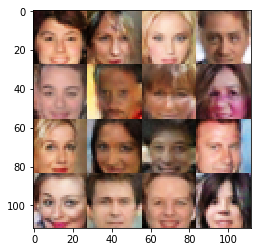

Epochs 47510/60000 Batch Step 35/3166 gen_loss = -0.13366679847240448..., disc_loss = -0.49506980180740356..., train using time = 11.685
Epochs 47520/60000 Batch Step 45/3166 gen_loss = -0.5649875998497009..., disc_loss = -0.3784627914428711..., train using time = 11.626
Epochs 47530/60000 Batch Step 55/3166 gen_loss = -0.3412937521934509..., disc_loss = -0.36501801013946533..., train using time = 11.575
Epochs 47540/60000 Batch Step 65/3166 gen_loss = 0.8119239807128906..., disc_loss = -0.3893904387950897..., train using time = 11.608
Epochs 47550/60000 Batch Step 75/3166 gen_loss = 0.3701859712600708..., disc_loss = -0.32615724205970764..., train using time = 11.688
Epochs 47560/60000 Batch Step 85/3166 gen_loss = 1.1208090782165527..., disc_loss = -0.3190350830554962..., train using time = 11.672
Epochs 47570/60000 Batch Step 95/3166 gen_loss = -0.20187824964523315..., disc_loss = -0.2987610697746277..., train using time = 11.605
Epochs 47580/60000 Batch Step 105/3166 gen_loss = 1.7

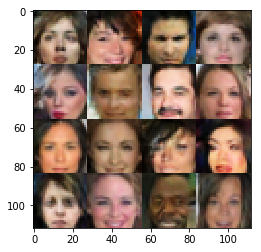

Epochs 47610/60000 Batch Step 135/3166 gen_loss = -3.212028980255127..., disc_loss = -0.3768431544303894..., train using time = 11.537
Epochs 47620/60000 Batch Step 145/3166 gen_loss = 0.399787962436676..., disc_loss = -0.36106520891189575..., train using time = 11.653
Epochs 47630/60000 Batch Step 155/3166 gen_loss = 1.6060526371002197..., disc_loss = -0.43827128410339355..., train using time = 11.688
Epochs 47640/60000 Batch Step 165/3166 gen_loss = 0.2001459151506424..., disc_loss = -0.5961083173751831..., train using time = 11.661
Epochs 47650/60000 Batch Step 175/3166 gen_loss = 0.5071617364883423..., disc_loss = -0.4960687756538391..., train using time = 11.677
Epochs 47660/60000 Batch Step 185/3166 gen_loss = -0.2494712769985199..., disc_loss = -0.36902540922164917..., train using time = 12.181
Epochs 47670/60000 Batch Step 195/3166 gen_loss = -0.5898542404174805..., disc_loss = -0.5301440954208374..., train using time = 11.588
Epochs 47680/60000 Batch Step 205/3166 gen_loss = -

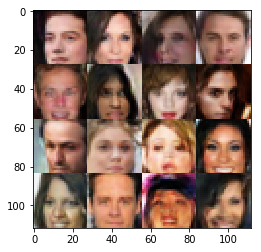

Epochs 47710/60000 Batch Step 235/3166 gen_loss = 0.434131920337677..., disc_loss = -0.43940454721450806..., train using time = 11.589
Epochs 47720/60000 Batch Step 245/3166 gen_loss = 0.5135244131088257..., disc_loss = -0.5388128161430359..., train using time = 11.731
Epochs 47730/60000 Batch Step 255/3166 gen_loss = 0.20581133663654327..., disc_loss = -0.42849841713905334..., train using time = 11.713
Epochs 47740/60000 Batch Step 265/3166 gen_loss = 0.36161890625953674..., disc_loss = -0.4746311604976654..., train using time = 11.618
Epochs 47750/60000 Batch Step 275/3166 gen_loss = 0.9891191124916077..., disc_loss = -0.5059924125671387..., train using time = 11.649
Epochs 47760/60000 Batch Step 285/3166 gen_loss = 0.31966158747673035..., disc_loss = -0.4977802336215973..., train using time = 11.555
Epochs 47770/60000 Batch Step 295/3166 gen_loss = 1.6274851560592651..., disc_loss = -0.5612816214561462..., train using time = 11.538
Epochs 47780/60000 Batch Step 305/3166 gen_loss = -

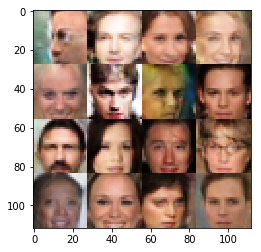

Epochs 47810/60000 Batch Step 335/3166 gen_loss = 2.0977983474731445..., disc_loss = -0.2961409389972687..., train using time = 11.568
Epochs 47820/60000 Batch Step 345/3166 gen_loss = -0.9371820688247681..., disc_loss = -0.46437516808509827..., train using time = 11.784
Epochs 47830/60000 Batch Step 355/3166 gen_loss = 0.13805584609508514..., disc_loss = -0.3783896267414093..., train using time = 12.296
Epochs 47840/60000 Batch Step 365/3166 gen_loss = 0.770639181137085..., disc_loss = -0.3970789611339569..., train using time = 12.229
Epochs 47850/60000 Batch Step 375/3166 gen_loss = 0.14538376033306122..., disc_loss = -0.18300464749336243..., train using time = 11.925
Epochs 47860/60000 Batch Step 385/3166 gen_loss = 0.06377192586660385..., disc_loss = -0.3803117573261261..., train using time = 11.730
Epochs 47870/60000 Batch Step 395/3166 gen_loss = 1.306058406829834..., disc_loss = -0.3154158592224121..., train using time = 11.599
Epochs 47880/60000 Batch Step 405/3166 gen_loss = -

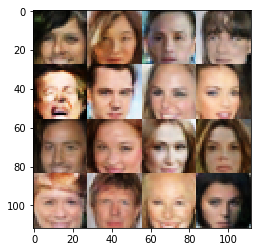

Epochs 47910/60000 Batch Step 435/3166 gen_loss = 1.7397899627685547..., disc_loss = -0.5000029802322388..., train using time = 11.586
Epochs 47920/60000 Batch Step 445/3166 gen_loss = 0.08097946643829346..., disc_loss = -0.4164821207523346..., train using time = 11.649
Epochs 47930/60000 Batch Step 455/3166 gen_loss = 0.3106580078601837..., disc_loss = -0.36785709857940674..., train using time = 11.687
Epochs 47940/60000 Batch Step 465/3166 gen_loss = -2.2849044799804688..., disc_loss = -0.33158981800079346..., train using time = 11.608
Epochs 47950/60000 Batch Step 475/3166 gen_loss = 1.180634617805481..., disc_loss = -0.39239221811294556..., train using time = 11.712
Epochs 47960/60000 Batch Step 485/3166 gen_loss = 0.2813307046890259..., disc_loss = -0.46928030252456665..., train using time = 11.660
Epochs 47970/60000 Batch Step 495/3166 gen_loss = 0.44920113682746887..., disc_loss = -0.4191977083683014..., train using time = 11.606
Epochs 47980/60000 Batch Step 505/3166 gen_loss =

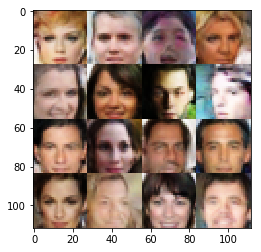

Epochs 48010/60000 Batch Step 535/3166 gen_loss = -0.6781169772148132..., disc_loss = -0.4682357907295227..., train using time = 11.587
Epochs 48020/60000 Batch Step 545/3166 gen_loss = -0.8474204540252686..., disc_loss = -0.45111364126205444..., train using time = 11.610
Epochs 48030/60000 Batch Step 555/3166 gen_loss = 0.21403399109840393..., disc_loss = -0.6159964799880981..., train using time = 11.680
Epochs 48040/60000 Batch Step 565/3166 gen_loss = -1.768060326576233..., disc_loss = -0.49020639061927795..., train using time = 11.572
Epochs 48050/60000 Batch Step 575/3166 gen_loss = -0.7680835723876953..., disc_loss = -0.2777937948703766..., train using time = 11.498
Epochs 48060/60000 Batch Step 585/3166 gen_loss = -0.055207476019859314..., disc_loss = -0.4592057764530182..., train using time = 11.538
Epochs 48070/60000 Batch Step 595/3166 gen_loss = -0.12203585356473923..., disc_loss = -0.3368552625179291..., train using time = 11.585
Epochs 48080/60000 Batch Step 605/3166 gen_l

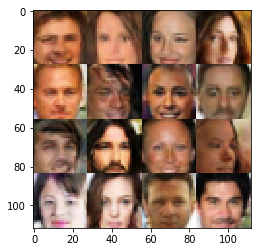

Epochs 48110/60000 Batch Step 635/3166 gen_loss = -2.085909366607666..., disc_loss = -0.5131524801254272..., train using time = 11.557
Epochs 48120/60000 Batch Step 645/3166 gen_loss = 0.5604337453842163..., disc_loss = -0.5079208612442017..., train using time = 11.757
Epochs 48130/60000 Batch Step 655/3166 gen_loss = -0.024858582764863968..., disc_loss = -0.4040750563144684..., train using time = 11.565
Epochs 48140/60000 Batch Step 665/3166 gen_loss = -0.7711572647094727..., disc_loss = -0.4377332627773285..., train using time = 11.682
Epochs 48150/60000 Batch Step 675/3166 gen_loss = 1.3839462995529175..., disc_loss = -0.566357433795929..., train using time = 11.598
Epochs 48160/60000 Batch Step 685/3166 gen_loss = -0.7866666316986084..., disc_loss = -0.26872682571411133..., train using time = 11.534
Epochs 48170/60000 Batch Step 695/3166 gen_loss = 0.7362378835678101..., disc_loss = -0.3733973503112793..., train using time = 11.606
Epochs 48180/60000 Batch Step 705/3166 gen_loss = 

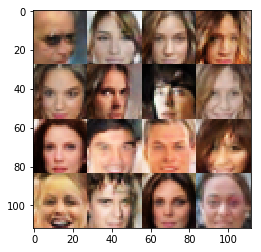

Epochs 48210/60000 Batch Step 735/3166 gen_loss = -1.1873149871826172..., disc_loss = -0.3831040859222412..., train using time = 11.511
Epochs 48220/60000 Batch Step 745/3166 gen_loss = 0.38673824071884155..., disc_loss = -0.4692419469356537..., train using time = 11.536
Epochs 48230/60000 Batch Step 755/3166 gen_loss = 0.11000276356935501..., disc_loss = -0.4425034523010254..., train using time = 11.650
Epochs 48240/60000 Batch Step 765/3166 gen_loss = 1.432742953300476..., disc_loss = -0.3427060544490814..., train using time = 11.504
Epochs 48250/60000 Batch Step 775/3166 gen_loss = -2.1735029220581055..., disc_loss = -0.20046159625053406..., train using time = 11.535
Epochs 48260/60000 Batch Step 785/3166 gen_loss = 0.35192185640335083..., disc_loss = -0.4267803132534027..., train using time = 11.622
Epochs 48270/60000 Batch Step 795/3166 gen_loss = 0.8649996519088745..., disc_loss = -0.4532313346862793..., train using time = 11.750
Epochs 48280/60000 Batch Step 805/3166 gen_loss = 

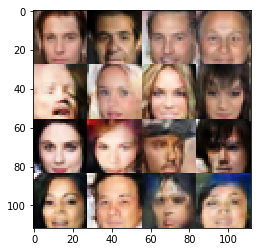

Epochs 48310/60000 Batch Step 835/3166 gen_loss = -0.9458156824111938..., disc_loss = -0.3122648596763611..., train using time = 11.573
Epochs 48320/60000 Batch Step 845/3166 gen_loss = -1.0963048934936523..., disc_loss = -0.33017128705978394..., train using time = 12.189
Epochs 48330/60000 Batch Step 855/3166 gen_loss = 0.36493802070617676..., disc_loss = -0.4692438542842865..., train using time = 11.569
Epochs 48340/60000 Batch Step 865/3166 gen_loss = -0.801313579082489..., disc_loss = -0.34305092692375183..., train using time = 11.556
Epochs 48350/60000 Batch Step 875/3166 gen_loss = 1.1741728782653809..., disc_loss = -0.32665926218032837..., train using time = 11.886
Epochs 48360/60000 Batch Step 885/3166 gen_loss = 1.2534511089324951..., disc_loss = -0.40030479431152344..., train using time = 11.728
Epochs 48370/60000 Batch Step 895/3166 gen_loss = -1.321049451828003..., disc_loss = -0.37882035970687866..., train using time = 12.610
Epochs 48380/60000 Batch Step 905/3166 gen_loss

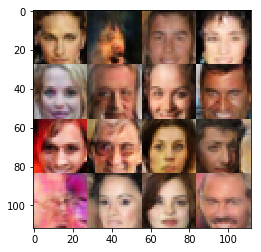

Epochs 48410/60000 Batch Step 935/3166 gen_loss = 1.1112982034683228..., disc_loss = -0.34520193934440613..., train using time = 11.572
Epochs 48420/60000 Batch Step 945/3166 gen_loss = 0.8077008724212646..., disc_loss = -0.30170702934265137..., train using time = 12.175
Epochs 48430/60000 Batch Step 955/3166 gen_loss = 0.52452152967453..., disc_loss = -0.41128525137901306..., train using time = 11.633
Epochs 48440/60000 Batch Step 965/3166 gen_loss = 0.17648451030254364..., disc_loss = -0.44305190443992615..., train using time = 11.604
Epochs 48450/60000 Batch Step 975/3166 gen_loss = 0.16438224911689758..., disc_loss = -0.27476000785827637..., train using time = 11.629
Epochs 48460/60000 Batch Step 985/3166 gen_loss = -1.869147777557373..., disc_loss = -0.0662403404712677..., train using time = 11.757
Epochs 48470/60000 Batch Step 995/3166 gen_loss = -0.4664109945297241..., disc_loss = -0.40255624055862427..., train using time = 11.675
Epochs 48480/60000 Batch Step 1005/3166 gen_loss

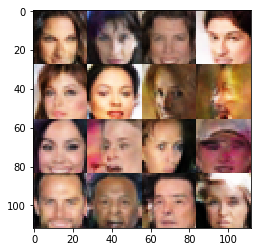

Epochs 48510/60000 Batch Step 1035/3166 gen_loss = 1.339315414428711..., disc_loss = -0.33133453130722046..., train using time = 11.579
Epochs 48520/60000 Batch Step 1045/3166 gen_loss = 0.26859596371650696..., disc_loss = -0.4282262921333313..., train using time = 11.651
Epochs 48530/60000 Batch Step 1055/3166 gen_loss = 0.9133749008178711..., disc_loss = -0.33598822355270386..., train using time = 11.547
Epochs 48540/60000 Batch Step 1065/3166 gen_loss = -0.18655768036842346..., disc_loss = -0.29974302649497986..., train using time = 11.631
Epochs 48550/60000 Batch Step 1075/3166 gen_loss = 0.6356639266014099..., disc_loss = -0.3785410523414612..., train using time = 11.592
Epochs 48560/60000 Batch Step 1085/3166 gen_loss = -0.07300662994384766..., disc_loss = -0.32429590821266174..., train using time = 11.726
Epochs 48570/60000 Batch Step 1095/3166 gen_loss = 0.6505078077316284..., disc_loss = -0.3135793209075928..., train using time = 11.907
Epochs 48580/60000 Batch Step 1105/3166 

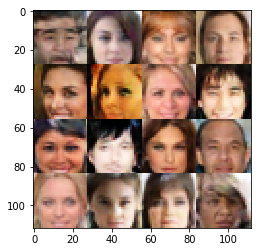

Epochs 48610/60000 Batch Step 1135/3166 gen_loss = 0.10002171248197556..., disc_loss = -0.19624686241149902..., train using time = 11.537
Epochs 48620/60000 Batch Step 1145/3166 gen_loss = -0.3695821762084961..., disc_loss = -0.3420203626155853..., train using time = 11.577
Epochs 48630/60000 Batch Step 1155/3166 gen_loss = 0.267005980014801..., disc_loss = -0.32914185523986816..., train using time = 11.599
Epochs 48640/60000 Batch Step 1165/3166 gen_loss = 0.5114730000495911..., disc_loss = -0.4101884961128235..., train using time = 11.598
Epochs 48650/60000 Batch Step 1175/3166 gen_loss = 0.6373244524002075..., disc_loss = -0.5057924389839172..., train using time = 11.652
Epochs 48660/60000 Batch Step 1185/3166 gen_loss = 0.2243834137916565..., disc_loss = -0.36152976751327515..., train using time = 11.851
Epochs 48670/60000 Batch Step 1195/3166 gen_loss = 0.02937055192887783..., disc_loss = -0.4191202223300934..., train using time = 11.644
Epochs 48680/60000 Batch Step 1205/3166 gen

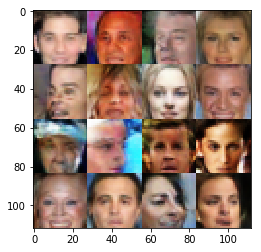

Epochs 48710/60000 Batch Step 1235/3166 gen_loss = -2.580169200897217..., disc_loss = -0.1376979649066925..., train using time = 11.616
Epochs 48720/60000 Batch Step 1245/3166 gen_loss = -0.02904869243502617..., disc_loss = -0.5291532278060913..., train using time = 11.541
Epochs 48730/60000 Batch Step 1255/3166 gen_loss = 0.38278743624687195..., disc_loss = -0.4808875024318695..., train using time = 11.744
Epochs 48740/60000 Batch Step 1265/3166 gen_loss = -0.12021514773368835..., disc_loss = -0.2877246141433716..., train using time = 11.632
Epochs 48750/60000 Batch Step 1275/3166 gen_loss = -0.7919552326202393..., disc_loss = -0.4361554980278015..., train using time = 11.594
Epochs 48760/60000 Batch Step 1285/3166 gen_loss = -0.13700926303863525..., disc_loss = -0.371279239654541..., train using time = 11.741
Epochs 48770/60000 Batch Step 1295/3166 gen_loss = -0.17940539121627808..., disc_loss = -0.6322163343429565..., train using time = 11.642
Epochs 48780/60000 Batch Step 1305/3166

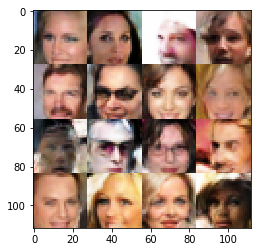

Epochs 48810/60000 Batch Step 1335/3166 gen_loss = -1.1027337312698364..., disc_loss = -0.34852078557014465..., train using time = 11.632
Epochs 48820/60000 Batch Step 1345/3166 gen_loss = 0.13857656717300415..., disc_loss = -0.48007768392562866..., train using time = 11.619
Epochs 48830/60000 Batch Step 1355/3166 gen_loss = -0.019894622266292572..., disc_loss = -0.40214404463768005..., train using time = 13.070
Epochs 48840/60000 Batch Step 1365/3166 gen_loss = -1.0283764600753784..., disc_loss = -0.34964457154273987..., train using time = 11.565
Epochs 48850/60000 Batch Step 1375/3166 gen_loss = 0.7695115804672241..., disc_loss = -0.5189248323440552..., train using time = 11.636
Epochs 48860/60000 Batch Step 1385/3166 gen_loss = 0.32729819416999817..., disc_loss = -0.4160638749599457..., train using time = 11.755
Epochs 48870/60000 Batch Step 1395/3166 gen_loss = -0.47425901889801025..., disc_loss = -0.4726589322090149..., train using time = 11.535
Epochs 48880/60000 Batch Step 1405/

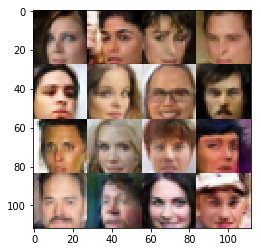

Epochs 48910/60000 Batch Step 1435/3166 gen_loss = 2.539208173751831..., disc_loss = -0.4644757807254791..., train using time = 11.657
Epochs 48920/60000 Batch Step 1445/3166 gen_loss = 1.2874854803085327..., disc_loss = -0.3138495981693268..., train using time = 11.574
Epochs 48930/60000 Batch Step 1455/3166 gen_loss = 0.5178722143173218..., disc_loss = -0.4149301052093506..., train using time = 11.647
Epochs 48940/60000 Batch Step 1465/3166 gen_loss = 0.18546536564826965..., disc_loss = -0.4611976742744446..., train using time = 11.542
Epochs 48950/60000 Batch Step 1475/3166 gen_loss = -3.7513427734375..., disc_loss = -0.3903988301753998..., train using time = 11.624
Epochs 48960/60000 Batch Step 1485/3166 gen_loss = 0.9313483238220215..., disc_loss = -0.3354761004447937..., train using time = 11.610
Epochs 48970/60000 Batch Step 1495/3166 gen_loss = -0.4010910987854004..., disc_loss = -0.30422139167785645..., train using time = 11.600
Epochs 48980/60000 Batch Step 1505/3166 gen_loss

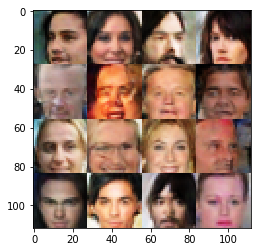

Epochs 49010/60000 Batch Step 1535/3166 gen_loss = -0.4167954921722412..., disc_loss = -0.37657731771469116..., train using time = 11.586
Epochs 49020/60000 Batch Step 1545/3166 gen_loss = -0.823075532913208..., disc_loss = -0.3714081645011902..., train using time = 11.636
Epochs 49030/60000 Batch Step 1555/3166 gen_loss = 0.32465600967407227..., disc_loss = -0.43487349152565..., train using time = 11.673
Epochs 49040/60000 Batch Step 1565/3166 gen_loss = -0.30579525232315063..., disc_loss = -0.3743360638618469..., train using time = 11.671
Epochs 49050/60000 Batch Step 1575/3166 gen_loss = 0.35174012184143066..., disc_loss = -0.3647513687610626..., train using time = 11.610
Epochs 49060/60000 Batch Step 1585/3166 gen_loss = 0.04135630652308464..., disc_loss = -0.2802808880805969..., train using time = 13.028
Epochs 49070/60000 Batch Step 1595/3166 gen_loss = -0.6685810089111328..., disc_loss = -0.47090452909469604..., train using time = 11.864
Epochs 49080/60000 Batch Step 1605/3166 g

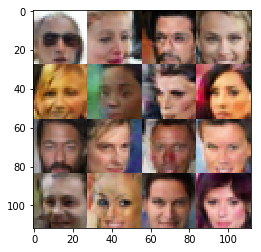

Epochs 49110/60000 Batch Step 1635/3166 gen_loss = 0.6211780309677124..., disc_loss = -0.39553189277648926..., train using time = 11.662
Epochs 49120/60000 Batch Step 1645/3166 gen_loss = 0.5243418216705322..., disc_loss = -0.23678641021251678..., train using time = 11.598
Epochs 49130/60000 Batch Step 1655/3166 gen_loss = -0.5937249064445496..., disc_loss = -0.4095118045806885..., train using time = 11.558
Epochs 49140/60000 Batch Step 1665/3166 gen_loss = -0.4130993187427521..., disc_loss = -0.3945499062538147..., train using time = 11.687
Epochs 49150/60000 Batch Step 1675/3166 gen_loss = 0.1973990499973297..., disc_loss = -0.36611372232437134..., train using time = 11.558
Epochs 49160/60000 Batch Step 1685/3166 gen_loss = -0.45163196325302124..., disc_loss = -0.3772571086883545..., train using time = 11.559
Epochs 49170/60000 Batch Step 1695/3166 gen_loss = 2.142505407333374..., disc_loss = -0.28798484802246094..., train using time = 11.637
Epochs 49180/60000 Batch Step 1705/3166 g

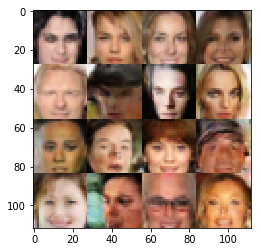

Epochs 49210/60000 Batch Step 1735/3166 gen_loss = 0.4789401590824127..., disc_loss = -0.5053044557571411..., train using time = 11.754
Epochs 49220/60000 Batch Step 1745/3166 gen_loss = 0.38917219638824463..., disc_loss = -0.5004825592041016..., train using time = 11.669
Epochs 49230/60000 Batch Step 1755/3166 gen_loss = -1.718650460243225..., disc_loss = -0.4443979263305664..., train using time = 11.697
Epochs 49240/60000 Batch Step 1765/3166 gen_loss = -0.6207951307296753..., disc_loss = -0.3695147633552551..., train using time = 11.653
Epochs 49250/60000 Batch Step 1775/3166 gen_loss = 0.29013001918792725..., disc_loss = -0.3605494499206543..., train using time = 11.535
Epochs 49260/60000 Batch Step 1785/3166 gen_loss = 0.22558775544166565..., disc_loss = -0.3522375822067261..., train using time = 11.608
Epochs 49270/60000 Batch Step 1795/3166 gen_loss = -0.7281329035758972..., disc_loss = -0.41806134581565857..., train using time = 11.634
Epochs 49280/60000 Batch Step 1805/3166 ge

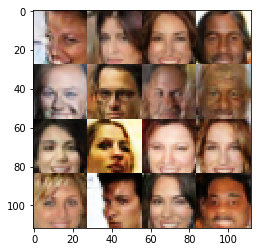

Epochs 49310/60000 Batch Step 1835/3166 gen_loss = -1.1970252990722656..., disc_loss = -0.3695448935031891..., train using time = 11.774
Epochs 49320/60000 Batch Step 1845/3166 gen_loss = 0.22681519389152527..., disc_loss = -0.4410271644592285..., train using time = 12.358
Epochs 49330/60000 Batch Step 1855/3166 gen_loss = -0.3324717581272125..., disc_loss = -0.39557814598083496..., train using time = 11.605
Epochs 49340/60000 Batch Step 1865/3166 gen_loss = 1.8600062131881714..., disc_loss = -0.5339158773422241..., train using time = 11.662
Epochs 49350/60000 Batch Step 1875/3166 gen_loss = 0.8498308062553406..., disc_loss = -0.4066449701786041..., train using time = 11.815
Epochs 49360/60000 Batch Step 1885/3166 gen_loss = 0.16693437099456787..., disc_loss = -0.4633015990257263..., train using time = 11.547
Epochs 49370/60000 Batch Step 1895/3166 gen_loss = 0.24270257353782654..., disc_loss = -0.6074357032775879..., train using time = 11.596
Epochs 49380/60000 Batch Step 1905/3166 ge

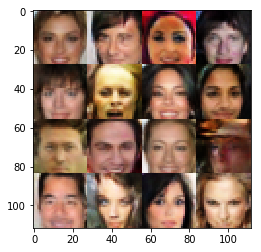

Epochs 49410/60000 Batch Step 1935/3166 gen_loss = 0.18537959456443787..., disc_loss = -0.4994436204433441..., train using time = 11.789
Epochs 49420/60000 Batch Step 1945/3166 gen_loss = -0.15067829191684723..., disc_loss = -0.3833540678024292..., train using time = 11.564
Epochs 49430/60000 Batch Step 1955/3166 gen_loss = 1.3799149990081787..., disc_loss = -0.37686824798583984..., train using time = 11.605
Epochs 49440/60000 Batch Step 1965/3166 gen_loss = 0.20404264330863953..., disc_loss = -0.44885820150375366..., train using time = 11.620
Epochs 49450/60000 Batch Step 1975/3166 gen_loss = -1.0047290325164795..., disc_loss = -0.32909706234931946..., train using time = 11.647
Epochs 49460/60000 Batch Step 1985/3166 gen_loss = 0.9878900051116943..., disc_loss = -0.46695631742477417..., train using time = 11.636
Epochs 49470/60000 Batch Step 1995/3166 gen_loss = 0.22905400395393372..., disc_loss = -0.3583061099052429..., train using time = 11.563
Epochs 49480/60000 Batch Step 2005/316

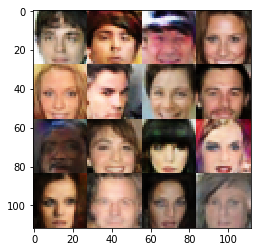

Epochs 49510/60000 Batch Step 2035/3166 gen_loss = 0.1367454081773758..., disc_loss = -0.6237716674804688..., train using time = 12.341
Epochs 49520/60000 Batch Step 2045/3166 gen_loss = 0.8137982487678528..., disc_loss = -0.371315062046051..., train using time = 13.033
Epochs 49530/60000 Batch Step 2055/3166 gen_loss = 1.387044072151184..., disc_loss = -0.418447881937027..., train using time = 11.646
Epochs 49540/60000 Batch Step 2065/3166 gen_loss = 1.3695322275161743..., disc_loss = -0.33711257576942444..., train using time = 11.759
Epochs 49550/60000 Batch Step 2075/3166 gen_loss = 1.0797568559646606..., disc_loss = -0.4568827748298645..., train using time = 11.612
Epochs 49560/60000 Batch Step 2085/3166 gen_loss = -0.06514619290828705..., disc_loss = -0.2495899498462677..., train using time = 11.922
Epochs 49570/60000 Batch Step 2095/3166 gen_loss = 0.6394025087356567..., disc_loss = -0.23927727341651917..., train using time = 11.884
Epochs 49580/60000 Batch Step 2105/3166 gen_los

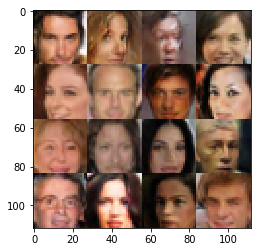

Epochs 49610/60000 Batch Step 2135/3166 gen_loss = 2.0077388286590576..., disc_loss = -0.22661666572093964..., train using time = 11.572
Epochs 49620/60000 Batch Step 2145/3166 gen_loss = -1.1398013830184937..., disc_loss = -0.3400118350982666..., train using time = 11.506
Epochs 49630/60000 Batch Step 2155/3166 gen_loss = -0.22911767661571503..., disc_loss = -0.30510908365249634..., train using time = 11.604
Epochs 49640/60000 Batch Step 2165/3166 gen_loss = -0.15778848528862..., disc_loss = -0.46604499220848083..., train using time = 11.667
Epochs 49650/60000 Batch Step 2175/3166 gen_loss = -0.012982524931430817..., disc_loss = -0.33828145265579224..., train using time = 11.655
Epochs 49660/60000 Batch Step 2185/3166 gen_loss = 1.7784497737884521..., disc_loss = -0.3577672243118286..., train using time = 11.500
Epochs 49670/60000 Batch Step 2195/3166 gen_loss = 0.3898511826992035..., disc_loss = -0.2854146957397461..., train using time = 11.785
Epochs 49680/60000 Batch Step 2205/3166

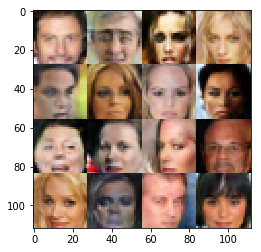

Epochs 49710/60000 Batch Step 2235/3166 gen_loss = -1.4373399019241333..., disc_loss = -0.5423802733421326..., train using time = 11.555
Epochs 49720/60000 Batch Step 2245/3166 gen_loss = 0.07080082595348358..., disc_loss = -0.3869495689868927..., train using time = 11.508
Epochs 49730/60000 Batch Step 2255/3166 gen_loss = 1.2536890506744385..., disc_loss = -0.3462114632129669..., train using time = 11.604
Epochs 49740/60000 Batch Step 2265/3166 gen_loss = -0.8680815696716309..., disc_loss = -0.2914246618747711..., train using time = 11.588
Epochs 49750/60000 Batch Step 2275/3166 gen_loss = -0.9811259508132935..., disc_loss = -0.33718112111091614..., train using time = 14.110
Epochs 49760/60000 Batch Step 2285/3166 gen_loss = -0.3827863037586212..., disc_loss = -0.5071238875389099..., train using time = 11.761
Epochs 49770/60000 Batch Step 2295/3166 gen_loss = -0.827754557132721..., disc_loss = -0.3559970557689667..., train using time = 11.619
Epochs 49780/60000 Batch Step 2305/3166 ge

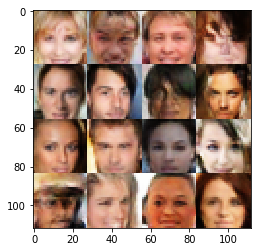

Epochs 49810/60000 Batch Step 2335/3166 gen_loss = 1.3818989992141724..., disc_loss = -0.3592575192451477..., train using time = 11.569
Epochs 49820/60000 Batch Step 2345/3166 gen_loss = -1.5370690822601318..., disc_loss = -0.4712100923061371..., train using time = 11.710
Epochs 49830/60000 Batch Step 2355/3166 gen_loss = -0.1391536146402359..., disc_loss = -0.4138844609260559..., train using time = 11.680
Epochs 49840/60000 Batch Step 2365/3166 gen_loss = -0.18064871430397034..., disc_loss = -0.3553110659122467..., train using time = 11.630
Epochs 49850/60000 Batch Step 2375/3166 gen_loss = 0.5862264633178711..., disc_loss = -0.4330146908760071..., train using time = 11.813
Epochs 49860/60000 Batch Step 2385/3166 gen_loss = 0.06662751734256744..., disc_loss = -0.5339734554290771..., train using time = 12.284
Epochs 49870/60000 Batch Step 2395/3166 gen_loss = 0.6079502701759338..., disc_loss = -0.37404176592826843..., train using time = 11.671
Epochs 49880/60000 Batch Step 2405/3166 ge

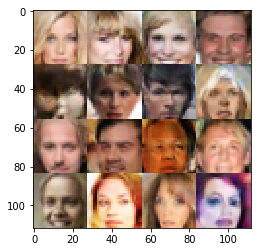

Epochs 49910/60000 Batch Step 2435/3166 gen_loss = -0.8990423679351807..., disc_loss = -0.2754485309123993..., train using time = 11.495
Epochs 49920/60000 Batch Step 2445/3166 gen_loss = 0.9765573143959045..., disc_loss = -0.4964727461338043..., train using time = 11.700
Epochs 49930/60000 Batch Step 2455/3166 gen_loss = -1.394153356552124..., disc_loss = -0.09511470049619675..., train using time = 11.573
Epochs 49940/60000 Batch Step 2465/3166 gen_loss = -0.01159604825079441..., disc_loss = -0.3593069911003113..., train using time = 11.597
Epochs 49950/60000 Batch Step 2475/3166 gen_loss = -0.5208070874214172..., disc_loss = -0.40975427627563477..., train using time = 11.580
Epochs 49960/60000 Batch Step 2485/3166 gen_loss = 2.390371561050415..., disc_loss = -0.33519265055656433..., train using time = 11.688
Epochs 49970/60000 Batch Step 2495/3166 gen_loss = 0.6201767325401306..., disc_loss = -0.5271774530410767..., train using time = 11.644
Epochs 49980/60000 Batch Step 2505/3166 ge

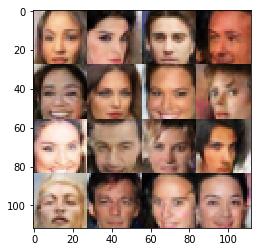

Epochs 50010/60000 Batch Step 2535/3166 gen_loss = -0.4049239754676819..., disc_loss = -0.29310694336891174..., train using time = 11.594
Epochs 50020/60000 Batch Step 2545/3166 gen_loss = -0.5777230262756348..., disc_loss = -0.4503820836544037..., train using time = 11.569
Epochs 50030/60000 Batch Step 2555/3166 gen_loss = 1.242086410522461..., disc_loss = -0.42085084319114685..., train using time = 11.847
Epochs 50040/60000 Batch Step 2565/3166 gen_loss = 0.6713041067123413..., disc_loss = -0.4739445149898529..., train using time = 11.718
Epochs 50050/60000 Batch Step 2575/3166 gen_loss = 1.4230396747589111..., disc_loss = -0.5813795924186707..., train using time = 11.520
Epochs 50060/60000 Batch Step 2585/3166 gen_loss = 0.770271897315979..., disc_loss = -0.335574209690094..., train using time = 11.940
Epochs 50070/60000 Batch Step 2595/3166 gen_loss = 0.9652494788169861..., disc_loss = -0.28499093651771545..., train using time = 11.542
Epochs 50080/60000 Batch Step 2605/3166 gen_lo

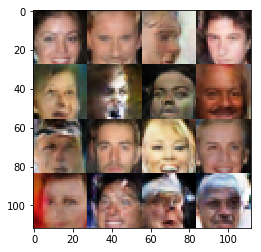

Epochs 50110/60000 Batch Step 2635/3166 gen_loss = -0.47110244631767273..., disc_loss = -0.3155062794685364..., train using time = 11.542
Epochs 50120/60000 Batch Step 2645/3166 gen_loss = 1.6285088062286377..., disc_loss = -0.4392583966255188..., train using time = 11.489
Epochs 50130/60000 Batch Step 2655/3166 gen_loss = -0.17720498144626617..., disc_loss = -0.39221814274787903..., train using time = 11.774
Epochs 50140/60000 Batch Step 2665/3166 gen_loss = 1.2885279655456543..., disc_loss = -0.3304370045661926..., train using time = 11.526
Epochs 50150/60000 Batch Step 2675/3166 gen_loss = -1.2248656749725342..., disc_loss = -0.2565760314464569..., train using time = 11.587
Epochs 50160/60000 Batch Step 2685/3166 gen_loss = 1.4926223754882812..., disc_loss = -0.45322322845458984..., train using time = 11.749
Epochs 50170/60000 Batch Step 2695/3166 gen_loss = -0.15456172823905945..., disc_loss = -0.4318414330482483..., train using time = 11.747
Epochs 50180/60000 Batch Step 2705/3166

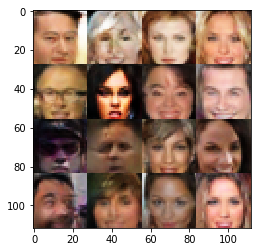

Epochs 50210/60000 Batch Step 2735/3166 gen_loss = 0.6402910947799683..., disc_loss = -0.5489568114280701..., train using time = 13.113
Epochs 50220/60000 Batch Step 2745/3166 gen_loss = -1.9127006530761719..., disc_loss = -0.4164734482765198..., train using time = 11.702
Epochs 50230/60000 Batch Step 2755/3166 gen_loss = 0.5557963252067566..., disc_loss = -0.45779305696487427..., train using time = 11.817
Epochs 50240/60000 Batch Step 2765/3166 gen_loss = -1.2771066427230835..., disc_loss = -0.3583143353462219..., train using time = 12.610
Epochs 50250/60000 Batch Step 2775/3166 gen_loss = 0.13894838094711304..., disc_loss = -0.39074933528900146..., train using time = 11.799
Epochs 50260/60000 Batch Step 2785/3166 gen_loss = -0.6603603363037109..., disc_loss = -0.4077015519142151..., train using time = 11.574
Epochs 50270/60000 Batch Step 2795/3166 gen_loss = -0.2879215478897095..., disc_loss = -0.3917474150657654..., train using time = 11.785
Epochs 50280/60000 Batch Step 2805/3166 g

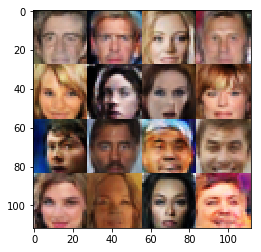

Epochs 50310/60000 Batch Step 2835/3166 gen_loss = -0.7230361700057983..., disc_loss = -0.15982608497142792..., train using time = 11.568
Epochs 50320/60000 Batch Step 2845/3166 gen_loss = -0.2653687000274658..., disc_loss = -0.4132668375968933..., train using time = 11.596
Epochs 50330/60000 Batch Step 2855/3166 gen_loss = 0.9109504222869873..., disc_loss = -0.30239373445510864..., train using time = 11.597
Epochs 50340/60000 Batch Step 2865/3166 gen_loss = 1.442528486251831..., disc_loss = -0.3724489212036133..., train using time = 11.776
Epochs 50350/60000 Batch Step 2875/3166 gen_loss = 1.4200036525726318..., disc_loss = -0.3431093990802765..., train using time = 11.624
Epochs 50360/60000 Batch Step 2885/3166 gen_loss = 0.48453259468078613..., disc_loss = -0.38020652532577515..., train using time = 11.740
Epochs 50370/60000 Batch Step 2895/3166 gen_loss = 0.6590242981910706..., disc_loss = -0.3264276385307312..., train using time = 11.688
Epochs 50380/60000 Batch Step 2905/3166 gen

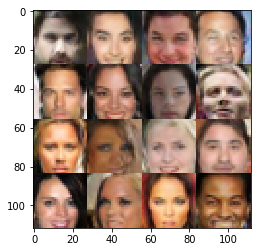

Epochs 50410/60000 Batch Step 2935/3166 gen_loss = 0.8247423768043518..., disc_loss = -0.3551483154296875..., train using time = 11.570
Epochs 50420/60000 Batch Step 2945/3166 gen_loss = -0.6536309719085693..., disc_loss = -0.4903717041015625..., train using time = 11.622
Epochs 50430/60000 Batch Step 2955/3166 gen_loss = -1.1830830574035645..., disc_loss = -0.2949087619781494..., train using time = 11.656
Epochs 50440/60000 Batch Step 2965/3166 gen_loss = 1.600940465927124..., disc_loss = -0.23883147537708282..., train using time = 13.951
Epochs 50450/60000 Batch Step 2975/3166 gen_loss = -1.4484096765518188..., disc_loss = -0.29820290207862854..., train using time = 11.631
Epochs 50460/60000 Batch Step 2985/3166 gen_loss = 0.6988625526428223..., disc_loss = -0.2621082663536072..., train using time = 11.723
Epochs 50470/60000 Batch Step 2995/3166 gen_loss = 0.47815707325935364..., disc_loss = -0.40372008085250854..., train using time = 11.817
Epochs 50480/60000 Batch Step 3005/3166 ge

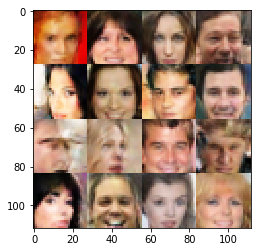

Epochs 50510/60000 Batch Step 3035/3166 gen_loss = -1.7046797275543213..., disc_loss = -0.35280340909957886..., train using time = 12.135
Epochs 50520/60000 Batch Step 3045/3166 gen_loss = 0.0192180797457695..., disc_loss = -0.40361857414245605..., train using time = 11.939
Epochs 50530/60000 Batch Step 3055/3166 gen_loss = -0.6064413785934448..., disc_loss = -0.4231550693511963..., train using time = 11.630
Epochs 50540/60000 Batch Step 3065/3166 gen_loss = -1.719552993774414..., disc_loss = -0.3120928406715393..., train using time = 11.676
Epochs 50550/60000 Batch Step 3075/3166 gen_loss = -0.35172250866889954..., disc_loss = -0.4375251829624176..., train using time = 11.743
Epochs 50560/60000 Batch Step 3085/3166 gen_loss = -2.3295669555664062..., disc_loss = -0.2544480860233307..., train using time = 11.755
Epochs 50570/60000 Batch Step 3095/3166 gen_loss = 0.06020849570631981..., disc_loss = -0.28395071625709534..., train using time = 11.591
Epochs 50580/60000 Batch Step 3105/3166

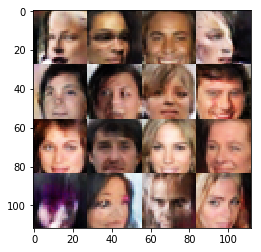

Epochs 50610/60000 Batch Step 3135/3166 gen_loss = -1.187347173690796..., disc_loss = -0.43139582872390747..., train using time = 11.567
Epochs 50620/60000 Batch Step 3145/3166 gen_loss = 1.4008212089538574..., disc_loss = -0.30689728260040283..., train using time = 11.675
Epochs 50630/60000 Batch Step 3155/3166 gen_loss = -2.2015442848205566..., disc_loss = -0.5265249013900757..., train using time = 11.613
Epochs 50640/60000 Batch Step 3165/3166 gen_loss = -0.6664128303527832..., disc_loss = -0.4108469486236572..., train using time = 11.530
Epochs 50650/60000 Batch Step 10/3166 gen_loss = -1.2413842678070068..., disc_loss = -0.40415072441101074..., train using time = 11.613
Epochs 50660/60000 Batch Step 20/3166 gen_loss = 0.46058282256126404..., disc_loss = -0.44239893555641174..., train using time = 11.592
Epochs 50670/60000 Batch Step 30/3166 gen_loss = 0.7121925354003906..., disc_loss = -0.4807370603084564..., train using time = 14.281
Epochs 50680/60000 Batch Step 40/3166 gen_loss

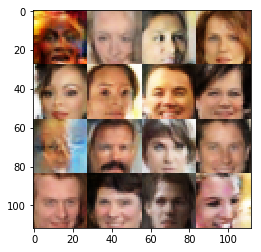

Epochs 50710/60000 Batch Step 70/3166 gen_loss = 1.5417451858520508..., disc_loss = -0.3883744776248932..., train using time = 11.542
Epochs 50720/60000 Batch Step 80/3166 gen_loss = -0.35937339067459106..., disc_loss = -0.4377117156982422..., train using time = 12.100
Epochs 50730/60000 Batch Step 90/3166 gen_loss = 1.623281717300415..., disc_loss = -0.3422078788280487..., train using time = 13.357
Epochs 50740/60000 Batch Step 100/3166 gen_loss = -0.7077874541282654..., disc_loss = -0.3770650327205658..., train using time = 11.656
Epochs 50750/60000 Batch Step 110/3166 gen_loss = -1.5915603637695312..., disc_loss = -0.28918617963790894..., train using time = 11.552
Epochs 50760/60000 Batch Step 120/3166 gen_loss = 0.8442051410675049..., disc_loss = -0.5081185102462769..., train using time = 11.580
Epochs 50770/60000 Batch Step 130/3166 gen_loss = -0.2523447871208191..., disc_loss = -0.40565958619117737..., train using time = 13.538
Epochs 50780/60000 Batch Step 140/3166 gen_loss = 0.

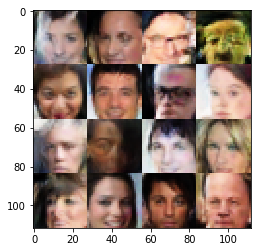

Epochs 50810/60000 Batch Step 170/3166 gen_loss = 1.7737367153167725..., disc_loss = -0.3940249979496002..., train using time = 11.685
Epochs 50820/60000 Batch Step 180/3166 gen_loss = -0.1647225320339203..., disc_loss = -0.40786439180374146..., train using time = 12.783
Epochs 50830/60000 Batch Step 190/3166 gen_loss = -0.01666317880153656..., disc_loss = -0.3549886643886566..., train using time = 11.610
Epochs 50840/60000 Batch Step 200/3166 gen_loss = -1.5261800289154053..., disc_loss = -0.30035340785980225..., train using time = 11.668
Epochs 50850/60000 Batch Step 210/3166 gen_loss = -0.9425019025802612..., disc_loss = -0.47935718297958374..., train using time = 12.401
Epochs 50860/60000 Batch Step 220/3166 gen_loss = 1.0322691202163696..., disc_loss = -0.3721478283405304..., train using time = 11.702
Epochs 50870/60000 Batch Step 230/3166 gen_loss = -0.2823635935783386..., disc_loss = -0.1690230369567871..., train using time = 11.935
Epochs 50880/60000 Batch Step 240/3166 gen_los

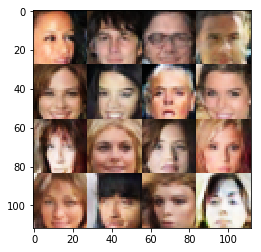

Epochs 50910/60000 Batch Step 270/3166 gen_loss = -0.05381361395120621..., disc_loss = -0.340517520904541..., train using time = 11.751
Epochs 50920/60000 Batch Step 280/3166 gen_loss = 0.5244859457015991..., disc_loss = -0.4390450417995453..., train using time = 11.594
Epochs 50930/60000 Batch Step 290/3166 gen_loss = 0.1066693365573883..., disc_loss = -0.23549695312976837..., train using time = 11.587
Epochs 50940/60000 Batch Step 300/3166 gen_loss = 0.8197894096374512..., disc_loss = -0.40768343210220337..., train using time = 11.851
Epochs 50950/60000 Batch Step 310/3166 gen_loss = 1.403802514076233..., disc_loss = -0.2607814073562622..., train using time = 11.863
Epochs 50960/60000 Batch Step 320/3166 gen_loss = -0.42425957322120667..., disc_loss = -0.5138965845108032..., train using time = 11.830
Epochs 50970/60000 Batch Step 330/3166 gen_loss = -0.5378100275993347..., disc_loss = -0.39549654722213745..., train using time = 11.886
Epochs 50980/60000 Batch Step 340/3166 gen_loss =

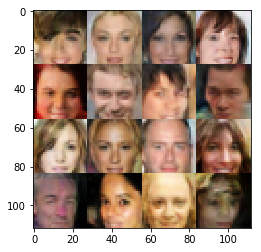

Epochs 51010/60000 Batch Step 370/3166 gen_loss = 0.5195350646972656..., disc_loss = -0.40936893224716187..., train using time = 11.799
Epochs 51020/60000 Batch Step 380/3166 gen_loss = -0.5616878271102905..., disc_loss = -0.3927696645259857..., train using time = 11.651
Epochs 51030/60000 Batch Step 390/3166 gen_loss = -0.8416749835014343..., disc_loss = -0.5020756125450134..., train using time = 11.662
Epochs 51040/60000 Batch Step 400/3166 gen_loss = -0.6263360381126404..., disc_loss = -0.28444087505340576..., train using time = 11.673
Epochs 51050/60000 Batch Step 410/3166 gen_loss = 1.2255094051361084..., disc_loss = -0.4769352972507477..., train using time = 12.572
Epochs 51060/60000 Batch Step 420/3166 gen_loss = 0.011436463333666325..., disc_loss = -0.4341018795967102..., train using time = 11.618
Epochs 51070/60000 Batch Step 430/3166 gen_loss = 0.28558486700057983..., disc_loss = -0.43516141176223755..., train using time = 11.555
Epochs 51080/60000 Batch Step 440/3166 gen_los

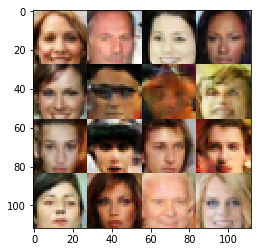

Epochs 51110/60000 Batch Step 470/3166 gen_loss = 0.6632104516029358..., disc_loss = -0.381743848323822..., train using time = 11.800
Epochs 51120/60000 Batch Step 480/3166 gen_loss = 0.3740125894546509..., disc_loss = -0.41574764251708984..., train using time = 11.702
Epochs 51130/60000 Batch Step 490/3166 gen_loss = -0.6617116928100586..., disc_loss = -0.47128981351852417..., train using time = 11.709
Epochs 51140/60000 Batch Step 500/3166 gen_loss = -2.0893959999084473..., disc_loss = -0.33064377307891846..., train using time = 11.594
Epochs 51150/60000 Batch Step 510/3166 gen_loss = -0.36167111992836..., disc_loss = -0.33960217237472534..., train using time = 11.749
Epochs 51160/60000 Batch Step 520/3166 gen_loss = -0.353482186794281..., disc_loss = -0.39078187942504883..., train using time = 11.595
Epochs 51170/60000 Batch Step 530/3166 gen_loss = -0.37530338764190674..., disc_loss = -0.4673583507537842..., train using time = 11.659
Epochs 51180/60000 Batch Step 540/3166 gen_loss 

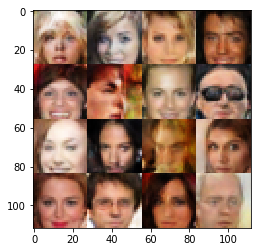

Epochs 51210/60000 Batch Step 570/3166 gen_loss = -1.3926180601119995..., disc_loss = -0.5334630608558655..., train using time = 11.545
Epochs 51220/60000 Batch Step 580/3166 gen_loss = 0.317869633436203..., disc_loss = -0.34091323614120483..., train using time = 11.736
Epochs 51230/60000 Batch Step 590/3166 gen_loss = 0.38724762201309204..., disc_loss = -0.29266348481178284..., train using time = 11.544
Epochs 51240/60000 Batch Step 600/3166 gen_loss = -1.4092674255371094..., disc_loss = -0.4585908055305481..., train using time = 11.612
Epochs 51250/60000 Batch Step 610/3166 gen_loss = -0.95671147108078..., disc_loss = -0.3470352292060852..., train using time = 11.751
Epochs 51260/60000 Batch Step 620/3166 gen_loss = -1.1113468408584595..., disc_loss = -0.31942468881607056..., train using time = 11.668
Epochs 51270/60000 Batch Step 630/3166 gen_loss = 0.987535834312439..., disc_loss = -0.3996512293815613..., train using time = 11.619
Epochs 51280/60000 Batch Step 640/3166 gen_loss = -

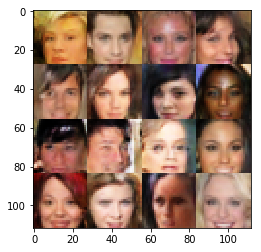

Epochs 51310/60000 Batch Step 670/3166 gen_loss = -1.911845088005066..., disc_loss = -0.4066683351993561..., train using time = 11.666
Epochs 51320/60000 Batch Step 680/3166 gen_loss = -1.7790014743804932..., disc_loss = -0.4539755880832672..., train using time = 11.624
Epochs 51330/60000 Batch Step 690/3166 gen_loss = -1.1686080694198608..., disc_loss = -0.3073553144931793..., train using time = 11.600
Epochs 51340/60000 Batch Step 700/3166 gen_loss = 0.4110247492790222..., disc_loss = -0.40693163871765137..., train using time = 12.248
Epochs 51350/60000 Batch Step 710/3166 gen_loss = -1.3683463335037231..., disc_loss = -0.28721627593040466..., train using time = 11.828
Epochs 51360/60000 Batch Step 720/3166 gen_loss = 0.03101448528468609..., disc_loss = -0.43840789794921875..., train using time = 12.301
Epochs 51370/60000 Batch Step 730/3166 gen_loss = 0.7133714556694031..., disc_loss = -0.2639275789260864..., train using time = 11.709
Epochs 51380/60000 Batch Step 740/3166 gen_loss 

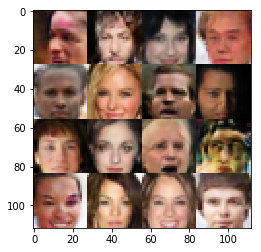

Epochs 51410/60000 Batch Step 770/3166 gen_loss = -1.0725159645080566..., disc_loss = -0.2306824028491974..., train using time = 11.755
Epochs 51420/60000 Batch Step 780/3166 gen_loss = -1.786341667175293..., disc_loss = -0.23875980079174042..., train using time = 11.774
Epochs 51430/60000 Batch Step 790/3166 gen_loss = 0.3279078006744385..., disc_loss = -0.3972824215888977..., train using time = 11.595
Epochs 51440/60000 Batch Step 800/3166 gen_loss = 1.2278709411621094..., disc_loss = -0.35698646306991577..., train using time = 11.722
Epochs 51450/60000 Batch Step 810/3166 gen_loss = -0.176937535405159..., disc_loss = -0.4345185160636902..., train using time = 11.823
Epochs 51460/60000 Batch Step 820/3166 gen_loss = -1.1502090692520142..., disc_loss = -0.24322645366191864..., train using time = 11.553
Epochs 51470/60000 Batch Step 830/3166 gen_loss = -1.9701969623565674..., disc_loss = -0.19434356689453125..., train using time = 11.798
Epochs 51480/60000 Batch Step 840/3166 gen_loss 

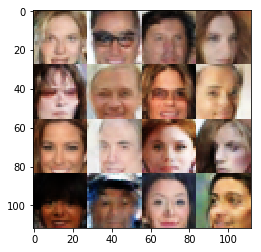

Epochs 51510/60000 Batch Step 870/3166 gen_loss = 1.723642349243164..., disc_loss = -0.3955772817134857..., train using time = 13.096
Epochs 51520/60000 Batch Step 880/3166 gen_loss = -0.5755578875541687..., disc_loss = -0.39767375588417053..., train using time = 11.745
Epochs 51530/60000 Batch Step 890/3166 gen_loss = -0.557041347026825..., disc_loss = -0.36886245012283325..., train using time = 12.186
Epochs 51540/60000 Batch Step 900/3166 gen_loss = 1.0038999319076538..., disc_loss = -0.37661266326904297..., train using time = 11.652
Epochs 51550/60000 Batch Step 910/3166 gen_loss = -1.6170482635498047..., disc_loss = -0.2107190191745758..., train using time = 11.528
Epochs 51560/60000 Batch Step 920/3166 gen_loss = -0.7042861580848694..., disc_loss = -0.2532206177711487..., train using time = 11.618
Epochs 51570/60000 Batch Step 930/3166 gen_loss = 0.024657154455780983..., disc_loss = -0.47448572516441345..., train using time = 11.639
Epochs 51580/60000 Batch Step 940/3166 gen_loss

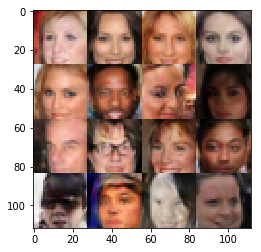

Epochs 51610/60000 Batch Step 970/3166 gen_loss = -1.5460267066955566..., disc_loss = -0.434253990650177..., train using time = 11.701
Epochs 51620/60000 Batch Step 980/3166 gen_loss = 1.2491209506988525..., disc_loss = -0.30946868658065796..., train using time = 11.648
Epochs 51630/60000 Batch Step 990/3166 gen_loss = 0.5254300832748413..., disc_loss = -0.40428653359413147..., train using time = 11.759
Epochs 51640/60000 Batch Step 1000/3166 gen_loss = 0.7250990867614746..., disc_loss = -0.2783315181732178..., train using time = 11.563
Epochs 51650/60000 Batch Step 1010/3166 gen_loss = -2.155822277069092..., disc_loss = -0.24349412322044373..., train using time = 11.606
Epochs 51660/60000 Batch Step 1020/3166 gen_loss = 0.111504465341568..., disc_loss = -0.32042890787124634..., train using time = 11.629
Epochs 51670/60000 Batch Step 1030/3166 gen_loss = 0.6369200348854065..., disc_loss = -0.43594059348106384..., train using time = 11.714
Epochs 51680/60000 Batch Step 1040/3166 gen_los

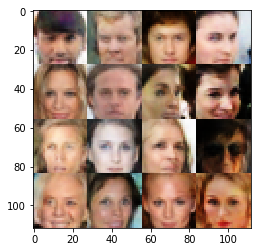

Epochs 51710/60000 Batch Step 1070/3166 gen_loss = -0.7415324449539185..., disc_loss = -0.40759381651878357..., train using time = 11.625
Epochs 51720/60000 Batch Step 1080/3166 gen_loss = -0.1292930245399475..., disc_loss = -0.3200627267360687..., train using time = 11.488
Epochs 51730/60000 Batch Step 1090/3166 gen_loss = 0.20482034981250763..., disc_loss = -0.5551425218582153..., train using time = 11.653
Epochs 51740/60000 Batch Step 1100/3166 gen_loss = -1.2049689292907715..., disc_loss = -0.4457972049713135..., train using time = 12.974
Epochs 51750/60000 Batch Step 1110/3166 gen_loss = 1.4628738164901733..., disc_loss = -0.26962587237358093..., train using time = 11.569
Epochs 51760/60000 Batch Step 1120/3166 gen_loss = 1.2346785068511963..., disc_loss = -0.28384023904800415..., train using time = 11.690
Epochs 51770/60000 Batch Step 1130/3166 gen_loss = -1.6684448719024658..., disc_loss = -0.28386855125427246..., train using time = 11.840
Epochs 51780/60000 Batch Step 1140/3166

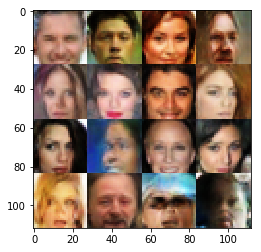

Epochs 51810/60000 Batch Step 1170/3166 gen_loss = -0.18369543552398682..., disc_loss = -0.33607131242752075..., train using time = 11.867
Epochs 51820/60000 Batch Step 1180/3166 gen_loss = -0.4812835156917572..., disc_loss = -0.4349212646484375..., train using time = 11.557
Epochs 51830/60000 Batch Step 1190/3166 gen_loss = -0.6890478730201721..., disc_loss = -0.37529319524765015..., train using time = 11.532
Epochs 51840/60000 Batch Step 1200/3166 gen_loss = 0.14269989728927612..., disc_loss = -0.391601026058197..., train using time = 11.693
Epochs 51850/60000 Batch Step 1210/3166 gen_loss = -1.366744875907898..., disc_loss = -0.23811933398246765..., train using time = 11.595
Epochs 51860/60000 Batch Step 1220/3166 gen_loss = -0.9338235259056091..., disc_loss = -0.3734467625617981..., train using time = 11.660
Epochs 51870/60000 Batch Step 1230/3166 gen_loss = -1.0661025047302246..., disc_loss = -0.26099905371665955..., train using time = 11.575
Epochs 51880/60000 Batch Step 1240/316

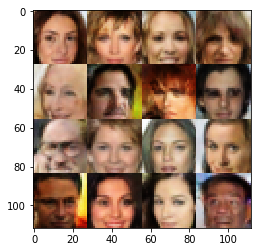

Epochs 51910/60000 Batch Step 1270/3166 gen_loss = -0.825104832649231..., disc_loss = -0.36389434337615967..., train using time = 11.739
Epochs 51920/60000 Batch Step 1280/3166 gen_loss = -0.5216922760009766..., disc_loss = -0.40444502234458923..., train using time = 11.619
Epochs 51930/60000 Batch Step 1290/3166 gen_loss = 1.093977928161621..., disc_loss = -0.446768194437027..., train using time = 11.785
Epochs 51940/60000 Batch Step 1300/3166 gen_loss = 0.1629284918308258..., disc_loss = -0.398223876953125..., train using time = 11.796
Epochs 51950/60000 Batch Step 1310/3166 gen_loss = 0.6188819408416748..., disc_loss = -0.3431317210197449..., train using time = 11.626
Epochs 51960/60000 Batch Step 1320/3166 gen_loss = 0.261325478553772..., disc_loss = -0.33698949217796326..., train using time = 11.621
Epochs 51970/60000 Batch Step 1330/3166 gen_loss = 0.46427541971206665..., disc_loss = -0.22386828064918518..., train using time = 12.165
Epochs 51980/60000 Batch Step 1340/3166 gen_lo

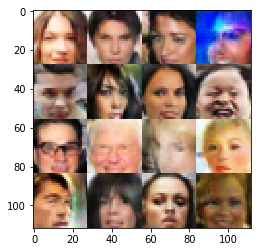

Epochs 52010/60000 Batch Step 1370/3166 gen_loss = 0.6181087493896484..., disc_loss = -0.3273521065711975..., train using time = 11.714
Epochs 52020/60000 Batch Step 1380/3166 gen_loss = 0.6701382398605347..., disc_loss = -0.4631085991859436..., train using time = 11.703
Epochs 52030/60000 Batch Step 1390/3166 gen_loss = -0.322750449180603..., disc_loss = -0.45147204399108887..., train using time = 11.599
Epochs 52040/60000 Batch Step 1400/3166 gen_loss = 0.4368975758552551..., disc_loss = -0.3410612940788269..., train using time = 11.592
Epochs 52050/60000 Batch Step 1410/3166 gen_loss = -0.7379889488220215..., disc_loss = -0.25182515382766724..., train using time = 11.741
Epochs 52060/60000 Batch Step 1420/3166 gen_loss = -0.7056475281715393..., disc_loss = -0.38274067640304565..., train using time = 11.570
Epochs 52070/60000 Batch Step 1430/3166 gen_loss = -1.7550044059753418..., disc_loss = -0.3189168870449066..., train using time = 11.798
Epochs 52080/60000 Batch Step 1440/3166 ge

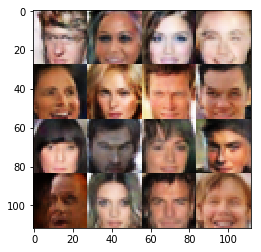

Epochs 52110/60000 Batch Step 1470/3166 gen_loss = -0.9522092938423157..., disc_loss = -0.3692854344844818..., train using time = 11.580
Epochs 52120/60000 Batch Step 1480/3166 gen_loss = 0.4028143882751465..., disc_loss = -0.30457767844200134..., train using time = 13.302
Epochs 52130/60000 Batch Step 1490/3166 gen_loss = -2.5831966400146484..., disc_loss = -0.43666523694992065..., train using time = 11.618
Epochs 52140/60000 Batch Step 1500/3166 gen_loss = -0.12066733837127686..., disc_loss = -0.3685787618160248..., train using time = 11.594
Epochs 52150/60000 Batch Step 1510/3166 gen_loss = 1.1767237186431885..., disc_loss = -0.3341889977455139..., train using time = 11.596
Epochs 52160/60000 Batch Step 1520/3166 gen_loss = -0.7174668312072754..., disc_loss = -0.3902747333049774..., train using time = 11.565
Epochs 52170/60000 Batch Step 1530/3166 gen_loss = -0.5506381988525391..., disc_loss = -0.3045150637626648..., train using time = 11.605
Epochs 52180/60000 Batch Step 1540/3166 

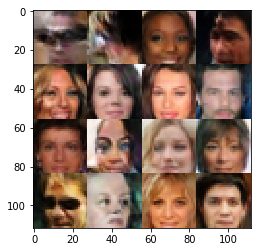

Epochs 52210/60000 Batch Step 1570/3166 gen_loss = 0.44575655460357666..., disc_loss = -0.3960022032260895..., train using time = 11.512
Epochs 52220/60000 Batch Step 1580/3166 gen_loss = 0.748221755027771..., disc_loss = -0.325511634349823..., train using time = 11.608
Epochs 52230/60000 Batch Step 1590/3166 gen_loss = 0.1857740730047226..., disc_loss = -0.41401416063308716..., train using time = 11.595
Epochs 52240/60000 Batch Step 1600/3166 gen_loss = 0.0019026771187782288..., disc_loss = -0.3927209973335266..., train using time = 11.706
Epochs 52250/60000 Batch Step 1610/3166 gen_loss = 0.6907557249069214..., disc_loss = -0.3533124625682831..., train using time = 11.643
Epochs 52260/60000 Batch Step 1620/3166 gen_loss = -0.5452052354812622..., disc_loss = -0.45520099997520447..., train using time = 11.752
Epochs 52270/60000 Batch Step 1630/3166 gen_loss = -0.04331744462251663..., disc_loss = -0.40041255950927734..., train using time = 11.616
Epochs 52280/60000 Batch Step 1640/3166 

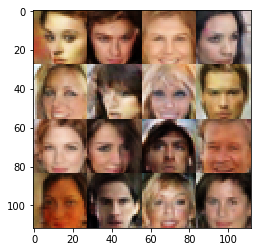

Epochs 52310/60000 Batch Step 1670/3166 gen_loss = 0.1821383237838745..., disc_loss = -0.36154705286026..., train using time = 11.658
Epochs 52320/60000 Batch Step 1680/3166 gen_loss = -0.7383502721786499..., disc_loss = -0.3519629240036011..., train using time = 12.066
Epochs 52330/60000 Batch Step 1690/3166 gen_loss = -0.03330831602215767..., disc_loss = -0.40432530641555786..., train using time = 11.604
Epochs 52340/60000 Batch Step 1700/3166 gen_loss = -1.8413870334625244..., disc_loss = -0.23525336384773254..., train using time = 11.765
Epochs 52350/60000 Batch Step 1710/3166 gen_loss = 1.2885878086090088..., disc_loss = -0.3819288909435272..., train using time = 12.698
Epochs 52360/60000 Batch Step 1720/3166 gen_loss = -0.5643594861030579..., disc_loss = -0.28135210275650024..., train using time = 11.636
Epochs 52370/60000 Batch Step 1730/3166 gen_loss = -2.2448630332946777..., disc_loss = -0.34917837381362915..., train using time = 12.009
Epochs 52380/60000 Batch Step 1740/3166 

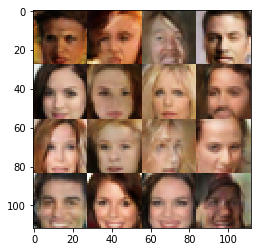

Epochs 52410/60000 Batch Step 1770/3166 gen_loss = 0.5154339075088501..., disc_loss = -0.32552671432495117..., train using time = 11.760
Epochs 52420/60000 Batch Step 1780/3166 gen_loss = 1.5081614255905151..., disc_loss = -0.46603745222091675..., train using time = 11.591
Epochs 52430/60000 Batch Step 1790/3166 gen_loss = -0.005621597170829773..., disc_loss = -0.3862077295780182..., train using time = 11.717
Epochs 52440/60000 Batch Step 1800/3166 gen_loss = -0.21332411468029022..., disc_loss = -0.42316389083862305..., train using time = 11.598
Epochs 52450/60000 Batch Step 1810/3166 gen_loss = -0.8576144576072693..., disc_loss = -0.3477939963340759..., train using time = 11.614
Epochs 52460/60000 Batch Step 1820/3166 gen_loss = 1.1593650579452515..., disc_loss = -0.256792277097702..., train using time = 11.622
Epochs 52470/60000 Batch Step 1830/3166 gen_loss = 0.3368383049964905..., disc_loss = -0.3568558394908905..., train using time = 11.492
Epochs 52480/60000 Batch Step 1840/3166 

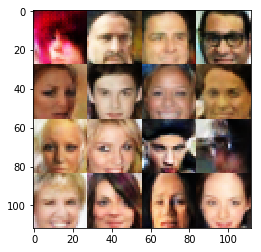

Epochs 52510/60000 Batch Step 1870/3166 gen_loss = -0.06087830662727356..., disc_loss = -0.552586019039154..., train using time = 11.517
Epochs 52520/60000 Batch Step 1880/3166 gen_loss = 1.778523564338684..., disc_loss = -0.24252212047576904..., train using time = 11.595
Epochs 52530/60000 Batch Step 1890/3166 gen_loss = -0.09505441784858704..., disc_loss = -0.3422609865665436..., train using time = 11.588
Epochs 52540/60000 Batch Step 1900/3166 gen_loss = -0.6577720642089844..., disc_loss = -0.2997181713581085..., train using time = 11.575
Epochs 52550/60000 Batch Step 1910/3166 gen_loss = -0.4682573080062866..., disc_loss = -0.3988190293312073..., train using time = 12.091
Epochs 52560/60000 Batch Step 1920/3166 gen_loss = -0.49805623292922974..., disc_loss = -0.30654507875442505..., train using time = 13.104
Epochs 52570/60000 Batch Step 1930/3166 gen_loss = 0.8948974609375..., disc_loss = -0.3614272177219391..., train using time = 11.829
Epochs 52580/60000 Batch Step 1940/3166 gen

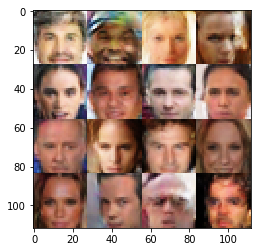

Epochs 52610/60000 Batch Step 1970/3166 gen_loss = 0.49920427799224854..., disc_loss = -0.4430069029331207..., train using time = 11.674
Epochs 52620/60000 Batch Step 1980/3166 gen_loss = -0.8031981587409973..., disc_loss = -0.36521247029304504..., train using time = 11.620
Epochs 52630/60000 Batch Step 1990/3166 gen_loss = 1.047722339630127..., disc_loss = -0.27295535802841187..., train using time = 11.686
Epochs 52640/60000 Batch Step 2000/3166 gen_loss = 0.5554825067520142..., disc_loss = -0.38480421900749207..., train using time = 11.564
Epochs 52650/60000 Batch Step 2010/3166 gen_loss = -1.281845211982727..., disc_loss = -0.3311190605163574..., train using time = 11.842
Epochs 52660/60000 Batch Step 2020/3166 gen_loss = -0.05850359797477722..., disc_loss = -0.3015163242816925..., train using time = 11.659
Epochs 52670/60000 Batch Step 2030/3166 gen_loss = -1.9672648906707764..., disc_loss = -0.30742931365966797..., train using time = 11.586
Epochs 52680/60000 Batch Step 2040/3166 

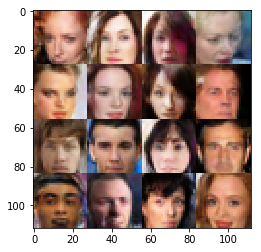

Epochs 52710/60000 Batch Step 2070/3166 gen_loss = 1.3342065811157227..., disc_loss = -0.47902712225914..., train using time = 11.583
Epochs 52720/60000 Batch Step 2080/3166 gen_loss = -0.286444753408432..., disc_loss = -0.4356917440891266..., train using time = 11.530
Epochs 52730/60000 Batch Step 2090/3166 gen_loss = -0.47691547870635986..., disc_loss = -0.4996064603328705..., train using time = 12.148
Epochs 52740/60000 Batch Step 2100/3166 gen_loss = -0.09030131995677948..., disc_loss = -0.19148950278759003..., train using time = 11.533
Epochs 52750/60000 Batch Step 2110/3166 gen_loss = 0.27011361718177795..., disc_loss = -0.33939066529273987..., train using time = 11.621
Epochs 52760/60000 Batch Step 2120/3166 gen_loss = 1.4360085725784302..., disc_loss = -0.2924216687679291..., train using time = 11.525
Epochs 52770/60000 Batch Step 2130/3166 gen_loss = -0.5770059823989868..., disc_loss = -0.3832550644874573..., train using time = 11.472
Epochs 52780/60000 Batch Step 2140/3166 ge

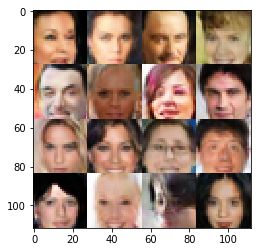

Epochs 52810/60000 Batch Step 2170/3166 gen_loss = 0.9515438079833984..., disc_loss = -0.5658143758773804..., train using time = 11.405
Epochs 52820/60000 Batch Step 2180/3166 gen_loss = 0.8781630992889404..., disc_loss = -0.4561516344547272..., train using time = 11.519
Epochs 52830/60000 Batch Step 2190/3166 gen_loss = 2.76613712310791..., disc_loss = -0.3056490123271942..., train using time = 11.571
Epochs 52840/60000 Batch Step 2200/3166 gen_loss = 0.9501049518585205..., disc_loss = -0.41122159361839294..., train using time = 11.634
Epochs 52850/60000 Batch Step 2210/3166 gen_loss = 0.45797836780548096..., disc_loss = -0.3352039158344269..., train using time = 11.666
Epochs 52860/60000 Batch Step 2220/3166 gen_loss = -0.4370938539505005..., disc_loss = -0.460066556930542..., train using time = 11.613
Epochs 52870/60000 Batch Step 2230/3166 gen_loss = -0.235775426030159..., disc_loss = -0.387767493724823..., train using time = 12.182
Epochs 52880/60000 Batch Step 2240/3166 gen_loss 

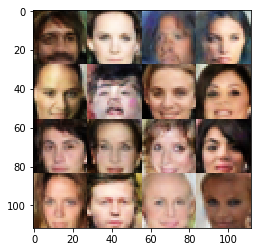

Epochs 52910/60000 Batch Step 2270/3166 gen_loss = -2.030837059020996..., disc_loss = -0.3202226758003235..., train using time = 11.670
Epochs 52920/60000 Batch Step 2280/3166 gen_loss = 0.14997799694538116..., disc_loss = -0.3080767095088959..., train using time = 11.549
Epochs 52930/60000 Batch Step 2290/3166 gen_loss = -0.04215453565120697..., disc_loss = -0.33913660049438477..., train using time = 11.477
Epochs 52940/60000 Batch Step 2300/3166 gen_loss = 0.2909170985221863..., disc_loss = -0.38769766688346863..., train using time = 11.550
Epochs 52950/60000 Batch Step 2310/3166 gen_loss = -0.5588669776916504..., disc_loss = -0.3214404582977295..., train using time = 11.523
Epochs 52960/60000 Batch Step 2320/3166 gen_loss = -0.5528905987739563..., disc_loss = -0.3437131345272064..., train using time = 11.530
Epochs 52970/60000 Batch Step 2330/3166 gen_loss = 0.42311468720436096..., disc_loss = -0.3530779182910919..., train using time = 11.633
Epochs 52980/60000 Batch Step 2340/3166 

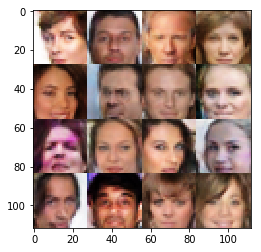

Epochs 53010/60000 Batch Step 2370/3166 gen_loss = 0.2479950189590454..., disc_loss = -0.31539687514305115..., train using time = 11.503
Epochs 53020/60000 Batch Step 2380/3166 gen_loss = -0.23335173726081848..., disc_loss = -0.32605481147766113..., train using time = 11.595
Epochs 53030/60000 Batch Step 2390/3166 gen_loss = 0.9081986546516418..., disc_loss = -0.3708881437778473..., train using time = 11.674
Epochs 53040/60000 Batch Step 2400/3166 gen_loss = 0.22975242137908936..., disc_loss = -0.4444407820701599..., train using time = 12.072
Epochs 53050/60000 Batch Step 2410/3166 gen_loss = -0.8151125907897949..., disc_loss = -0.40764927864074707..., train using time = 11.565
Epochs 53060/60000 Batch Step 2420/3166 gen_loss = 0.15327095985412598..., disc_loss = -0.36711469292640686..., train using time = 11.625
Epochs 53070/60000 Batch Step 2430/3166 gen_loss = 0.8902437090873718..., disc_loss = -0.5362223386764526..., train using time = 11.597
Epochs 53080/60000 Batch Step 2440/3166

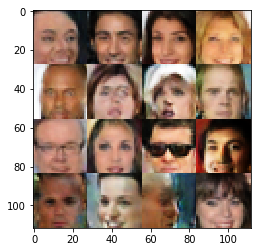

Epochs 53110/60000 Batch Step 2470/3166 gen_loss = -3.6862263679504395..., disc_loss = -0.1842779815196991..., train using time = 11.607
Epochs 53120/60000 Batch Step 2480/3166 gen_loss = -4.199962139129639..., disc_loss = -0.17161057889461517..., train using time = 11.579
Epochs 53130/60000 Batch Step 2490/3166 gen_loss = 0.4622051417827606..., disc_loss = -0.42654165625572205..., train using time = 11.654
Epochs 53140/60000 Batch Step 2500/3166 gen_loss = 0.0922931432723999..., disc_loss = -0.3204785883426666..., train using time = 11.699
Epochs 53150/60000 Batch Step 2510/3166 gen_loss = 0.17030078172683716..., disc_loss = -0.46603721380233765..., train using time = 11.606
Epochs 53160/60000 Batch Step 2520/3166 gen_loss = -1.5670262575149536..., disc_loss = -0.2904741168022156..., train using time = 11.697
Epochs 53170/60000 Batch Step 2530/3166 gen_loss = -1.3081423044204712..., disc_loss = -0.3040148615837097..., train using time = 11.597
Epochs 53180/60000 Batch Step 2540/3166 g

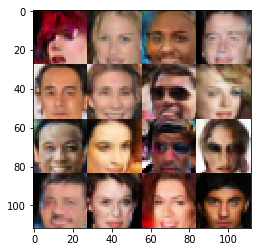

Epochs 53210/60000 Batch Step 2570/3166 gen_loss = -1.3673259019851685..., disc_loss = -0.2643851339817047..., train using time = 11.437
Epochs 53220/60000 Batch Step 2580/3166 gen_loss = -1.7433606386184692..., disc_loss = -0.3892649710178375..., train using time = 11.511
Epochs 53230/60000 Batch Step 2590/3166 gen_loss = 0.850522518157959..., disc_loss = -0.3266829252243042..., train using time = 11.577
Epochs 53240/60000 Batch Step 2600/3166 gen_loss = 0.144023597240448..., disc_loss = -0.4219356179237366..., train using time = 11.801
Epochs 53250/60000 Batch Step 2610/3166 gen_loss = 0.20896945893764496..., disc_loss = -0.443650484085083..., train using time = 11.601
Epochs 53260/60000 Batch Step 2620/3166 gen_loss = 0.5803204774856567..., disc_loss = -0.33160725235939026..., train using time = 11.607
Epochs 53270/60000 Batch Step 2630/3166 gen_loss = 0.28790509700775146..., disc_loss = -0.3850882053375244..., train using time = 11.559
Epochs 53280/60000 Batch Step 2640/3166 gen_lo

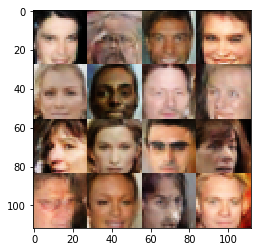

Epochs 53310/60000 Batch Step 2670/3166 gen_loss = 1.2515854835510254..., disc_loss = -0.3429419994354248..., train using time = 11.569
Epochs 53320/60000 Batch Step 2680/3166 gen_loss = 1.021500825881958..., disc_loss = -0.38698941469192505..., train using time = 11.605
Epochs 53330/60000 Batch Step 2690/3166 gen_loss = -1.6431641578674316..., disc_loss = -0.2195030152797699..., train using time = 11.613
Epochs 53340/60000 Batch Step 2700/3166 gen_loss = 0.9120385646820068..., disc_loss = -0.2957707643508911..., train using time = 11.669
Epochs 53350/60000 Batch Step 2710/3166 gen_loss = 0.7633574604988098..., disc_loss = -0.33469921350479126..., train using time = 11.660
Epochs 53360/60000 Batch Step 2720/3166 gen_loss = 0.19115878641605377..., disc_loss = -0.32519713044166565..., train using time = 11.520
Epochs 53370/60000 Batch Step 2730/3166 gen_loss = 0.2872675657272339..., disc_loss = -0.3851472735404968..., train using time = 11.632
Epochs 53380/60000 Batch Step 2740/3166 gen_

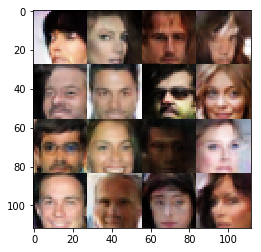

Epochs 53410/60000 Batch Step 2770/3166 gen_loss = 0.7454222440719604..., disc_loss = -0.3787417411804199..., train using time = 11.581
Epochs 53420/60000 Batch Step 2780/3166 gen_loss = -1.1437699794769287..., disc_loss = -0.48609548807144165..., train using time = 11.572
Epochs 53430/60000 Batch Step 2790/3166 gen_loss = 0.4544690251350403..., disc_loss = -0.41820573806762695..., train using time = 11.541
Epochs 53440/60000 Batch Step 2800/3166 gen_loss = 1.3607439994812012..., disc_loss = -0.4265620708465576..., train using time = 11.725
Epochs 53450/60000 Batch Step 2810/3166 gen_loss = 0.10876241326332092..., disc_loss = -0.3278924524784088..., train using time = 11.736
Epochs 53460/60000 Batch Step 2820/3166 gen_loss = -0.052970923483371735..., disc_loss = -0.4826853275299072..., train using time = 11.737
Epochs 53470/60000 Batch Step 2830/3166 gen_loss = -1.2966704368591309..., disc_loss = -0.32371896505355835..., train using time = 11.680
Epochs 53480/60000 Batch Step 2840/3166

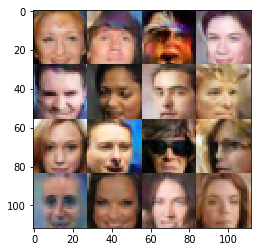

Epochs 53510/60000 Batch Step 2870/3166 gen_loss = -1.2390916347503662..., disc_loss = -0.398796021938324..., train using time = 11.652
Epochs 53520/60000 Batch Step 2880/3166 gen_loss = -0.7066818475723267..., disc_loss = -0.31728893518447876..., train using time = 11.595
Epochs 53530/60000 Batch Step 2890/3166 gen_loss = 0.19473539292812347..., disc_loss = -0.477763831615448..., train using time = 11.611
Epochs 53540/60000 Batch Step 2900/3166 gen_loss = 0.14878663420677185..., disc_loss = -0.37068814039230347..., train using time = 11.673
Epochs 53550/60000 Batch Step 2910/3166 gen_loss = 0.3637884557247162..., disc_loss = -0.2698362469673157..., train using time = 11.674
Epochs 53560/60000 Batch Step 2920/3166 gen_loss = 0.7808619737625122..., disc_loss = -0.3216007649898529..., train using time = 11.676
Epochs 53570/60000 Batch Step 2930/3166 gen_loss = -0.03894088789820671..., disc_loss = -0.3710375428199768..., train using time = 12.492
Epochs 53580/60000 Batch Step 2940/3166 ge

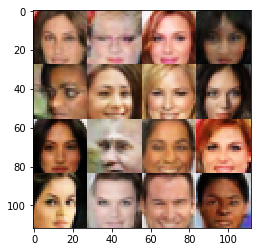

Epochs 53610/60000 Batch Step 2970/3166 gen_loss = -0.6772856116294861..., disc_loss = -0.31090211868286133..., train using time = 11.670
Epochs 53620/60000 Batch Step 2980/3166 gen_loss = 0.9740334749221802..., disc_loss = -0.36555513739585876..., train using time = 11.528
Epochs 53630/60000 Batch Step 2990/3166 gen_loss = 0.38596367835998535..., disc_loss = -0.4705757200717926..., train using time = 11.571
Epochs 53640/60000 Batch Step 3000/3166 gen_loss = 0.8076815009117126..., disc_loss = -0.358894407749176..., train using time = 11.616
Epochs 53650/60000 Batch Step 3010/3166 gen_loss = -2.451753616333008..., disc_loss = -0.22146353125572205..., train using time = 11.604
Epochs 53660/60000 Batch Step 3020/3166 gen_loss = -1.1371479034423828..., disc_loss = -0.3909858763217926..., train using time = 11.674
Epochs 53670/60000 Batch Step 3030/3166 gen_loss = -0.08298346400260925..., disc_loss = -0.3652188181877136..., train using time = 11.580
Epochs 53680/60000 Batch Step 3040/3166 g

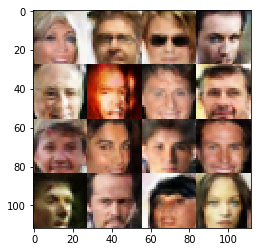

Epochs 53710/60000 Batch Step 3070/3166 gen_loss = 0.2619878351688385..., disc_loss = -0.35173463821411133..., train using time = 11.591
Epochs 53720/60000 Batch Step 3080/3166 gen_loss = 0.10874435305595398..., disc_loss = -0.4817284941673279..., train using time = 11.574
Epochs 53730/60000 Batch Step 3090/3166 gen_loss = -0.26687896251678467..., disc_loss = -0.4973745346069336..., train using time = 11.582
Epochs 53740/60000 Batch Step 3100/3166 gen_loss = -1.775314450263977..., disc_loss = -0.4217398762702942..., train using time = 11.553
Epochs 53750/60000 Batch Step 3110/3166 gen_loss = 0.43804630637168884..., disc_loss = -0.35631227493286133..., train using time = 11.602
Epochs 53760/60000 Batch Step 3120/3166 gen_loss = -0.16828316450119019..., disc_loss = -0.26805293560028076..., train using time = 11.651
Epochs 53770/60000 Batch Step 3130/3166 gen_loss = 0.23959273099899292..., disc_loss = -0.4892410337924957..., train using time = 11.524
Epochs 53780/60000 Batch Step 3140/316

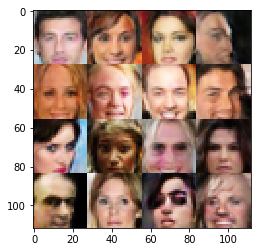

Epochs 53810/60000 Batch Step 5/3166 gen_loss = 0.7416027784347534..., disc_loss = -0.3021309971809387..., train using time = 11.626
Epochs 53820/60000 Batch Step 15/3166 gen_loss = -0.18377548456192017..., disc_loss = -0.32644686102867126..., train using time = 11.766
Epochs 53830/60000 Batch Step 25/3166 gen_loss = 0.5689351558685303..., disc_loss = -0.355430543422699..., train using time = 11.710
Epochs 53840/60000 Batch Step 35/3166 gen_loss = -0.5302866101264954..., disc_loss = -0.6334823966026306..., train using time = 11.618
Epochs 53850/60000 Batch Step 45/3166 gen_loss = -0.8574369549751282..., disc_loss = -0.41684770584106445..., train using time = 11.664
Epochs 53860/60000 Batch Step 55/3166 gen_loss = -0.24289244413375854..., disc_loss = -0.357347697019577..., train using time = 11.651
Epochs 53870/60000 Batch Step 65/3166 gen_loss = 0.6695619821548462..., disc_loss = -0.296417236328125..., train using time = 11.581
Epochs 53880/60000 Batch Step 75/3166 gen_loss = 0.1715973

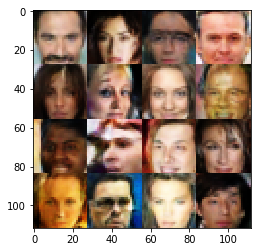

Epochs 53910/60000 Batch Step 105/3166 gen_loss = -0.5820631980895996..., disc_loss = -0.3166143000125885..., train using time = 11.585
Epochs 53920/60000 Batch Step 115/3166 gen_loss = 0.03857138752937317..., disc_loss = -0.30150657892227173..., train using time = 12.267
Epochs 53930/60000 Batch Step 125/3166 gen_loss = 1.0287202596664429..., disc_loss = -0.2389266937971115..., train using time = 11.624
Epochs 53940/60000 Batch Step 135/3166 gen_loss = 0.08687100559473038..., disc_loss = -0.36768442392349243..., train using time = 11.758
Epochs 53950/60000 Batch Step 145/3166 gen_loss = -0.15218521654605865..., disc_loss = -0.35017383098602295..., train using time = 11.626
Epochs 53960/60000 Batch Step 155/3166 gen_loss = 0.04919733479619026..., disc_loss = -0.43274110555648804..., train using time = 11.575
Epochs 53970/60000 Batch Step 165/3166 gen_loss = -1.1688193082809448..., disc_loss = -0.44140663743019104..., train using time = 11.593
Epochs 53980/60000 Batch Step 175/3166 gen_

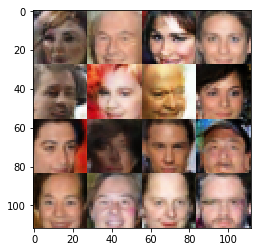

Epochs 54010/60000 Batch Step 205/3166 gen_loss = -0.9193077087402344..., disc_loss = -0.3175523281097412..., train using time = 11.652
Epochs 54020/60000 Batch Step 215/3166 gen_loss = 0.0546475350856781..., disc_loss = -0.43778857588768005..., train using time = 11.710
Epochs 54030/60000 Batch Step 225/3166 gen_loss = -2.3788788318634033..., disc_loss = -0.15510067343711853..., train using time = 11.593
Epochs 54040/60000 Batch Step 235/3166 gen_loss = 2.5864274501800537..., disc_loss = -0.40875300765037537..., train using time = 11.647
Epochs 54050/60000 Batch Step 245/3166 gen_loss = -2.2214882373809814..., disc_loss = -0.3035591244697571..., train using time = 11.627
Epochs 54060/60000 Batch Step 255/3166 gen_loss = 0.1323370486497879..., disc_loss = -0.4524766802787781..., train using time = 11.633
Epochs 54070/60000 Batch Step 265/3166 gen_loss = 1.1847712993621826..., disc_loss = -0.35854512453079224..., train using time = 11.575
Epochs 54080/60000 Batch Step 275/3166 gen_loss 

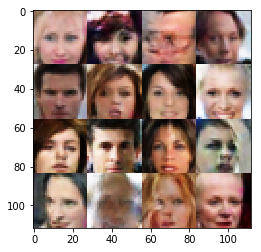

Epochs 54110/60000 Batch Step 305/3166 gen_loss = -0.7145965099334717..., disc_loss = -0.34623855352401733..., train using time = 11.631
Epochs 54120/60000 Batch Step 315/3166 gen_loss = 1.2717477083206177..., disc_loss = -0.27660050988197327..., train using time = 12.493
Epochs 54130/60000 Batch Step 325/3166 gen_loss = 0.8129207491874695..., disc_loss = -0.36133140325546265..., train using time = 11.631
Epochs 54140/60000 Batch Step 335/3166 gen_loss = 0.0875881239771843..., disc_loss = -0.4315366744995117..., train using time = 11.597
Epochs 54150/60000 Batch Step 345/3166 gen_loss = 0.20287898182868958..., disc_loss = -0.33145731687545776..., train using time = 11.617
Epochs 54160/60000 Batch Step 355/3166 gen_loss = 0.6289381384849548..., disc_loss = -0.24604745209217072..., train using time = 11.537
Epochs 54170/60000 Batch Step 365/3166 gen_loss = 0.1693204790353775..., disc_loss = -0.24307969212532043..., train using time = 11.644
Epochs 54180/60000 Batch Step 375/3166 gen_loss

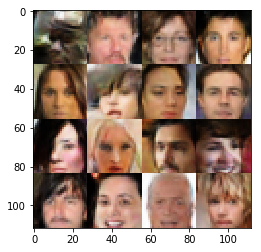

Epochs 54210/60000 Batch Step 405/3166 gen_loss = 0.34479230642318726..., disc_loss = -0.3609888255596161..., train using time = 11.652
Epochs 54220/60000 Batch Step 415/3166 gen_loss = -0.5344886779785156..., disc_loss = -0.26726001501083374..., train using time = 11.656
Epochs 54230/60000 Batch Step 425/3166 gen_loss = 0.5720295310020447..., disc_loss = -0.36891207098960876..., train using time = 11.646
Epochs 54240/60000 Batch Step 435/3166 gen_loss = 1.7365044355392456..., disc_loss = -0.4243876039981842..., train using time = 11.548
Epochs 54250/60000 Batch Step 445/3166 gen_loss = 0.5966429710388184..., disc_loss = -0.43153491616249084..., train using time = 11.582
Epochs 54260/60000 Batch Step 455/3166 gen_loss = -0.5466148853302002..., disc_loss = -0.3113451898097992..., train using time = 11.613
Epochs 54270/60000 Batch Step 465/3166 gen_loss = -1.2740801572799683..., disc_loss = -0.3391798436641693..., train using time = 11.629
Epochs 54280/60000 Batch Step 475/3166 gen_loss 

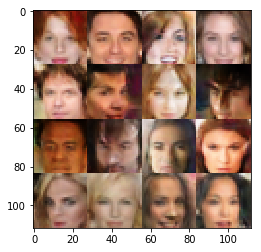

Epochs 54310/60000 Batch Step 505/3166 gen_loss = 0.7022366523742676..., disc_loss = -0.4191966950893402..., train using time = 11.769
Epochs 54320/60000 Batch Step 515/3166 gen_loss = -0.29106560349464417..., disc_loss = -0.37914395332336426..., train using time = 11.660
Epochs 54330/60000 Batch Step 525/3166 gen_loss = 0.5345265865325928..., disc_loss = -0.4021313190460205..., train using time = 11.643
Epochs 54340/60000 Batch Step 535/3166 gen_loss = -1.272547960281372..., disc_loss = -0.4137783944606781..., train using time = 11.633
Epochs 54350/60000 Batch Step 545/3166 gen_loss = -0.03968704119324684..., disc_loss = -0.31800389289855957..., train using time = 11.594
Epochs 54360/60000 Batch Step 555/3166 gen_loss = -1.2409133911132812..., disc_loss = -0.7673381567001343..., train using time = 11.545
Epochs 54370/60000 Batch Step 565/3166 gen_loss = -1.3535584211349487..., disc_loss = -0.18211376667022705..., train using time = 11.584
Epochs 54380/60000 Batch Step 575/3166 gen_los

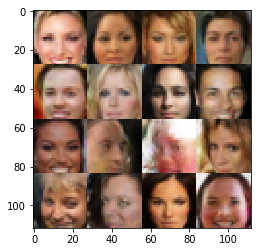

Epochs 54410/60000 Batch Step 605/3166 gen_loss = -0.008432019501924515..., disc_loss = -0.3616771697998047..., train using time = 11.692
Epochs 54420/60000 Batch Step 615/3166 gen_loss = -0.44208306074142456..., disc_loss = -0.32319968938827515..., train using time = 11.568
Epochs 54430/60000 Batch Step 625/3166 gen_loss = 2.003383159637451..., disc_loss = -0.2291398048400879..., train using time = 11.484
Epochs 54440/60000 Batch Step 635/3166 gen_loss = -1.5036094188690186..., disc_loss = -0.46489983797073364..., train using time = 11.659
Epochs 54450/60000 Batch Step 645/3166 gen_loss = 0.7169981002807617..., disc_loss = -0.33751046657562256..., train using time = 11.627
Epochs 54460/60000 Batch Step 655/3166 gen_loss = 0.32794713973999023..., disc_loss = -0.4623587727546692..., train using time = 11.711
Epochs 54470/60000 Batch Step 665/3166 gen_loss = -0.3956491947174072..., disc_loss = -0.2475617229938507..., train using time = 11.607
Epochs 54480/60000 Batch Step 675/3166 gen_lo

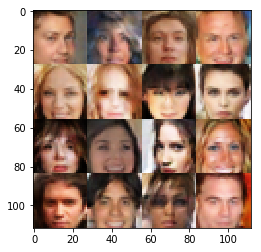

Epochs 54510/60000 Batch Step 705/3166 gen_loss = -0.5739881992340088..., disc_loss = -0.3294738233089447..., train using time = 11.572
Epochs 54520/60000 Batch Step 715/3166 gen_loss = -1.323779821395874..., disc_loss = -0.3318345546722412..., train using time = 11.666
Epochs 54530/60000 Batch Step 725/3166 gen_loss = 0.8118534088134766..., disc_loss = -0.3238961100578308..., train using time = 11.600
Epochs 54540/60000 Batch Step 735/3166 gen_loss = -1.4947264194488525..., disc_loss = -0.27603384852409363..., train using time = 11.588
Epochs 54550/60000 Batch Step 745/3166 gen_loss = 0.850328803062439..., disc_loss = -0.27457767724990845..., train using time = 11.649
Epochs 54560/60000 Batch Step 755/3166 gen_loss = -0.17046993970870972..., disc_loss = -0.3918604850769043..., train using time = 11.654
Epochs 54570/60000 Batch Step 765/3166 gen_loss = 1.1954021453857422..., disc_loss = -0.3768082559108734..., train using time = 11.671
Epochs 54580/60000 Batch Step 775/3166 gen_loss = 

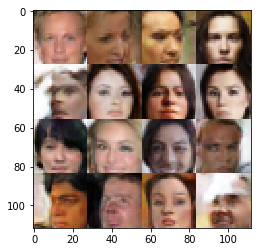

Epochs 54610/60000 Batch Step 805/3166 gen_loss = 0.07823501527309418..., disc_loss = -0.39145341515541077..., train using time = 11.660
Epochs 54620/60000 Batch Step 815/3166 gen_loss = -0.7834006547927856..., disc_loss = -0.32431626319885254..., train using time = 11.546
Epochs 54630/60000 Batch Step 825/3166 gen_loss = 0.7711578607559204..., disc_loss = -0.28485387563705444..., train using time = 11.617
Epochs 54640/60000 Batch Step 835/3166 gen_loss = 0.4549277126789093..., disc_loss = -0.278959721326828..., train using time = 11.693
Epochs 54650/60000 Batch Step 845/3166 gen_loss = -0.5040439963340759..., disc_loss = -0.33505892753601074..., train using time = 11.672
Epochs 54660/60000 Batch Step 855/3166 gen_loss = -0.1843472719192505..., disc_loss = -0.2939223647117615..., train using time = 12.650
Epochs 54670/60000 Batch Step 865/3166 gen_loss = 0.0821380615234375..., disc_loss = -0.3038948178291321..., train using time = 11.644
Epochs 54680/60000 Batch Step 875/3166 gen_loss 

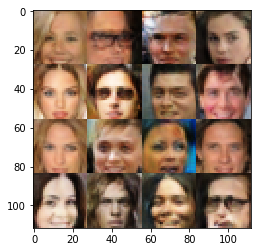

Epochs 54710/60000 Batch Step 905/3166 gen_loss = 0.8806754946708679..., disc_loss = -0.35104233026504517..., train using time = 11.610
Epochs 54720/60000 Batch Step 915/3166 gen_loss = -0.19572344422340393..., disc_loss = -0.21405771374702454..., train using time = 11.578
Epochs 54730/60000 Batch Step 925/3166 gen_loss = 0.022974621504545212..., disc_loss = -0.4016171991825104..., train using time = 11.595
Epochs 54740/60000 Batch Step 935/3166 gen_loss = 0.43623918294906616..., disc_loss = -0.35509610176086426..., train using time = 11.507
Epochs 54750/60000 Batch Step 945/3166 gen_loss = -0.7765893936157227..., disc_loss = -0.3133956789970398..., train using time = 12.121
Epochs 54760/60000 Batch Step 955/3166 gen_loss = 1.244707465171814..., disc_loss = -0.31681108474731445..., train using time = 11.836
Epochs 54770/60000 Batch Step 965/3166 gen_loss = -0.24705654382705688..., disc_loss = -0.4325680732727051..., train using time = 11.623
Epochs 54780/60000 Batch Step 975/3166 gen_l

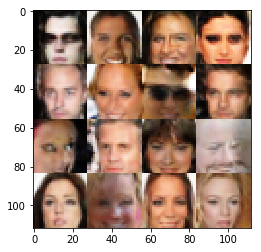

Epochs 54810/60000 Batch Step 1005/3166 gen_loss = -0.7389671802520752..., disc_loss = -0.3102623522281647..., train using time = 11.533
Epochs 54820/60000 Batch Step 1015/3166 gen_loss = 0.34351810812950134..., disc_loss = -0.404731810092926..., train using time = 11.616
Epochs 54830/60000 Batch Step 1025/3166 gen_loss = -1.3434078693389893..., disc_loss = -0.2533530592918396..., train using time = 11.601
Epochs 54840/60000 Batch Step 1035/3166 gen_loss = -0.050124190747737885..., disc_loss = -0.36631491780281067..., train using time = 11.659
Epochs 54850/60000 Batch Step 1045/3166 gen_loss = -0.3893672823905945..., disc_loss = -0.36935240030288696..., train using time = 11.656
Epochs 54860/60000 Batch Step 1055/3166 gen_loss = 0.6169060468673706..., disc_loss = -0.3533370792865753..., train using time = 11.712
Epochs 54870/60000 Batch Step 1065/3166 gen_loss = -0.6865304112434387..., disc_loss = -0.3526194095611572..., train using time = 11.608
Epochs 54880/60000 Batch Step 1075/3166

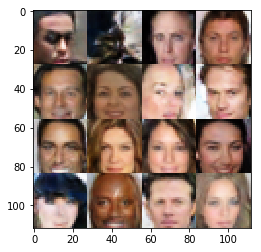

Epochs 54910/60000 Batch Step 1105/3166 gen_loss = -0.17428098618984222..., disc_loss = -0.3180012106895447..., train using time = 11.598
Epochs 54920/60000 Batch Step 1115/3166 gen_loss = -1.5934538841247559..., disc_loss = -0.33261266350746155..., train using time = 11.636
Epochs 54930/60000 Batch Step 1125/3166 gen_loss = 0.4890933632850647..., disc_loss = -0.4094066023826599..., train using time = 11.667
Epochs 54940/60000 Batch Step 1135/3166 gen_loss = -1.2819020748138428..., disc_loss = -0.1598576307296753..., train using time = 11.622
Epochs 54950/60000 Batch Step 1145/3166 gen_loss = -1.689422607421875..., disc_loss = -0.19572918117046356..., train using time = 11.673
Epochs 54960/60000 Batch Step 1155/3166 gen_loss = -0.09627515077590942..., disc_loss = -0.3549254834651947..., train using time = 11.700
Epochs 54970/60000 Batch Step 1165/3166 gen_loss = -1.2408373355865479..., disc_loss = -0.30990487337112427..., train using time = 11.631
Epochs 54980/60000 Batch Step 1175/316

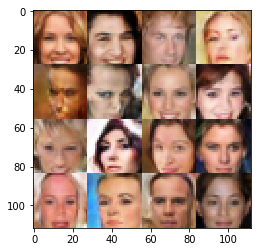

Epochs 55010/60000 Batch Step 1205/3166 gen_loss = 0.6958747506141663..., disc_loss = -0.47027474641799927..., train using time = 11.630
Epochs 55020/60000 Batch Step 1215/3166 gen_loss = 0.5488108992576599..., disc_loss = -0.44164127111434937..., train using time = 11.753
Epochs 55030/60000 Batch Step 1225/3166 gen_loss = 0.14012794196605682..., disc_loss = -0.369903564453125..., train using time = 12.238
Epochs 55040/60000 Batch Step 1235/3166 gen_loss = -0.9480603933334351..., disc_loss = -0.4291169047355652..., train using time = 11.635
Epochs 55050/60000 Batch Step 1245/3166 gen_loss = 1.2588157653808594..., disc_loss = -0.3730679750442505..., train using time = 11.669
Epochs 55060/60000 Batch Step 1255/3166 gen_loss = 1.3633391857147217..., disc_loss = -0.2631608247756958..., train using time = 11.742
Epochs 55070/60000 Batch Step 1265/3166 gen_loss = -1.9896106719970703..., disc_loss = -0.356803834438324..., train using time = 11.626
Epochs 55080/60000 Batch Step 1275/3166 gen_l

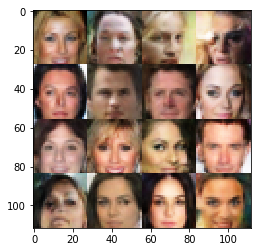

Epochs 55110/60000 Batch Step 1305/3166 gen_loss = -1.0789676904678345..., disc_loss = -0.3784518837928772..., train using time = 11.549
Epochs 55120/60000 Batch Step 1315/3166 gen_loss = 0.9639374613761902..., disc_loss = -0.418264776468277..., train using time = 11.641
Epochs 55130/60000 Batch Step 1325/3166 gen_loss = -0.41199785470962524..., disc_loss = -0.43857985734939575..., train using time = 11.746
Epochs 55140/60000 Batch Step 1335/3166 gen_loss = -0.9434441924095154..., disc_loss = -0.40566080808639526..., train using time = 11.639
Epochs 55150/60000 Batch Step 1345/3166 gen_loss = 0.22223269939422607..., disc_loss = -0.35371217131614685..., train using time = 11.661
Epochs 55160/60000 Batch Step 1355/3166 gen_loss = -0.9238128662109375..., disc_loss = -0.3676973283290863..., train using time = 11.651
Epochs 55170/60000 Batch Step 1365/3166 gen_loss = 0.52036052942276..., disc_loss = -0.32031893730163574..., train using time = 11.599
Epochs 55180/60000 Batch Step 1375/3166 g

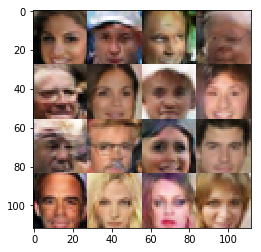

Epochs 55210/60000 Batch Step 1405/3166 gen_loss = 1.1682744026184082..., disc_loss = -0.40786367654800415..., train using time = 11.662
Epochs 55220/60000 Batch Step 1415/3166 gen_loss = 0.43237125873565674..., disc_loss = -0.42219358682632446..., train using time = 11.600
Epochs 55230/60000 Batch Step 1425/3166 gen_loss = 0.738966703414917..., disc_loss = -0.42669200897216797..., train using time = 11.729
Epochs 55240/60000 Batch Step 1435/3166 gen_loss = -0.35670092701911926..., disc_loss = -0.49267062544822693..., train using time = 11.791
Epochs 55250/60000 Batch Step 1445/3166 gen_loss = 0.4878503978252411..., disc_loss = -0.26165246963500977..., train using time = 11.615
Epochs 55260/60000 Batch Step 1455/3166 gen_loss = -0.1600029617547989..., disc_loss = -0.24099285900592804..., train using time = 11.626
Epochs 55270/60000 Batch Step 1465/3166 gen_loss = -0.8822727203369141..., disc_loss = -0.4943389892578125..., train using time = 11.514
Epochs 55280/60000 Batch Step 1475/316

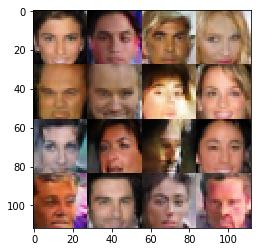

Epochs 55310/60000 Batch Step 1505/3166 gen_loss = 0.04222755879163742..., disc_loss = -0.31184086203575134..., train using time = 11.674
Epochs 55320/60000 Batch Step 1515/3166 gen_loss = -0.532649040222168..., disc_loss = -0.2817372679710388..., train using time = 11.610
Epochs 55330/60000 Batch Step 1525/3166 gen_loss = 0.0013061445206403732..., disc_loss = -0.5504773855209351..., train using time = 11.616
Epochs 55340/60000 Batch Step 1535/3166 gen_loss = -0.7999371290206909..., disc_loss = -0.4160889685153961..., train using time = 11.726
Epochs 55350/60000 Batch Step 1545/3166 gen_loss = 0.08053208887577057..., disc_loss = -0.6014540791511536..., train using time = 11.615
Epochs 55360/60000 Batch Step 1555/3166 gen_loss = -1.3880958557128906..., disc_loss = -0.38968855142593384..., train using time = 11.558
Epochs 55370/60000 Batch Step 1565/3166 gen_loss = -1.186140775680542..., disc_loss = -0.4081682562828064..., train using time = 11.588
Epochs 55380/60000 Batch Step 1575/3166

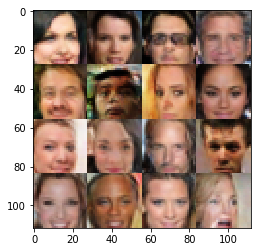

Epochs 55410/60000 Batch Step 1605/3166 gen_loss = -0.29930466413497925..., disc_loss = -0.4761269688606262..., train using time = 11.589
Epochs 55420/60000 Batch Step 1615/3166 gen_loss = -1.7478477954864502..., disc_loss = -0.3227218985557556..., train using time = 11.813
Epochs 55430/60000 Batch Step 1625/3166 gen_loss = 0.6147157549858093..., disc_loss = -0.4534294009208679..., train using time = 12.010
Epochs 55440/60000 Batch Step 1635/3166 gen_loss = 2.135213851928711..., disc_loss = -0.3935743570327759..., train using time = 11.620
Epochs 55450/60000 Batch Step 1645/3166 gen_loss = -0.31925806403160095..., disc_loss = -0.3560723066329956..., train using time = 11.597
Epochs 55460/60000 Batch Step 1655/3166 gen_loss = 0.14476752281188965..., disc_loss = -0.41816821694374084..., train using time = 11.568
Epochs 55470/60000 Batch Step 1665/3166 gen_loss = -0.46487340331077576..., disc_loss = -0.336312472820282..., train using time = 11.822
Epochs 55480/60000 Batch Step 1675/3166 g

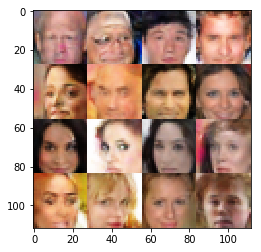

Epochs 55510/60000 Batch Step 1705/3166 gen_loss = -1.0565117597579956..., disc_loss = -0.352656751871109..., train using time = 11.697
Epochs 55520/60000 Batch Step 1715/3166 gen_loss = 1.0486140251159668..., disc_loss = -0.4625360369682312..., train using time = 11.638
Epochs 55530/60000 Batch Step 1725/3166 gen_loss = 0.42617982625961304..., disc_loss = -0.3354351818561554..., train using time = 11.631
Epochs 55540/60000 Batch Step 1735/3166 gen_loss = 0.9409552812576294..., disc_loss = -0.36810702085494995..., train using time = 11.575
Epochs 55550/60000 Batch Step 1745/3166 gen_loss = -0.30905961990356445..., disc_loss = -0.4422672390937805..., train using time = 11.657
Epochs 55560/60000 Batch Step 1755/3166 gen_loss = -0.6972358226776123..., disc_loss = -0.31314587593078613..., train using time = 11.673
Epochs 55570/60000 Batch Step 1765/3166 gen_loss = -0.3788194954395294..., disc_loss = -0.3731882572174072..., train using time = 11.521
Epochs 55580/60000 Batch Step 1775/3166 g

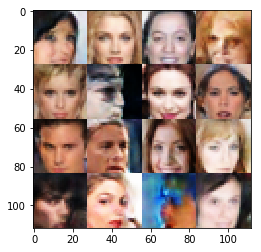

Epochs 55610/60000 Batch Step 1805/3166 gen_loss = -0.11769862473011017..., disc_loss = -0.370522677898407..., train using time = 11.611
Epochs 55620/60000 Batch Step 1815/3166 gen_loss = 0.569819986820221..., disc_loss = -0.4854479730129242..., train using time = 11.603
Epochs 55630/60000 Batch Step 1825/3166 gen_loss = -0.6402801275253296..., disc_loss = -0.28441256284713745..., train using time = 11.694
Epochs 55640/60000 Batch Step 1835/3166 gen_loss = -0.0943688154220581..., disc_loss = -0.3311666250228882..., train using time = 11.713
Epochs 55650/60000 Batch Step 1845/3166 gen_loss = 0.3750559687614441..., disc_loss = -0.49671268463134766..., train using time = 11.725
Epochs 55660/60000 Batch Step 1855/3166 gen_loss = -0.056722432374954224..., disc_loss = -0.3865129351615906..., train using time = 11.822
Epochs 55670/60000 Batch Step 1865/3166 gen_loss = 0.9814193844795227..., disc_loss = -0.37562015652656555..., train using time = 11.651
Epochs 55680/60000 Batch Step 1875/3166 

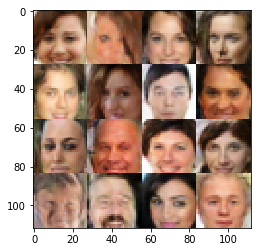

Epochs 55710/60000 Batch Step 1905/3166 gen_loss = -0.2821919918060303..., disc_loss = -0.33072948455810547..., train using time = 11.766
Epochs 55720/60000 Batch Step 1915/3166 gen_loss = -1.1224274635314941..., disc_loss = -0.2904564440250397..., train using time = 11.746
Epochs 55730/60000 Batch Step 1925/3166 gen_loss = -0.4428139626979828..., disc_loss = -0.3227340579032898..., train using time = 11.671
Epochs 55740/60000 Batch Step 1935/3166 gen_loss = 1.709940791130066..., disc_loss = -0.28392013907432556..., train using time = 11.639
Epochs 55750/60000 Batch Step 1945/3166 gen_loss = -1.0479304790496826..., disc_loss = -0.4022069573402405..., train using time = 11.661
Epochs 55760/60000 Batch Step 1955/3166 gen_loss = -0.1743967980146408..., disc_loss = -0.2899807095527649..., train using time = 14.269
Epochs 55770/60000 Batch Step 1965/3166 gen_loss = 0.4775804281234741..., disc_loss = -0.38709136843681335..., train using time = 12.830
Epochs 55780/60000 Batch Step 1975/3166 g

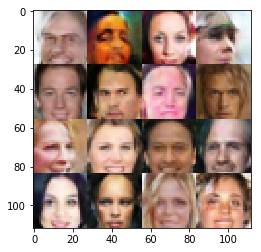

Epochs 55810/60000 Batch Step 2005/3166 gen_loss = -0.09850187599658966..., disc_loss = -0.281450480222702..., train using time = 11.871
Epochs 55820/60000 Batch Step 2015/3166 gen_loss = -0.18130137026309967..., disc_loss = -0.4371681213378906..., train using time = 12.295
Epochs 55830/60000 Batch Step 2025/3166 gen_loss = 0.25779029726982117..., disc_loss = -0.4951663911342621..., train using time = 11.747
Epochs 55840/60000 Batch Step 2035/3166 gen_loss = 0.8214502334594727..., disc_loss = -0.5288122892379761..., train using time = 11.876
Epochs 55850/60000 Batch Step 2045/3166 gen_loss = 0.21514928340911865..., disc_loss = -0.45677027106285095..., train using time = 11.617
Epochs 55860/60000 Batch Step 2055/3166 gen_loss = 1.5606582164764404..., disc_loss = -0.2752024233341217..., train using time = 11.662
Epochs 55870/60000 Batch Step 2065/3166 gen_loss = 0.8808122873306274..., disc_loss = -0.45877280831336975..., train using time = 11.690
Epochs 55880/60000 Batch Step 2075/3166 g

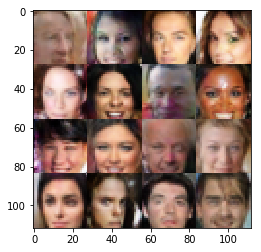

Epochs 55910/60000 Batch Step 2105/3166 gen_loss = 1.5289626121520996..., disc_loss = -0.4045325815677643..., train using time = 11.707
Epochs 55920/60000 Batch Step 2115/3166 gen_loss = -1.1507773399353027..., disc_loss = -0.3909834325313568..., train using time = 11.637
Epochs 55930/60000 Batch Step 2125/3166 gen_loss = 1.3782472610473633..., disc_loss = -0.4749247431755066..., train using time = 11.543
Epochs 55940/60000 Batch Step 2135/3166 gen_loss = 2.246187686920166..., disc_loss = -0.17584364116191864..., train using time = 11.694
Epochs 55950/60000 Batch Step 2145/3166 gen_loss = 0.3721763491630554..., disc_loss = -0.36523962020874023..., train using time = 11.692
Epochs 55960/60000 Batch Step 2155/3166 gen_loss = 1.3337723016738892..., disc_loss = -0.41726914048194885..., train using time = 11.549
Epochs 55970/60000 Batch Step 2165/3166 gen_loss = 0.9216554760932922..., disc_loss = -0.44619226455688477..., train using time = 11.530
Epochs 55980/60000 Batch Step 2175/3166 gen_

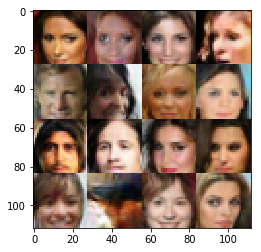

Epochs 56010/60000 Batch Step 2205/3166 gen_loss = 0.6007614731788635..., disc_loss = -0.2927553653717041..., train using time = 11.645
Epochs 56020/60000 Batch Step 2215/3166 gen_loss = 0.9425539970397949..., disc_loss = -0.3273664116859436..., train using time = 12.141
Epochs 56030/60000 Batch Step 2225/3166 gen_loss = -0.10265929996967316..., disc_loss = -0.328512966632843..., train using time = 11.674
Epochs 56040/60000 Batch Step 2235/3166 gen_loss = 0.059241414070129395..., disc_loss = -0.41479793190956116..., train using time = 11.724
Epochs 56050/60000 Batch Step 2245/3166 gen_loss = 1.682605504989624..., disc_loss = -0.3123350739479065..., train using time = 11.816
Epochs 56060/60000 Batch Step 2255/3166 gen_loss = 0.6559041738510132..., disc_loss = -0.4240671992301941..., train using time = 11.637
Epochs 56070/60000 Batch Step 2265/3166 gen_loss = 0.14491385221481323..., disc_loss = -0.3935388922691345..., train using time = 11.630
Epochs 56080/60000 Batch Step 2275/3166 gen_

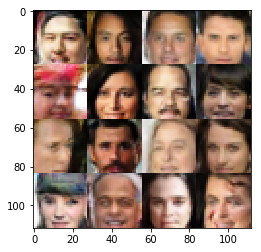

Epochs 56110/60000 Batch Step 2305/3166 gen_loss = 1.7995091676712036..., disc_loss = -0.3180737793445587..., train using time = 11.561
Epochs 56120/60000 Batch Step 2315/3166 gen_loss = 1.5549671649932861..., disc_loss = -0.2648718059062958..., train using time = 13.413
Epochs 56130/60000 Batch Step 2325/3166 gen_loss = 1.1667051315307617..., disc_loss = -0.274655282497406..., train using time = 11.583
Epochs 56140/60000 Batch Step 2335/3166 gen_loss = 2.1355953216552734..., disc_loss = -0.3787390887737274..., train using time = 11.615
Epochs 56150/60000 Batch Step 2345/3166 gen_loss = 0.47319504618644714..., disc_loss = -0.3796994090080261..., train using time = 11.726
Epochs 56160/60000 Batch Step 2355/3166 gen_loss = 1.1057416200637817..., disc_loss = -0.3785398602485657..., train using time = 11.765
Epochs 56170/60000 Batch Step 2365/3166 gen_loss = -1.5810441970825195..., disc_loss = -0.20129568874835968..., train using time = 11.538
Epochs 56180/60000 Batch Step 2375/3166 gen_lo

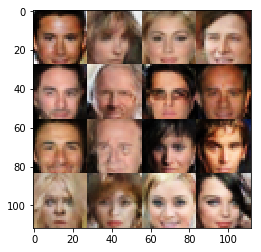

Epochs 56210/60000 Batch Step 2405/3166 gen_loss = 0.4086209535598755..., disc_loss = -0.3418940007686615..., train using time = 11.627
Epochs 56220/60000 Batch Step 2415/3166 gen_loss = 0.33842694759368896..., disc_loss = -0.43139371275901794..., train using time = 11.808
Epochs 56230/60000 Batch Step 2425/3166 gen_loss = 0.1350100040435791..., disc_loss = -0.3150343596935272..., train using time = 11.628
Epochs 56240/60000 Batch Step 2435/3166 gen_loss = -0.8650482892990112..., disc_loss = -0.2199409455060959..., train using time = 11.620
Epochs 56250/60000 Batch Step 2445/3166 gen_loss = 1.6630003452301025..., disc_loss = -0.3520877957344055..., train using time = 11.530
Epochs 56260/60000 Batch Step 2455/3166 gen_loss = 2.469285249710083..., disc_loss = -0.3149147927761078..., train using time = 11.582
Epochs 56270/60000 Batch Step 2465/3166 gen_loss = 0.6728924512863159..., disc_loss = -0.4373750686645508..., train using time = 11.564
Epochs 56280/60000 Batch Step 2475/3166 gen_lo

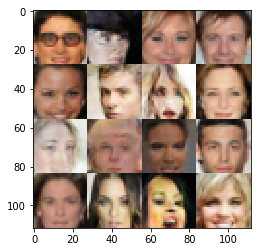

Epochs 56310/60000 Batch Step 2505/3166 gen_loss = 0.7876666784286499..., disc_loss = -0.3340609073638916..., train using time = 11.586
Epochs 56320/60000 Batch Step 2515/3166 gen_loss = 0.6589773297309875..., disc_loss = -0.1489262580871582..., train using time = 11.807
Epochs 56330/60000 Batch Step 2525/3166 gen_loss = -1.1055656671524048..., disc_loss = -0.43499407172203064..., train using time = 11.605
Epochs 56340/60000 Batch Step 2535/3166 gen_loss = 1.2761561870574951..., disc_loss = -0.3702710270881653..., train using time = 11.595
Epochs 56350/60000 Batch Step 2545/3166 gen_loss = -1.8818018436431885..., disc_loss = -0.24858024716377258..., train using time = 12.565
Epochs 56360/60000 Batch Step 2555/3166 gen_loss = 0.9390921592712402..., disc_loss = -0.2771652638912201..., train using time = 11.631
Epochs 56370/60000 Batch Step 2565/3166 gen_loss = -1.136199951171875..., disc_loss = -0.39332348108291626..., train using time = 11.569
Epochs 56380/60000 Batch Step 2575/3166 gen

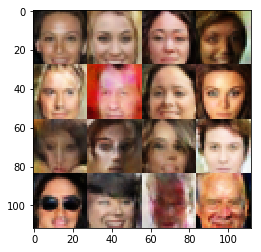

Epochs 56410/60000 Batch Step 2605/3166 gen_loss = -0.1500445306301117..., disc_loss = -0.4211501181125641..., train using time = 11.599
Epochs 56420/60000 Batch Step 2615/3166 gen_loss = 1.5539169311523438..., disc_loss = -0.3119460344314575..., train using time = 11.576
Epochs 56430/60000 Batch Step 2625/3166 gen_loss = 0.27260005474090576..., disc_loss = -0.33201879262924194..., train using time = 11.777
Epochs 56440/60000 Batch Step 2635/3166 gen_loss = 0.8317852020263672..., disc_loss = -0.38504770398139954..., train using time = 12.289
Epochs 56450/60000 Batch Step 2645/3166 gen_loss = 0.6677490472793579..., disc_loss = -0.37673109769821167..., train using time = 11.533
Epochs 56460/60000 Batch Step 2655/3166 gen_loss = -0.5355762243270874..., disc_loss = -0.3616378903388977..., train using time = 11.682
Epochs 56470/60000 Batch Step 2665/3166 gen_loss = 1.0679876804351807..., disc_loss = -0.2916712164878845..., train using time = 11.636
Epochs 56480/60000 Batch Step 2675/3166 ge

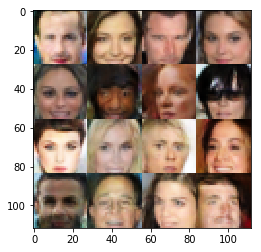

Epochs 56510/60000 Batch Step 2705/3166 gen_loss = 0.899006724357605..., disc_loss = -0.29309022426605225..., train using time = 11.732
Epochs 56520/60000 Batch Step 2715/3166 gen_loss = -1.1095465421676636..., disc_loss = -0.24266092479228973..., train using time = 11.580
Epochs 56530/60000 Batch Step 2725/3166 gen_loss = 2.4398951530456543..., disc_loss = -0.31420430541038513..., train using time = 11.616
Epochs 56540/60000 Batch Step 2735/3166 gen_loss = 0.30762672424316406..., disc_loss = -0.44668135046958923..., train using time = 11.640
Epochs 56550/60000 Batch Step 2745/3166 gen_loss = 1.4893779754638672..., disc_loss = -0.32568609714508057..., train using time = 11.637
Epochs 56560/60000 Batch Step 2755/3166 gen_loss = -0.1261957585811615..., disc_loss = -0.44541558623313904..., train using time = 11.540
Epochs 56570/60000 Batch Step 2765/3166 gen_loss = -1.5312724113464355..., disc_loss = -0.2760477066040039..., train using time = 11.748
Epochs 56580/60000 Batch Step 2775/3166

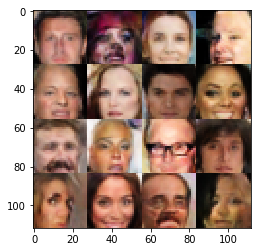

Epochs 56610/60000 Batch Step 2805/3166 gen_loss = 0.10681502521038055..., disc_loss = -0.40357089042663574..., train using time = 11.557
Epochs 56620/60000 Batch Step 2815/3166 gen_loss = 0.31297510862350464..., disc_loss = -0.3635333478450775..., train using time = 11.599
Epochs 56630/60000 Batch Step 2825/3166 gen_loss = -2.1704819202423096..., disc_loss = -0.2342691868543625..., train using time = 11.625
Epochs 56640/60000 Batch Step 2835/3166 gen_loss = -1.3059933185577393..., disc_loss = -0.2827357053756714..., train using time = 11.799
Epochs 56650/60000 Batch Step 2845/3166 gen_loss = 0.2789679169654846..., disc_loss = -0.44411030411720276..., train using time = 11.682
Epochs 56660/60000 Batch Step 2855/3166 gen_loss = 0.6988726854324341..., disc_loss = -0.35233592987060547..., train using time = 11.642
Epochs 56670/60000 Batch Step 2865/3166 gen_loss = -0.7439119815826416..., disc_loss = -0.33741432428359985..., train using time = 11.871
Epochs 56680/60000 Batch Step 2875/3166

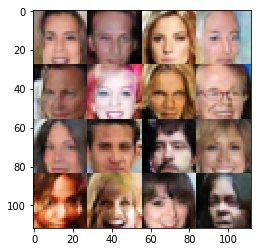

Epochs 56710/60000 Batch Step 2905/3166 gen_loss = 0.5546711683273315..., disc_loss = -0.36126232147216797..., train using time = 11.768
Epochs 56720/60000 Batch Step 2915/3166 gen_loss = 2.1063880920410156..., disc_loss = -0.4606958329677582..., train using time = 11.611
Epochs 56730/60000 Batch Step 2925/3166 gen_loss = 0.7305383682250977..., disc_loss = -0.32038843631744385..., train using time = 11.715
Epochs 56740/60000 Batch Step 2935/3166 gen_loss = 0.8766438961029053..., disc_loss = -0.3226570188999176..., train using time = 11.763
Epochs 56750/60000 Batch Step 2945/3166 gen_loss = 0.20859751105308533..., disc_loss = -0.34485527873039246..., train using time = 11.651
Epochs 56760/60000 Batch Step 2955/3166 gen_loss = -0.90505450963974..., disc_loss = -0.3287486433982849..., train using time = 11.721
Epochs 56770/60000 Batch Step 2965/3166 gen_loss = -0.5402674674987793..., disc_loss = -0.395516574382782..., train using time = 11.690
Epochs 56780/60000 Batch Step 2975/3166 gen_l

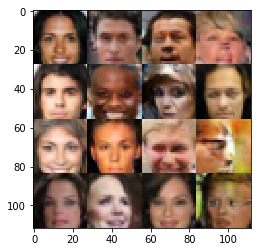

Epochs 56810/60000 Batch Step 3005/3166 gen_loss = 0.050629742443561554..., disc_loss = -0.39236754179000854..., train using time = 12.951
Epochs 56820/60000 Batch Step 3015/3166 gen_loss = 0.3622450828552246..., disc_loss = -0.46376436948776245..., train using time = 11.732
Epochs 56830/60000 Batch Step 3025/3166 gen_loss = 1.7269914150238037..., disc_loss = -0.37159833312034607..., train using time = 11.732
Epochs 56840/60000 Batch Step 3035/3166 gen_loss = -0.3339594006538391..., disc_loss = -0.2489936798810959..., train using time = 11.655
Epochs 56850/60000 Batch Step 3045/3166 gen_loss = 0.1523100733757019..., disc_loss = -0.40784454345703125..., train using time = 11.710
Epochs 56860/60000 Batch Step 3055/3166 gen_loss = 0.962343692779541..., disc_loss = -0.37317806482315063..., train using time = 11.612
Epochs 56870/60000 Batch Step 3065/3166 gen_loss = 0.3212215304374695..., disc_loss = -0.40352916717529297..., train using time = 11.706
Epochs 56880/60000 Batch Step 3075/3166 

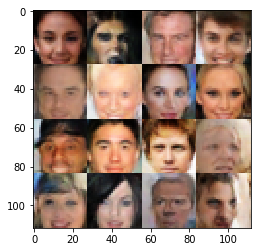

Epochs 56910/60000 Batch Step 3105/3166 gen_loss = -0.04796425253152847..., disc_loss = -0.39864158630371094..., train using time = 11.799
Epochs 56920/60000 Batch Step 3115/3166 gen_loss = 0.13548259437084198..., disc_loss = -0.4240533411502838..., train using time = 11.660
Epochs 56930/60000 Batch Step 3125/3166 gen_loss = 1.0324081182479858..., disc_loss = -0.6005558967590332..., train using time = 11.755
Epochs 56940/60000 Batch Step 3135/3166 gen_loss = -1.0777103900909424..., disc_loss = -0.47992485761642456..., train using time = 11.638
Epochs 56950/60000 Batch Step 3145/3166 gen_loss = 2.3137502670288086..., disc_loss = -0.5142750144004822..., train using time = 11.676
Epochs 56960/60000 Batch Step 3155/3166 gen_loss = -0.14203417301177979..., disc_loss = -0.21062441170215607..., train using time = 11.643
Epochs 56970/60000 Batch Step 3165/3166 gen_loss = 0.16064941883087158..., disc_loss = -0.3547033667564392..., train using time = 11.657
Epochs 56980/60000 Batch Step 10/3166 

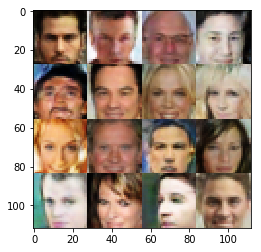

Epochs 57010/60000 Batch Step 40/3166 gen_loss = 1.5124752521514893..., disc_loss = -0.4205675721168518..., train using time = 11.632
Epochs 57020/60000 Batch Step 50/3166 gen_loss = 1.7000668048858643..., disc_loss = -0.31464090943336487..., train using time = 11.805
Epochs 57030/60000 Batch Step 60/3166 gen_loss = 2.142738103866577..., disc_loss = -0.28006047010421753..., train using time = 11.659
Epochs 57040/60000 Batch Step 70/3166 gen_loss = 0.20590651035308838..., disc_loss = -0.3437085747718811..., train using time = 13.326
Epochs 57050/60000 Batch Step 80/3166 gen_loss = -1.133453130722046..., disc_loss = -0.23048241436481476..., train using time = 11.641
Epochs 57060/60000 Batch Step 90/3166 gen_loss = 2.2316832542419434..., disc_loss = -0.31654465198516846..., train using time = 11.739
Epochs 57070/60000 Batch Step 100/3166 gen_loss = 0.6234167814254761..., disc_loss = -0.3385487496852875..., train using time = 11.659
Epochs 57080/60000 Batch Step 110/3166 gen_loss = 0.15397

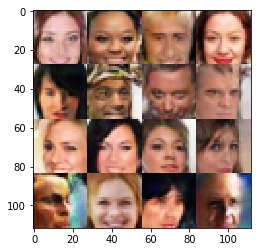

Epochs 57110/60000 Batch Step 140/3166 gen_loss = 0.9208303093910217..., disc_loss = -0.4798104166984558..., train using time = 11.659
Epochs 57120/60000 Batch Step 150/3166 gen_loss = 1.8443982601165771..., disc_loss = -0.25235095620155334..., train using time = 11.594
Epochs 57130/60000 Batch Step 160/3166 gen_loss = 1.6526849269866943..., disc_loss = -0.3153839707374573..., train using time = 11.763
Epochs 57140/60000 Batch Step 170/3166 gen_loss = 1.105789303779602..., disc_loss = -0.4618164896965027..., train using time = 11.885
Epochs 57150/60000 Batch Step 180/3166 gen_loss = 1.104469656944275..., disc_loss = -0.3615085482597351..., train using time = 11.793
Epochs 57160/60000 Batch Step 190/3166 gen_loss = -0.6150704622268677..., disc_loss = -0.4654964506626129..., train using time = 11.644
Epochs 57170/60000 Batch Step 200/3166 gen_loss = 0.44665390253067017..., disc_loss = -0.37380391359329224..., train using time = 11.660
Epochs 57180/60000 Batch Step 210/3166 gen_loss = -1.

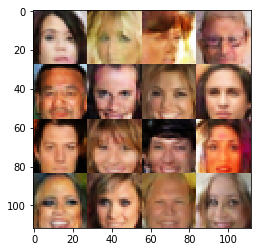

Epochs 57210/60000 Batch Step 240/3166 gen_loss = 0.5107263922691345..., disc_loss = -0.28484392166137695..., train using time = 11.635
Epochs 57220/60000 Batch Step 250/3166 gen_loss = 2.318532943725586..., disc_loss = -0.34459149837493896..., train using time = 11.657
Epochs 57230/60000 Batch Step 260/3166 gen_loss = -0.12412507832050323..., disc_loss = -0.40148329734802246..., train using time = 11.617
Epochs 57240/60000 Batch Step 270/3166 gen_loss = 0.6555237770080566..., disc_loss = -0.4920879304409027..., train using time = 11.794
Epochs 57250/60000 Batch Step 280/3166 gen_loss = 1.8359673023223877..., disc_loss = -0.3177809417247772..., train using time = 11.600
Epochs 57260/60000 Batch Step 290/3166 gen_loss = 0.5868556499481201..., disc_loss = -0.06079019978642464..., train using time = 11.633
Epochs 57270/60000 Batch Step 300/3166 gen_loss = 0.8824946880340576..., disc_loss = -0.317157119512558..., train using time = 13.172
Epochs 57280/60000 Batch Step 310/3166 gen_loss = 0

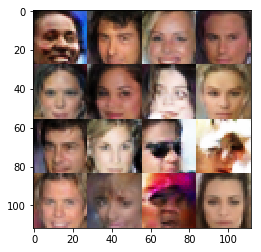

Epochs 57310/60000 Batch Step 340/3166 gen_loss = 1.131593942642212..., disc_loss = -0.15177571773529053..., train using time = 11.713
Epochs 57320/60000 Batch Step 350/3166 gen_loss = -0.11241315305233002..., disc_loss = -0.47337260842323303..., train using time = 11.567
Epochs 57330/60000 Batch Step 360/3166 gen_loss = 0.16823090612888336..., disc_loss = -0.24605365097522736..., train using time = 11.553
Epochs 57340/60000 Batch Step 370/3166 gen_loss = 0.5126547813415527..., disc_loss = -0.38901108503341675..., train using time = 11.724
Epochs 57350/60000 Batch Step 380/3166 gen_loss = -1.2405056953430176..., disc_loss = -0.37951406836509705..., train using time = 11.528
Epochs 57360/60000 Batch Step 390/3166 gen_loss = -0.08180549740791321..., disc_loss = -0.41005364060401917..., train using time = 11.930
Epochs 57370/60000 Batch Step 400/3166 gen_loss = -0.7180281281471252..., disc_loss = -0.25892242789268494..., train using time = 11.683
Epochs 57380/60000 Batch Step 410/3166 gen

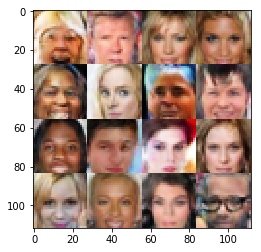

Epochs 57410/60000 Batch Step 440/3166 gen_loss = 0.9648221731185913..., disc_loss = -0.3546716868877411..., train using time = 11.715
Epochs 57420/60000 Batch Step 450/3166 gen_loss = -0.02083035558462143..., disc_loss = -0.45612969994544983..., train using time = 11.706
Epochs 57430/60000 Batch Step 460/3166 gen_loss = -1.1100678443908691..., disc_loss = 0.03895210102200508..., train using time = 11.618
Epochs 57440/60000 Batch Step 470/3166 gen_loss = 0.39997661113739014..., disc_loss = -0.5005027055740356..., train using time = 11.643
Epochs 57450/60000 Batch Step 480/3166 gen_loss = -0.15942375361919403..., disc_loss = -0.37650570273399353..., train using time = 11.603
Epochs 57460/60000 Batch Step 490/3166 gen_loss = -2.5067553520202637..., disc_loss = -0.3291269540786743..., train using time = 11.634
Epochs 57470/60000 Batch Step 500/3166 gen_loss = -0.048755887895822525..., disc_loss = -0.383439838886261..., train using time = 11.589
Epochs 57480/60000 Batch Step 510/3166 gen_l

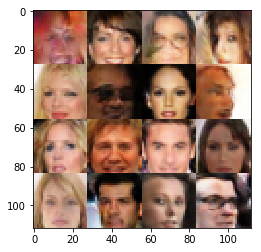

Epochs 57510/60000 Batch Step 540/3166 gen_loss = 0.18839982151985168..., disc_loss = -0.28668802976608276..., train using time = 11.604
Epochs 57520/60000 Batch Step 550/3166 gen_loss = -0.4062229096889496..., disc_loss = -0.19618870317935944..., train using time = 11.649
Epochs 57530/60000 Batch Step 560/3166 gen_loss = 1.6555705070495605..., disc_loss = -0.43822869658470154..., train using time = 11.854
Epochs 57540/60000 Batch Step 570/3166 gen_loss = -0.03197944164276123..., disc_loss = -0.5265412926673889..., train using time = 11.609
Epochs 57550/60000 Batch Step 580/3166 gen_loss = -1.7839165925979614..., disc_loss = -0.36663931608200073..., train using time = 11.561
Epochs 57560/60000 Batch Step 590/3166 gen_loss = 0.9689045548439026..., disc_loss = -0.339449018239975..., train using time = 11.599
Epochs 57570/60000 Batch Step 600/3166 gen_loss = -0.03319758176803589..., disc_loss = -0.386017382144928..., train using time = 11.667
Epochs 57580/60000 Batch Step 610/3166 gen_los

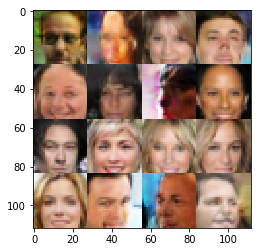

Epochs 57610/60000 Batch Step 640/3166 gen_loss = 0.8191514611244202..., disc_loss = -0.31887954473495483..., train using time = 11.555
Epochs 57620/60000 Batch Step 650/3166 gen_loss = -0.42730453610420227..., disc_loss = -0.5975843667984009..., train using time = 11.591
Epochs 57630/60000 Batch Step 660/3166 gen_loss = -0.6267441511154175..., disc_loss = -0.32791611552238464..., train using time = 11.646
Epochs 57640/60000 Batch Step 670/3166 gen_loss = -1.083008050918579..., disc_loss = -0.39375215768814087..., train using time = 11.737
Epochs 57650/60000 Batch Step 680/3166 gen_loss = -1.5198161602020264..., disc_loss = -0.3676706850528717..., train using time = 11.715
Epochs 57660/60000 Batch Step 690/3166 gen_loss = -0.6780210733413696..., disc_loss = -0.3710257112979889..., train using time = 11.766
Epochs 57670/60000 Batch Step 700/3166 gen_loss = -0.24511601030826569..., disc_loss = -0.2993425726890564..., train using time = 11.855
Epochs 57680/60000 Batch Step 710/3166 gen_lo

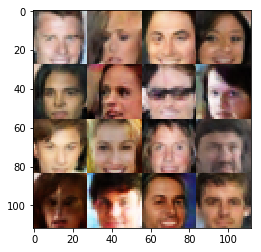

Epochs 57710/60000 Batch Step 740/3166 gen_loss = 0.7753152251243591..., disc_loss = -0.3467220067977905..., train using time = 11.589
Epochs 57720/60000 Batch Step 750/3166 gen_loss = -0.806084156036377..., disc_loss = -0.26115965843200684..., train using time = 11.559
Epochs 57730/60000 Batch Step 760/3166 gen_loss = 0.6396616697311401..., disc_loss = -0.38396257162094116..., train using time = 12.935
Epochs 57740/60000 Batch Step 770/3166 gen_loss = -1.5322082042694092..., disc_loss = -0.25691288709640503..., train using time = 11.648
Epochs 57750/60000 Batch Step 780/3166 gen_loss = 1.2561203241348267..., disc_loss = -0.28082409501075745..., train using time = 11.671
Epochs 57760/60000 Batch Step 790/3166 gen_loss = 1.2880165576934814..., disc_loss = -0.3160610496997833..., train using time = 11.550
Epochs 57770/60000 Batch Step 800/3166 gen_loss = 1.734976053237915..., disc_loss = -0.5056556463241577..., train using time = 11.730
Epochs 57780/60000 Batch Step 810/3166 gen_loss = -

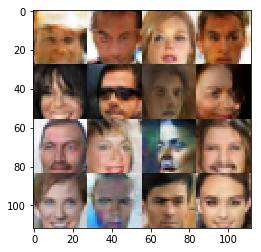

Epochs 57810/60000 Batch Step 840/3166 gen_loss = 0.7556959986686707..., disc_loss = -0.38237062096595764..., train using time = 11.617
Epochs 57820/60000 Batch Step 850/3166 gen_loss = 0.4582001566886902..., disc_loss = -0.28626781702041626..., train using time = 11.561
Epochs 57830/60000 Batch Step 860/3166 gen_loss = 3.7861218452453613..., disc_loss = -0.23423545062541962..., train using time = 11.569
Epochs 57840/60000 Batch Step 870/3166 gen_loss = 0.8145051002502441..., disc_loss = -0.39512717723846436..., train using time = 11.635
Epochs 57850/60000 Batch Step 880/3166 gen_loss = -0.12376537919044495..., disc_loss = -0.29794543981552124..., train using time = 11.631
Epochs 57860/60000 Batch Step 890/3166 gen_loss = 0.5625075101852417..., disc_loss = -0.31074073910713196..., train using time = 11.552
Epochs 57870/60000 Batch Step 900/3166 gen_loss = 0.8822959661483765..., disc_loss = -0.356353223323822..., train using time = 11.698
Epochs 57880/60000 Batch Step 910/3166 gen_loss 

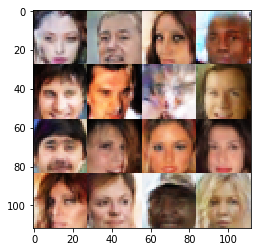

Epochs 57910/60000 Batch Step 940/3166 gen_loss = -0.7207975387573242..., disc_loss = -0.2567884624004364..., train using time = 11.540
Epochs 57920/60000 Batch Step 950/3166 gen_loss = -0.950175404548645..., disc_loss = -0.3174371123313904..., train using time = 11.644
Epochs 57930/60000 Batch Step 960/3166 gen_loss = -0.5127198696136475..., disc_loss = -0.3118512034416199..., train using time = 11.601
Epochs 57940/60000 Batch Step 970/3166 gen_loss = -1.3892724514007568..., disc_loss = -0.12006866931915283..., train using time = 11.889
Epochs 57950/60000 Batch Step 980/3166 gen_loss = 0.9718659520149231..., disc_loss = -0.4273808002471924..., train using time = 11.594
Epochs 57960/60000 Batch Step 990/3166 gen_loss = -0.43490952253341675..., disc_loss = -0.40619373321533203..., train using time = 13.208
Epochs 57970/60000 Batch Step 1000/3166 gen_loss = -0.12858444452285767..., disc_loss = -0.3118380606174469..., train using time = 11.811
Epochs 57980/60000 Batch Step 1010/3166 gen_l

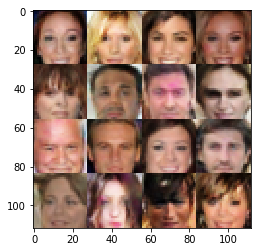

Epochs 58010/60000 Batch Step 1040/3166 gen_loss = -0.23425257205963135..., disc_loss = -0.3966514468193054..., train using time = 11.695
Epochs 58020/60000 Batch Step 1050/3166 gen_loss = 0.7598209977149963..., disc_loss = -0.21828965842723846..., train using time = 11.601
Epochs 58030/60000 Batch Step 1060/3166 gen_loss = 0.05260169878602028..., disc_loss = -0.37398579716682434..., train using time = 11.572
Epochs 58040/60000 Batch Step 1070/3166 gen_loss = -1.091881513595581..., disc_loss = -0.34974703192710876..., train using time = 11.652
Epochs 58050/60000 Batch Step 1080/3166 gen_loss = 0.0701707974076271..., disc_loss = -0.4221787452697754..., train using time = 11.667
Epochs 58060/60000 Batch Step 1090/3166 gen_loss = 0.45608365535736084..., disc_loss = -0.38252443075180054..., train using time = 11.649
Epochs 58070/60000 Batch Step 1100/3166 gen_loss = 1.2013603448867798..., disc_loss = -0.33270400762557983..., train using time = 11.554
Epochs 58080/60000 Batch Step 1110/3166

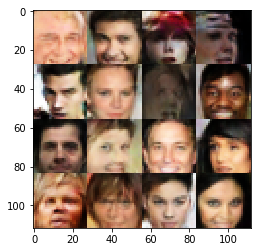

Epochs 58110/60000 Batch Step 1140/3166 gen_loss = -0.5037965774536133..., disc_loss = -0.3600156307220459..., train using time = 11.582
Epochs 58120/60000 Batch Step 1150/3166 gen_loss = 0.058859530836343765..., disc_loss = -0.2616729736328125..., train using time = 11.673
Epochs 58130/60000 Batch Step 1160/3166 gen_loss = -0.8434730768203735..., disc_loss = -0.2534348964691162..., train using time = 11.813
Epochs 58140/60000 Batch Step 1170/3166 gen_loss = 0.7354205250740051..., disc_loss = -0.2978604733943939..., train using time = 11.781
Epochs 58150/60000 Batch Step 1180/3166 gen_loss = 1.2066175937652588..., disc_loss = -0.4005632996559143..., train using time = 11.633
Epochs 58160/60000 Batch Step 1190/3166 gen_loss = -0.0167316235601902..., disc_loss = -0.4479674696922302..., train using time = 11.730
Epochs 58170/60000 Batch Step 1200/3166 gen_loss = 2.219985008239746..., disc_loss = -0.3277314603328705..., train using time = 11.676
Epochs 58180/60000 Batch Step 1210/3166 gen_

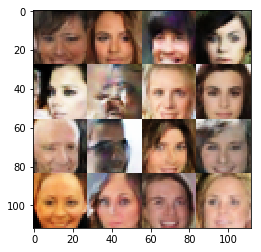

Epochs 58210/60000 Batch Step 1240/3166 gen_loss = 2.0559897422790527..., disc_loss = -0.4140234887599945..., train using time = 11.719
Epochs 58220/60000 Batch Step 1250/3166 gen_loss = 0.11687424778938293..., disc_loss = -0.3618580400943756..., train using time = 11.659
Epochs 58230/60000 Batch Step 1260/3166 gen_loss = -0.4844207167625427..., disc_loss = -0.3985430598258972..., train using time = 11.559
Epochs 58240/60000 Batch Step 1270/3166 gen_loss = 1.157191514968872..., disc_loss = -0.17829978466033936..., train using time = 11.641
Epochs 58250/60000 Batch Step 1280/3166 gen_loss = -1.2172471284866333..., disc_loss = -0.3218686580657959..., train using time = 11.619
Epochs 58260/60000 Batch Step 1290/3166 gen_loss = -0.6220617890357971..., disc_loss = -0.36846238374710083..., train using time = 11.801
Epochs 58270/60000 Batch Step 1300/3166 gen_loss = -0.9736414551734924..., disc_loss = -0.3495010435581207..., train using time = 11.602
Epochs 58280/60000 Batch Step 1310/3166 ge

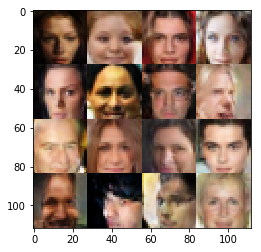

Epochs 58310/60000 Batch Step 1340/3166 gen_loss = 0.7200838327407837..., disc_loss = -0.30106353759765625..., train using time = 11.637
Epochs 58320/60000 Batch Step 1350/3166 gen_loss = 0.4170049726963043..., disc_loss = -0.37449899315834045..., train using time = 11.763
Epochs 58330/60000 Batch Step 1360/3166 gen_loss = 0.40793895721435547..., disc_loss = -0.4634159505367279..., train using time = 11.813
Epochs 58340/60000 Batch Step 1370/3166 gen_loss = 2.916250228881836..., disc_loss = -0.2706482708454132..., train using time = 11.568
Epochs 58350/60000 Batch Step 1380/3166 gen_loss = -0.2459053099155426..., disc_loss = -0.3426697254180908..., train using time = 11.636
Epochs 58360/60000 Batch Step 1390/3166 gen_loss = 0.5200349688529968..., disc_loss = -0.3584185838699341..., train using time = 11.780
Epochs 58370/60000 Batch Step 1400/3166 gen_loss = 1.232054352760315..., disc_loss = -0.26882174611091614..., train using time = 11.544
Epochs 58380/60000 Batch Step 1410/3166 gen_l

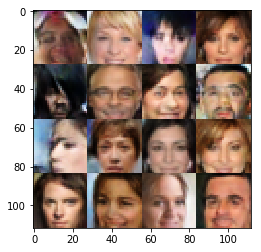

Epochs 58410/60000 Batch Step 1440/3166 gen_loss = 0.26616913080215454..., disc_loss = -0.3739643692970276..., train using time = 11.757
Epochs 58420/60000 Batch Step 1450/3166 gen_loss = -0.43467825651168823..., disc_loss = -0.2841300368309021..., train using time = 12.356
Epochs 58430/60000 Batch Step 1460/3166 gen_loss = -0.9929882287979126..., disc_loss = -0.4455835223197937..., train using time = 11.899
Epochs 58440/60000 Batch Step 1470/3166 gen_loss = 0.8045852780342102..., disc_loss = -0.3162742555141449..., train using time = 11.695
Epochs 58450/60000 Batch Step 1480/3166 gen_loss = 1.3620539903640747..., disc_loss = -0.3325344920158386..., train using time = 11.703
Epochs 58460/60000 Batch Step 1490/3166 gen_loss = -3.0243887901306152..., disc_loss = -0.3883509039878845..., train using time = 11.642
Epochs 58470/60000 Batch Step 1500/3166 gen_loss = -0.25351011753082275..., disc_loss = -0.30189862847328186..., train using time = 11.780
Epochs 58480/60000 Batch Step 1510/3166 

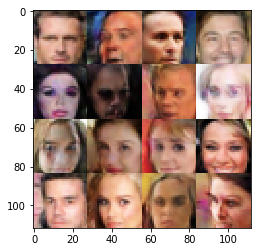

Epochs 58510/60000 Batch Step 1540/3166 gen_loss = 0.27740365266799927..., disc_loss = -0.36936506628990173..., train using time = 11.752
Epochs 58520/60000 Batch Step 1550/3166 gen_loss = -0.19967231154441833..., disc_loss = -0.3103303611278534..., train using time = 11.614
Epochs 58530/60000 Batch Step 1560/3166 gen_loss = 0.8673486709594727..., disc_loss = -0.3148597180843353..., train using time = 11.683
Epochs 58540/60000 Batch Step 1570/3166 gen_loss = 0.7088794708251953..., disc_loss = -0.2567678987979889..., train using time = 11.639
Epochs 58550/60000 Batch Step 1580/3166 gen_loss = 1.8196732997894287..., disc_loss = -0.36505061388015747..., train using time = 11.712
Epochs 58560/60000 Batch Step 1590/3166 gen_loss = -0.9253418445587158..., disc_loss = -0.07302267104387283..., train using time = 11.667
Epochs 58570/60000 Batch Step 1600/3166 gen_loss = 0.5254268050193787..., disc_loss = -0.5456865429878235..., train using time = 11.866
Epochs 58580/60000 Batch Step 1610/3166 g

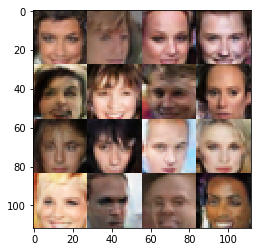

Epochs 58610/60000 Batch Step 1640/3166 gen_loss = 1.5828286409378052..., disc_loss = -0.3120783269405365..., train using time = 11.617
Epochs 58620/60000 Batch Step 1650/3166 gen_loss = 1.5857044458389282..., disc_loss = -0.2254275381565094..., train using time = 11.817
Epochs 58630/60000 Batch Step 1660/3166 gen_loss = 1.0641916990280151..., disc_loss = -0.25314420461654663..., train using time = 11.623
Epochs 58640/60000 Batch Step 1670/3166 gen_loss = 0.9730417728424072..., disc_loss = -0.3586067259311676..., train using time = 11.706
Epochs 58650/60000 Batch Step 1680/3166 gen_loss = -0.49481070041656494..., disc_loss = -0.3659146726131439..., train using time = 11.970
Epochs 58660/60000 Batch Step 1690/3166 gen_loss = -0.06965108215808868..., disc_loss = -0.38981685042381287..., train using time = 11.634
Epochs 58670/60000 Batch Step 1700/3166 gen_loss = 0.4121832251548767..., disc_loss = -0.3724742531776428..., train using time = 11.628
Epochs 58680/60000 Batch Step 1710/3166 ge

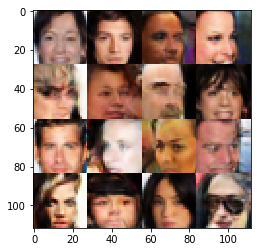

Epochs 58710/60000 Batch Step 1740/3166 gen_loss = 0.3890428841114044..., disc_loss = -0.23519568145275116..., train using time = 12.086
Epochs 58720/60000 Batch Step 1750/3166 gen_loss = -0.823588490486145..., disc_loss = -0.3138675391674042..., train using time = 11.597
Epochs 58730/60000 Batch Step 1760/3166 gen_loss = 0.990757942199707..., disc_loss = -0.4281695485115051..., train using time = 11.845
Epochs 58740/60000 Batch Step 1770/3166 gen_loss = 0.5567671060562134..., disc_loss = -0.3578374683856964..., train using time = 11.578
Epochs 58750/60000 Batch Step 1780/3166 gen_loss = 1.2647780179977417..., disc_loss = -0.4047268331050873..., train using time = 11.535
Epochs 58760/60000 Batch Step 1790/3166 gen_loss = 1.1603059768676758..., disc_loss = -0.22412645816802979..., train using time = 11.658
Epochs 58770/60000 Batch Step 1800/3166 gen_loss = -1.0848639011383057..., disc_loss = -0.12241172790527344..., train using time = 12.162
Epochs 58780/60000 Batch Step 1810/3166 gen_l

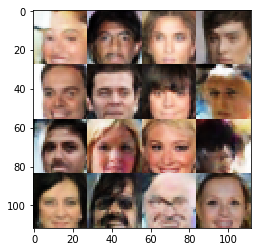

Epochs 58810/60000 Batch Step 1840/3166 gen_loss = 0.3409149944782257..., disc_loss = -0.5653538703918457..., train using time = 11.552
Epochs 58820/60000 Batch Step 1850/3166 gen_loss = 0.34080055356025696..., disc_loss = -0.30992239713668823..., train using time = 11.669
Epochs 58830/60000 Batch Step 1860/3166 gen_loss = 0.7777882218360901..., disc_loss = -0.19945946335792542..., train using time = 12.321
Epochs 58840/60000 Batch Step 1870/3166 gen_loss = -0.13473835587501526..., disc_loss = -0.23770296573638916..., train using time = 11.678
Epochs 58850/60000 Batch Step 1880/3166 gen_loss = 1.6675598621368408..., disc_loss = -0.34783586859703064..., train using time = 11.595
Epochs 58860/60000 Batch Step 1890/3166 gen_loss = -0.4525960683822632..., disc_loss = -0.2826979458332062..., train using time = 11.612
Epochs 58870/60000 Batch Step 1900/3166 gen_loss = -0.9318538904190063..., disc_loss = -0.40114888548851013..., train using time = 11.603
Epochs 58880/60000 Batch Step 1910/316

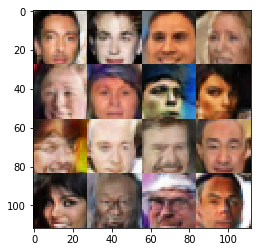

Epochs 58910/60000 Batch Step 1940/3166 gen_loss = 2.0660970211029053..., disc_loss = -0.30256736278533936..., train using time = 11.659
Epochs 58920/60000 Batch Step 1950/3166 gen_loss = 0.8270739316940308..., disc_loss = -0.3089350759983063..., train using time = 11.663
Epochs 58930/60000 Batch Step 1960/3166 gen_loss = 0.1741379201412201..., disc_loss = -0.2745315730571747..., train using time = 11.578
Epochs 58940/60000 Batch Step 1970/3166 gen_loss = 1.0375821590423584..., disc_loss = -0.5008187890052795..., train using time = 11.608
Epochs 58950/60000 Batch Step 1980/3166 gen_loss = 0.2701358199119568..., disc_loss = -0.38221901655197144..., train using time = 11.784
Epochs 58960/60000 Batch Step 1990/3166 gen_loss = 2.0927810668945312..., disc_loss = -0.2419377565383911..., train using time = 11.611
Epochs 58970/60000 Batch Step 2000/3166 gen_loss = 1.339646816253662..., disc_loss = -0.38465115427970886..., train using time = 11.560
Epochs 58980/60000 Batch Step 2010/3166 gen_lo

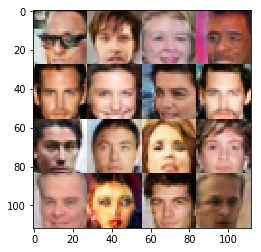

Epochs 59010/60000 Batch Step 2040/3166 gen_loss = -0.07099538296461105..., disc_loss = -0.540718138217926..., train using time = 11.622
Epochs 59020/60000 Batch Step 2050/3166 gen_loss = -0.8020579814910889..., disc_loss = -0.32238030433654785..., train using time = 11.835
Epochs 59030/60000 Batch Step 2060/3166 gen_loss = 0.3271823227405548..., disc_loss = -0.31696972250938416..., train using time = 13.363
Epochs 59040/60000 Batch Step 2070/3166 gen_loss = 1.4917259216308594..., disc_loss = -0.27452176809310913..., train using time = 11.617
Epochs 59050/60000 Batch Step 2080/3166 gen_loss = 0.6963695883750916..., disc_loss = -0.27843767404556274..., train using time = 11.660
Epochs 59060/60000 Batch Step 2090/3166 gen_loss = -0.9176812171936035..., disc_loss = -0.38418182730674744..., train using time = 11.582
Epochs 59070/60000 Batch Step 2100/3166 gen_loss = -0.43305209279060364..., disc_loss = -0.2687571942806244..., train using time = 11.653
Epochs 59080/60000 Batch Step 2110/316

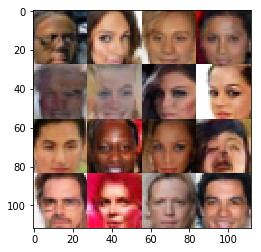

Epochs 59110/60000 Batch Step 2140/3166 gen_loss = 0.03523413836956024..., disc_loss = -0.37369927763938904..., train using time = 11.748
Epochs 59120/60000 Batch Step 2150/3166 gen_loss = 1.1932486295700073..., disc_loss = -0.35774755477905273..., train using time = 11.680
Epochs 59130/60000 Batch Step 2160/3166 gen_loss = 0.33278408646583557..., disc_loss = -0.3075285851955414..., train using time = 11.766
Epochs 59140/60000 Batch Step 2170/3166 gen_loss = 0.30376288294792175..., disc_loss = -0.2977283298969269..., train using time = 11.636
Epochs 59150/60000 Batch Step 2180/3166 gen_loss = -0.9933329224586487..., disc_loss = -0.2719377875328064..., train using time = 11.660
Epochs 59160/60000 Batch Step 2190/3166 gen_loss = 0.845126748085022..., disc_loss = -0.30119776725769043..., train using time = 11.662
Epochs 59170/60000 Batch Step 2200/3166 gen_loss = -0.4656882584095001..., disc_loss = -0.4198607802391052..., train using time = 11.649
Epochs 59180/60000 Batch Step 2210/3166 g

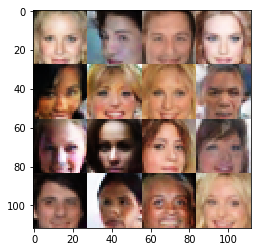

Epochs 59210/60000 Batch Step 2240/3166 gen_loss = 0.4270557463169098..., disc_loss = -0.22392423450946808..., train using time = 12.165
Epochs 59220/60000 Batch Step 2250/3166 gen_loss = 1.490460991859436..., disc_loss = -0.5035975575447083..., train using time = 12.016
Epochs 59230/60000 Batch Step 2260/3166 gen_loss = -0.34487685561180115..., disc_loss = -0.2378300428390503..., train using time = 11.662
Epochs 59240/60000 Batch Step 2270/3166 gen_loss = -1.4470808506011963..., disc_loss = -0.35309988260269165..., train using time = 11.661
Epochs 59250/60000 Batch Step 2280/3166 gen_loss = 0.2906743288040161..., disc_loss = -0.3181740343570709..., train using time = 11.953
Epochs 59260/60000 Batch Step 2290/3166 gen_loss = -0.6731919050216675..., disc_loss = -0.28221291303634644..., train using time = 13.235
Epochs 59270/60000 Batch Step 2300/3166 gen_loss = 1.0545095205307007..., disc_loss = -0.3586340546607971..., train using time = 11.609
Epochs 59280/60000 Batch Step 2310/3166 ge

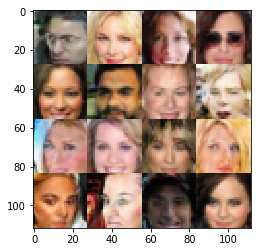

Epochs 59310/60000 Batch Step 2340/3166 gen_loss = 1.1926077604293823..., disc_loss = -0.36212357878685..., train using time = 11.637
Epochs 59320/60000 Batch Step 2350/3166 gen_loss = 0.7597148418426514..., disc_loss = -0.36022329330444336..., train using time = 11.640
Epochs 59330/60000 Batch Step 2360/3166 gen_loss = -1.0303990840911865..., disc_loss = -0.35920223593711853..., train using time = 11.674
Epochs 59340/60000 Batch Step 2370/3166 gen_loss = -0.7211428284645081..., disc_loss = -0.5154663324356079..., train using time = 11.668
Epochs 59350/60000 Batch Step 2380/3166 gen_loss = 0.26838988065719604..., disc_loss = -0.4169015884399414..., train using time = 11.667
Epochs 59360/60000 Batch Step 2390/3166 gen_loss = 0.3130319118499756..., disc_loss = -0.30876725912094116..., train using time = 11.949
Epochs 59370/60000 Batch Step 2400/3166 gen_loss = -0.5846590995788574..., disc_loss = -0.30787113308906555..., train using time = 11.706
Epochs 59380/60000 Batch Step 2410/3166 ge

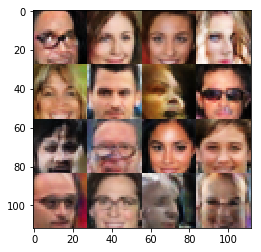

Epochs 59410/60000 Batch Step 2440/3166 gen_loss = 0.9701029658317566..., disc_loss = -0.40535086393356323..., train using time = 11.577
Epochs 59420/60000 Batch Step 2450/3166 gen_loss = 0.7850958108901978..., disc_loss = -0.3989763557910919..., train using time = 11.567
Epochs 59430/60000 Batch Step 2460/3166 gen_loss = -3.5783560276031494..., disc_loss = -0.12175605446100235..., train using time = 11.759
Epochs 59440/60000 Batch Step 2470/3166 gen_loss = -2.3119006156921387..., disc_loss = -0.22312232851982117..., train using time = 11.575
Epochs 59450/60000 Batch Step 2480/3166 gen_loss = -2.2757229804992676..., disc_loss = -0.3165225088596344..., train using time = 11.833
Epochs 59460/60000 Batch Step 2490/3166 gen_loss = 0.46471643447875977..., disc_loss = -0.387722909450531..., train using time = 11.654
Epochs 59470/60000 Batch Step 2500/3166 gen_loss = -1.6780743598937988..., disc_loss = -0.3187411427497864..., train using time = 11.955
Epochs 59480/60000 Batch Step 2510/3166 g

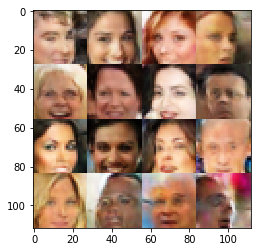

Epochs 59510/60000 Batch Step 2540/3166 gen_loss = -0.5051301121711731..., disc_loss = -0.39187461137771606..., train using time = 11.629
Epochs 59520/60000 Batch Step 2550/3166 gen_loss = -0.7402673959732056..., disc_loss = -0.42487531900405884..., train using time = 11.667
Epochs 59530/60000 Batch Step 2560/3166 gen_loss = 1.208174467086792..., disc_loss = -0.41956645250320435..., train using time = 11.550
Epochs 59540/60000 Batch Step 2570/3166 gen_loss = -0.3927365839481354..., disc_loss = -0.15716543793678284..., train using time = 11.804
Epochs 59550/60000 Batch Step 2580/3166 gen_loss = 0.4323209822177887..., disc_loss = -0.3865576684474945..., train using time = 11.838
Epochs 59560/60000 Batch Step 2590/3166 gen_loss = -0.5371074676513672..., disc_loss = -0.2735341191291809..., train using time = 11.554
Epochs 59570/60000 Batch Step 2600/3166 gen_loss = -0.8790549039840698..., disc_loss = -0.336500346660614..., train using time = 11.636
Epochs 59580/60000 Batch Step 2610/3166 g

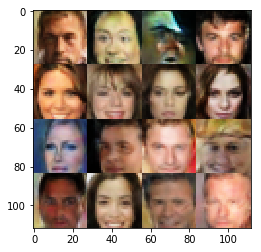

Epochs 59610/60000 Batch Step 2640/3166 gen_loss = 1.0169949531555176..., disc_loss = -0.26488786935806274..., train using time = 11.731
Epochs 59620/60000 Batch Step 2650/3166 gen_loss = -0.7829336524009705..., disc_loss = -0.25566163659095764..., train using time = 11.770
Epochs 59630/60000 Batch Step 2660/3166 gen_loss = 0.2723388075828552..., disc_loss = -0.3855855464935303..., train using time = 11.685
Epochs 59640/60000 Batch Step 2670/3166 gen_loss = 1.0215539932250977..., disc_loss = -0.29303959012031555..., train using time = 12.155
Epochs 59650/60000 Batch Step 2680/3166 gen_loss = -0.1505311280488968..., disc_loss = -0.42307108640670776..., train using time = 11.829
Epochs 59660/60000 Batch Step 2690/3166 gen_loss = -0.8526250720024109..., disc_loss = -0.2245497703552246..., train using time = 11.745
Epochs 59670/60000 Batch Step 2700/3166 gen_loss = 0.5016007423400879..., disc_loss = -0.26464924216270447..., train using time = 11.626
Epochs 59680/60000 Batch Step 2710/3166 

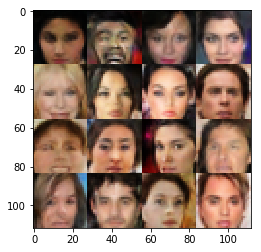

Epochs 59710/60000 Batch Step 2740/3166 gen_loss = 0.6054724454879761..., disc_loss = -0.47114133834838867..., train using time = 11.678
Epochs 59720/60000 Batch Step 2750/3166 gen_loss = 0.5503787398338318..., disc_loss = -0.23719601333141327..., train using time = 11.775
Epochs 59730/60000 Batch Step 2760/3166 gen_loss = 1.8622907400131226..., disc_loss = -0.33443474769592285..., train using time = 11.921
Epochs 59740/60000 Batch Step 2770/3166 gen_loss = 0.06936593353748322..., disc_loss = -0.32117143273353577..., train using time = 11.598
Epochs 59750/60000 Batch Step 2780/3166 gen_loss = -0.9542638659477234..., disc_loss = -0.3421752452850342..., train using time = 11.658
Epochs 59760/60000 Batch Step 2790/3166 gen_loss = -0.19673912227153778..., disc_loss = -0.34118348360061646..., train using time = 11.826
Epochs 59770/60000 Batch Step 2800/3166 gen_loss = 1.7513517141342163..., disc_loss = -0.16487006843090057..., train using time = 12.610
Epochs 59780/60000 Batch Step 2810/316

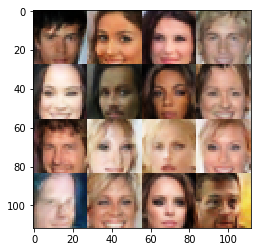

Epochs 59810/60000 Batch Step 2840/3166 gen_loss = -2.0630180835723877..., disc_loss = -0.8292763829231262..., train using time = 11.853
Epochs 59820/60000 Batch Step 2850/3166 gen_loss = 1.0545824766159058..., disc_loss = -0.49769163131713867..., train using time = 11.673
Epochs 59830/60000 Batch Step 2860/3166 gen_loss = 1.9090498685836792..., disc_loss = -0.38913631439208984..., train using time = 11.645
Epochs 59840/60000 Batch Step 2870/3166 gen_loss = 0.34996435046195984..., disc_loss = -0.29896080493927..., train using time = 11.801
Epochs 59850/60000 Batch Step 2880/3166 gen_loss = 0.647747278213501..., disc_loss = -0.4099416136741638..., train using time = 11.662
Epochs 59860/60000 Batch Step 2890/3166 gen_loss = -0.7642362713813782..., disc_loss = -0.4583663046360016..., train using time = 11.623
Epochs 59870/60000 Batch Step 2900/3166 gen_loss = 1.5998954772949219..., disc_loss = -0.3059917390346527..., train using time = 11.589
Epochs 59880/60000 Batch Step 2910/3166 gen_lo

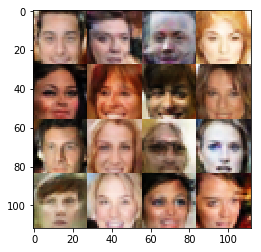

Epochs 59910/60000 Batch Step 2940/3166 gen_loss = -0.10618990659713745..., disc_loss = -0.42706871032714844..., train using time = 11.545
Epochs 59920/60000 Batch Step 2950/3166 gen_loss = 0.8057961463928223..., disc_loss = -0.31804436445236206..., train using time = 11.727
Epochs 59930/60000 Batch Step 2960/3166 gen_loss = -0.3241632580757141..., disc_loss = -0.25515660643577576..., train using time = 11.623
Epochs 59940/60000 Batch Step 2970/3166 gen_loss = -0.1443597972393036..., disc_loss = -0.2784780263900757..., train using time = 11.704
Epochs 59950/60000 Batch Step 2980/3166 gen_loss = -0.3004632294178009..., disc_loss = -0.3640223443508148..., train using time = 11.735
Epochs 59960/60000 Batch Step 2990/3166 gen_loss = -0.3277240991592407..., disc_loss = -0.3692047894001007..., train using time = 11.643
Epochs 59970/60000 Batch Step 3000/3166 gen_loss = 0.2388286590576172..., disc_loss = -0.20752926170825958..., train using time = 11.726
Epochs 59980/60000 Batch Step 3010/316

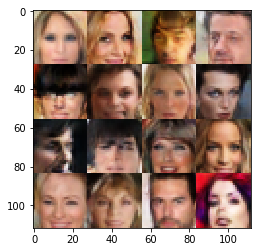

Done!


In [20]:
OUTPUT_DIM = 28*28*3

batch_size = 64  # 128 # 16 # 64 128
z_dim = 128
learning_rate = 1e-4  # 0.0003 #  1e-4
beta1 = 0  # 0.5
beta2 = 0.9

epochs = 60000 # 5 *

Xs = glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))


train(epochs, batch_size, learning_rate, beta1, beta2, get_batches, Xs, "RGB")

## 批量生成人脸，参数是生成图像个数

In [22]:
class network(object):
    def __init__(self, epochs):
        self.epochs = epochs
        save_dir = "./models"
        if tf.io.gfile.exists(save_dir):
            #             print('Removing existing model dir: {}'.format(MODEL_DIR))
            #             tf.io.gfile.rmtree(MODEL_DIR)
            pass
        else:
            tf.io.gfile.makedirs(save_dir)
            
        beta1 = 0  # 0.5
        beta2 = 0.9
        generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta1, beta2)
        discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta1, beta2)

        self.generator_model = generator()
        discriminator_model = discriminator()

        checkpoint_dir = os.path.join(save_dir, 'checkpoints')
        checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')

        checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                         discriminator_optimizer=discriminator_optimizer,
                                         generator=self.generator_model,
                                         discriminator=discriminator_model)
        

        # Restore variables on creation if a checkpoint exists.
        checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
        
        for epoch_i in range(self.epochs):
            show_generator_output(16, "RGB")

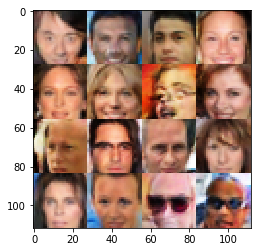

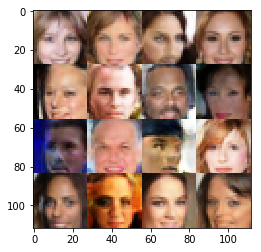

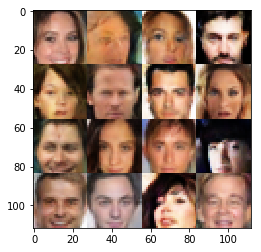

In [16]:
obj=network(3)